# The Homes Dataset: PART 2

A supervised machine-learning regression problem, regarding the home sale prices in the city of Ames, IA.

## 1-4. Previous Cells

In [1]:
%%capture
%run ./03_homes_01.ipynb

In [285]:
columns_encodings.keys()

dict_keys(['cont', 'disc', 'ordinal', 'target', 'ohe', 'bool', 'others'])

### Cleanup

In [4]:
Out.clear()

for name in dir():
    if name.startswith('_') and name[1:].isdigit():
        del globals()[name]

del name

## 5. Preprocessing

### Importing modules

In [85]:
# Train/Test split
from sklearn.model_selection import train_test_split

# Pipeline
from sklearn.pipeline import Pipeline

# to clone pipelines
from sklearn.base import clone

from sklearn.base import BaseEstimator, TransformerMixin
# from sklearn.utils.validation import validate_data

from sklearn.compose import ColumnTransformer, make_column_selector

from sklearn.preprocessing import FunctionTransformer, PowerTransformer, LabelEncoder, OneHotEncoder, OrdinalEncoder, StandardScaler, RobustScaler, MinMaxScaler

# from sklearn.preprocessing import MinMaxScaler
# from scipy.stats import boxcox
# from sklearn.model_selection import cross_val_score

from sklearn.feature_selection import VarianceThreshold, SelectKBest, RFE, RFECV

import scipy.cluster.hierarchy as sch

### Splitting: Features v. Target

Even though there is a test data, that is only for post-production and implementation of the model in the competition, since we do not have target values for it. Thus, to train our models to begin with, we need to split the data for which we *do* have target values into training and validation:

Selecting the features (all columns) and the target:

In [86]:
# features vs. target
X = raw_train.copy() # will pop out the target, then will be split into test and validation
y = X.pop('SalePrice') # target

X_test = raw_test.copy() # test

### Log of Target data

The model testing will be made with the RMSE of the _log_ of the target, so let us take the log now:

In [87]:
y_log = np.log(y)

### Splitting: Training vs. Validation

The data is to be split once, and then used in all models.

In [88]:
# training vs. validation
X_train, X_val, y_train, y_val = train_test_split(X, y_log, test_size=0.25, random_state=1)

In [89]:
# display(X_train)
# display(y_train)

# display(X_val)
# display(y_val)

### Reminder: useful lists, dictionaries, and functions

Let us now recall the different types of features we have:

In [90]:
list(columns_encodings.keys())

['cont', 'disc', 'ordinal', 'target', 'ohe', 'bool', 'others']

The rankings we have:

In [91]:
list(rankings.keys())

['default_mi',
 'default_r',
 'default_omega2',
 'default_useful',
 'new_useful',
 'definitive_yj',
 'definitive_log']

The most useful functions we have devised:

In [92]:
?cramers_v

Signature: cramers_v(x, y)
Docstring:
Computes Cramér's V statistic for measuring the strength of association between two categorical variables.

Parameters
----------
x : array-like
    First categorical variable.
y : array-like
    Second categorical variable.

Returns
-------
float
    Corrected Cramér's V statistic, ranging from 0 (no association) to 1 (perfect association).
File:      /tmp/ipykernel_67360/4169971572.py
Type:      function

In [93]:
?logify

Signature:
logify(
    dataframe,
    columns=<class 'float'>,
    prefix='',
    dexes=None,
    drop_cols=False,
    log_fn=<ufunc 'log1p'>,
)
Docstring:
Applies a logarithmic transformation to specified columns in a DataFrame.

Parameters
----------
dataframe : pd.DataFrame
    Input DataFrame to transform.
columns : list, type, or int, default float
    List of column names or a dtype (float or int) to select columns.
prefix : str, default ''
    Prefix to add to the transformed column names.
dexes : float or None, default None
    If set, filters out columns with insufficient order-of-magnitude variation.
drop_cols : bool, default False
    If True, drops original columns after transformation.
log_fn : callable, default numpy.log1p
    Log function to apply (e.g., np.log, np.log10).

Returns
-------
pd.DataFrame
    DataFrame with log-transformed columns added (and optionally original columns dropped).
File:      /tmp/ipykernel_67360/1561521445.py
Type:      function

In [94]:
?has_cols_fn

Signature:
has_cols_fn(
    dataframe,
    has_cols=['MasVnrArea', 'TotalBsmtSF', '2ndFlrSF', 'GarageArea', 'WoodDeckSF', 'Porch', 'PoolArea'],
)
Docstring:
Creates binary indicator columns for the presence of features (e.g., area > 0) in a DataFrame.

Parameters
----------
dataframe : pd.DataFrame
    Input DataFrame containing the original features.
has_cols : list of str, optional
    List of column names to check for presence.

Returns
-------
pd.DataFrame
    DataFrame containing new binary columns indicating feature presence (1 if present, 0 otherwise).
File:      /tmp/ipykernel_67360/1839177342.py
Type:      function

In [95]:
?new_features

Signature:
new_features(
    dataset,
    has_cols=['MasVnrArea', 'TotalBsmtSF', '2ndFlrSF', 'GarageArea', 'WoodDeckSF', 'Porch', 'PoolArea'],
)
Docstring:
Computes a set of engineered features from the Ames housing dataset, including age, rooms, and area metrics.

Parameters
----------
dataset : pd.DataFrame
    Original Ames housing dataset.
has_cols : list of str, optional
    List of features to create binary 'Has_X' indicators using `has_cols_fn`.

Returns
-------
pd.DataFrame
    DataFrame with new features including engineered numeric and binary indicator columns.
File:      /tmp/ipykernel_67360/3364796558.py
Type:      function

In [96]:
?add_target_encoded_features

Signature:
add_target_encoded_features(
    X: pandas.core.frame.DataFrame,
    y: pandas.core.series.Series,
    cols: list[str],
    new_col_suffix: str = '',
    n_splits: int = 5,
    smoothing: float = 20.0,
    random_state: int = 0,
)
Docstring:
Performs out-of-fold target encoding on specified categorical columns and returns the transformed DataFrame along with fitted encoders.

This function encodes each column in `cols` using K-fold target encoding, ensuring out-of-fold separation to reduce leakage.
It also fits a final encoder on the full data for use at inference time.

Parameters
----------
X : pd.DataFrame
    Input DataFrame containing training features.
y : pd.Series
    Target variable (numeric).
cols : list of str
    List of categorical column names to encode.
new_col_suffix : str, optional
    Suffix to append to the original column name for the encoded column. If empty, the original name is used.
n_splits : int, default 5
    Number of folds to use for out-of-fold 

In [97]:
?optimal_feats

Signature: optimal_feats(df, mi_df, mi_thr_or_no, r_thr)
Docstring:
Selects optimal features based on mutual information and pairwise correlation thresholds.

This function selects features whose mutual information (MI) with the target is either among the top N highest (if `mi_thr_or_no` is an integer), or above a specified threshold (if `mi_thr_or_no` is a float). It then prunes features that are highly correlated (above a given Pearson correlation coefficient threshold) with one another.

Parameters
----------
df : pd.DataFrame
    The input DataFrame containing the feature columns.
mi_df : pd.Series
    A Series with feature names as the index and their mutual information scores as values, sorted in descending order.
mi_thr_or_no : int or float
    If int, selects the top N features by mutual information.
    If float, uses it as a threshold to filter features with MI greater than this value.
r_thr : float
    Maximum allowed absolute Pearson correlation between selected features.



### Preprocessing steps:

#### Cleaning, Imputation, and Uniformization

We now define a new function, that takes care of imputing, cleaning, and uniformizing all features. We will use this in our pipeline.

First, an straightforward imputer (without demanding specific conditions to be satisfied):

In [98]:
class CustomImputer(BaseEstimator, TransformerMixin):
    """
    A custom imputer that applies various imputation strategies to specified columns.

    Supports global strategies ('mean', 'median', 'mode'), constant values, and group-based strategies
    ('group_mean', 'group_median', 'group_mode') using `groupby` columns.

    Parameters
    ----------
    strategies : dict, optional
        Dictionary mapping column names to imputation strategies or constant values.
    groupby_cols : dict, optional
        Dictionary mapping column names to lists of columns to group by (used for group-based strategies).
    """


    
    def __init__(self, strategies=None, groupby_cols=None):
        self.strategies = strategies or {}
        self.groupby_cols = groupby_cols or {}
        self.impute_values_ = {}

    def fit(self, X, y=None):
        X = X.copy()
        for col, val_strat in self.strategies.items():
            if val_strat == 'mean':
                self.impute_values_[col] = X[col].mean()
            elif val_strat == 'median':
                self.impute_values_[col] = X[col].median()
            elif val_strat == 'mode':
                self.impute_values_[col] = X[col].mode()[0]
            elif val_strat == 'group_mean':
                gb_cols = self.groupby_cols.get(col)
                if gb_cols is None:
                    raise ValueError(f"Missing groupby columns for '{col}'")
                self.impute_values_[col] = X.groupby(gb_cols)[col].mean()
            elif val_strat == 'group_median':
                gb_cols = self.groupby_cols.get(col)
                if gb_cols is None:
                    raise ValueError(f"Missing groupby columns for '{col}'")
                self.impute_values_[col] = X.groupby(gb_cols)[col].median()
            elif val_strat == 'group_mode':
                gb_cols = self.groupby_cols.get(col)
                if gb_cols is None:
                    raise ValueError(f"Missing groupby columns for '{col}'")
                self.impute_values_[col] = X.groupby(gb_cols)[col].agg(pd.Series.mode)
            else:
                self.impute_values_[col] = val_strat # it's the constant value to impute!
        return self

    def transform(self, X):
        X = X.copy()
        
        for col, val_strat in self.strategies.items():
            
            if val_strat in ('mean', 'median', 'mode'):
                X[col] = X[col].fillna(self.impute_values_[col])
            elif val_strat in ('group_mean', 'group_median', 'group_mode'):
                gb_cols = self.groupby_cols[col]
                X[col] = X[col].fillna(X[gb_cols].map(self.impute_values_[col]))
            else:
                X[col] = X[col].fillna(self.impute_values_[col])
        
        return X

Next, an imputer that requires some specific rules/conditions:

In [99]:
class RuleBasedImputer(BaseEstimator, TransformerMixin):
    """
    An imputer that fills missing values based on user-defined conditional rules.

    Each rule specifies a condition, target column, and imputation value or strategy (e.g., 'mean', 'median').

    Parameters
    ----------
    rules : list of dict
        Each dict must have keys: 'condition' (a function taking a DataFrame and returning a boolean mask), 'column' (target column), and 'value' (constant or strategy).
    groupby_cols : dict, optional
        Mapping from column names to groupby columns for group-based strategies.
    """

    def __init__(self, rules, groupby_cols=None):
        self.rules = rules
        self.groupby_cols = groupby_cols
        self.impute_values_ = {}

    def fit(self, X, y=None):
        X = X.copy()

        for i, rule in enumerate(self.rules):
            
            cond = rule["condition"](X)            
            col = rule["column"]
            val = rule["value"]

            # mask = cond & X[col].isna()

            if val == 'mean':
                self.impute_values_[i] = X[cond][col].mean()
            elif val == 'median':
                self.impute_values_[i] = X[cond][col].median()
            elif val == 'mode':
                self.impute_values_[i] = X[cond][col].mode()[0]
            elif val == 'group_mean':
                gb_cols = self.groupby_cols.get(col)
                if gb_cols is None:
                    raise ValueError(f"Missing groupby columns for '{col}'")
                self.impute_values_[i] = X[cond].groupby(gb_cols)[col].mean()
            elif val == 'group_median':
                gb_cols = self.groupby_cols.get(col)
                if gb_cols is None:
                    raise ValueError(f"Missing groupby columns for '{col}'")
                self.impute_values_[i] = X[cond].groupby(gb_cols)[col].median()
            elif val == 'group_mode':
                gb_cols = self.groupby_cols.get(col)
                if gb_cols is None:
                    raise ValueError(f"Missing groupby columns for '{col}'")
                self.impute_values_[i] = X[cond].groupby(gb_cols)[col].agg(lambda x: pd.Series.mode(x).iloc[-1])
            else:
                self.impute_values_[i] = val # it's the constant value to impute!
        
        return self

    def transform(self, X):
        X = X.copy()
        
        for i, rule in enumerate(self.rules):
            
            cond = rule["condition"](X)            
            col = rule["column"]
            val = rule["value"]

            # mask = cond & X[col].isna()

            if val in ('mean', 'median', 'mode'):
                X.loc[cond, col] = X.loc[cond, col].fillna(self.impute_values_[i])

            elif val in ('group_mean', 'group_median', 'group_mode'):
                gb_cols = self.groupby_cols[col]
                # X.loc[cond, col] = X.loc[cond, col].fillna(X[gb_cols].map(self.impute_values_[i]))

                # rows where we'll impute
                mask = cond & X[col].isna()

                # keys used to index the imputation series
                keys = X.loc[mask, gb_cols]

                # if gb_cols is a single string, we can use .map()
                if isinstance(gb_cols, str):
                    imputed_vals = keys.map(self.impute_values_[i])
                else:
                    # otherwise, make tuple keys for MultiIndex lookup
                    imputed_vals = keys.apply(lambda row: self.impute_values_[i].get(tuple(row), np.nan), axis=1)

                # set imputed values
                X.loc[mask, col] = imputed_vals
            
            else:
                X.loc[cond, col] = X.loc[cond, col].fillna(self.impute_values_[i])

        return X

Finally, a transformer that uniformizes the column types:

In [100]:
class UniformTypeTransformer(BaseEstimator, TransformerMixin):
    """
    Ensures consistent data types across columns based on a user-defined mapping.

    Can also infer and preserve data types for unspecified columns.

    Parameters
    ----------
    dtype_mapping : dict
        Dictionary mapping column names to target dtypes (e.g., {"col1": "float64"}).
    infer_undefined : bool, default False
        If True, infer data types for columns not specified in `dtype_mapping`.
    """

    def __init__(self, dtype_mapping, infer_undefined=False):
        self.dtype_mapping = dtype_mapping
        self.infer_undefined = infer_undefined

    def fit(self, X, y=None):
        self.columns_ = X.columns.tolist()
        if self.infer_undefined:
            self.inferred_types_ = X.dtypes.astype(str).to_dict()
        else:
            self.inferred_types_ = {}
        return self

    def transform(self, X):
        X = X.copy()
        for col in self.columns_:
            target_type = self.dtype_mapping.get(col, self.inferred_types_.get(col))
            if target_type:
                try:
                    X[col] = X[col].astype(target_type)
                except Exception as e:
                    raise ValueError(f"Failed to convert column '{col}' to '{target_type}': {e}")
        return X

Defining the pipeline:

In [101]:
cleaning_pipeline = Pipeline(steps=[('custom_imputer',
                                     CustomImputer(strategies=column_value_strategy, groupby_cols=groupby_cols)),
                                    ('rules_based_imputer', RuleBasedImputer(imputation_rules, groupby_cols=groupby_cols)),
                                     ('uniform_type_transformer', UniformTypeTransformer(final_column_types))])

Checking that the cleaning transformations work, by comparing with our previous work, done by hand. First, for the training dataset:

In [102]:
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

test_pipe = clone(cleaning_pipeline)

train_slice = test_pipe.fit_transform(train_slice)
print("Sanity check:", train_slice.equals(data_train.drop(columns='SalePrice')))

Sanity check: True


Now for the test dataset:

In [103]:
test_slice = raw_test.copy()

test_slice = test_pipe.transform(test_slice)
print("Sanity check:", test_slice.equals(data_test))

Sanity check: True


Done!!!!

In [104]:
del train_slice, test_slice, test_pipe

#### Feature Engineering

So let us define our Feature Engineering class to include in our future pipeline:

In [105]:
class FeatureEngineer(BaseEstimator, TransformerMixin):
    """
    Applies a feature engineering function to a DataFrame and concatenates the result.

    This transformer is compatible with scikit-learn pipelines and is useful for injecting custom feature logic into preprocessing flows.

    Parameters
    ----------
    func : callable
        A function that takes a DataFrame and returns a DataFrame of new features (same index).
    kwargs : dict, optional
        Additional keyword arguments to pass to the feature function.
    """

    def __init__(self, func=None, kwargs={}):
        self.func = func
        self.kwargs = kwargs

    def fit(self, X, y=None):

        # No fitting necessary
        
        return self

    def transform(self, X):
        
        # 1. Check we got a DataFrame
        if not isinstance(X, pd.DataFrame):
            raise ValueError("FeatureAdder.transform input must be a pandas DataFrame")

        if self.func == None:
            X_out = X.copy() # just pass through!

        else:
            # 2. Compute new features
            X_new = self.func(X.copy(), **self.kwargs)

            if not isinstance(X_new, pd.DataFrame):
                raise ValueError("func must return a pandas DataFrame")

            # 3. Ensure no name collisions:
            overlap = set(X.columns).intersection(X_new.columns)
            if overlap:
                # raise ValueError(f"Naming collision between original and new features: {overlap}")
                return X

            # 4. Concatenate side by side
            X_out = pd.concat([X, X_new], axis=1)

        return X_out

Checking that it works:

In [106]:
# copying
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering
test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('fe', FeatureEngineer(func=new_features,
                                                   kwargs={'has_cols':has_cols}))])

train_slice = test_pipe.fit_transform(train_slice)

display(train_slice.head())

print("\nSanity check:", sorted(train_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,HouseAge,GarageAge,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,TotalSF,1and2FlrSF,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,1,60,RL,65.0,8450.0,Pave,NA,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706.0,Unf,0.0,150.0,856.0,GasA,Ex,Y,SBrkr,856.0,854.0,0.0,1710.0,1,0,2,1,3,1,Gd,8,Typ,0,NA,Attchd,2003,RFn,2,548.0,TA,TA,Y,0.0,61.0,0.0,0.0,0.0,0.0,NA,NA,NA,0.0,2,2008,WD,Normal,5,5,5,2.5,1.0,3.5,10.5,11.5,2566.0,1710.0,35,1,1,1,1,0,0,0
1,2,20,RL,80.0,9600.0,Pave,NA,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978.0,Unf,0.0,284.0,1262.0,GasA,Ex,Y,SBrkr,1262.0,0.0,0.0,1262.0,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976,RFn,2,460.0,TA,TA,Y,298.0,0.0,0.0,0.0,0.0,0.0,NA,NA,NA,0.0,5,2007,WD,Normal,31,31,31,2.0,0.5,2.5,8.0,8.5,2524.0,1262.0,48,0,1,0,1,1,0,0
2,3,60,RL,68.0,11250.0,Pave,NA,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486.0,Unf,0.0,434.0,920.0,GasA,Ex,Y,SBrkr,920.0,866.0,0.0,1786.0,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001,RFn,2,608.0,TA,TA,Y,0.0,42.0,0.0,0.0,0.0,0.0,NA,NA,NA,0.0,9,2008,WD,Normal,7,7,6,2.5,1.0,3.5,8.5,9.5,2706.0,1786.0,35,1,1,1,1,0,0,0
3,4,70,RL,60.0,9550.0,Pave,NA,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216.0,Unf,0.0,540.0,756.0,GasA,Gd,Y,SBrkr,961.0,756.0,0.0,1717.0,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998,Unf,3,642.0,TA,TA,Y,0.0,35.0,272.0,0.0,0.0,0.0,NA,NA,NA,0.0,2,2006,WD,Abnorml,91,8,36,1.0,1.0,2.0,8.0,9.0,2473.0,1717.0,35,0,1,1,1,0,1,0
4,5,60,RL,84.0,14260.0,Pave,NA,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655.0,Unf,0.0,490.0,1145.0,GasA,Ex,Y,SBrkr,1145.0,1053.0,0.0,2198.0,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000,RFn,3,836.0,TA,TA,Y,192.0,84.0,0.0,0.0,0.0,0.0,NA,NA,NA,0.0,12,2008,WD,Normal,8,8,8,2.5,1.0,3.5,11.5,12.5,3343.0,2198.0,40,1,1,1,1,1,0,0



Sanity check: True


Done!

In [107]:
del train_slice, test_pipe

#### Unsupervised Encoder

We need to encode all categorical columns, except those that need to undergo target encoding.

For that, we first need to write a function that creates an object-selector from a predetermined list of columns.

In [108]:
def object_from_subset(subset, except_list=[]):
    """
    Creates a selector function that filters object-dtype columns from a given subset.

    This function returns another function that, when called with a DataFrame `X`, returns the list of column names from the provided `subset` that exist in `X` and have an object dtype.

    Parameters
    ----------
    subset : list of str
        A list of column names to consider for object-dtype filtering.

    Returns
    -------
    function
        A selector function that takes a DataFrame and returns a list of object-dtype column names from the subset.
    """
    
    def selector(X):
        
        cols_list = []

        for col in subset:
            if col not in X.columns:
                continue
            if col in except_list:
                continue
            if pd.api.types.is_object_dtype(X[col]):
                cols_list.append(col)
        
        return cols_list
    
    return selector

For example, selects the object columns from the boolean encoding list:

In [109]:
def column_encoder(verbose_feature_names_out=False, encodings=columns_encodings):
    """
    Creates a scikit-learn ColumnTransformer for ordinal and boolean encoding of categorical features.

    This function builds a ColumnTransformer that applies ordinal encoders to various subsets of categorical columns. It supports predefined ordinal categories for known features and applies a shared encoding for remaining features based on their classification in the `encodings` dictionary. It also encodes additional "ohe" and "boolean" features as ordinal.

    Parameters
    ----------
    verbose_feature_names_out : bool, default False
        If True, the output feature names will include the transformer name as a prefix.
    encodings : dict
        A dictionary mapping encoding types ('ordinal', 'ohe', 'bool') to lists of column names.

    Returns
    -------
    ColumnTransformer
        A configured ColumnTransformer that applies ordinal encoding to multiple categorical subsets, and passes through all remaining columns.
    """


    # create the list of columns to encode
    ordinal_cols = [['BsmtFinType1', 'BsmtFinType2'],
                    ['Functional'],
                    ['BsmtExposure'],
                    ['GarageFinish'],
                    object_from_subset(columns_encodings['ordinal'],
                                       except_list=['BsmtFinType1',
                                                    'BsmtFinType2',
                                                    'Functional',
                                                    'BsmtExposure',
                                                    'GarageFinish'])]

    # create the ordinal categories
    ordinal_categories = [[["NA", "Unf", "LwQ", "Rec", "BLQ", "ALQ", "GLQ"]]*2, # BsmtFinType1 & BsmtFinType2
                          [["Sal", "Sev", "Maj2", "Maj1", "Mod", "Min2", "Min1", "Typ"]],
                          [["NA", "No", "Mn", "Av", "Gd"]],
                          [["NA", "Unf", "RFn", "Fin"]],
                          [["NA", "Po", "Fa", "TA", "Gd", "Ex"]]*10] # 10 different columns with the same categories

    # create the ordinal transformers
    ordinal_transformers = [('ordinal'+str(i+1),
                             OrdinalEncoder(categories=ordinal_categories[i], dtype=int),
                             ordinal_cols[i]) for i in range(len(ordinal_cols))]

    # for ohe-ordinal encoding:
    ohelabel_pipe = OrdinalEncoder(dtype=int, handle_unknown="use_encoded_value", unknown_value=-1)
    ohelabel_obj_cols = object_from_subset(columns_encodings['ohe'])
    
    # for boolean encoding:
    bool_pipe = OrdinalEncoder(dtype=int, handle_unknown="use_encoded_value", unknown_value=-1)
    bool_obj_cols = object_from_subset(columns_encodings['bool'])

    # final list of transformers:
    transformers = ordinal_transformers+[('ohelabel',
                                          ohelabel_pipe,
                                          ohelabel_obj_cols),
                                         ('boolean',
                                          bool_pipe,
                                          bool_obj_cols)]

    # ColumnTransformer object:
    ct = ColumnTransformer(transformers=transformers,
                           remainder='passthrough',
                           verbose_feature_names_out=verbose_feature_names_out)

    return ct

In [110]:
# copying
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering + encoding
test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                            ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings))])

train_slice = test_pipe.fit_transform(train_slice)

display(train_slice.head())

print("\nSanity check:", sorted(train_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

print("Remaining object-type columns:", train_slice.select_dtypes(include='object').columns.to_list())

,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,MSSubClass,LotFrontage,LotArea,Neighborhood,OverallQual,OverallCond,YearBuilt,YearRemodAdd,Exterior1st,Exterior2nd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,HouseAge,GarageAge,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,TotalSF,1and2FlrSF,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,6,1,7,1,2,3,3,0,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,3,2,1,0,1,1,0,1,60,65.0,8450.0,CollgCr,7,5,2003,2003,VinylSd,VinylSd,196.0,706.0,0.0,150.0,856.0,856.0,854.0,0.0,1710.0,1,0,2,1,3,1,8,0,2003,2,548.0,0.0,61.0,0.0,0.0,0.0,0.0,0.0,2,2008,5,5,5,2.5,1.0,3.5,10.5,11.5,2566.0,1710.0,35,1,1,1,1,0,0,0
1,5,1,7,4,2,3,3,3,5,3,4,3,3,3,0,8,1,1,2,2,1,1,1,4,1,4,4,1,3,0,2,2,3,3,2,1,0,1,1,0,2,20,80.0,9600.0,Veenker,6,8,1976,1976,MetalSd,MetalSd,0.0,978.0,0.0,284.0,1262.0,1262.0,0.0,0.0,1262.0,0,1,2,0,3,1,6,1,1976,2,460.0,298.0,0.0,0.0,0.0,0.0,0.0,0.0,5,2007,31,31,31,2.0,0.5,2.5,8.0,8.5,2524.0,1262.0,48,0,1,0,1,1,0,0
2,6,1,7,2,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,0,2,1,0,1,1,0,3,60,68.0,11250.0,CollgCr,7,5,2001,2002,VinylSd,VinylSd,162.0,486.0,0.0,434.0,920.0,920.0,866.0,0.0,1786.0,1,0,2,1,3,1,6,1,2001,2,608.0,0.0,42.0,0.0,0.0,0.0,0.0,0.0,9,2008,7,7,6,2.5,1.0,3.5,8.5,9.5,2706.0,1786.0,35,1,1,1,1,0,0,0
3,5,1,7,1,1,3,3,4,4,4,3,3,3,4,0,8,2,1,2,5,5,1,0,0,1,4,4,1,3,0,0,2,3,0,2,1,0,1,1,0,4,70,60.0,9550.0,Crawfor,7,5,1915,1970,Wd Sdng,Wd Shng,0.0,216.0,0.0,540.0,756.0,961.0,756.0,0.0,1717.0,1,0,1,0,3,1,7,1,1998,3,642.0,0.0,35.0,272.0,0.0,0.0,0.0,0.0,2,2006,91,8,36,1.0,1.0,2.0,8.0,9.0,2473.0,1717.0,35,0,1,1,1,0,1,0
4,6,1,7,3,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,2,1,3,0,2,1,0,1,1,0,5,60,84.0,14260.0,NoRidge,8,5,2000,2000,VinylSd,VinylSd,350.0,655.0,0.0,490.0,1145.0,1145.0,1053.0,0.0,2198.0,1,0,2,1,4,1,9,1,2000,3,836.0,192.0,84.0,0.0,0.0,0.0,0.0,0.0,12,2008,8,8,8,2.5,1.0,3.5,11.5,12.5,3343.0,2198.0,40,1,1,1,1,1,0,0



Sanity check: True
Remaining object-type columns: ['Neighborhood', 'Exterior1st', 'Exterior2nd']


In [111]:
del train_slice, test_pipe

#### Target Encoder

Let us create a Target Encoder that implements our OOF encoding.

In [112]:
class OOFTargetEncoderTransformer(BaseEstimator, TransformerMixin):
    """
    A scikit-learn compatible transformer that performs out-of-fold target encoding.

    Useful for reducing leakage during training and preparing final encoders for inference.

    Parameters
    ----------
    cols : list of str
        Categorical column names to target encode.
    new_col_suffix : str, default ""
        Suffix to append to the encoded feature names.
    n_splits : int, default 5
        Number of folds for out-of-fold encoding.
    smoothing : float, default 20.0
        Smoothing parameter for balancing category mean and global mean.
    random_state : int, default 0
        Random seed for fold reproducibility.
    """

    def __init__(self, cols, new_col_suffix="", n_splits=5, smoothing=20.0, random_state=0):
        self.cols = cols
        self.new_col_suffix = new_col_suffix
        self.n_splits = n_splits
        self.smoothing = smoothing
        self.random_state = random_state

    def fit(self, X, y):

        self._train_idx = X.index  # Save for later
        self._oof_encoded_ = pd.DataFrame(index=X.index)
        
        # Here we perform OOF target encoding and store the final encoder.
        X_enc, self._final_encoders_ = add_target_encoded_features(X=X, y=y,
            cols=self.cols,
            new_col_suffix=self.new_col_suffix,
            n_splits=self.n_splits,
            smoothing=self.smoothing,
            random_state=self.random_state)

        # storing encoded columns only
        self._oof_encoded_ = X_enc[[col+self.new_col_suffix for col in self.cols]]
        
        # Optionally, you can store the encoded feature into self or drop the original column.
        return self

    def transform(self, X):
        X = X.copy() # shallow copy for safety!
        # X_out = pd.DataFrame(index=X.index)
        X_out = X.copy() # copy we will change and output

        for col in self.cols:
            if X.index.equals(self._train_idx):  # Same data as during .fit()
                new_col = col + self.new_col_suffix # encoded column may have different name
                X_out[col] = self._oof_encoded_[new_col]
            else:
                X_out[col] = self._final_encoders_[col].transform(X[[col]])[col].values

        return X_out

We now test it, make sure it works:

In [113]:
# copying training dataframe
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering + unsupervised encoding + target encoding

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                            ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                            ('tenc', oof_te)])

train_slice = test_pipe.fit_transform(train_slice, y_log)

display(train_slice.head())

print("\nSanity check:", sorted(train_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

print("Remaining object-type columns:", train_slice.select_dtypes(include='object').columns.to_list())

# now for test dataframe:
test_slice = raw_test.copy()
test_slice = test_pipe.transform(test_slice)

display(test_slice.head())
print("\nSanity check:", sorted(test_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

print("Remaining object-type columns:", test_slice.select_dtypes(include='object').columns.to_list())

,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,MSSubClass,LotFrontage,LotArea,Neighborhood,OverallQual,OverallCond,YearBuilt,YearRemodAdd,Exterior1st,Exterior2nd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,HouseAge,GarageAge,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,TotalSF,1and2FlrSF,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,6,1,7,1,2,3,3,0,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,3,2,1,0,1,1,0,1,12.349499,65.0,8450.0,12.157655,7,5,2003,2003,12.212989,12.220666,196.0,706.0,0.0,150.0,856.0,856.0,854.0,0.0,1710.0,1,0,2,1,3,1,8,0,2003,2,548.0,0.0,61.0,0.0,0.0,0.0,0.0,0.0,2,2008,5,5,5,2.5,1.0,3.5,10.5,11.5,2566.0,1710.0,35,1,1,1,1,0,0,0
1,5,1,7,4,2,3,3,3,5,3,4,3,3,3,0,8,1,1,2,2,1,1,1,4,1,4,4,1,3,0,2,2,3,3,2,1,0,1,1,0,2,12.058297,80.0,9600.0,12.115101,6,8,1976,1976,11.841638,11.844342,0.0,978.0,0.0,284.0,1262.0,1262.0,0.0,0.0,1262.0,0,1,2,0,3,1,6,1,1976,2,460.0,298.0,0.0,0.0,0.0,0.0,0.0,0.0,5,2007,31,31,31,2.0,0.5,2.5,8.0,8.5,2524.0,1262.0,48,0,1,0,1,1,0,0
2,6,1,7,2,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,0,2,1,0,1,1,0,3,12.349499,68.0,11250.0,12.157655,7,5,2001,2002,12.212989,12.220666,162.0,486.0,0.0,434.0,920.0,920.0,866.0,0.0,1786.0,1,0,2,1,3,1,6,1,2001,2,608.0,0.0,42.0,0.0,0.0,0.0,0.0,0.0,9,2008,7,7,6,2.5,1.0,3.5,8.5,9.5,2706.0,1786.0,35,1,1,1,1,0,0,0
3,5,1,7,1,1,3,3,4,4,4,3,3,3,4,0,8,2,1,2,5,5,1,0,0,1,4,4,1,3,0,0,2,3,0,2,1,0,1,1,0,4,11.975710,60.0,9550.0,12.181571,7,5,1915,1970,11.809570,11.957456,0.0,216.0,0.0,540.0,756.0,961.0,756.0,0.0,1717.0,1,0,1,0,3,1,7,1,1998,3,642.0,0.0,35.0,272.0,0.0,0.0,0.0,0.0,2,2006,91,8,36,1.0,1.0,2.0,8.0,9.0,2473.0,1717.0,35,0,1,1,1,0,1,0
4,6,1,7,3,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,2,1,3,0,2,1,0,1,1,0,5,12.337278,84.0,14260.0,12.472243,8,5,2000,2000,12.208053,12.212578,350.0,655.0,0.0,490.0,1145.0,1145.0,1053.0,0.0,2198.0,1,0,2,1,4,1,9,1,2000,3,836.0,192.0,84.0,0.0,0.0,0.0,0.0,0.0,12,2008,8,8,8,2.5,1.0,3.5,11.5,12.5,3343.0,2198.0,40,1,1,1,1,1,0,0



Sanity check: True
Remaining object-type columns: []


,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,MSSubClass,LotFrontage,LotArea,Neighborhood,OverallQual,OverallCond,YearBuilt,YearRemodAdd,Exterior1st,Exterior2nd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,HouseAge,GarageAge,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,TotalSF,1and2FlrSF,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,3,2,7,1,1,3,3,0,3,3,3,3,3,3,0,8,1,1,2,2,1,1,1,4,1,4,2,1,2,0,4,2,3,3,2,1,0,1,1,0,1461,12.052788,80.0,11622.0,11.868050,5,6,1961,1961,12.205873,12.209631,0.0,468.0,144.0,270.0,882.0,896.0,0.0,0.0,896.0,0,0,1,0,2,1,5,0,1961,1,730.0,140.0,0.0,0.0,0.0,120.0,0.0,0.0,6,2010,49,49,49,1.0,0.0,1.0,6.0,6.0,1778.0,896.0,30,0,1,0,1,1,1,0
1,5,1,7,1,1,3,3,0,3,3,3,3,3,4,0,8,2,1,2,2,1,1,1,4,3,4,4,0,3,0,0,1,3,0,2,1,0,1,1,0,1462,12.052788,81.0,14267.0,11.868050,6,6,1958,1958,11.838523,11.838506,108.0,923.0,0.0,406.0,1329.0,1329.0,0.0,0.0,1329.0,0,0,1,1,3,1,6,0,1958,1,312.0,393.0,36.0,0.0,0.0,0.0,0.0,12500.0,6,2010,52,52,52,1.5,0.0,1.5,7.5,7.5,2658.0,1329.0,36,1,1,0,1,1,0,0
2,6,1,7,1,3,3,3,3,4,3,4,3,3,3,0,8,2,1,2,5,1,1,2,4,1,4,2,1,3,0,4,2,3,0,2,1,0,1,1,0,1463,12.339974,74.0,13830.0,12.149250,5,5,1997,1998,12.205873,12.209631,0.0,791.0,0.0,137.0,928.0,928.0,701.0,0.0,1629.0,0,0,2,1,3,1,6,1,1997,2,482.0,212.0,34.0,0.0,0.0,0.0,0.0,0.0,3,2010,13,13,12,2.5,0.0,2.5,8.5,8.5,2557.0,1629.0,25,0,1,1,1,1,0,0
3,6,1,7,1,3,3,3,4,5,3,3,3,3,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,0,2,1,0,1,1,0,1464,12.339974,78.0,9978.0,12.149250,6,6,1998,1998,12.205873,12.209631,20.0,602.0,0.0,324.0,926.0,926.0,678.0,0.0,1604.0,0,0,2,1,3,1,7,1,1998,2,470.0,360.0,36.0,0.0,0.0,0.0,0.0,0.0,6,2010,12,12,12,2.5,0.0,2.5,9.5,9.5,2530.0,1604.0,36,1,1,1,1,1,0,0
4,5,1,7,1,2,3,3,0,5,3,4,3,4,4,0,8,2,1,2,2,1,1,2,4,1,4,4,1,3,4,4,2,1,0,2,1,0,1,1,0,1465,12.166555,43.0,5005.0,12.339677,8,5,1992,1992,11.951901,11.974937,0.0,263.0,0.0,1017.0,1280.0,1280.0,0.0,0.0,1280.0,0,0,2,0,2,1,5,0,1992,2,506.0,0.0,82.0,0.0,0.0,144.0,0.0,0.0,1,2010,18,18,18,2.0,0.0,2.0,7.0,7.0,2560.0,1280.0,40,0,1,0,1,0,1,0



Sanity check: True
Remaining object-type columns: []


In [114]:
del train_slice, test_slice, oof_te, test_pipe

#### Function Transformer

After encoding and imputation, we must transform the data.

In [115]:
class SelectorFunctionTransformer(BaseEstimator, TransformerMixin):
    """
    A transformer that selects columns based on spread and skewness thresholds and applies a transformation only to them.

    This transformer computes log-scale spread (in decades) and skewness for continuous columns, selects those exceeding the specified thresholds, and applies a transformation (log or Yeo-Johnson). All other columns are passed through unchanged.

    Compatible with scikit-learn pipelines.

    Parameters
    ----------
    dex_threshold : float, default 2.0
        Minimum log-scale spread (in decades) required to select a column for transformation.
    skew_threshold : float, default 1.0
        Minimum absolute skewness required to select a column for transformation.
    trans_method : {'log', 'yeo-johnson'}, default 'log'
        Transformation method to apply to selected columns.
    cont_cols : list of str
        List of candidate continuous column names to evaluate.
    verbose_feature_names_out : bool, default False
        If True, feature names are prefixed with the transformer name in the output.

    Attributes
    ----------
    selected_columns_ : list of str
        Columns selected for transformation based on spread and skewness thresholds.
    column_transformer_ : ColumnTransformer
        Internal ColumnTransformer used to apply the transformation.
    """

    def __init__(self, dex_threshold=2.0, skew_threshold=1.0, trans_method='log', cont_cols=pruned_cont_cols, verbose_feature_names_out=False):

        # storing input quantities
        self.dex_threshold = dex_threshold
        self.skew_threshold = skew_threshold
        self.trans_method = trans_method
        self.cont_cols = cont_cols
        
        if self.trans_method not in ['log', 'yeo-johnson']:
            raise ValueError(f"{self.trans_method} must be either 'log' or 'yeo-johnson'.")

        # defining the transformation function
        if self.trans_method == 'log':
            transformer = FunctionTransformer(func=np.log1p, inverse_func=np.expm1)
        elif self.trans_method == 'yeo-johnson':
            transformer = PowerTransformer(method="yeo-johnson", standardize=False)
        
        self.transformer = transformer

        self.verbose_feature_names_out = verbose_feature_names_out
    

    def fit(self, X, y=None):
        # Compute spread and skewness on numeric columns
        
        df = X.copy() # shallow copy

        # selecting the columns to slice the data
        slice_cols = [col for col in self.cont_cols if col in df.columns]

        # Series w/ decades per column
        decades = (np.log10((df[slice_cols].max()+1)/(df[slice_cols].min()+1)))
        # columns w/ spread above decades threshold
        col_decades = decades[decades >= self.dex_threshold].index.to_list()

        # Series w/ skewness per column
        skewness = df[slice_cols].skew()
        # columns w/ skewness above decades threshold
        col_skew = skewness[skewness.abs() > self.skew_threshold].index.to_list()

        # Determine which columns to transform
        self.selected_columns_ = list(set(col_decades+col_skew))

        # Build internal ColumnTransformer
        self.column_transformer_ = ColumnTransformer(
            transformers=[('fn_trans', self.transformer, self.selected_columns_)],
            remainder='passthrough',
            verbose_feature_names_out=self.verbose_feature_names_out)
        
        # Fit the ColumnTransformer
        self.column_transformer_.fit(X)
        
        return self
    

    def transform(self, X):
        
        # Transform data: large spread & skewed columns transformed, others passed through
        return self.column_transformer_.transform(X)

We can now check that this works:

In [116]:
# copying training dataframe
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering + unsupervised encoding + target encoding + function transformer

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

# ft = function_transformer(verbose_feature_names_out=False,
#                           trans_method='log',
#                           dexes_skew=(2, 1),
#                           dexes_skew_series=(col_decades, col_skew))

ft = SelectorFunctionTransformer(dex_threshold=2.0,
                                 skew_threshold=1.0,
                                 trans_method='log',
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                            ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                            ('tenc', oof_te),
                            ('transf1', ft)])

train_slice = test_pipe.fit_transform(train_slice, y_log)

display(train_slice.head())

print("\nSanity check:", sorted(train_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

print("Remaining object-type columns:", train_slice.select_dtypes(include='object').columns.to_list())

display(train_slice.describe())

# now for test dataframe:
test_slice = raw_test.copy()
test_slice = test_pipe.transform(test_slice)

display(test_slice.head())
print("\nSanity check:", sorted(test_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

print("Remaining object-type columns:", test_slice.select_dtypes(include='object').columns.to_list())

display(test_slice.describe())

,GrLivArea,GarageAge,BsmtUnfSF,WoodDeckSF,BsmtFinSF1,MiscVal,BsmtFinSF2,1stFlrSF,EnclosedPorch,MasVnrArea,GarageYrBlt,2ndFlrSF,LotArea,TotalSF,TotalBsmtSF,HouseAge,ScreenPorch,LowQualFinSF,OpenPorchSF,GarageArea,1and2FlrSF,PoolArea,3SsnPorch,LotFrontage,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,MSSubClass,Neighborhood,OverallQual,OverallCond,YearBuilt,YearRemodAdd,Exterior1st,Exterior2nd,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageCars,MoSold,YrSold,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,7.444833,1.791759,5.017280,0.000000,6.561031,0.0,0.0,6.753438,0.000000,5.283204,7.602900,6.751101,9.042040,7.850493,6.753438,1.791759,0.0,0.0,4.127134,6.308098,7.444833,0.0,0.0,4.189655,6,1,7,1,2,3,3,0,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,3,2,1,0,1,1,0,1,12.349499,12.157655,7,5,2003,2003,12.212989,12.220666,1,0,2,1,3,1,8,0,2,2,2008,5,2.5,1.0,3.5,10.5,11.5,35,1,1,1,1,0,0,0
1,7.141245,3.465736,5.652489,5.700444,6.886532,0.0,0.0,7.141245,0.000000,0.000000,7.589336,0.000000,9.169623,7.833996,7.141245,3.465736,0.0,0.0,0.000000,6.133398,7.141245,0.0,0.0,4.394449,5,1,7,4,2,3,3,3,5,3,4,3,3,3,0,8,1,1,2,2,1,1,1,4,1,4,4,1,3,0,2,2,3,3,2,1,0,1,1,0,2,12.058297,12.115101,6,8,1976,1976,11.841638,11.844342,0,1,2,0,3,1,6,1,2,5,2007,31,2.0,0.5,2.5,8.0,8.5,48,0,1,0,1,1,0,0
2,7.488294,2.079442,6.075346,0.000000,6.188264,0.0,0.0,6.825460,0.000000,5.093750,7.601902,6.765039,9.328212,7.903596,6.825460,2.079442,0.0,0.0,3.761200,6.411818,7.488294,0.0,0.0,4.234107,6,1,7,2,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,0,2,1,0,1,1,0,3,12.349499,12.157655,7,5,2001,2002,12.212989,12.220666,1,0,2,1,3,1,6,1,2,9,2008,6,2.5,1.0,3.5,8.5,9.5,35,1,1,1,1,0,0,0
3,7.448916,2.197225,6.293419,0.000000,5.379897,0.0,0.0,6.869014,5.609472,0.000000,7.600402,6.629363,9.164401,7.813592,6.629363,4.521789,0.0,0.0,3.583519,6.466145,7.448916,0.0,0.0,4.110874,5,1,7,1,1,3,3,4,4,4,3,3,3,4,0,8,2,1,2,5,5,1,0,0,1,4,4,1,3,0,0,2,3,0,2,1,0,1,1,0,4,11.975710,12.181571,7,5,1915,1970,11.809570,11.957456,1,0,1,0,3,1,7,1,3,2,2006,36,1.0,1.0,2.0,8.0,9.0,35,0,1,1,1,0,1,0
4,7.695758,2.197225,6.196444,5.262690,6.486161,0.0,0.0,7.044033,0.000000,5.860786,7.601402,6.960348,9.565284,8.114923,7.044033,2.197225,0.0,0.0,4.442651,6.729824,7.695758,0.0,0.0,4.442651,6,1,7,3,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,2,1,3,0,2,1,0,1,1,0,5,12.337278,12.472243,8,5,2000,2000,12.208053,12.212578,1,0,2,1,4,1,9,1,3,12,2008,8,2.5,1.0,3.5,11.5,12.5,40,1,1,1,1,1,0,0



Sanity check: True
Remaining object-type columns: []


,GrLivArea,GarageAge,BsmtUnfSF,WoodDeckSF,BsmtFinSF1,MiscVal,BsmtFinSF2,1stFlrSF,EnclosedPorch,MasVnrArea,GarageYrBlt,2ndFlrSF,LotArea,TotalSF,TotalBsmtSF,HouseAge,ScreenPorch,LowQualFinSF,OpenPorchSF,GarageArea,1and2FlrSF,PoolArea,3SsnPorch,LotFrontage,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,MSSubClass,Neighborhood,OverallQual,OverallCond,YearBuilt,YearRemodAdd,Exterior1st,Exterior2nd,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageCars,MoSold,YrSold,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
count,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.00000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,7.268512,3.112827,5.648378,2.457206,4.229731,0.233456,0.655398,7.008452,0.698019,2.120264,7.169406,2.864586,9.110966,7.805225,6.750560,3.050047,0.410671,0.099814,2.308541,5.808156,7.264729,0.030431,0.085679,4.216797,3.545890,1.247945,6.841781,1.630822,1.715753,2.810274,2.808904,1.825342,4.145205,2.934932,3.489041,3.083562,3.39589,3.511644,0.017808,7.513014,2.031507,1.075342,2.008219,3.038356,2.485616,1.036301,1.396575,3.770548,1.410274,3.682192,3.504795,1.069178,3.028767,0.493151,3.019178,1.762329,2.777397,1.942466,1.856164,0.993836,0.062329,0.934932,0.995890,0.000685,730.500000,12.040894,12.017925,6.099315,5.575342,1971.267808,1984.865753,12.029216,12.029421,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1.767123,6.321918,2007.815753,22.950685,1.756507,0.454110,2.210616,8.274315,8.728425,33.864384,0.404795,0.974658,0.432192,0.944521,0.478767,0.233562,0.004795
std,0.333303,1.655180,1.854020,2.596435,2.992052,1.226030,1.845045,0.317431,1.727317,2.628759,1.738213,3.293311,0.517369,0.313094,1.145712,1.316619,1.403194,0.747354,2.152387,1.455118,0.333612,0.438685,0.666876,0.323806,2.107776,0.891758,0.667698,1.066665,0.892831,0.722898,0.719685,1.810877,0.959501,0.552159,0.876478,0.351054,0.57428,0.663760,0.268952,1.552100,0.868515,0.599127,0.259040,1.911305,1.933206,0.295124,0.722394,1.100854,0.834998,1.051301,1.082912,0.372102,0.632017,1.198277,1.622634,0.614274,0.707666,1.409156,0.496592,0.249667,0.276232,0.246731,0.063996,0.026171,421.610009,0.202801,0.237736,1.382997,1.112799,30.202904,20.645407,0.153862,0.151642,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,0.747315,2.703626,1.328095,20.639875,0.636015,0.514975,0.785399,2.078627,2.105684,9.219624,0.491020,0.157217,0.495550,0.228992,0.499720,0.423241,0

,GrLivArea,GarageAge,BsmtUnfSF,WoodDeckSF,BsmtFinSF1,MiscVal,BsmtFinSF2,1stFlrSF,EnclosedPorch,MasVnrArea,GarageYrBlt,2ndFlrSF,LotArea,TotalSF,TotalBsmtSF,HouseAge,ScreenPorch,LowQualFinSF,OpenPorchSF,GarageArea,1and2FlrSF,PoolArea,3SsnPorch,LotFrontage,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,MSSubClass,Neighborhood,OverallQual,OverallCond,YearBuilt,YearRemodAdd,Exterior1st,Exterior2nd,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageCars,MoSold,YrSold,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,6.799056,3.912023,5.602119,4.948760,6.150603,0.000000,4.976734,6.799056,0.0,0.000000,7.581720,0.000000,9.360741,7.483807,6.783325,3.912023,4.795791,0.0,0.000000,6.594413,6.799056,0.0,0.0,4.394449,3,2,7,1,1,3,3,0,3,3,3,3,3,3,0,8,1,1,2,2,1,1,1,4,1,4,2,1,2,0,4,2,3,3,2,1,0,1,1,0,1461,12.052788,11.868050,5,6,1961,1961,12.205873,12.209631,0,0,1,0,2,1,5,0,1,6,2010,49,1.0,0.0,1.0,6.0,6.0,30,0,1,0,1,1,1,0
1,7.192934,3.970292,6.008813,5.976351,6.828712,9.433564,0.000000,7.192934,0.0,4.691348,7.580189,0.000000,9.565775,7.885705,7.192934,3.970292,0.000000,0.0,3.610918,5.746203,7.192934,0.0,0.0,4.406719,5,1,7,1,1,3,3,0,3,3,3,3,3,4,0,8,2,1,2,2,1,1,1,4,3,4,4,0,3,0,0,1,3,0,2,1,0,1,1,0,1462,12.052788,11.868050,6,6,1958,1958,11.838523,11.838506,0,0,1,1,3,1,6,0,1,6,2010,52,1.5,0.0,1.5,7.5,7.5,36,1,1,0,1,1,0,0
2,7.396335,2.639057,4.927254,5.361292,6.674561,0.000000,0.000000,6.834109,0.0,0.000000,7.599902,6.553933,9.534668,7.846981,6.834109,2.639057,0.000000,0.0,3.555348,6.180017,7.396335,0.0,0.0,4.317488,6,1,7,1,3,3,3,3,4,3,4,3,3,3,0,8,2,1,2,5,1,1,2,4,1,4,2,1,3,0,4,2,3,0,2,1,0,1,1,0,1463,12.339974,12.149250,5,5,1997,1998,12.205873,12.209631,0,0,2,1,3,1,6,1,2,3,2010,12,2.5,0.0,2.5,8.5,8.5,25,0,1,1,1,1,0,0
3,7.380879,2.564949,5.783825,5.888878,6.401917,0.000000,0.000000,6.831954,0.0,3.044522,7.600402,6.520621,9.208238,7.836370,6.831954,2.564949,0.000000,0.0,3.610918,6.154858,7.380879,0.0,0.0,4.369448,6,1,7,1,3,3,3,4,5,3,3,3,3,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,0,2,1,0,1,1,0,1464,12.339974,12.149250,6,6,1998,1998,12.205873,12.209631,0,0,2,1,3,1,7,1,2,6,2010,12,2.5,0.0,2.5,9.5,9.5,36,1,1,1,1,1,0,0
4,7.155396,2.944439,6.925595,0.000000,5.575949,0.000000,0.000000,7.155396,0.0,0.000000,7.597396,0.000000,8.518392,7.848153,7.155396,2.944439,4.976734,0.0,4.418841,6.228511,7.155396,0.0,0.0,3.784190,5,1,7,1,2,3,3,0,5,3,4,3,4,4,0,8,2,1,2,2,1,1,2,4,1,4,4,1,3,4,4,2,1,0,2,1,0,1,1,0,1465,12.166555,12.339677,8,5,1992,1992,11.951901,11.974937,0,0,2,0,2,1,5,0,2,1,2010,18,2.0,0.0,2.0,7.0,7.0,40,0,1,0,1,0,1,0



Sanity check: True
Remaining object-type columns: []


,GrLivArea,GarageAge,BsmtUnfSF,WoodDeckSF,BsmtFinSF1,MiscVal,BsmtFinSF2,1stFlrSF,EnclosedPorch,MasVnrArea,GarageYrBlt,2ndFlrSF,LotArea,TotalSF,TotalBsmtSF,HouseAge,ScreenPorch,LowQualFinSF,OpenPorchSF,GarageArea,1and2FlrSF,PoolArea,3SsnPorch,LotFrontage,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,MSSubClass,Neighborhood,OverallQual,OverallCond,YearBuilt,YearRemodAdd,Exterior1st,Exterior2nd,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageCars,MoSold,YrSold,RemodAge,BathsAbvGr,BsmtBaths,AllBaths,AllRmsAbvGr,AllRooms,OverallQualCond,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
count,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.0,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.00000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000
mean,7.254488,3.117749,5.602043,2.442117,4.220176,0.236078,0.706567,6.999917,0.816893,2.038185,7.194716,2.794559,9.078854,7.789615,6.711094,3.036434,0.491784,0.054371,2.357489,5.820901,7.252010,0.024288,0.046702,4.197382,3.537354,1.300206,6.854695,1.618917,1.717615,2.795751,2.812886,1.710761,4.158328,2.908156,3.470185,3.087731,3.397533,3.509938,0.017820,7.469500,2.049349,1.050720,1.995888,3.015079,2.481837,1.014393,1.389993,3.787526,1.382454,3.688143,3.482522,1.063742,3.028787,0.518163,3.092529,1.771076,2.776559,1.952707,1.805346,0.977382,0.045236,0.930775,0.995888,0.0,2190.000000,12.031414,12.012382,6.078821,5.553804,1971.357779,1983.662783,12.026652,12.028625,0.433859,0.065113,1.570939,0.377656,2.854010,1.042495,6.385195,0.58122,1.765593,6.104181,2007.769705,24.108979,1.759767,0.466415,2.226182,8.144962,8.611378,33.607265,0.388622,0.971213,0.424949,0.947910,0.477724,0.262509,0.004112
std,0.315917,1.635773,1.884929,2.589094,2.972605,1.254650,1.911742,0.327842,1.814052,2.613299,1.687218,3.261396,0.501942,0.312445,1.218197,1.321196,1.513738,0.557179,2.156551,1.416321,0.316076,0.379828,0.493994,0.334147,2.120627,1.013797,0.610379,1.071554,0.900258,0.701328,0.697791,1.801147,0.956684,0.581902,0.924982,0.392637,0.586444,0.660780,0.279055,1.634125,0.879755,0.471584,0.143385,1.915153,1.933083,0.182758,0.731936,1.055436,0.806605,1.043993,1.100039,0.358200,0.685331,1.214981,1.585797,0.596940,0.701340,1.410751,0.574204,0.269956,0.217566,0.253924,0.064018,0.0,421.321334,0.208411,0.259782,1.436812,1.113740,30.390071,21.130467,0.155595,0.153457,0.530527,0.252307,0.555190,0.503017,0.829788,0.208472,1.508895,0.64742,0.775938,2.722432,1.301740,21.129454,0.649495,0.526626,0.831834,1.949744,2.001226,9.153993,0.487604,0.167264,0.494505,0.222286,0.499675,0.440148,0.064018
min,6.

In [117]:
del train_slice, test_slice, oof_te, ft, test_pipe

#### Scaling Transformer

After transforming the data, we now must rescale it.

In [118]:
class SelectorScalerTransformer(BaseEstimator, TransformerMixin):
    """
    Scales selected columns based on continuity, target-encoding, and cardinality thresholds.

    This transformer identifies columns to scale by including:
    - Continuous columns (`cont_cols`)
    - Target-encoded columns (`encodings['target']`)
    - Discrete/ordinal columns with a number of unique values above a threshold

    Applies the specified scaling method (standard, robust, or minmax) to those columns, while leaving all others unchanged.

    Parameters
    ----------
    unique_counts_threshold : int, default 10
        Minimum number of unique values required for a discrete/ordinal column to be scaled.
    scaling_method : {'standard', 'robust', 'minmax'}, default 'robust'
        Scaling method to apply to selected columns.
    cont_cols : list of str
        List of continuous feature names to scale.
    encodings : dict
        Dictionary categorizing columns (e.g., 'disc', 'ordinal', 'target').
    verbose_feature_names_out : bool, default False
        If True, output feature names will include the transformer name as a prefix.

    Attributes
    ----------
    selected_columns_ : list of str
        List of columns selected for scaling.
    column_transformer_ : ColumnTransformer
        Internal transformer that performs the actual scaling.
    """

    def __init__(self, unique_counts_threshold=10, scaling_method='robust', cont_cols=pruned_cont_cols, encodings=columns_encodings, verbose_feature_names_out=False):

        # storing input quantities
        self.unique_counts_threshold = unique_counts_threshold
        self.scaling_method = scaling_method
        self.cont_cols = cont_cols
        self.encodings = encodings
        
        # the scaler to use:
        if self.scaling_method == 'standard':
            scaler = StandardScaler()
        elif self.scaling_method == 'robust':
            scaler = RobustScaler()
        elif self.scaling_method == 'minmax':
            scaler = MinMaxScaler()
        else:
            raise ValueError(f"{self.scaling_method} must be either 'standard', 'robust', or 'minmax'.")
        
        self.scaler = scaler

        self.verbose_feature_names_out = verbose_feature_names_out
    

    def fit(self, X, y=None):
        # Compute spread and skewness on numeric columns
        
        df = X.copy() # shallow copy

        encs = self.encodings.copy() # copying encodings

        # selecting the columns to slice the data
        slice_cols = [col for col in (encs['disc']+encs['ordinal']) if col in df.columns]

        # Series w/ unique counts per column
        unique_counts = pd.Series({col:len(df[col].unique()) for col in slice_cols})
        # columns w/ unique counts above threshold
        col_unique_counts = unique_counts[unique_counts > self.unique_counts_threshold].index.to_list()

        # the names of the columns to scale
        scale_cols = [col for col in (self.cont_cols + encs['target']) if col in df.columns] # first, all the continuous ones, and also the target-encoded ones
        # then, those with a large enough number of unique values (they are broad!)
        scale_cols += col_unique_counts

        # Determine which columns to transform
        self.selected_columns_ = scale_cols

        # Build internal ColumnTransformer
        self.column_transformer_ = ColumnTransformer(
            transformers=[('scale_trans', self.scaler, self.selected_columns_)],
            remainder='passthrough',
            verbose_feature_names_out=self.verbose_feature_names_out)
        
        # Fit the ColumnTransformer
        self.column_transformer_.fit(X)
        
        return self
    

    def transform(self, X):
        
        # Scale data: continuous, target-encoded, and discrete w/ enough unique values, others passed through
        return self.column_transformer_.transform(X)

Checking that it works:

In [119]:
# copying training dataframe
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering + unsupervised encoding + target encoding + function transformer + scaler transformer

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

ft = SelectorFunctionTransformer(dex_threshold=2.0,
                                 skew_threshold=1.0,
                                 trans_method='log',
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

sc = SelectorScalerTransformer(unique_counts_threshold=10,
                               scaling_method='robust',
                               cont_cols=pruned_cont_cols,
                               encodings=columns_encodings,
                               verbose_feature_names_out=False)

# sc = scaling_transformer(verbose_feature_names_out=False,
#                          encodings=columns_encodings,
#                          scaling_method='robust',
#                          value_counts=10,
#                          counts_series=col_valuecounts)

test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                            ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                            ('tenc', oof_te),
                            ('transf1', ft),
                            ('transf2', sc)])

train_slice = test_pipe.fit_transform(train_slice, y_log)

display(train_slice.head())

print("\nSanity check:", sorted(train_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

print("Remaining object-type columns:", train_slice.select_dtypes(include='object').columns.to_list())

display(train_slice.describe())

# now for test dataframe:
test_slice = raw_test.copy()
test_slice = test_pipe.transform(test_slice)

display(test_slice.head())
print("\nSanity check:", sorted(test_slice.columns.to_list()) == sorted(rankings['definitive_log'].index.to_list()))

print("Remaining object-type columns:", test_slice.select_dtypes(include='object').columns.to_list())

display(test_slice.describe())

,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,TotalSF,1and2FlrSF,YearBuilt,YearRemodAdd,GarageYrBlt,YrSold,HouseAge,GarageAge,RemodAge,MSSubClass,Neighborhood,Exterior2nd,Exterior1st,AllRmsAbvGr,AllRooms,TotRmsAbvGrd,OverallQualCond,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,OverallQual,OverallCond,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,Fireplaces,GarageCars,MoSold,BathsAbvGr,BsmtBaths,AllBaths,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,-0.257516,-0.267660,1.034410,0.092710,0.0,-0.898157,-0.300181,-0.524119,1.024186,0.0,0.342891,0.243856,0.000000,0.205247,0.000000,0.0,0.0,0.0,0.0,0.085950,0.348679,0.652174,0.243243,0.601447,0.0,-0.989863,-0.886548,-0.243243,1.080997,0.335546,0.710153,0.572442,1.0,1.000000,1.0,0.0,6,1,7,1,2,3,3,0,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,3,2,1,0,1,1,0,1,7,5,1,0,2,1,3,1,0,2,2,2.5,1.0,3.5,1,1,1,1,0,0,0
1,0.464671,0.029682,0.000000,0.142255,0.0,-0.403505,0.492878,0.327547,0.000000,0.0,-0.327743,-0.078320,1.111220,-0.769489,0.000000,0.0,0.0,0.0,0.0,0.044827,-0.315709,0.065217,-0.486486,-0.023290,-0.5,-0.065070,0.017139,0.459459,0.033362,0.203601,-0.409508,-0.529050,0.0,0.000000,0.0,1.3,5,1,7,4,2,3,3,3,5,3,4,3,3,3,0,8,1,1,2,2,1,1,1,4,1,4,4,1,3,0,2,2,3,3,2,1,0,1,1,0,2,6,8,0,1,2,0,3,1,1,2,5,2.0,0.5,2.5,0,1,0,1,1,0,0
2,-0.100761,0.399288,0.997317,0.035971,0.0,-0.074216,-0.152897,-0.365950,1.026301,0.0,0.438896,0.435133,0.000000,0.118822,0.000000,0.0,0.0,0.0,0.0,0.218326,0.443790,0.608696,0.216216,0.555460,0.0,-0.830932,-0.731244,-0.216216,1.080997,0.335546,0.710153,0.572442,0.2,0.333333,0.0,0.0,6,1,7,2,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,0,2,1,0,1,1,0,3,7,5,1,0,2,1,3,1,1,2,9,2.5,1.0,3.5,1,1,1,1,0,0,0
3,-0.535329,0.017513,0.000000,-0.087072,0.0,0.095602,-0.553912,-0.270300,1.005718,0.0,0.351910,0.535320,0.000000,0.076857,5.609472,0.0,0.0,0.0,0.0,-0.006038,0.357614,-1.260870,-0.648649,0.486393,-1.0,0.518350,-0.667660,0.594595,-0.263752,0.409701,-0.072964,-0.624170,0.0,0.166667,0.5,0.0,5,1,7,1,1,3,3,4,4,4,3,3,3,4,0,8,2,1,2,5,5,1,0,0,1,4,4,1,3,0,0,2,3,0,2,1,0,1,1,0,4,7,5,1,0,1,0,3,1,1,3,2,1.0,1.0,2.0,0,1,1,1,0,1,0
4,0.634651,0.951802,1.147496,0.081314,0.0,0.020085,0.294081,0.114059,1.055930,0.0,0.897190,1.021588,1.025886,0.279765,0.000000,0.0,0.0,0.0,0.0,0.745122,0.897816,0.586957,0.162162,0.532449,0.0,-0.765863,-0.667660,-0.162162,1.037030,1.310980,0.686089,0.557802,1.4,1.333333,1.5,0.5,6,1,7,3,2,3,3,3,5,3,4,3,4,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,2,1,3,0,2,1,0,1,1,0,5,8,5,1,0,2,1,4,1,1,3,12,2.5,1.0,3.5,1,1,1,1,1,0,0



Sanity check: True
Remaining object-type columns: []


,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,TotalSF,1and2FlrSF,YearBuilt,YearRemodAdd,GarageYrBlt,YrSold,HouseAge,GarageAge,RemodAge,MSSubClass,Neighborhood,Exterior2nd,Exterior1st,AllRmsAbvGr,AllRooms,TotRmsAbvGrd,OverallQualCond,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,OverallQual,OverallCond,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,Fireplaces,GarageCars,MoSold,BathsAbvGr,BsmtBaths,AllBaths,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
count,1460.000000,1460.000000,1460.000000,1.460000e+03,1460.000000,1460.000000,1.460000e+03,1.460000e+03,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1.460000e+03,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.00000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,-0.161801,-0.107021,0.415131,-2.621394e-01,0.655398,-0.406707,-3.060665e-01,3.592060e-02,0.434576,0.099814,-0.046608,-0.678121,0.478997,-0.224264,0.698019,0.085679,0.410671,0.030431,0.233456,-2.689395e-02,-0.045470,-0.037656,-0.246872,-19.363699,-0.092123,-0.294718,-0.173377,0.241910,-0.029247,-0.097711,0.141149,0.027339,0.109726,0.076142,0.258904,-0.113562,3.545890,1.247945,6.841781,1.630822,1.715753,2.810274,2.808904,1.825342,4.145205,2.934932,3.489041,3.083562,3.39589,3.511644,0.017808,7.513014,2.031507,1.075342,2.008219,3.038356,2.485616,1.036301,1.396575,3.770548,1.410274,3.682192,3.504795,1.069178,3.028767,0.493151,3.019178,1.762329,2.777397,1.942466,1.856164,0.993836,0.062329,0.934932,0.995890,0.000685,730.500000,6.099315,5.575342,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,0.613014,1.767123,6.321918,1.756507,0.454110,2.210616,0.404795,0.974658,0.432192,0.944521,0.478767,0.233562,0.004795
std,1.141871,1.205770,0.514691,4.554230e-01,1.845045,1.443769,2.342963e+00,6.971128e-01,0.499617,0.747354,0.736274,2.683480,0.506138,0.508345,1.727317,0.666876,1.403194,0.438685,1.226030,7.804819e-01,0.730095,0.656585,0.557984,80.055714,0.664048,0.727370,0.893541,0.557834,0.729602,0.737141,0.451174,0.456382,0.831451,0.701895,0.812697,0.921962,2.107776,0.891758,0.667698,1.066665,0.892831,0.722898,0.719685,1.810877,0.959501,0.552159,0.876478,0.351054,0.57428,0.663760,0.268952,1.552100,0.868515,0.599127,0.259040,1.911305,1.933206,0.295124,0.722394,1.100854,0.834998,1.051301,1.082912,0.372102,0.632017,1.198277,1.622634,0.614274,0.707666,1.409156,0.496592,0.249667,0.276232,0.246731,0.063996,0.026171,421.610009,1.382997,1.112799,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,0.644666,0.747315,2.703626,0.636015,0.514975,0.785399,0.491020,0.15721

,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,TotalSF,1and2FlrSF,YearBuilt,YearRemodAdd,GarageYrBlt,YrSold,HouseAge,GarageAge,RemodAge,MSSubClass,Neighborhood,Exterior2nd,Exterior1st,AllRmsAbvGr,AllRooms,TotRmsAbvGrd,OverallQualCond,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,OverallQual,OverallCond,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,Fireplaces,GarageCars,MoSold,BathsAbvGr,BsmtBaths,AllBaths,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
0,0.464671,0.475099,0.000000,0.030238,4.976734,-0.442730,-0.239062,-0.423937,0.000000,0.0,-1.083647,0.771869,0.964690,-0.769489,0.0,0.0,4.795791,0.0,0.000000,-0.828127,-1.064575,-0.260870,-0.891892,-0.374064,1.0,0.181483,0.258065,0.945946,0.013542,-0.562422,0.677321,0.551335,-0.8,-0.833333,-0.5,-0.5,3,2,7,1,1,3,3,0,3,3,3,3,3,3,0,8,1,1,2,2,1,1,1,4,1,4,2,1,2,0,4,2,3,3,2,1,0,1,1,0,1461,5,6,0,0,1,0,2,1,0,1,6,1.0,0.0,1.0,0,1,0,1,1,1,0
1,0.507940,0.952946,0.918529,0.133454,0.000000,-0.126027,0.598582,0.441062,0.000000,0.0,-0.213560,-0.792372,1.165004,0.083328,0.0,0.0,0.000000,0.0,9.433564,0.173728,-0.202590,-0.326087,-0.972973,-0.444540,1.0,0.213674,0.289521,1.027027,0.013542,-0.562422,-0.426872,-0.538290,-0.2,-0.333333,0.0,0.1,5,1,7,1,1,3,3,0,3,3,3,3,3,4,0,8,2,1,2,2,1,1,1,4,3,4,4,0,3,0,0,1,3,0,2,1,0,1,1,0,1462,6,6,0,0,1,1,3,1,0,1,6,1.5,0.0,1.5,1,1,0,1,1,0,0
2,0.193276,0.880449,0.000000,0.109990,0.000000,-0.968263,-0.135210,-0.346957,0.994275,0.0,0.235758,0.007652,1.045107,0.070204,0.0,0.0,0.000000,0.0,0.000000,0.077195,0.242544,0.521739,0.108108,0.463347,1.0,-0.521771,-0.429139,-0.054054,1.046730,0.309486,0.677321,0.551335,0.2,0.000000,0.0,-1.0,6,1,7,1,3,3,3,3,4,3,4,3,3,3,0,8,2,1,2,5,1,1,2,4,1,4,2,1,3,0,4,2,3,0,2,1,0,1,1,0,1463,5,5,0,0,2,1,3,1,1,2,3,2.5,0.0,2.5,0,1,1,1,1,0,0
3,0.376507,0.119678,0.596094,0.068491,0.000000,-0.301231,-0.139618,-0.351690,0.989221,0.0,0.201614,-0.038744,1.147952,0.083328,0.0,0.0,0.000000,0.0,0.000000,0.050744,0.208718,0.543478,0.108108,0.486393,1.0,-0.562712,-0.469146,-0.054054,1.046730,0.309486,0.677321,0.551335,0.6,0.333333,0.5,0.1,6,1,7,1,3,3,3,4,5,3,3,3,3,4,0,8,2,1,2,5,1,1,2,4,1,4,4,1,3,0,4,1,3,0,2,1,0,1,1,0,1464,6,6,0,0,2,1,3,1,1,2,6,2.5,0.0,2.5,1,1,1,1,1,0,0
4,-1.687348,-1.488062,0.000000,-0.057230,0.000000,0.587893,0.521817,0.358625,0.000000,0.0,-0.296482,0.097084,0.000000,0.274141,0.0,0.0,4.976734,0.0,0.000000,0.080117,-0.284740,0.413043,-0.054054,0.347947,1.0,-0.353062,-0.264280,0.108108,0.422832,0.899934,-0.020955,-0.201989,-0.4,-0.500000,-0.5,0.5,5,1,7,1,2,3,3,0,5,3,4,3,4,4,0,8,2,1,2,2,1,1,2,4,1,4,4,1,3,4,4,2,1,0,2,1,0,1,1,0,1465,8,5,0,0,2,0,2,1,0,2,1,2.0,0.0,2.0,0,1,0,1,0,1,0



Sanity check: True
Remaining object-type columns: []


,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,TotalSF,1and2FlrSF,YearBuilt,YearRemodAdd,GarageYrBlt,YrSold,HouseAge,GarageAge,RemodAge,MSSubClass,Neighborhood,Exterior2nd,Exterior1st,AllRmsAbvGr,AllRooms,TotRmsAbvGrd,OverallQualCond,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,SaleType,Condition1,RoofMatl,Condition2,HouseStyle,GarageType,Heating,Foundation,SaleCondition,RoofStyle,Electrical,Fence,MiscFeature,MSZoning,BldgType,LotConfig,MasVnrType,LandContour,LotShape,PavedDrive,Alley,LandSlope,CentralAir,Street,Utilities,Id,OverallQual,OverallCond,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,Fireplaces,GarageCars,MoSold,BathsAbvGr,BsmtBaths,AllBaths,Has_MasVnr,Has_Bsmt,Has_2ndFlr,Has_Garage,Has_WoodDeck,Has_Porch,Has_Pool
count,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.0,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.00000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000
mean,-0.230266,-0.181863,0.399061,-0.263594,0.706567,-0.442789,-0.386775,0.017175,0.423953,0.054371,-0.077586,-0.654618,0.476056,-0.212703,0.816893,0.046702,0.491784,0.024288,0.236078,-0.065807,-0.073306,-0.035700,-0.279384,-18.198019,-0.115147,-0.302239,-0.170719,0.273216,-0.063353,-0.114898,0.138781,0.019735,0.057985,0.037126,0.192598,-0.139273,3.537354,1.300206,6.854695,1.618917,1.717615,2.795751,2.812886,1.710761,4.158328,2.908156,3.470185,3.087731,3.397533,3.509938,0.017820,7.469500,2.049349,1.050720,1.995888,3.015079,2.481837,1.014393,1.389993,3.787526,1.382454,3.688143,3.482522,1.063742,3.028787,0.518163,3.092529,1.771076,2.776559,1.952707,1.805346,0.977382,0.045236,0.930775,0.995888,0.0,2190.000000,6.078821,5.553804,0.433859,0.065113,1.570939,0.377656,2.854010,1.042495,0.58122,1.765593,6.104181,1.759767,0.466415,2.226182,0.388622,0.971213,0.424949,0.947910,0.477724,0.262509,0.004112
std,1.178337,1.169816,0.511664,0.452463,1.911742,1.467838,2.491193,0.719975,0.494775,0.557179,0.697869,2.611931,0.504707,0.509328,1.814052,0.493994,1.513738,0.379828,1.254650,0.778865,0.691718,0.660654,0.571094,77.707075,0.650870,0.729899,0.883064,0.571066,0.749784,0.805498,0.456575,0.461522,0.779898,0.667075,0.754447,0.915399,2.120627,1.013797,0.610379,1.071554,0.900258,0.701328,0.697791,1.801147,0.956684,0.581902,0.924982,0.392637,0.586444,0.660780,0.279055,1.634125,0.879755,0.471584,0.143385,1.915153,1.933083,0.182758,0.731936,1.055436,0.806605,1.043993,1.100039,0.358200,0.685331,1.214981,1.585797,0.596940,0.701340,1.410751,0.574204,0.269956,0.217566,0.253924,0.064018,0.0,421.321334,1.436812,1.113740,0.530527,0.252307,0.555190,0.503017,0.829788,0.208472,0.64742,0.775938,2.722432,0.649495,0.526626,0.831834,0.487604,0.167264,0.494505,0.222286,0.499675,0.440148,0.064018
min

In [120]:
del train_slice, test_slice, oof_te, ft, sc, test_pipe

#### Selector

Adding so many engineered features, while useful, leads to a much higher dimensionality space, which may be detrimental to a model's performace. In order to avoid this, we must select the most promising features.

We do this with our own selector, which _i._ drops features w/ very low variance, _ii._ selects the k-best features, ranked according to some score (e.g. MI), and then _iii._ decorrelates them with hierarchical clustering.

In [121]:
class FeatureSelector(BaseEstimator, TransformerMixin):
    """
    Selects features based on variance, mutual information with the target, and correlation-aware clustering for continuous variables.

    This transformer performs a structured feature selection in the following steps:

    1. **Variance Thresholding**: Removes low-variance features.
    2. **Mutual Information Filtering**: Selects the top-k features most informative with respect to the target.
    3. **Type-Aware Decorrelation (Optional)**: 
       - Discrete features are retained without decorrelation.
       - Continuous features are grouped via hierarchical clustering on 1 - |Pearson's r| and pruned by selecting the top MI scorer in each cluster.
    4. **Boolean Feature Augmentation**: Adds 'Has_' boolean indicators corresponding to selected features when applicable.

    Compatible with scikit-learn pipelines.

    Parameters
    ----------
    var_thr : float, default 0.0
        Minimum variance required for a feature to be retained.
    best_k : int or "all", default "all"
        Number of top features to select based on mutual information. If "all", retains all after variance filtering.
    t_thr : float or None, default None
        Threshold for the clustering distance. If provided, used to decorrelate continuous features using hierarchical clustering.
    encodings : dict
        Dictionary categorizing features. Used for identifying boolean 'Has_' features to add.
    random_state : int or None, default None
        Random seed used during mutual information estimation.

    Attributes
    ----------
    feature_names_ : list of str
        Names of all features seen during fitting.
    selected_features_ : list of str
        Final list of selected features in descending order of mutual information score.
    selected_cont_features_ : list of str
        Final list of selected continuous features in descending order of mutual information score.
    pipe_selector : Pipeline
        Internal pipeline applying variance threshold and mutual information filtering.
    pearsons_corr : pd.DataFrame
        Pearson correlation matrix of the final selected continuous features.
    mi_scores : pd.Series
        Mutual information scores for selected features (sorted descending).
    """
    
    def __init__(self, var_thr=0., best_k="all", t_thr=None, encodings=columns_encodings, random_state=None):

        self.var_thr = var_thr
        self.best_k = best_k
        self.t_thr = t_thr
        self.encodings = encodings
        self.random_state = random_state
        
    def fit(self, X, y):

        X = X.copy() # a shallow copy
        self.feature_names_ = X.columns.to_list() # names of all features

        encs = self.encodings.copy() # a copy of encodings

        # Step 1: VarianceThreshold
        self.var_selector = VarianceThreshold(threshold=self.var_thr)

        # Step 2: Best-K MI
        self.mi_selector = SelectKBest(mutual_info_regression, k=self.best_k)

        # Constructing the selector pipeline
        if (self.best_k == "all") and (self.t_thr == None):
            self.pipe_selector = Pipeline(steps=[('var_sel', self.var_selector)])
        else:
            self.pipe_selector = Pipeline(steps=[('var_sel', self.var_selector),
                                                 ('mi_sel', self.mi_selector)])

        # Fitting the selector pipeline and transforming the dataset
        X_filt = self.pipe_selector.fit_transform(X, y)

        # Step 3: Decorrelator
        
        # (a) separating the continuous columns (which we will decorrelate),
        #     from the discrete columns (which we will pass through)
        
        # discrete columns:
        # first, they're integers
        disc_cols = X_filt.select_dtypes(include=int).columns.to_list()
        # adding "baths" (half-baths are counted as 0.5, and thus are floats, although they should be included in the list of discrete columns)
        disc_cols += [col for col in X_filt.columns if ('ath' in col) and (col not in disc_cols)]
        # their corresponding indices
        disc_cols_idxs = X_filt.columns.get_indexer(disc_cols)

        # the remaining columns are treated as continuous
        cont_cols = [col for col in X_filt.columns if (col not in disc_cols)]
        # their corresponding indices
        cont_cols_idxs = X_filt.columns.get_indexer(cont_cols)
        
        if self.t_thr == None:
            selected_idxs = slice(None)
        
        else:
            
            # (b) building the distance = 1–|corr|, only on the continuous columns
            dist = 1 - X_filt[cont_cols].corr().abs()
            dist = dist.to_numpy()

            # (c) hierarchical clustering
            linkage = sch.linkage(sch.distance.squareform(dist), method="average")
            clusters = sch.fcluster(linkage, t=self.t_thr, criterion="distance")

            # (d) extracting the SelectKBest processor
            skb = self.pipe_selector.named_steps['mi_sel']

            # (f) selecting the MI scores of the features we used in the hierarchical clustering
            mi_scores = skb.scores_[skb.get_support()] # first, from all the scores, pick the filtered ones
            
            mi_scores = mi_scores[cont_cols_idxs] # next, select only the scores of the continuous variables used in the hierarchical clustering

            # (g) for each cluster, pick the feature with highest MI score
            selected_idxs = []
            for cl in np.unique(clusters):
                idxs = np.where(clusters == cl)[0]
                best = idxs[np.argmax(mi_scores[idxs])]
                selected_idxs.append(best)

        # Step 4: Extracting selected continuous columns
        X_decor = X_filt[cont_cols].iloc[:, selected_idxs]
        decor_cont_cols = X_decor.columns.to_list()

        # Step 5: saving Pearson's correlation on those continuous variables
        self.pearsons_corr = X_decor.corr()

        # Step 6: making sure booleans are added in case they are needed
        has_X = [col for col in encs['bool'] if ('Has_' in col) and (col in X.columns.to_list())]

        # sublist of has_X whose elements have counterparts in self.selected_features_
        has_update = [hasx for hasx in has_X if any([hasx.removeprefix('Has_') in col for col in decor_cont_cols+disc_cols])]

        # Step 7: all selected features, unsorted
        unsorted_features = decor_cont_cols + disc_cols + has_update

        # Now we save the selected features
        if (self.best_k == "all") and (self.t_thr == None):
            self.selected_features_ = unsorted_features

        else:
            # Step 8: saving MI scores
            # of the full list (well, after VarianceThreshold)
            self.mi_scores = pd.Series(dict(zip(skb.feature_names_in_,
                                                skb.scores_)),
                    name='selected_mi_scores').sort_values(ascending=False)
            # of the selected features
            self.mi_scores = self.mi_scores[unsorted_features].sort_values(ascending=False)
            
            # Step 9: finally, the selected features, ordered according to MI score
            self.selected_features_ = self.mi_scores.index.to_list()

        # Step 10: we now reorder the Pearson's correlation dataframe
        ordered_pearsons_names = [name for name in self.selected_features_ if name in self.pearsons_corr.columns]
        self.pearsons_corr = self.pearsons_corr.loc[ordered_pearsons_names, ordered_pearsons_names]

        # Step 11: the list of selected continuous features
        self.selected_cont_features_ = ordered_pearsons_names

        return self
    
    def transform(self, X):
        
        X = X.copy()
        
        return X[self.selected_features_]
    
    def get_support(self):
        """Mask of selected features (boolean array)."""
        mask = [f in self.selected_features_ for f in self.feature_names_]
        return np.array(mask)
    
    def get_feature_names_out(self, input_features=None):
        """Names of the selected features."""
        return np.array(self.selected_features_)

Checking that it works:

In [122]:
# copying training dataframe
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering + unsupervised encoding + target encoding + function transformer + scaler transformer + feature selector

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

ft = SelectorFunctionTransformer(dex_threshold=2.0,
                                 skew_threshold=1.0,
                                 trans_method='log',
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

sc = SelectorScalerTransformer(unique_counts_threshold=10,
                               scaling_method='robust',
                               cont_cols=pruned_cont_cols,
                               encodings=columns_encodings,
                               verbose_feature_names_out=False)

# CHECK 1: default values: selects all entries!
# fs = FeatureSelector(var_thr=0.,
#                      best_k="all",
#                      t_thr=None,
#                      encodings=columns_encodings,
#                      random_state=None)

# CHECK 2: stricter thresholds
fs = FeatureSelector(var_thr=0.01,
                     best_k=20,
                     t_thr=0.3,
                     encodings=columns_encodings,
                     random_state=None)

test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                            ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                            ('tenc', oof_te),
                            ('transf1', ft),
                            ('transf2', sc),
                            ('selector', fs)])

train_slice = test_pipe.fit_transform(train_slice, y_log)

display(train_slice.head())

# display(train_slice.describe())

# now for test dataframe:
test_slice = raw_test.copy()
test_slice = test_pipe.transform(test_slice)

display(test_slice.head())

# display(test_slice.describe())

print(f"Selected {len(test_pipe.named_steps['selector'].selected_features_)} columns:", test_pipe.named_steps['selector'].selected_features_)
print("\nTraining Sanity Check:", set(test_pipe.named_steps['selector'].selected_features_) == set(train_slice.columns.to_list()), "\n")
print("Test Sanity Check:", set(test_pipe.named_steps['selector'].selected_features_) == set(test_slice.columns.to_list()), "\n")

display(test_pipe.named_steps['selector'].mi_scores)
display(test_pipe.named_steps['selector'].pearsons_corr)

,TotalSF,OverallQual,Neighborhood,OverallQualCond,GarageCars,YearBuilt,TotalBsmtSF,AllBaths,BathsAbvGr,GarageArea,KitchenQual,ExterQual,BsmtQual,1stFlrSF,Has_Garage,Has_Bsmt
0,0.085950,7,0.335546,0.0,2,0.652174,-0.300181,3.5,2.5,0.243856,4,4,4,-0.524119,1,1
1,0.044827,6,0.203601,1.3,2,0.065217,0.492878,2.5,2.0,-0.078320,3,3,4,0.327547,1,1
2,0.218326,7,0.335546,0.0,2,0.608696,-0.152897,3.5,2.5,0.435133,4,4,4,-0.365950,1,1
3,-0.006038,7,0.409701,0.0,3,-1.260870,-0.553912,2.0,1.0,0.535320,4,3,3,-0.270300,1,1
4,0.745122,8,1.310980,0.5,3,0.586957,0.294081,3.5,2.5,1.021588,4,4,4,0.114059,1,1


,TotalSF,OverallQual,Neighborhood,OverallQualCond,GarageCars,YearBuilt,TotalBsmtSF,AllBaths,BathsAbvGr,GarageArea,KitchenQual,ExterQual,BsmtQual,1stFlrSF,Has_Garage,Has_Bsmt
0,-0.828127,5,-0.562422,-0.5,1,-0.260870,-0.239062,1.0,1.0,0.771869,3,3,3,-0.423937,1,1
1,0.173728,6,-0.562422,0.1,1,-0.326087,0.598582,1.5,1.5,-0.792372,4,3,3,0.441062,1,1
2,0.077195,5,0.309486,-1.0,2,0.521739,-0.135210,2.5,2.5,0.007652,3,3,4,-0.346957,1,1
3,0.050744,6,0.309486,0.1,2,0.543478,-0.139618,2.5,2.5,-0.038744,4,3,3,-0.351690,1,1
4,0.080117,8,0.899934,0.5,2,0.413043,0.521817,2.0,2.0,0.097084,4,4,4,0.358625,1,1


Selected 16 columns: ['TotalSF', 'OverallQual', 'Neighborhood', 'OverallQualCond', 'GarageCars', 'YearBuilt', 'TotalBsmtSF', 'AllBaths', 'BathsAbvGr', 'GarageArea', 'KitchenQual', 'ExterQual', 'BsmtQual', '1stFlrSF', 'Has_Garage', 'Has_Bsmt']

Training Sanity Check: True 

Test Sanity Check: True 



TotalSF            0.665107
OverallQual        0.571429
Neighborhood       0.496462
OverallQualCond    0.441112
GarageCars         0.369814
YearBuilt          0.361834
TotalBsmtSF        0.346584
AllBaths           0.337709
BathsAbvGr         0.337638
GarageArea         0.334651
KitchenQual        0.329852
ExterQual          0.329320
BsmtQual           0.327637
1stFlrSF           0.301652
Has_Garage         0.054070
Has_Bsmt           0.038849
Name: selected_mi_scores, dtype: float64

,TotalSF,Neighborhood,OverallQualCond,YearBuilt,TotalBsmtSF,GarageArea,1stFlrSF
TotalSF,1.000000,0.509208,0.437467,0.356243,0.565003,0.348461,0.747355
Neighborhood,0.509208,1.000000,0.346990,0.715308,0.244992,0.344588,0.365177
OverallQualCond,0.437467,0.346990,1.000000,0.158738,0.260280,0.256163,0.262452
YearBuilt,0.356243,0.715308,0.158738,1.000000,0.199087,0.341207,0.277496
TotalBsmtSF,0.565003,0.244992,0.260280,0.199087,1.000000,0.177109,0.288227
GarageArea,0.348461,0.344588,0.256163,0.341207,0.177109,1.000000,0.286678
1stFlrSF,0.747355,0.365177,0.262452,0.277496,0.288227,0.286678,1.000000


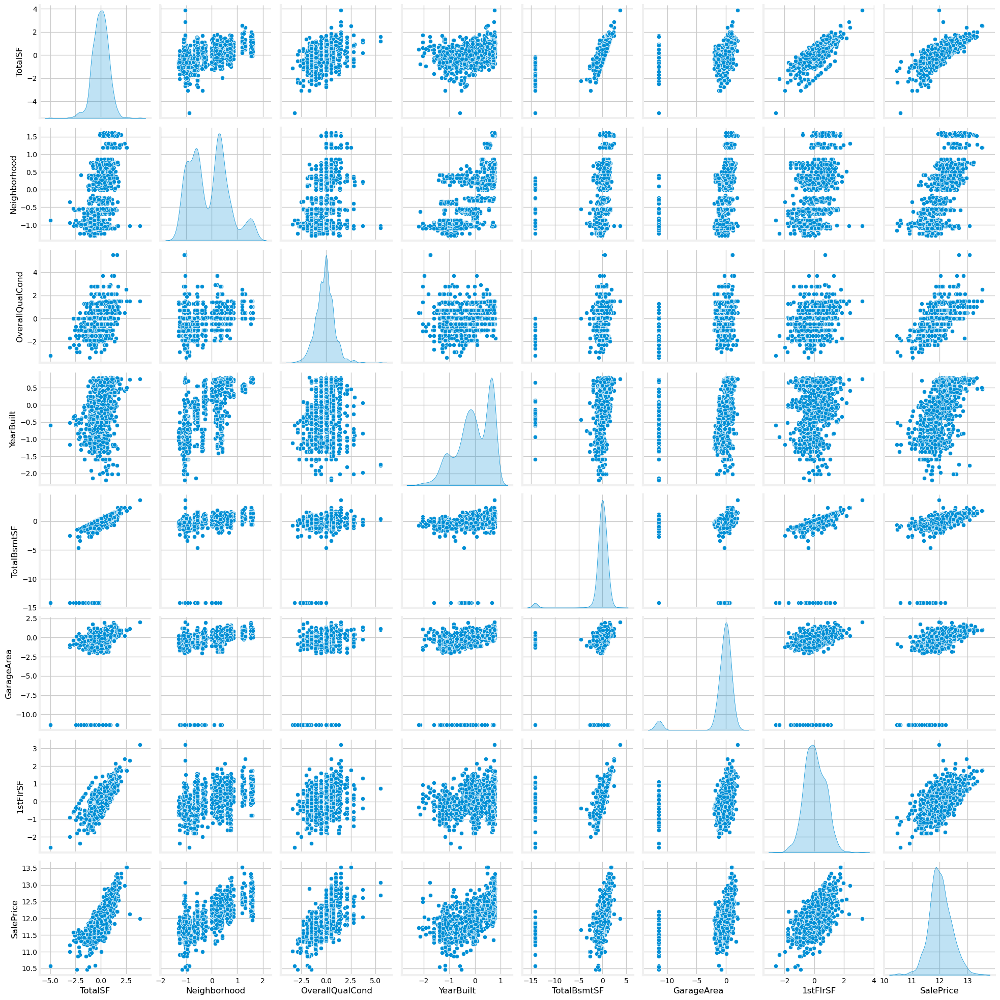

In [123]:
sel_cont_fts = test_pipe.named_steps['selector'].selected_cont_features_

sns.pairplot(data=pd.concat([train_slice[sel_cont_fts], y_log], axis=1), diag_kind='kde')

In [124]:
del train_slice, test_slice, oof_te, ft, sc, fs, test_pipe, sel_cont_fts

#### PCA

We now focus on performing a PCA on the continuous variables, with the hopes of further decorrelating the data features, and makeing analysis easier.

In [125]:
class PCAFeature(TransformerMixin, BaseEstimator):
    """
    A transformer that applies PCA to continuous features, optionally conditioned on boolean indicator variables.

    This transformer:
    - Identifies continuous features (i.e., not integers or known discrete columns),
    - Optionally restricts PCA fitting to rows where all indicator features (e.g., 'Has_X') are 1,
    - Demeans the continuous features before PCA,
    - Projects the data onto principal components,
    - Optionally drops original continuous features from the output.

    Compatible with scikit-learn pipelines.

    Parameters
    ----------
    n_pcs : int or None, default None
        Number of principal components to keep. If None, all components are kept.
    fit_feat_subset : bool, default False
        If True, PCA is fitted only on the subset of rows where all 'Has_X' indicator features are 1.
    keep_original_feats : bool, default True
        If False, original continuous features are dropped from the transformed output.
    random_state : int, default 0
        Random seed used for PCA reproducibility.

    Attributes
    ----------
    feature_names_ : list of str
        All column names in the input DataFrame at fit time.
    discrete_features_ : list of str
        Columns identified as discrete features (including integer-typed and 'bath'-like names).
    continuous_features_ : list of str
        Columns identified as continuous features (i.e., not discrete).
    indicator_features_ : list of str
        Subset of discrete features with names containing 'Has_'.
    continuous_boolean_indicators_ : dict
        Mapping from continuous columns to their corresponding boolean indicator feature (if any).
    continuous_wo_booleans_ : list of str
        Continuous features not associated with any 'Has_X' indicator.
    trained_means_ : pd.Series
        Means of continuous features used for centering prior to PCA.
    demeaned_cols_ : list of str
        Names of columns created by demeaning continuous features.
    pca_ : sklearn.decomposition.PCA
        Fitted PCA object.
    pca_columns_ : list of str
        Names of generated principal component features.
    loadings_ : pd.DataFrame
        PCA loadings (component weights), with original (demeaned) feature names as index.
    """


    def __init__(self, n_pcs=None, fit_feat_subset=False, keep_original_feats=True, random_state=0):
        
        self.n_pcs = n_pcs
        self.fit_feat_subset = fit_feat_subset
        self.keep_original_feats = keep_original_feats
        self.random_state = random_state

    def fit(self, X, y=None):

        X = X.copy() # shallow copy

        #......................................
        # Separating different kinds of columns:

        # First, saving all columns
        self.feature_names_ = X.columns.to_list() # names of all features
        
        # Discrete columns:
        # First, they're integers
        disc_cols = X.select_dtypes(include=int).columns.to_list()
        # Adding "baths" (half-baths are counted as 0.5, and thus are floats, although they should be included in the list of discrete columns)
        disc_cols += [col for col in X.columns if ('ath' in col) and (col not in disc_cols)]
        # Storing them
        self.discrete_features_ = disc_cols

        # Of those, selecting the 'has_X' indicator features:
        has_X_list = [hasx for hasx in self.discrete_features_ if 'Has_' in hasx]
        self.indicator_features_ = has_X_list

        # Continuous columns:
        # = to the remaining columns
        cont_cols = [col for col in X.columns if (col not in disc_cols)]
        # Storing them
        self.continuous_features_ = cont_cols

        # Of those, selecting those columns X that have an indicator feature has_X:
        cont_hasX = {}
        for col in self.continuous_features_:
            
            if not any([hasx.removeprefix('Has_') in col for hasx in has_X_list]):
                continue

            else:
                cont_hasX[col] = [hasx for hasx in has_X_list if hasx.removeprefix('Has_') in col][0]
        
        # Storing them
        self.continuous_boolean_indicators_ = cont_hasX

        # The rest:
        self.continuous_wo_booleans_ = [col for col in self.continuous_features_ if col not in self.continuous_boolean_indicators_.keys()]

        #......................................
        # Creating the de-meaned feature names
        self.demeaned_cols_ = ['demean_'+col for col in self.continuous_features_]

        #......................................
        # Creating the mask of features and the new DataFrame (whose indices and columns are a subset of the original X

        if self.fit_feat_subset:
            # The mask
            mask = (X[self.indicator_features_] == 1).all(axis=1)

            # The new DataFrame
            X_new = pd.DataFrame(index=mask[mask].index, columns=self.demeaned_cols_)

        else:
            # The mask
            mask = slice(None)

            # The new DataFrame
            X_new = pd.DataFrame(index=X.index, columns=self.demeaned_cols_)

        #......................................
        # Finding the means and filling in the values
        self.trained_means_ = X.loc[mask, self.continuous_features_].mean()

        # Filling in the values
        X_new[self.demeaned_cols_] = X.loc[mask, self.continuous_features_] - self.trained_means_

        #......................................
        # Performing PCA on the demeaned features

        # PCA object
        pca = PCA(random_state=self.random_state)

        # Fitting the PCA object
        pca.fit(X_new)

        # Saving PCA object
        self.pca_ = pca

        # Defining PC names
        self.pca_columns_ = ['pca'+str(i) for i in range(pca.n_components_)]

        # Finding and storing the PCA loadings
        loadings = pd.DataFrame(pca.components_.T, columns=self.pca_columns_, index=self.demeaned_cols_)
        self.loadings_ = loadings

        return self

    def transform(self, X):

        X_pca = X.copy() # shallow copy, where we shall store the PCs

        #......................................
        # De-meaning the features
        X_pca[self.demeaned_cols_] = X_pca[self.continuous_features_] - self.trained_means_

        # Performing transformation on the demeaned features
        X_pca[self.pca_columns_] = self.pca_.transform(X_pca[self.demeaned_cols_])

        # Defining outgoing columns
        out_cols = (X.columns.to_list() + self.pca_columns_)

        # Dropping originals if necessary
        if not self.keep_original_feats:
            out_cols = [col for col in out_cols if col not in self.continuous_features_]

        # Dropping last PCs
        if (type(self.n_pcs) == int) and (self.n_pcs < len(self.pca_columns_)):
            out_cols = [col for col in out_cols if col not in self.pca_columns_[self.n_pcs:]]

        # Returning the transformed DataFrame
        return X_pca[out_cols]

Checking that it works. First, with the default arguments for PCA:

In [126]:
# copying training dataframe
train_slice1 = raw_train.copy()
train_slice1 = train_slice1.drop(columns=['SalePrice'])
train_slice2 = train_slice1.copy()

# cleaning + feature engineering + unsupervised encoding + target encoding + function transformer + scaler transformerk + feature selector + PCA

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

ft = SelectorFunctionTransformer(dex_threshold=2.0,
                                 skew_threshold=1.0,
                                 trans_method='log',
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

sc = SelectorScalerTransformer(unique_counts_threshold=10,
                               scaling_method='robust',
                               cont_cols=pruned_cont_cols,
                               encodings=columns_encodings,
                               verbose_feature_names_out=False)

# selector w/ strict thresholds
fs = FeatureSelector(var_thr=0.01,
                     best_k=20,
                     t_thr=0.3,
                     encodings=columns_encodings,
                     random_state=None)

# default PCA
pc1 = PCAFeature(n_pcs=None,
                 fit_feat_subset=False,
                 keep_original_feats=True,
                 random_state=0)

test_pipe1 = Pipeline(steps=[('cleaning', cleaning_pipeline),
                             ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                             ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                             ('tenc', oof_te),
                             ('transf1', ft),
                             ('transf2', sc),
                             ('selector', fs),
                             ('pca', pc1)])

train_slice1 = test_pipe1.fit_transform(train_slice1, y_log)

print("Train")
display(train_slice1.head())

# now for test dataframe:
test_slice1 = raw_test.copy()

test_slice1 = test_pipe1.transform(test_slice1)

print("Test")
display(test_slice1.head())

print("Loadings")
display(test_pipe1.named_steps['pca'].loadings_)

Train


,TotalSF,OverallQual,Neighborhood,OverallQualCond,GarageCars,YearBuilt,TotalBsmtSF,AllBaths,GarageArea,BsmtQual,BathsAbvGr,KitchenQual,ExterQual,1stFlrSF,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6
0,0.085950,7,0.335546,0.0,2,0.652174,-0.300181,3.5,0.243856,4,2.5,4,4,-0.524119,1,1,0.870129,-0.461398,0.137749,-0.249461,-0.795985,0.024555,0.409286
1,0.044827,6,0.203601,1.3,2,0.065217,0.492878,2.5,-0.078320,4,2.0,3,3,0.327547,1,1,1.134896,0.469345,0.840928,0.877492,-0.276706,0.168379,-0.312167
2,0.218326,7,0.335546,0.0,2,0.608696,-0.152897,3.5,0.435133,4,2.5,4,4,-0.365950,1,1,1.133039,-0.410400,0.169768,-0.272747,-0.625976,0.007421,0.394319
3,-0.006038,7,0.409701,0.0,3,-1.260870,-0.553912,2.0,0.535320,3,1.0,4,3,-0.270300,1,1,0.835755,-0.821754,-0.307317,0.558037,0.135526,-1.236521,-0.260228
4,0.745122,8,1.310980,0.5,3,0.586957,0.294081,3.5,1.021588,4,2.5,4,4,0.114059,1,1,2.140444,-0.204076,1.083042,-0.398463,-0.601806,-0.517934,0.130319


Test


,TotalSF,OverallQual,Neighborhood,OverallQualCond,GarageCars,YearBuilt,TotalBsmtSF,AllBaths,GarageArea,BsmtQual,BathsAbvGr,KitchenQual,ExterQual,1stFlrSF,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6
0,-0.828127,5,-0.562422,-0.5,1,-0.260870,-0.239062,1.0,0.771869,3,1.0,3,3,-0.423937,1,1,0.955669,-0.822535,-1.259114,0.247212,-0.271740,0.129200,-0.220532
1,0.173728,6,-0.562422,0.1,1,-0.326087,0.598582,1.5,-0.792372,3,1.5,4,3,0.441062,1,1,0.343193,0.872401,-0.122119,0.363420,0.555813,0.199779,-0.076789
2,0.077195,5,0.309486,-1.0,2,0.521739,-0.135210,2.5,0.007652,4,2.5,3,3,-0.346957,1,1,0.628006,-0.244187,-0.428061,-0.986706,-0.436602,-0.134771,0.319034
3,0.050744,6,0.309486,0.1,2,0.543478,-0.139618,2.5,-0.038744,3,2.5,4,3,-0.351690,1,1,0.717571,-0.173905,0.215538,-0.155165,-0.677508,0.045812,0.255172
4,0.080117,8,0.899934,0.5,2,0.413043,0.521817,2.0,0.097084,4,2.0,4,4,0.358625,1,1,1.321884,0.381342,0.778276,-0.159165,-0.518597,-0.132805,-0.407894


Loadings


,pca0,pca1,pca2,pca3,pca4,pca5,pca6
demean_TotalSF,0.160114,0.122942,0.404070,-0.134531,0.437437,-0.255486,0.721979
demean_Neighborhood,0.116269,0.015235,0.455537,-0.378752,-0.410978,-0.604024,-0.318644
demean_OverallQualCond,0.121235,0.049048,0.582496,0.762420,-0.197073,0.145384,-0.048327
demean_YearBuilt,0.094768,-0.001559,0.281495,-0.455574,-0.427626,0.681971,0.237235
demean_TotalBsmtSF,0.466101,0.850129,-0.222264,0.014619,-0.069936,0.019753,-0.071650
demean_GarageArea,0.842383,-0.507743,-0.175715,0.037683,0.011295,-0.011394,-0.005867
demean_1stFlrSF,0.101521,0.041501,0.361103,-0.219048,0.642670,0.288341,-0.559846


In [127]:
# copying training dataframe
train_slice2 = raw_train.copy()
train_slice2 = train_slice2.drop(columns=['SalePrice'])

# cleaning + feature engineering + unsupervised encoding + target encoding + function transformer + scaler transformer + feature selector + PCA

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

ft = SelectorFunctionTransformer(dex_threshold=2.0,
                                 skew_threshold=1.0,
                                 trans_method='log',
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

sc = SelectorScalerTransformer(unique_counts_threshold=10,
                               scaling_method='robust',
                               cont_cols=pruned_cont_cols,
                               encodings=columns_encodings,
                               verbose_feature_names_out=False)

# selector w/ strict thresholds
fs = FeatureSelector(var_thr=0.01,
                     best_k=20,
                     t_thr=0.3,
                     encodings=columns_encodings,
                     random_state=None)

# advanced PCA
pc2 = PCAFeature(n_pcs=None, # selecting all PCs
                 fit_feat_subset=True, # fitting PCA object to subset with has_X = True
                 keep_original_feats=False, # dropping the original features
                 random_state=0)

test_pipe2 = Pipeline(steps=[('cleaning', cleaning_pipeline),
                             ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                             ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                             ('tenc', oof_te),
                             ('transf1', ft),
                             ('transf2', sc),
                             ('selector', fs),
                             ('pca', pc2)])

train_slice2 = test_pipe2.fit_transform(train_slice2, y_log)

print("Train")
display(train_slice2.head())

# now for test dataframe:
test_slice2 = raw_test.copy()

test_slice2 = test_pipe2.transform(test_slice2)

print("Test")
display(test_slice2.head())

print("Loadings")
display(test_pipe2.named_steps['pca'].loadings_)

Train


,OverallQual,GarageCars,AllBaths,BathsAbvGr,ExterQual,BsmtQual,KitchenQual,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6
0,7,2,3.5,2.5,4,4,4,1,1,0.057832,0.173426,0.973890,0.150604,0.033976,0.357826,-0.098799
1,6,2,2.5,2.0,3,4,3,1,1,0.815993,1.053090,-0.229411,-0.268268,0.308171,-0.323522,-0.082260
2,7,2,3.5,2.5,4,4,4,1,1,0.300230,0.076275,0.846212,0.278599,0.004821,0.328749,-0.110420
3,7,3,2.0,1.0,3,3,4,1,1,-0.387486,0.430032,-0.006335,0.736919,-1.239491,-0.473407,-0.176420
4,8,3,3.5,2.5,4,4,4,1,1,1.658119,0.242241,0.974969,0.303460,-0.504559,0.009849,-0.172202


Test


,OverallQual,GarageCars,AllBaths,BathsAbvGr,ExterQual,BsmtQual,KitchenQual,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6
0,5,1,1.0,1.0,3,3,3,1,1,-0.845540,-0.211216,0.291427,1.095286,0.247288,-0.444042,-0.184809
1,6,1,1.5,1.5,3,3,4,1,1,-0.089165,-0.016273,-0.977713,-0.587907,0.255859,-0.004286,-0.053408
2,5,2,2.5,2.5,3,4,3,1,1,-0.264199,-0.789908,0.846752,-0.058865,-0.153889,0.299358,-0.057649
3,6,2,2.5,2.5,3,3,4,1,1,0.069928,0.221828,0.720813,-0.125431,0.079244,0.241688,-0.069835
4,8,2,2.0,2.0,4,4,4,1,1,1.019220,0.261974,0.462268,-0.400780,-0.015892,-0.414462,-0.025275


Loadings


,pca0,pca1,pca2,pca3,pca4,pca5,pca6
demean_TotalSF,0.441236,-0.069433,-0.247702,-0.030392,-0.405360,0.752606,-0.086473
demean_Neighborhood,0.379782,0.027675,0.560949,-0.344979,-0.547395,-0.347605,-0.029250
demean_OverallQualCond,0.327666,0.914888,-0.126199,-0.021710,0.190619,-0.049756,-0.020147
demean_YearBuilt,0.277831,-0.130933,0.562269,-0.160956,0.621937,0.362964,0.212284
demean_TotalBsmtSF,0.429296,-0.299168,-0.300204,-0.233353,0.333359,-0.279917,-0.626215
demean_GarageArea,0.364035,-0.087665,0.196796,0.891247,-0.018486,-0.140154,-0.082208
demean_1stFlrSF,0.399631,-0.207515,-0.403802,-0.070086,0.037827,-0.283797,0.739792


Defining a indicator feature, how many of the "Has_X" features is True.

In [128]:
train_slice1['Has_Many'] = sum([train_slice1[col] for col in train_slice1.columns if 'Has_' in col])

train_slice2['Has_Many'] = sum([train_slice2[col] for col in train_slice2.columns if 'Has_' in col])

The pairplot for the default PCA:

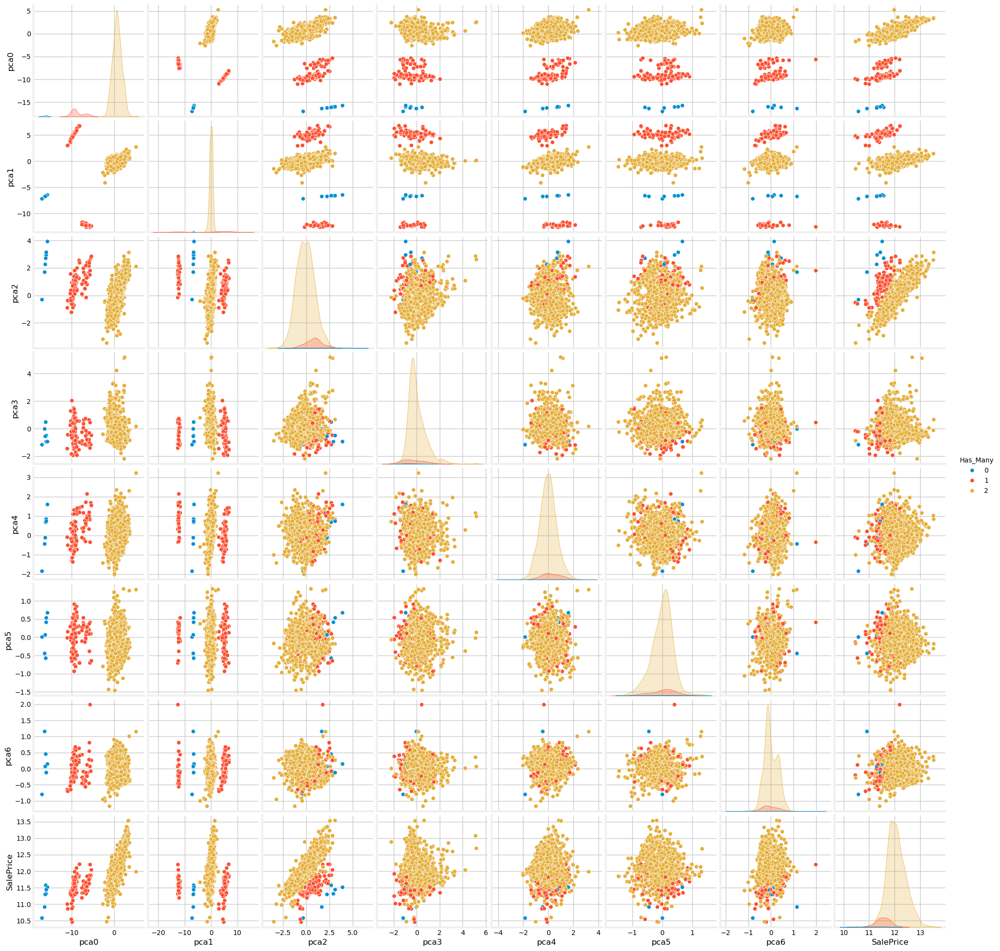

In [129]:
sns.pairplot(data=pd.concat([train_slice1[test_pipe1.named_steps['pca'].pca_columns_+['Has_Many']], y_log], axis=1), diag_kind='kde', hue='Has_Many', palette=palette_538)

The pairplot for the advanced PCA:

In [130]:
train_slice2[train_slice2['Has_Many'] == 0]

,OverallQual,GarageCars,AllBaths,BathsAbvGr,ExterQual,BsmtQual,KitchenQual,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6,Has_Many
39,4,0,2.0,2.0,3,0,2,0,0,-11.984984,4.057761,1.958656,-6.345268,-3.767866,4.300734,10.006028,0
520,4,0,2.0,2.0,3,0,3,0,0,-12.438883,5.151906,1.463169,-6.039919,-4.421369,4.421961,8.893820,0
533,1,0,1.0,1.0,2,0,2,0,0,-15.021993,3.306627,3.949939,-6.009899,-3.094159,2.748755,8.255671,0
705,4,0,2.0,2.0,2,0,2,0,0,-13.308461,4.643494,2.504807,-5.968082,-3.967973,4.819385,8.078164,0
1011,5,0,2.0,2.0,3,0,3,0,0,-11.059461,4.253832,1.427556,-6.452461,-3.841563,4.838355,10.561843,0
1179,5,0,1.0,1.0,3,0,3,0,0,-11.915740,4.530601,1.861333,-6.310704,-3.605720,4.273714,9.959773,0
1218,4,0,1.0,1.0,3,0,3,0,0,-12.740494,4.367883,2.514921,-6.236723,-3.716646,4.115149,9.143041,0


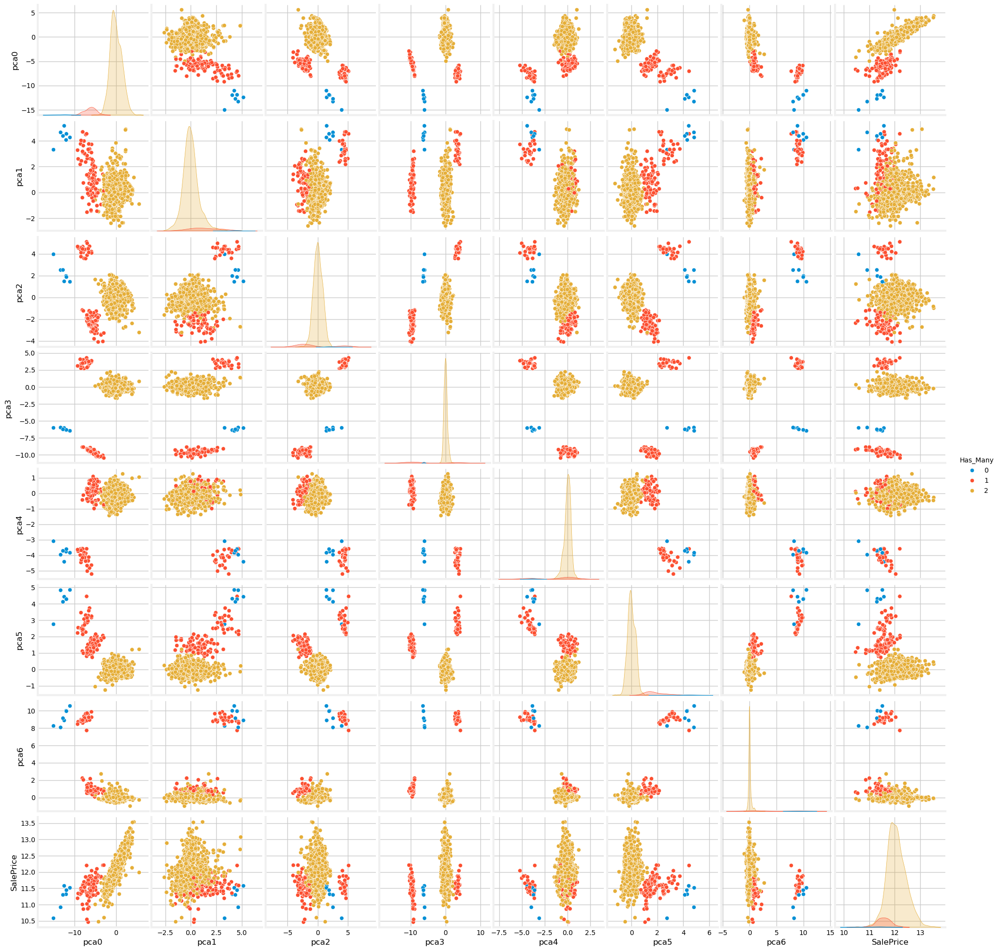

In [131]:
if test_pipe2.named_steps['pca'].n_pcs == None:
    sns.pairplot(data=pd.concat([train_slice2[test_pipe2.named_steps['pca'].pca_columns_ +['Has_Many']], y_log], axis=1), diag_kind='kde', hue='Has_Many', palette=palette_538)

else:
    sns.pairplot(data=pd.concat([train_slice2[test_pipe2.named_steps['pca'].pca_columns_[:test_pipe2.named_steps['pca'].n_pcs]+['Has_Many']], y_log], axis=1), diag_kind='kde', hue='Has_Many', palette=palette_538)

In [132]:
del train_slice1, train_slice2, test_slice1, test_slice2, oof_te, ft, sc, fs, pc1, pc2, test_pipe1, test_pipe2

#### K-means Cluster Feature Creator

First, we create a subclass in charge of creating a `cluster` feature with KMeans. Note that if `n_clusters=0`, then we will not do anything!

In [133]:
class KMeansFeature(TransformerMixin, BaseEstimator):
    """
    Adds a KMeans cluster label as a new feature, with optional scaling of PCA features.

    This transformer fits a KMeans clustering model on the input features and appends a `'cluster'` column to the dataset containing the predicted cluster labels. Optionally, PCA features can be scaled before clustering using a specified method.

    If `n_clusters` is None, the transformer behaves as a passthrough and returns the original DataFrame unchanged.

    Compatible with scikit-learn pipelines.

    Parameters
    ----------
    n_clusters : int or None, default None
        Number of clusters for KMeans. If None, clustering is skipped.
    max_iter : int, default 300
        Maximum number of iterations for a single KMeans run.
    n_init : int, default 10
        Number of times the KMeans algorithm is run with different centroid seeds.
    scaling_method : {'standard', 'robust', 'minmax'} or None, default None
        Optional method for scaling PCA features prior to clustering. If None, no scaling is applied.
    verbose_feature_names_out : bool, default False
        If True, output feature names from transformers include the step name as a prefix.
    random_state : int, default 0
        Seed for reproducibility.

    Attributes
    ----------
    cluster_pipe_ : sklearn.pipeline.Pipeline
        Pipeline combining optional scaling and the fitted KMeans model.
    pca_columns_ : list of str
        List of PCA column names used for scaling (only set if `scaling_method` is used).
    distances_ : np.ndarray
        Distances from each sample to each cluster center (available after `transform`).
    """
    
    def __init__(self, n_clusters=None, max_iter=300, n_init=10, scaling_method=None, verbose_feature_names_out=False, random_state=0):
        
        self.n_clusters   = n_clusters
        self.max_iter     = max_iter
        self.n_init       = n_init
        self.verbose_feature_names_out = verbose_feature_names_out
        self.random_state = random_state

        # the scaler to use:
        self.scaling_method = scaling_method

        if scaling_method == None:
            self.scaler = None
        elif scaling_method == 'standard':
            self.scaler = StandardScaler()
        elif scaling_method == 'robust':
            self.scaler = RobustScaler()
        elif scaling_method == 'minmax':
            self.scaler = MinMaxScaler()
        else:
            raise ValueError(f"{scaler} must be either 'standard', 'robust', or 'minmax'.")

    def fit(self, X, y=None):

        if self.n_clusters == None:
            pass # override: no need to fit KMeans!
        
        else: # will cluster, but first decide whether PCs need to be scaled
            
            if self.scaling_method == None: # no scaling of PCs, apply KMeans directly

                # defining the clustering pipeline
                self.cluster_pipe_ = Pipeline(steps=[("kmeans", KMeans(n_clusters=self.n_clusters,
                                                                       random_state=self.random_state))])
            else: # scaling of PCs needed

                # finding the PCA columns
                self.pca_columns_ = [col for col in X.columns if 'pca' in col]

                # defining the scaler
                pca_scaler = ColumnTransformer(transformers=[('scaler',
                                                              self.scaler,
                                                              self.pca_columns_)],
                                               remainder='passthrough',
                                               verbose_feature_names_out=self.verbose_feature_names_out)

                # defining the KMeans object
                kmeans = KMeans(n_clusters=self.n_clusters,
                                max_iter=self.max_iter,
                                n_init=self.n_init,
                                random_state=self.random_state)

                # defining the clustering pipeline
                self.cluster_pipe_ = Pipeline(steps=[('pca_scaler', pca_scaler),
                                                     ("kmeans", kmeans)])
            
            # fitting the clustering pipeline
            self.cluster_pipe_.fit(X)
            
        return self

    def transform(self, X):

        # Check we got a DataFrame
        if not isinstance(X, pd.DataFrame):
            raise ValueError("FeatureAdder.transform input must be a pandas DataFrame")

        X_out = X.copy() # shallow copy

        if self.n_clusters == None:
            pass

        else:
            
            # distances to centroids
            self.distances_ = self.cluster_pipe_.transform(X_out)

            # column of cluster‐labels (as integers)
            X_clusters = self.cluster_pipe_.predict(X_out)
            
            X_out['cluster'] = X_clusters # adding clusters column!
        
        return X_out

Putting this into pipelines and checking that it all works:

In [134]:
# copying training dataframe
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering + unsupervised encoding + target encoding + function transformer + scaler transformer + feature selector + PCA + clustering

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

ft = SelectorFunctionTransformer(dex_threshold=2.0,
                                 skew_threshold=1.0,
                                 trans_method='log',
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

sc = SelectorScalerTransformer(unique_counts_threshold=10,
                               scaling_method='robust',
                               cont_cols=pruned_cont_cols,
                               encodings=columns_encodings,
                               verbose_feature_names_out=False)

# selector w/ strict thresholds
fs = FeatureSelector(var_thr=0.01,
                     best_k=20,
                     t_thr=0.3,
                     encodings=columns_encodings,
                     random_state=None)

# advanced PCA
pc = PCAFeature(n_pcs=None, # selecting all PCs
                fit_feat_subset=True, # fitting PCA object to subset with has_X = True
                keep_original_feats=False, # dropping the original features
                random_state=0)

km = KMeansFeature(n_clusters=4,
                   max_iter=300,
                   n_init=10,
                   scaling_method='robust',
                   verbose_feature_names_out=False,
                   random_state=0)

test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                            ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                            ('tenc', oof_te),
                            ('transf1', ft),
                            ('transf2', sc),
                            ('selector', fs),
                            ('pca', pc),
                            ('km', km)])

train_slice = test_pipe.fit_transform(train_slice, y_log)

print("Train")
display(train_slice.head())

# now for test dataframe:
test_slice = raw_test.copy()

test_slice = test_pipe.transform(test_slice)

print("Test")
display(test_slice.head())

print("Training distances")
display(test_pipe.named_steps["km"].distances_)

Train


,OverallQual,GarageCars,AllBaths,KitchenQual,BsmtQual,BathsAbvGr,ExterQual,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6,cluster
0,7,2,3.5,4,4,2.5,4,1,1,0.057832,0.173426,0.973890,0.150604,0.033976,0.357826,-0.098799,3
1,6,2,2.5,3,4,2.0,3,1,1,0.815993,1.053090,-0.229411,-0.268268,0.308171,-0.323522,-0.082260,0
2,7,2,3.5,4,4,2.5,4,1,1,0.300230,0.076275,0.846212,0.278599,0.004821,0.328749,-0.110420,3
3,7,3,2.0,4,3,1.0,3,1,1,-0.387486,0.430032,-0.006335,0.736919,-1.239491,-0.473407,-0.176420,3
4,8,3,3.5,4,4,2.5,4,1,1,1.658119,0.242241,0.974969,0.303460,-0.504559,0.009849,-0.172202,3


Test


,OverallQual,GarageCars,AllBaths,KitchenQual,BsmtQual,BathsAbvGr,ExterQual,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6,cluster
0,5,1,1.0,3,3,1.0,3,1,1,-0.845540,-0.211216,0.291427,1.095286,0.247288,-0.444042,-0.184809,0
1,6,1,1.5,4,3,1.5,3,1,1,-0.089165,-0.016273,-0.977713,-0.587907,0.255859,-0.004286,-0.053408,0
2,5,2,2.5,3,4,2.5,3,1,1,-0.264199,-0.789908,0.846752,-0.058865,-0.153889,0.299358,-0.057649,0
3,6,2,2.5,4,3,2.5,3,1,1,0.069928,0.221828,0.720813,-0.125431,0.079244,0.241688,-0.069835,3
4,8,2,2.0,4,4,2.0,4,1,1,1.019220,0.261974,0.462268,-0.400780,-0.015892,-0.414462,-0.025275,3


Training distances


,kmeans0,kmeans1,kmeans2,kmeans3
0,2.316073,48.222461,16.867464,4.529324
1,1.812416,47.694221,14.315226,3.187227
2,2.294255,47.432381,15.250277,3.049514
3,2.229560,47.485283,15.192030,2.130798
4,3.558324,47.681949,15.430575,1.634762
...,...,...,...,...
1454,14.875150,46.170605,1.969617,15.475493
1455,2.380884,47.697852,15.001259,4.779646
1456,1.348671,48.071813,15.905850,3.582682
1457,15.798886,45.303489,2.002411,16.204360


The pairplot:

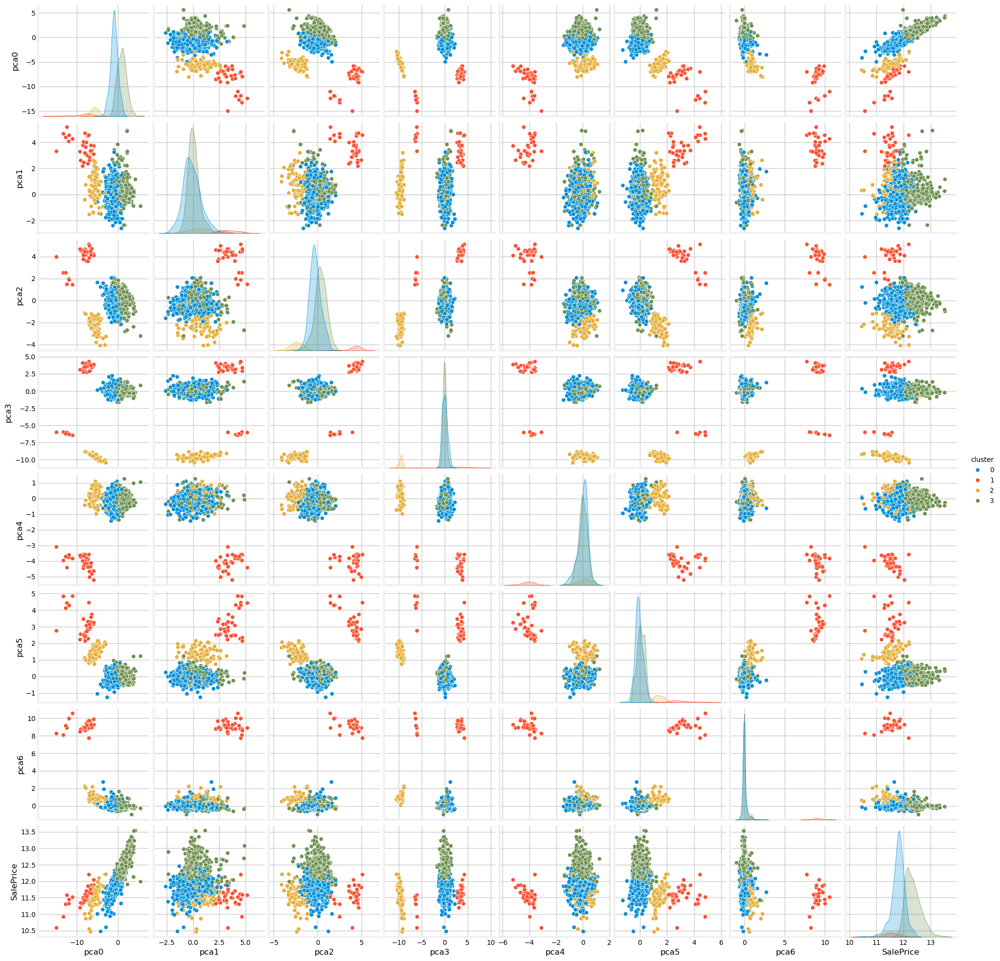

In [135]:
sns.pairplot(data=pd.concat([train_slice[test_pipe.named_steps['pca'].pca_columns_+['cluster']], y_log], axis=1), diag_kind='kde', hue='cluster', palette=palette_538)

In [136]:
del train_slice, test_slice, oof_te, ft, sc, fs, pc, km, test_pipe

#### One-Hot Encoding

Finally, we go over all OHE features, and perform OHE.

In [137]:
def ohe_from_subset(subset=(columns_encodings['ohe']+['cluster']), except_list=[]):
    """
    Creates a selector function that filters object-dtype columns from a given subset.

    This function returns another function that, when called with a DataFrame `X`, returns the list of column names from the provided `subset` that exist in `X` and have an object dtype.

    Parameters
    ----------
    subset : list of str
        A list of column names to consider for object-dtype filtering.

    Returns
    -------
    function
        A selector function that takes a DataFrame and returns a list of object-dtype column names from the subset.
    """
    
    def selector(X):
        
        cols_list = []

        for col in subset:
            if col not in X.columns:
                continue
            if col in except_list:
                continue
            # if pd.api.types.is_integer_dtype(X[col]):
            #     cols_list.append(col)
            else:
                cols_list.append(col)
        
        return cols_list
    
    return selector

Having created that, we define the OHE preprocessor:

In [138]:
def ohe_preprocessor(verbose_feature_names_out=False, subset=(columns_encodings['ohe']+['cluster'])):

    # defining the column selector
    selector = ohe_from_subset(subset=subset, except_list=[])

    # OHE transformer
    ohe_ct = ColumnTransformer(transformers=[('ohe',
                                              OneHotEncoder(handle_unknown='ignore', sparse_output=False, dtype=int),
                                              selector)],
                               remainder='passthrough',
                               verbose_feature_names_out=verbose_feature_names_out)

    # Pipeline
    post_pipe = Pipeline([('ohe', ohe_ct)])

    return post_pipe

Checking it all works:

In [139]:
# copying training dataframe
train_slice = raw_train.copy()
train_slice = train_slice.drop(columns=['SalePrice'])

# cleaning + feature engineering + unsupervised encoding + target encoding + function transformer + scaler transformer + feature selector + PCA + clustering + OHE

oof_te = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                     new_col_suffix="",
                                     n_splits=5,
                                     smoothing=20.0,
                                     random_state=42)

ft = SelectorFunctionTransformer(dex_threshold=2.0,
                                 skew_threshold=1.0,
                                 trans_method='log',
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

sc = SelectorScalerTransformer(unique_counts_threshold=10,
                               scaling_method='robust',
                               cont_cols=pruned_cont_cols,
                               encodings=columns_encodings,
                               verbose_feature_names_out=False)

# selector w/ strict thresholds
fs = FeatureSelector(var_thr=0.01,
                     best_k=20,
                     t_thr=0.3,
                     encodings=columns_encodings,
                     random_state=None)

# advanced PCA
pc = PCAFeature(n_pcs=None, # selecting all PCs
                fit_feat_subset=True, # fitting PCA object to subset with has_X = True
                keep_original_feats=False, # dropping the original features
                random_state=0)

km = KMeansFeature(n_clusters=4,
                   max_iter=300,
                   n_init=10,
                   scaling_method='robust',
                   verbose_feature_names_out=False,
                   random_state=0)

test_pipe = Pipeline(steps=[('cleaning', cleaning_pipeline),
                            ('feature_engineer', FeatureEngineer(func=new_features,
                                                                 kwargs={'has_cols':has_cols})),
                            ('encoder', column_encoder(verbose_feature_names_out=False, encodings=columns_encodings)),
                            ('tenc', oof_te),
                            ('transf1', ft),
                            ('transf2', sc),
                            ('selector', fs),
                            ('pca', pc),
                            ('km', km),
                            ('ohe', ohe_preprocessor(verbose_feature_names_out=False))])

train_slice = test_pipe.fit_transform(train_slice, y_log)

print("Train")
display(train_slice.head())

# now for test dataframe:
test_slice = raw_test.copy()

test_slice = test_pipe.transform(test_slice)

print("Test")
display(test_slice.head())

Train


,cluster_0,cluster_1,cluster_2,cluster_3,OverallQual,GarageCars,AllBaths,BathsAbvGr,ExterQual,KitchenQual,BsmtQual,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6
0,0,0,0,1,7,2,3.5,2.5,4,4,4,1,1,0.057832,0.173426,0.973890,0.150604,0.033976,0.357826,-0.098799
1,1,0,0,0,6,2,2.5,2.0,3,3,4,1,1,0.815993,1.053090,-0.229411,-0.268268,0.308171,-0.323522,-0.082260
2,0,0,0,1,7,2,3.5,2.5,4,4,4,1,1,0.300230,0.076275,0.846212,0.278599,0.004821,0.328749,-0.110420
3,0,0,0,1,7,3,2.0,1.0,3,4,3,1,1,-0.387486,0.430032,-0.006335,0.736919,-1.239491,-0.473407,-0.176420
4,0,0,0,1,8,3,3.5,2.5,4,4,4,1,1,1.658119,0.242241,0.974969,0.303460,-0.504559,0.009849,-0.172202


Test


,cluster_0,cluster_1,cluster_2,cluster_3,OverallQual,GarageCars,AllBaths,BathsAbvGr,ExterQual,KitchenQual,BsmtQual,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5,pca6
0,1,0,0,0,5,1,1.0,1.0,3,3,3,1,1,-0.845540,-0.211216,0.291427,1.095286,0.247288,-0.444042,-0.184809
1,1,0,0,0,6,1,1.5,1.5,3,4,3,1,1,-0.089165,-0.016273,-0.977713,-0.587907,0.255859,-0.004286,-0.053408
2,1,0,0,0,5,2,2.5,2.5,3,3,4,1,1,-0.264199,-0.789908,0.846752,-0.058865,-0.153889,0.299358,-0.057649
3,0,0,0,1,6,2,2.5,2.5,3,4,3,1,1,0.069928,0.221828,0.720813,-0.125431,0.079244,0.241688,-0.069835
4,0,0,0,1,8,2,2.0,2.0,4,4,4,1,1,1.019220,0.261974,0.462268,-0.400780,-0.015892,-0.414462,-0.025275


In [140]:
del train_slice, test_slice, oof_te, ft, sc, fs, pc, km, test_pipe

#### Final Preprocessing Pipelines

In [141]:
from sklearn.base import clone

First, we define the steps:

In [142]:
# cleaning
cln = cleaning_pipeline

# feature engineering
fe = FeatureEngineer(func=new_features,
                     kwargs={'has_cols':has_cols})

# unsupervised encoding
uenc = column_encoder(verbose_feature_names_out=False,
                      encodings=columns_encodings)

# supervised (target) encoding
senc = OOFTargetEncoderTransformer(cols=columns_encodings['target'],
                                   new_col_suffix="",
                                   n_splits=5, # ???
                                   smoothing=20.0, # hyperparam
                                   random_state=42)

# function transformer (log/yeo-johnson)
ft = SelectorFunctionTransformer(dex_threshold=2.0, # ???
                                 skew_threshold=1.0, # ???
                                 trans_method='log', # ???
                                 cont_cols=pruned_cont_cols,
                                 verbose_feature_names_out=False)

# scaler transformer
sc = SelectorScalerTransformer(unique_counts_threshold=10, # ???
                               scaling_method='robust', # ???
                               cont_cols=pruned_cont_cols,
                               encodings=columns_encodings,
                               verbose_feature_names_out=False)

# feature selector (w/ strict thresholds)
fs = FeatureSelector(var_thr=0.01,# ???
                     best_k=20, # hyperparam
                     t_thr=0.3, # hyperparam
                     encodings=columns_encodings,
                     random_state=None)

fs0 = FeatureSelector(var_thr=0.,
                      best_k='all',
                      t_thr=None,
                      encodings=columns_encodings,
                      random_state=None)

# advanced PCA
pc = PCAFeature(n_pcs=None, # ???
                fit_feat_subset=True, # hyperparam
                keep_original_feats=False, # ???
                random_state=0)

# K-Means clustering
km = KMeansFeature(n_clusters=4, # hyperparam
                   max_iter=300, # ???
                   n_init=10, # ???
                   scaling_method='robust', # ???
                   verbose_feature_names_out=False,
                   random_state=0)

# ohe
ohe = ohe_preprocessor(verbose_feature_names_out=False,
                       subset=(columns_encodings['ohe']+['cluster']))

pipeline_hyperparameter_names = ['target_encoder__smoothing', 'selector__best_k', 'selector__t_thr', 'pca__fit_feat_subset', 'pca__keep_original_feats', 'cluster__n_clusters']

Putting together the preprocessing steps into a single pipeline:

In [143]:
raw_pipe = Pipeline(steps=[('cleaning', cln),
                           ('encoder', uenc),
                           ('target_encoder', senc),
                           ('selector', fs0),
                           ('ohe', ohe)])

eng_pipe = Pipeline(steps=[('cleaning', cln),
                           ('feature_engineer', fe),
                           ('encoder', uenc),
                           ('target_encoder', senc),
                           ('transformer', ft),
                           ('scaler', sc),
                           ('selector', fs),
                           ('ohe', ohe)])

clus_pipe = Pipeline(steps=(eng_pipe.steps[:-1] + 
                            [('pca', pc),
                             ('cluster', km),
                             ('ohe', ohe)]))

final_preproc = {'raw':raw_pipe, 'eng':eng_pipe, 'clus':clus_pipe}

In [144]:
preproc = clone(final_preproc['raw'])

proc_data = preproc.fit_transform(X_train, y_train)

display(proc_data.head())

display(preproc.transform(X_val).head())

del preproc, proc_data

,SaleType_0,SaleType_1,SaleType_2,SaleType_3,SaleType_4,SaleType_5,SaleType_6,SaleType_7,SaleType_8,Condition1_0,Condition1_1,Condition1_2,Condition1_3,Condition1_4,Condition1_5,Condition1_6,Condition1_7,Condition1_8,RoofMatl_0,RoofMatl_1,RoofMatl_2,RoofMatl_3,RoofMatl_4,RoofMatl_5,RoofMatl_6,Condition2_0,Condition2_1,Condition2_2,Condition2_3,Condition2_4,Condition2_5,Condition2_6,HouseStyle_0,HouseStyle_1,HouseStyle_2,HouseStyle_3,HouseStyle_4,HouseStyle_5,HouseStyle_6,HouseStyle_7,GarageType_0,GarageType_1,GarageType_2,GarageType_3,GarageType_4,GarageType_5,GarageType_6,Heating_0,Heating_1,Heating_2,Heating_3,Heating_4,Heating_5,Foundation_0,Foundation_1,Foundation_2,Foundation_3,Foundation_4,Foundation_5,SaleCondition_0,SaleCondition_1,SaleCondition_2,SaleCondition_3,SaleCondition_4,SaleCondition_5,RoofStyle_0,RoofStyle_1,RoofStyle_2,RoofStyle_3,RoofStyle_4,RoofStyle_5,Electrical_0,Electrical_1,Electrical_2,Electrical_3,Electrical_4,Fence_0,Fence_1,Fence_2,Fence_3,Fence_4,MiscFeature_0,MiscFeature_1,MiscFeature_2,MiscFeature_3,MiscFeature_4,MSZoning_0,MSZoning_1,MSZoning_2,MSZoning_3,MSZoning_4,BldgType_0,BldgType_1,BldgType_2,BldgType_3,BldgType_4,LotConfig_0,LotConfig_1,LotConfig_2,LotConfig_3,LotConfig_4,MasVnrType_0,MasVnrType_1,MasVnrType_2,MasVnrType_3,LandContour_0,LandContour_1,LandContour_2,LandContour_3,LotShape_0,LotShape_1,LotShape_2,LotShape_3,PavedDrive_0,PavedDrive_1,PavedDrive_2,Alley_0,Alley_1,Alley_2,LandSlope_0,LandSlope_1,LandSlope_2,MSSubClass,LotFrontage,LotArea,Neighborhood,Exterior1st,Exterior2nd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,CentralAir,Street,Utilities,Id,OverallQual,OverallCond,YearBuilt,YearRemodAdd,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,MoSold,YrSold
6,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,1,0,0,1,0,1,0,1,0,0,12.064393,75.0,10084.0,12.246209,12.193288,12.197069,186.0,1369.0,0.0,317.0,1686.0,1694.0,0.0,0.0,1694.0,636.0,255.0,57.0,0.0,0.0,0.0,0.0,0.0,6,1,7,3,2,3,3,4,5,3,5,3,4,4,0,1,1,0,7,8,5,2004,2005,1,0,2,0,3,1,7,1,2004,2,8,2007
807,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,1,0,0,11.982330,144.0,21384.0,11.778892,11.834613,11.850676,0.0,1309.0,0.0,15.0,1324.0,1072.0,504.0,0.0,1576.0,528.0,0.0,312.0,0.0,0.0,0.0,0.0,0.0,6,1,7,4,2,3,3,3,5,3,3,3,3,4,0,1,1,0,808,5,6,1923,2004,2,0,1,1,3,1,6,1,1923,2,5,2009
955,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,1,0,0,0,0,0,1,0,1,0,1,0,0,11.890326,82.0,7136.0,12.176971,11.876455,11.878811,423.0,484.0,0.0,495.0,979.0,979.0,979.0,0.0,1958.0,492.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3,1,7,1,1,3,3,0,3,3,4,3,3,3,0,0,1,0,956,6,6,1946,1950,0,0,2,0,4,2,8,0,1946,2,8,2007
1040,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,1,0,0,12.080472,88.0,13125.0,11.866946,11.860104,11.870375,67.0,168.0,682.0,284.0,1134.0,1803.0,0.0,0.0,1803.0,484.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3,4,3,1,2,3,3,3,5,3,3,3,3,3,0,1,1,0,1041,5,4,1957,2000,1,0,2,0,3,1,8,1,1957,2,1,2006
701,1,0,0

,SaleType_0,SaleType_1,SaleType_2,SaleType_3,SaleType_4,SaleType_5,SaleType_6,SaleType_7,SaleType_8,Condition1_0,Condition1_1,Condition1_2,Condition1_3,Condition1_4,Condition1_5,Condition1_6,Condition1_7,Condition1_8,RoofMatl_0,RoofMatl_1,RoofMatl_2,RoofMatl_3,RoofMatl_4,RoofMatl_5,RoofMatl_6,Condition2_0,Condition2_1,Condition2_2,Condition2_3,Condition2_4,Condition2_5,Condition2_6,HouseStyle_0,HouseStyle_1,HouseStyle_2,HouseStyle_3,HouseStyle_4,HouseStyle_5,HouseStyle_6,HouseStyle_7,GarageType_0,GarageType_1,GarageType_2,GarageType_3,GarageType_4,GarageType_5,GarageType_6,Heating_0,Heating_1,Heating_2,Heating_3,Heating_4,Heating_5,Foundation_0,Foundation_1,Foundation_2,Foundation_3,Foundation_4,Foundation_5,SaleCondition_0,SaleCondition_1,SaleCondition_2,SaleCondition_3,SaleCondition_4,SaleCondition_5,RoofStyle_0,RoofStyle_1,RoofStyle_2,RoofStyle_3,RoofStyle_4,RoofStyle_5,Electrical_0,Electrical_1,Electrical_2,Electrical_3,Electrical_4,Fence_0,Fence_1,Fence_2,Fence_3,Fence_4,MiscFeature_0,MiscFeature_1,MiscFeature_2,MiscFeature_3,MiscFeature_4,MSZoning_0,MSZoning_1,MSZoning_2,MSZoning_3,MSZoning_4,BldgType_0,BldgType_1,BldgType_2,BldgType_3,BldgType_4,LotConfig_0,LotConfig_1,LotConfig_2,LotConfig_3,LotConfig_4,MasVnrType_0,MasVnrType_1,MasVnrType_2,MasVnrType_3,LandContour_0,LandContour_1,LandContour_2,LandContour_3,LotShape_0,LotShape_1,LotShape_2,LotShape_3,PavedDrive_0,PavedDrive_1,PavedDrive_2,Alley_0,Alley_1,Alley_2,LandSlope_0,LandSlope_1,LandSlope_2,MSSubClass,LotFrontage,LotArea,Neighborhood,Exterior1st,Exterior2nd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,BsmtFinType1,BsmtFinType2,Functional,BsmtExposure,GarageFinish,GarageQual,GarageCond,FireplaceQu,HeatingQC,BsmtCond,BsmtQual,ExterCond,ExterQual,KitchenQual,PoolQC,CentralAir,Street,Utilities,Id,OverallQual,OverallCond,YearBuilt,YearRemodAdd,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,MoSold,YrSold
258,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,1,0,0,12.328216,80.0,12435.0,12.156620,12.197532,12.202515,172.0,361.0,0.0,602.0,963.0,963.0,829.0,0.0,1792.0,564.0,0.0,96.0,0.0,245.0,0.0,0.0,0.0,6,1,7,1,2,3,3,3,5,3,4,3,4,4,0,1,1,0,259,7,5,2001,2001,0,0,2,1,3,1,7,1,2001,2,5,2008
267,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,0,1,0,1,0,0,1,0,12.066730,60.0,8400.0,11.922453,11.860564,11.864238,0.0,378.0,0.0,342.0,720.0,1052.0,720.0,420.0,2192.0,240.0,262.0,24.0,0.0,0.0,0.0,0.0,0.0,2,1,7,1,1,3,3,4,5,3,3,3,3,4,0,1,1,0,268,5,8,1939,1997,0,0,2,1,4,1,8,1,1939,1,7,2008
288,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,1,0,0,0,0,0,1,0,1,0,1,0,0,12.073189,71.0,9819.0,11.849816,11.854382,11.858986,31.0,450.0,0.0,432.0,882.0,900.0,0.0,0.0,900.0,280.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4,1,7,1,1,3,3,0,3,3,3,4,3,3,0,1,1,0,289,5,5,1967,1967,0,0,1,0,3,1,5,0,1970,1,2,2010
649,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,1,0,0,11.855874,21.0,1936.0,11.785141,12.178446,12.173958,0.0,131.0,499.0,0.0,630.0,630.0,0.0,0.0,630.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4,6,7,3,0,0,0,0,4,3,4,3,3,3,0,1,1,0,650,4,6,1970,1970,1,0,1,0,1,1,3,0,0,0,12,2007
1233,1,0,0,0,0,0,0,0,0,

In [145]:
preproc = clone(final_preproc['clus'])
preproc.set_params(selector__best_k = 15)
preproc.set_params(cluster__n_clusters = 4)

proc_data = preproc.fit_transform(X_train, y_train)

display(proc_data.head())

del preproc, proc_data

,cluster_0,cluster_1,cluster_2,cluster_3,OverallQual,GarageCars,BathsAbvGr,Has_Garage,Has_Bsmt,pca0,pca1,pca2,pca3,pca4,pca5
6,0,0,0,1,8,2,2.0,1,1,1.772756,-0.171764,0.015144,-0.161851,-0.185245,0.043679
807,1,0,0,0,5,2,1.5,1,1,-0.105555,-0.668343,-0.668265,0.521360,0.058333,-0.539902
955,0,0,0,1,6,2,2.0,1,1,0.225812,0.188284,0.460564,-0.119785,0.353618,-0.207015
1040,1,0,0,0,5,2,2.0,1,1,-0.074082,-1.711240,-0.580741,0.237531,0.276241,0.556976
701,0,0,0,1,7,2,1.5,1,1,0.222658,-0.060077,0.291987,-0.024480,-0.339605,0.014676


In [146]:
del cln, fe, uenc, senc, ft, sc, fs, fs0, pc, km, ohe

### Cleanup

In [147]:
Out.clear()

for name in dir():
    if name.startswith('_') and name[1:].isdigit():
        del globals()[name]

## 6. Pipelines

### Importing Modules

In [286]:
# cross-validation
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, RepeatedKFold

# scoring and evaluation
from sklearn.metrics import root_mean_squared_error as RMSE

from sklearn.metrics import (explained_variance_score,
                             r2_score,
                             mean_absolute_error,
                             mean_squared_error,
                             median_absolute_error,
                             mean_absolute_percentage_error)
# confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, classification_report

# checking if model is fitted
from sklearn.utils.validation import check_is_fitted
from sklearn.exceptions import NotFittedError

# ML explainability
import shap
from sklearn.inspection import permutation_importance, partial_dependence
from scipy.stats import gaussian_kde
from sklearn.tree import plot_tree
from xgboost import plot_tree as xgb_plot_tree

# MODELS
# tree-based
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
# need scaling, or at least it doesn't hurt
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.neighbors import KNeighborsRegressor, NearestNeighbors
from sklearn.svm import SVR, LinearSVR
from sklearn.neural_network import MLPRegressor

# quieting SHAP
import io
import contextlib
import logging

Shut off, SHAP!

In [287]:
logging.getLogger('shap').setLevel(logging.ERROR)

### Useful Definitions

We begin by defining a verbosity function:

In [288]:
# verbosity function
def verbosity(verbose, message):
    """
    A function that helps us print a message only when asked.
    """
    if verbose:
        print(message)
    else:
        pass

Now, some important dictionaries that we will fill during model evaluation:

In [289]:
# defining some important dictionaries, whose keys are the models we will study

pipe = {} # dictionary of model pipelines

# for cross-validation (CV):
param_grid = {} # dictionary of model hyperparameter grids

vol_grid = {} # volume of the CV grid

search = {} # dictionary of model CV searches

best_cv = {} # dictionary of model with best CV performance

Next, creating my own "Regression Report" function:

In [290]:
def regression_report(y_true, y_pred):
    """
    Compute a suite of common regression metrics and return them in a summary DataFrame.

    This function calculates several standard regression evaluation metrics including explained variance, R², MAE, MSE, RMSE, MedAE, and MAPE, and returns them as a pandas DataFrame for easy inspection.

    Parameters
    ----------
    y_true : array-like of shape (n_samples,)
        Ground truth (actual) target values.
    y_pred : array-like of shape (n_samples,)
        Estimated target values predicted by a regression model.

    Returns
    -------
    pd.DataFrame
        A DataFrame with metric names as the index and their corresponding values in a "Value" column.
    """

    metrics = {
        "Explained Variance": explained_variance_score,
        "R2": r2_score,
        "MAE": mean_absolute_error,
        "MSE": mean_squared_error,
        "RMSE": RMSE, # lambda a, b: np.sqrt(mean_squared_error(a, b)),
        "MedAE": median_absolute_error,
        "MAPE": mean_absolute_percentage_error,
    }
    
    results = {name: fn(y_true, y_pred) for name, fn in metrics.items()}
    
    df = pd.DataFrame.from_dict(results, orient="index", columns=["Value"])
    
    return df

Finally, the score dataframe which we will fill up:

In [291]:
# Create a score dataframe
scorecard = pd.DataFrame(index = ['R2 Score Train', 'R2 Score Validation',
                                  'RMSE Train', 'RMSE Validation'])

### Evaluation

We will do cross-validation, and also perform some basic hyperparameter optimization. For that, we need to define a function that defines the pipeline, evaluates the model with cross-validation, computes the metrics, spits out some plots (_e.g._, the confussion matrix), and allocates results to a dictionary. Must take a model/pipeline for argument, the hyperparameter grid, and the CV arguments and such. Also flags for if we want plots, SHAP, permutation importance, etc.

In [292]:
def model_evaluation(model_name, Xytv, perform_cv_randomized=(False,False), scoring='neg_root_mean_squared_error', verbose=False, plots=False, random_state=0, n_jobs=safe_cpus, **kwargs):
    """
    Evaluates a regression model using standard validation or cross-validation, with optional plots and verbosity.

    This function orchestrates a full model evaluation process. It:
    - Retrieves and fits the appropriate pipeline (with or without CV),
    - Evaluates performance using regression metrics (RMSE, R², etc.),
    - Optionally performs grid/randomized search cross-validation,
    - Optionally visualizes predictions and residuals,
    - Stores scores in a shared `scorecard` dictionary.

    Parameters
    ----------
    model_name : str
        The key name of the model in the global pipeline dictionary (`pipe`).
    Xytv : tuple
        A tuple containing (X_train, X_val, y_train, y_val) as separate arrays or DataFrames.
    perform_cv_randomized : tuple of bools, default (False, False)
        Tuple indicating whether to perform cross-validation and whether to use randomized search instead of grid search.
    scoring : str, default 'neg_root_mean_squared_error'
        Scoring function to use for model selection during cross-validation.
    verbose : bool, default False
        If True, prints step-by-step output of the evaluation process.
    plots : bool, default False
        If True, shows prediction vs. target and residual plots.
    random_state : int, default 0
        Seed for all random number generators used (KFold, RandomizedSearchCV, etc.).
    n_jobs : int, default safe_cpus
        Number of parallel jobs to use for grid/randomized search.
    **kwargs : dict
        Additional keyword arguments to be passed to the cross-validation splitter (`RepeatedKFold`) or the CV search (`GridSearchCV` or `RandomizedSearchCV`).

    Returns
    -------
    list of float
        A list containing: [R² on train, R² on validation, RMSE on train, RMSE on validation].

    Side Effects
    ------------
    - Updates the global `scorecard` with the current model’s scores.
    - Optionally updates the global `search` and `best_cv` dictionaries if cross-validation is used.
    - Displays regression metric tables and scatter plots if `verbose` or `plots` are True.
    """


    # splitting the datasets
    Xt, Xv, yt, yv = Xytv

    # splitting the CV and randomized flags
    perform_cv, randomized = perform_cv_randomized

    # the validation key
    val_key = '_cv' if perform_cv else '_no_cv'

    #-------------------------------------------
    # no cross-validation
    if not perform_cv:
        verbosity(verbose, (":"*70) + f"\nWe will evaluate model={model_name} with standard validation.\n" + ":"*70)

        # checking if model is fitted:
        try:
            check_is_fitted(pipe[model_name+'_no_cv'].steps[-1][-1])
            verbosity(verbose, "\n -> Model is already fitted!")

        # if not, fit:
        except NotFittedError:
            verbosity(verbose, "\n -> Fitting the model")
            pipe[model_name+'_no_cv'].fit(Xt, yt)
            verbosity(verbose, "......Done!")

        # predictions
        verbosity(verbose, " -> Making predictions")
        
        yt_pred = pipe[model_name+'_no_cv'].predict(Xt)
        yv_pred = pipe[model_name+'_no_cv'].predict(Xv)
        
        verbosity(verbose, "......Done!")

    #-------------------------------------------
    # cross-validation
    else:
        verbosity(verbose, f"We will evaluate {model_name} with cross-validation.")

        # RSKF
        verbosity(verbose, "\n -> Creating instance of `RepeatedKFold`")

        sig = inspect.signature(RepeatedKFold)
        default_rkf_kwargs = [k for k, v in sig.parameters.items() if v.default is not inspect._empty] # keyword arguments of RepeatedKFold
        rkf_kwargs = {k:v for k, v in kwargs.items() if k in default_rkf_kwargs} # picking arguments in kwargs that are meant for RepeatedKFold
        rkf = RepeatedKFold(random_state=random_state, **rkf_kwargs)
        
        verbosity(verbose, "......Done!")

        # creating the CV search
        verbosity(verbose, " -> Creating the CV search")
        
        # randomized search
        if randomized:
            sig = inspect.signature(RandomizedSearchCV)
            default_cv_search_kwargs = [k for k, v in sig.parameters.items() if v.default is not inspect._empty] # keyword arguments of RandomizedSearchCV
            cvsearch_kwargs = {k:v for k, v in kwargs.items() if k in default_cv_search_kwargs} # picking arguments in kwargs that are meant for RandomizedSearchCV

            searcher = RandomizedSearchCV(pipe[model_name],
                                          param_distributions=param_grid[model_name],
                                          cv=rkf,
                                          scoring=scoring,
                                          n_jobs=n_jobs,
                                          random_state=random_state,
                                          # error_score="raise",
                                          **cvsearch_kwargs)

        # grid search
        else:
            searcher = GridSearchCV(pipe[model_name],
                                    param_grid=param_grid[model_name],
                                    cv=rkf,
                                    scoring=scoring,
                                    # error_score="raise",
                                    n_jobs=n_jobs)

        verbosity(verbose, "......Done!")

        # checking if model is fitted:
        # first, check that the model_name is in the 'search' dictionary, and that it has attribute "best_estimator_" (which indicates it is fitted)
        if (model_name in search.keys()) and hasattr(search[model_name], "best_estimator_"):
            verbosity(verbose, "\n -> Model is already fitted!")
        else:
            # then it is either not in the 'search' dictionary, or it is but it is not fit:
            search[model_name] = searcher
            verbosity(verbose, "\n -> Fitting the model")
            search[model_name].fit(Xt, yt)
            verbosity(verbose, "......Done!")

        # picking the best from CV
        best_cv[model_name] = {}
        best_cv[model_name]['pipe'] = search[model_name].best_estimator_
        best_cv[model_name]['model'] = best_cv[model_name]['pipe'].named_steps['model']
        best_cv[model_name]['score'] = search[model_name].best_score_
        best_cv[model_name]['params'] = search[model_name].best_params_

        if verbose:
            print(" -> CV Results:")
            print(f"\t\tbest {scoring}: {best_cv[model_name]['score']}")
            print(f"\t\tbest params: {best_cv[model_name]['params']}")
            # print("\n")
            # print("."*100)
            # for score, std, params in zip(search[model_name].cv_results_['mean_test_score'], search[model_name].cv_results_['std_test_score'], search[model_name].cv_results_['params']):
            #     print(f"mean CV {scoring} score: {score:.4f} +- {std:.4e} --> {params}")
            verbosity(verbose, "......Done!")

        # predictions
        verbosity(verbose, " -> Making predictions")
        
        yt_pred = best_cv[model_name]['pipe'].predict(Xt)
        yv_pred = best_cv[model_name]['pipe'].predict(Xv)
        
        verbosity(verbose, "......Done!")


    #-------------------------------------------
    # classification report
    verbosity(verbose, " -> Creating Regression Reports")
    
    rr_train = regression_report(y_true=yt, y_pred=yt_pred)
    rr_val = regression_report(y_true=yv, y_pred=yv_pred)
    
    verbosity(verbose, "......Done!")

    # printing classification reports
    if verbose:
        print("\n")
        print("Regression Report: Training\n"+"."*50)
        display(rr_train)
        print("\n")
        print("Regression Report: Validation\n"+"."*50)
        display(rr_val)

    #-------------------------------------------
    # computing scores:
    verbosity(verbose, "\n -> Computing Scores")

    # ['R2 Score Train', 'R2 Score Validation', 'RMSE Train', 'RMSE Validation']

    r2t = rr_train.loc["RMSE", "Value"]
    r2v = rr_val.loc["R2", "Value"]
    rmset = rr_train.loc["RMSE", "Value"]
    rmsev = rr_val.loc["RMSE", "Value"]

    model_score = [r2t, r2v, rmset, rmsev]
        
    verbosity(verbose, "......Done!")

    #-------------------------------------------
    if plots:

        fig, ax = plt.subplots(1, 2, figsize=(11,4))

        print("*"*50 + "\nPrediction and Residual Plots:")

        # Prediction vs. Target Plot
        # Training
        ax[0].scatter(yt_pred, yt,
                      color=palette_538[0],
                      label=f"Training (RMSE={rmset:0.3f})",
                      alpha=0.7)

        # Validation
        ax[0].scatter(yv_pred, yv,
                      color=palette_538[1],
                      label=f"Validation (RMSE={rmsev:0.3f})",
                      alpha=0.7)

        # diagonal line
        smallest = min([min(lst) for lst in [yt_pred, yt, yv_pred, yv]])
        largest = max([max(lst) for lst in [yt_pred, yt, yv_pred, yv]])      
        diag = np.linspace(smallest*0.99, largest*1.01)
        
        ax[0].plot(diag, diag, color='k', alpha=0.5)
        
        ax[0].set_xlabel("Prediction")
        ax[0].set_ylabel("Target")
        ax[0].set_title("Prediction vs. Target")
        ax[0].legend()

        # Residuals Plot
        # Training
        ax[1].scatter(yt_pred, yt-yt_pred,
                      color=palette_538[0],
                      label=f"Training (RMSE={rmset:0.3f})",
                      alpha=0.7)

        # Vertical dashed lines to x-axis
        for ypred, ytrue in zip(yt_pred, yt):
            error = ytrue-ypred
            ax[1].plot([ypred, ypred], [0, error],
                       lw=1,
                       color=palette_538[0],
                       alpha=0.3)

        # Validation
        ax[1].scatter(yv_pred, yv-yv_pred,
                      color=palette_538[1],
                      label=f"Validation (RMSE={rmsev:0.3f})",
                      alpha=0.7)

        # Vertical dashed lines to x-axis
        for ypred, ytrue in zip(yv_pred, yv):
            error = ytrue-ypred
            ax[1].plot([ypred, ypred], [0, error],
                       lw=1,
                       color=palette_538[1],
                       alpha=0.3)

        # horizontal line
        ax[1].plot(diag, np.zeros_like(diag), color='k', alpha=0.5)

        ax[1].set_xlabel("Prediction")
        ax[1].set_ylabel("Residual")
        ax[1].set_title("Prediction vs. Residuals")
        ax[1].legend()

        plt.tight_layout()
        plt.show()

    #-------------------------------------------
    # updating scorecard
    scorecard[model_name+val_key] = model_score

    #-------------------------------------------
    # returning the model's score

    return scorecard[model_name+val_key]

### Explanation

We begin by defining a function that helps us visualize a model, by plotting some useful figures:

In [293]:
def model_visualization(fitted_pipeline, Xytv,
                        feature_names,
                        selected_features=None, tree_idx=0):
    """
    Visualizes diagnostic plots for a trained regression model and its preprocessing pipeline.

    Depending on the model type, this function generates relevant visualizations such as:
    - Decision trees (for tree-based models),
    - Coefficient heatmaps (for linear models),
    - Support vectors (for SVMs),
    - Distance histograms (for KNN),
    - Architecture summaries (for MLPs),
    - Partial dependence plots (PDPs) for selected features.

    Parameters
    ----------
    fitted_pipeline : sklearn.pipeline.Pipeline
        A trained pipeline object containing preprocessing steps followed by the final model.
    Xytv : tuple
        A tuple containing (X_train, X_val, y_train, y_val), where Xs are DataFrames and ys are Series.
    feature_names : list or pd.Index
        Names of the features after preprocessing (used in plotting and interpretation).
    selected_features : tuple of str, optional
        Tuple of two feature names to use for 2D visualizations (e.g., SVM, PDP).
    tree_idx : int, default 0
        Index of the tree to plot from tree-based models like RandomForest or XGBoost.

    Raises
    ------
ValueError
        If input `X` is not a pandas DataFrame or if required plot types cannot be generated.

    Notes
    -----
    - This function currently supports models like `DecisionTreeRegressor`, `RandomForestRegressor`, `XGBRegressor`, `LinearRegression`, `SVR`, `LinearSVR`, `KNeighborsRegressor`, `MLPRegressor`, `Lasso`, and `Ridge`.
    - Feature names must match those after preprocessing, especially if transformers modify names.
    - Partial dependence plots (`pdp`) are only shown for the first feature in `selected_features`.

    Displays
    --------
    A matplotlib figure with relevant subplots for the model type.
    """


    # splitting the pipeline into preprocessing steps and the actual model
    preproc = fitted_pipeline[:-1] # all preprocessing steps
    model = fitted_pipeline[-1] # model

    # splitting the datasets
    Xt, Xv, yt, yv = Xytv

    # processing the features with the fitted pipeline
    Xt = preproc.transform(Xt)
    Xv = preproc.transform(Xv)
    
    # Ensure feature_names is a list
    if isinstance(feature_names, (pd.Index, np.ndarray)):
        feature_names = list(feature_names)

    # finding the numerical names of the first two selected columns/features
    first_feat_idx = Xt.columns.get_loc(selected_features[0])
    second_feat_idx = Xt.columns.get_loc(selected_features[1])

    # Determine which plots apply
    plots = []
    if isinstance(model, DecisionTreeRegressor):
        plots += ['tree', 'pdp']
    elif isinstance(model, RandomForestRegressor):
        plots += ['rf_tree', 'pdp']
    elif isinstance(model, XGBRegressor):
        plots += ['xgb_tree', 'pdp']
    elif isinstance(model, LinearRegression):
        plots += ['linreg', 'pdp']
    elif isinstance(model, SVR) or isinstance(model, LinearSVR):
        plots += ['svm_sv', 'pdp']
    elif isinstance(model, KNeighborsRegressor):
        plots += ['knn_dist', 'pdp']
    elif isinstance(model, MLPRegressor):
        plots += ['mlp_arch', 'pdp']
    elif isinstance(model, Lasso):
        plots += ['lasso', 'pdp']
    elif isinstance(model, Ridge):
        plots += ['ridge', 'pdp']

    # Setup plot grid
    nplots = len(plots)
    ncols = 2
    nrows = int(np.ceil(nplots / ncols))
    fig, axes = plt.subplots(nrows, ncols, figsize=(6*ncols, 5*nrows))
    axes = axes.flatten()

    # setup palette
    palette = palette_538

    # Plot loop
    for ax, ptype in zip(axes, plots):
        if ptype == 'tree':
            # decision tree plot for DT
            plot_tree(model, filled=True, feature_names=feature_names, ax=ax)
            ax.set_title('Decision Tree')

        elif ptype == 'rf_tree':
            # decision tree plot for one of the RF trees
            plot_tree(model.estimators_[tree_idx], filled=True,
                      feature_names=feature_names,
                      ax=ax)
            ax.set_title('RandomForest First Tree')

        elif ptype == 'xgb_tree':
            # decision tree plot for one of the XGB trees
            xgb_plot_tree(model, tree_idx=tree_idx, ax=ax)
            ax.set_title('XGBoost First Tree')

        elif (ptype == 'linreg') or (ptype == 'lasso') or (ptype == 'ridge'):
            # Heatmap of the lin-regression/lasso/ridge coefficients
            
            if ptype == 'linreg':
                title_name = "LinReg"
                post = ''
            elif ptype == 'lasso':
                title_name = "Lasso"
                post = ' (sparse)'
            elif ptype == 'ridge':
                title_name = "Ridge"
                post = ' (shrunk)'

            coef_mat = pd.DataFrame([model.coef_], columns=feature_names)
            
            sns.heatmap(coef_mat,
                        cmap="vlag",
                        xticklabels=feature_names,
                        yticklabels=[title_name],
                        annot=True,
                        fmt=".2f",
                        ax=ax)
            ax.set_title(title_name+' Coefficients Heatmap'+post)

        elif ptype == 'knn_dist':
            # neighbors of KNN model
            nbrs = NearestNeighbors(n_neighbors=model.n_neighbors).fit(Xt)
            # distances
            dists, _ = nbrs.kneighbors(Xt)
            kth = dists[:, -1]
            # histogram of distances
            sns.histplot(kth, bins=20, ax=ax)
            ax.set_title(f'KNN Distances (k={model.n_neighbors})')
            ax.set_xlabel('Distance to k-th neighbor')

        elif ptype == 'mlp_arch':
            # MLP architecture (very simple)
            ax.axis('off')
            
            output_dim = 1  # For single-target regression (or modify if multi-target)
            arch = [Xt.shape[1]] + list([model.hidden_layer_sizes]) + [output_dim]
            txt = '\n'.join(f'Layer {i}: {n} neurons' for i, n in enumerate(arch))
            ax.text(0.1, 0.5, txt, fontsize=12)
            ax.set_title('MLP Architecture')

        elif ptype == 'svm_sv':

            # concatenating the training data, for easier color identification based on target
            Xyt = pd.concat([Xt, yt], axis=1)

            # scatterplot of training data
            sns.scatterplot(data=Xyt, x=selected_features[0], y=selected_features[1], ax=ax)

            # support vectors (SVs) from SVM model
            sv = model.support_vectors_        

            # selecting the indices of those rows in the training data corresponding to the SVs
            idxs = model.support_

            # locating SVs (and their target values) in the training data
            sv_ys = Xyt.iloc[idxs]
            # selecting the target names
            sv_ys = sv_ys[[yt.name]]
            # turning SVs arrays into pd.DataFrame
            sv = pd.DataFrame(sv, index=idxs)
            # plugging their target values
            svy = pd.concat([sv, sv_ys], axis=1)
            # defining the SVs' column names
            svy.columns=Xyt.columns
            
            # scatterplot of the SVs, superimposed on previous scatterplot
            sns.scatterplot(data=svy, x=selected_features[0], y=selected_features[1], marker='s', s=50, ax=ax)
            ax.set_xlabel(selected_features[0])
            ax.set_ylabel(selected_features[1])
            ax.set_title('SVM Support Vectors')

        elif ptype == 'pdp': # partial dependence plots

            # selecting the feature whose PDP we want to study
            feature_name = selected_features[0] # pick only the most important feature

            # computing partial dependences
            pdp_results = partial_dependence(model, Xv, [feature_name],
                                             feature_names=[feature_name],
                                             kind='average', grid_resolution=100)
            
            # extracting the data from the above results
            grid_values   = pdp_results['grid_values'][0] # pick 1D array of feature values
            averages = pdp_results['average'] # shape = (n_classes, len(grid))

            # PDP curve
            ax.plot(grid_values, averages[0], color=palette[0])

            ax.set_title(f'PDP of "{feature_name}"')
            ax.set_xlabel(feature_name)
            ax.set_ylabel('Partial dependence')

    # Remove unused axes
    for j in range(len(plots), len(axes)):
        axes[j].axis('off')

    fig.tight_layout()
    plt.show()

Now, defining a function to explain the model

In [294]:
def explain_model(model_name, fitted_pipeline, Xytv, selected_features=None, tree_idx=0, random_state=0):
    """
    A function that performs ML explainability on a given model.
    - model_name: name of the model in question
    - fitted_pipeline: complete pipeline, trained
    - Xytv: training and validation feature and target data arrays (X_train, X_val, y_train, y_val)
    - selected_features: optional tuple of two feature names for 2D plots
    - tree_idx: index denoting the tree to plot, in tree-based, forest models
    """

    # splitting the pipeline into preprocessing steps and the actual model
    preproc = fitted_pipeline[:-1] # preprocessing
    model = fitted_pipeline[-1] # model

    # splitting the datasets
    Xt, Xv, yt, yv = Xytv

    # processing the features with the fitted pipeline
    Xt_processed = preproc.transform(Xt)
    # Xt = Xt_processed
    Xv_processed = preproc.transform(Xv)

    # Permutation Importance
    print("*"*100 + "\nPerforming Permutation Importance:\n" + "."*50)

    # computing importances
    perm_import = permutation_importance(model, Xv_processed, yv, random_state=random_state)

    # zipping feature names and the means and stds of the importances
    feat_import = zip(Xv_processed.columns, perm_import['importances_mean'], perm_import['importances_std'])

    # sorting from highest to lowest means
    feat_import = sorted(feat_import, key=itemgetter(1), reverse=True)

    # printing
    print("The model's features are:\n")
    print([feat for feat, _, _ in feat_import])
    print("The most important features are:\n")
    for feat, mean, std in feat_import:
        print("\t"+feat+":", mean, "+-", std)
    print("\n" + ("*"*100) + "\n")

    # preparing for the explanatory plots
    # selecting the two most important features
    important_features = [column for column, importance, _ in feat_import][:2]

    # the featuresto plot: if selected_features == None pick the two most important ones
    feats_to_plot = important_features if selected_features == None else selected_features

    # plots from model_visualization function
    model_visualization(fitted_pipeline, Xytv,
                        Xv_processed.columns,
                        selected_features=feats_to_plot, tree_idx=tree_idx)
    

    # SHAP
    tree_model = any([isinstance(model, DecisionTreeRegressor), isinstance(model, RandomForestRegressor), isinstance(model, XGBRegressor)])

    with contextlib.redirect_stdout(io.StringIO()):

        smaller_Xv = shap.sample(Xv_processed, 50)
        smaller_Xt = shap.sample(Xt_processed, 50)

        # shap.sample(X_train, 100)
        
        if tree_model:
            explainer = shap.TreeExplainer(model)
            shap_values = explainer.shap_values(smaller_Xv)
        elif ('linreg' in model_name) or ('lasso' in model_name) or ('ridge' in model_name):
            explainer = shap.LinearExplainer(model, smaller_Xt)
            shap_values = explainer.shap_values(smaller_Xv)
        elif any([('svr' in model_name), ('knn' in model_name), ('mlp' in model_name)]):
            explainer = shap.KernelExplainer(model.predict, smaller_Xt)
            shap_values = explainer.shap_values(smaller_Xv)
        else:
            pass

        plt.figure()
        shap.summary_plot(shap_values, smaller_Xv, show=False)
        plt.title('Target SHAPs')
        plt.tight_layout()
        plt.show()

    pass

### Cleanup

In [295]:
Out.clear()

for name in dir():
    if name.startswith('_') and name[1:].isdigit():
        del globals()[name]

## 7. **TODO**: Models

**TODO**:

1. ~Cleaning~
2. ~Feature Engineering (use function, improve it?)~
3. ~Encoding of all vars but target (wait until next step) and OHE (do label-encoding) [take columns_encodings dictionary as input!]~
4. ~Target Encoding [take columns_encodings dictionary as input!, make sure smoothing and other hyperparameters can be called by GridSearch!]~    **[hyperparameters!]**
5. ~Column preprocessor: transform (logify or yeo-johnson) [take columns_encodings dictionary as input!, make sure scaling method can be called as hyperparameter]~    **[hyperparameters!]**
6. ~Select best features (how? perform mi)~    **[hyperparameters!]**
7. ~PCA (check chat, use de-centering of non-zero features?)~    **[hyperparameters!]**
8. ~Clusters (may need to rescale PCs!)~    **[hyperparameters!]**
9. ~Update KMeansFeature Docstring~
10. ~OHE encoding for all OHE vars + clusters~
11. Rescale new features (e.g. PCs? May be necessary for distance-based models)
12. Pipelines & Model Evaluation (make sure all hyperparameters are accounted for, e.g. smoothing in target encoder, or mi and R thresholds!).
13. Update n_iter, n_splits, n_repeats
14. Also change evaluation" instead of plotting confusion matrix and reporting f1-score cards, plot predicted vs. real SalePrice, for test and validation (hue); and RMSE score

### Importing Modules

In [296]:
import contextlib, io
from contextlib import contextmanager

from scipy.stats import uniform, loguniform

### Model 0: Baseline (`RandomForestRegressor`)

In [297]:
model = 'rfr'

model_name = model+'_base' # full model name

preproc_pipe = clone(final_preproc['raw'])

pipe[model_name+'_no_cv'] = Pipeline(steps=[('preprocessor', preproc_pipe),
                                            ('model', RandomForestRegressor(random_state=0))])

***************************************************************************
rfr_base 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=rfr_base with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.979879
R2,0.979878
MAE,0.037077
MSE,0.003146
RMSE,0.056091
MedAE,0.025217
MAPE,0.003094




Regression Report: Validation
..................................................


,Value
Explained Variance,0.891662
R2,0.891477
MAE,0.094334
MSE,0.018188
RMSE,0.134864
MedAE,0.068203
MAPE,0.007934



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


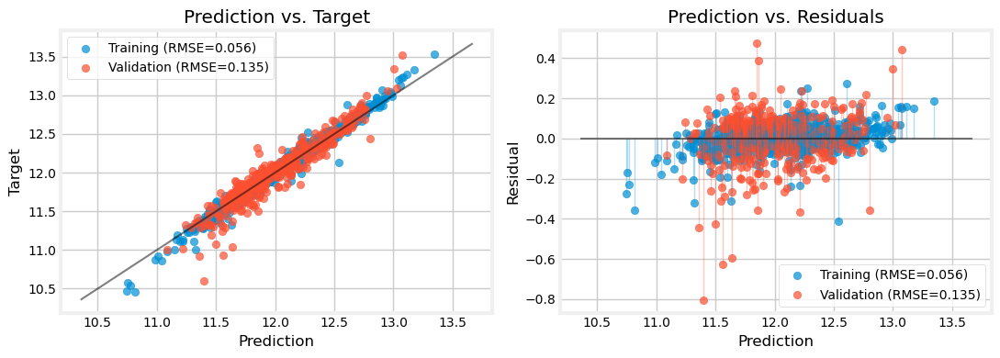

R2 Score Train         0.056091
R2 Score Validation    0.891477
RMSE Train             0.056091
RMSE Validation        0.134864
Name: rfr_base_no_cv, dtype: float64

In [298]:
print("*"*75)
print(model_name, "\n")
print("*"*75)

model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                 perform_cv_randomized=(False, False),
                 verbose=True, plots=True)

In [299]:
scorecard

,rfr_base_no_cv
R2 Score Train,0.056091
R2 Score Validation,0.891477
RMSE Train,0.056091
RMSE Validation,0.134864


### Model 1: `DecisionTreeRegressor`

Defining the pipelines and hyperparameter grids:

In [300]:
model = 'dtr'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] = Pipeline(steps=[('preprocessor',
                                        preproc_pipe),
                                       ('model',
                                        DecisionTreeRegressor(random_state=0))])

    pipe[model_name+'_no_cv'] = Pipeline(steps=[('preprocessor',
                                                 preproc_pipe),
                                                ('model',
                                                 DecisionTreeRegressor(random_state=0))])

    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
            [False, True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [True, False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__max_leaf_nodes'] =\
        list(range(2, 11))
    param_grid[model_name]['model__max_depth'] =\
        list(range(1,11))

Performing the evaluation and explanation of the model:

Time: 11:38:46
***************************************************************************
dtr_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=dtr_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,1.000000e+00
R2,1.000000e+00
MAE,4.866731e-18
MSE,8.645051e-33
RMSE,9.297877e-17
MedAE,0.000000e+00
MAPE,4.008333e-19




Regression Report: Validation
..................................................


,Value
Explained Variance,0.751384
R2,0.751352
MAE,0.139219
MSE,0.041673
RMSE,0.204140
MedAE,0.091731
MAPE,0.011718



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


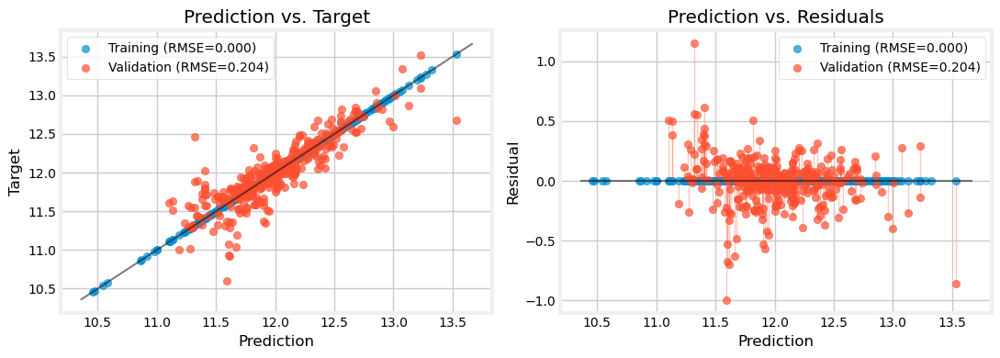



..................................................

Elapsed time: 0.02 minutes
..................................................



Time: 11:38:47
***************************************************************************
dtr_raw , 	CV: True 

***************************************************************************
We will evaluate dtr_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.22058625187831152
		best params: {'model__max_depth': 5, 'model__max_leaf_nodes': 10, 'preprocessor__selector__best_k': 10, 'preprocessor__selector__t_thr': 0.8052683193684647, 'preprocessor__target_encoder__smoothing': 40.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.723822
R2,0.723822
MAE,0.154623
MSE,0.043184
RMSE,0.207807
MedAE,0.120543
MAPE,0.012906




Regression Report: Validation
..................................................


,Value
Explained Variance,0.701014
R2,0.697498
MAE,0.167015
MSE,0.050699
RMSE,0.225165
MedAE,0.132321
MAPE,0.014056



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


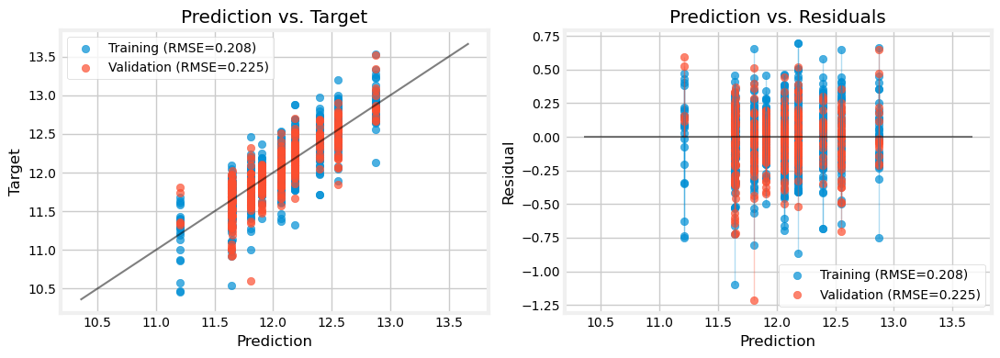



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['OverallQual', 'GarageCars', 'GrLivArea', 'YearBuilt', 'KitchenQual', 'BsmtQual']
The most important features are:

	OverallQual: 0.5222582899312422 +- 0.04517190186001184
	GarageCars: 0.15805852426059427 +- 0.010619415126515711
	GrLivArea: 0.11308552901778571 +- 0.008245597753760124
	YearBuilt: 0.03704198569948016 +- 0.004364848677896702
	KitchenQual: 0.0 +- 0.0
	BsmtQual: 0.0 +- 0.0

****************************************************************************************************



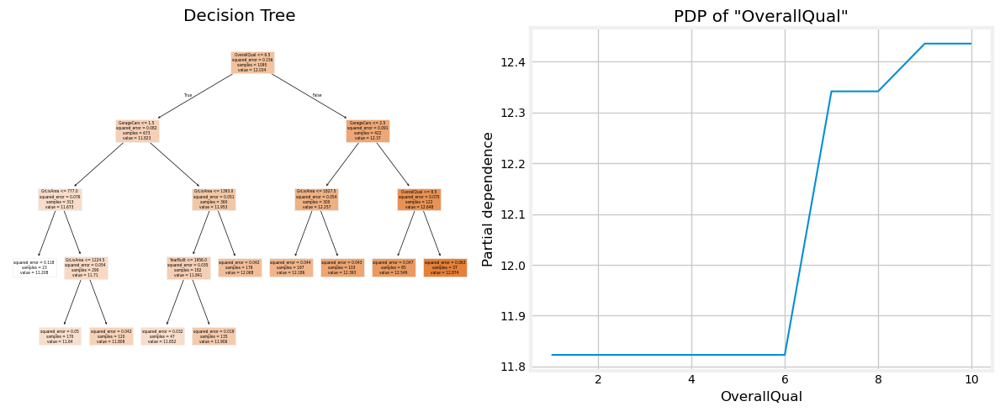

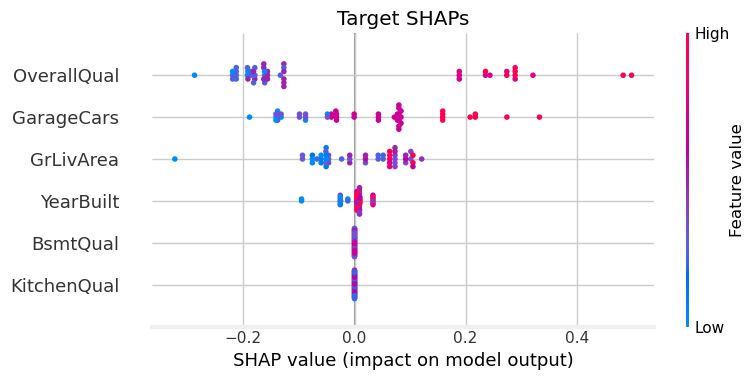

..................................................

Elapsed time: 1.65 minutes
..................................................



Time: 11:40:26
***************************************************************************
dtr_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=dtr_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.999963
R2,0.999963
MAE,0.000156
MSE,0.000006
RMSE,0.002394
MedAE,0.000000
MAPE,0.000013




Regression Report: Validation
..................................................


,Value
Explained Variance,0.772228
R2,0.772228
MAE,0.136754
MSE,0.038175
RMSE,0.195383
MedAE,0.096992
MAPE,0.011512



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


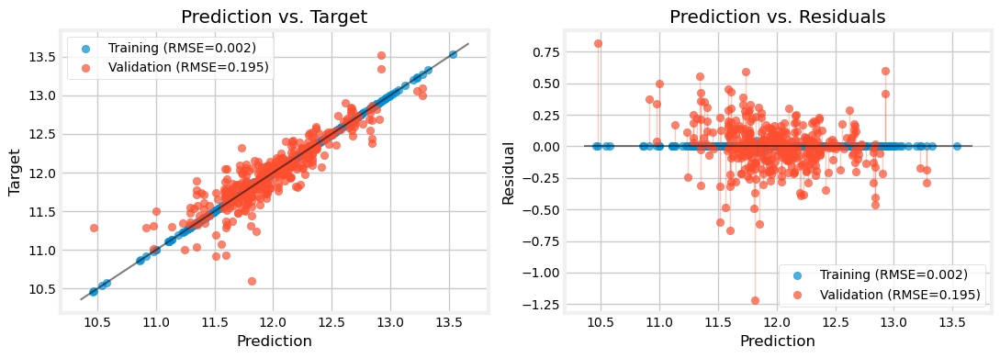



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 11:40:28
***************************************************************************
dtr_eng , 	CV: True 

***************************************************************************
We will evaluate dtr_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.2040397979771199
		best params: {'model__max_depth': 9, 'model__max_leaf_nodes': 10, 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.5556947247386453, 'preprocessor__target_encoder__smoothing': 30.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.778597
R2,0.778597
MAE,0.135803
MSE,0.034619
RMSE,0.186062
MedAE,0.101249
MAPE,0.011340




Regression Report: Validation
..................................................


,Value
Explained Variance,0.788340
R2,0.787640
MAE,0.142848
MSE,0.035591
RMSE,0.188657
MedAE,0.109797
MAPE,0.011962



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


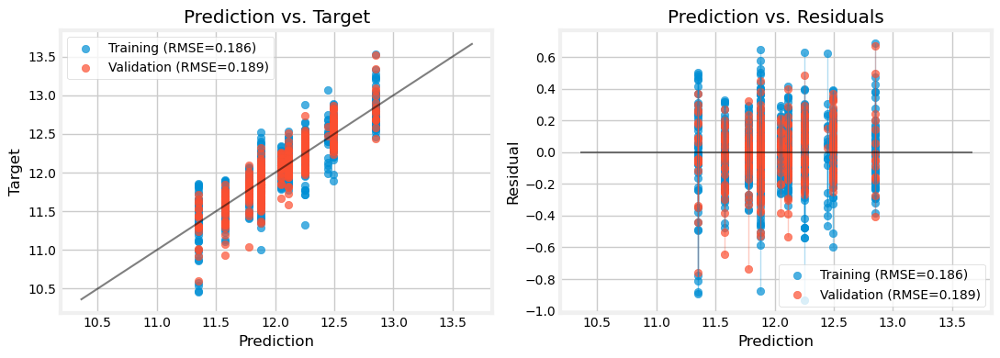



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['TotalSF', 'OverallQual', 'Neighborhood', 'OverallQualCond', 'GarageCars', 'GarageArea', 'TotalBsmtSF', 'BathsAbvGr', 'AllBaths', 'ExterQual', 'BsmtQual', 'KitchenQual', 'Has_Garage', 'Has_Bsmt']
The most important features are:

	TotalSF: 0.4676830853533243 +- 0.03047871387304381
	OverallQual: 0.41637689046157494 +- 0.039804558095548954
	Neighborhood: 0.1388761425532036 +- 0.010747426812051245
	OverallQualCond: 0.034883486826349654 +- 0.0074371085639381666
	GarageCars: 0.0 +- 0.0
	GarageArea: 0.0 +- 0.0
	TotalBsmtSF: 0.0 +- 0.0
	BathsAbvGr: 0.0 +- 0.0
	AllBaths: 0.0 +- 0.0
	ExterQual: 0.0 +- 0.0
	BsmtQual: 0.0 +- 0.0
	KitchenQual: 0.0 +- 0.0
	Has_Garage: 0.0 +- 0.0
	Has_Bsmt: 0.0 +- 0.0

*************************************************************************************

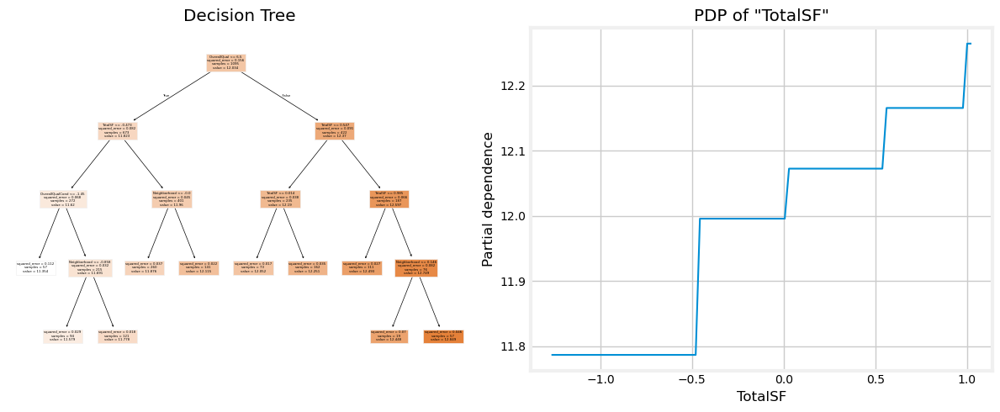

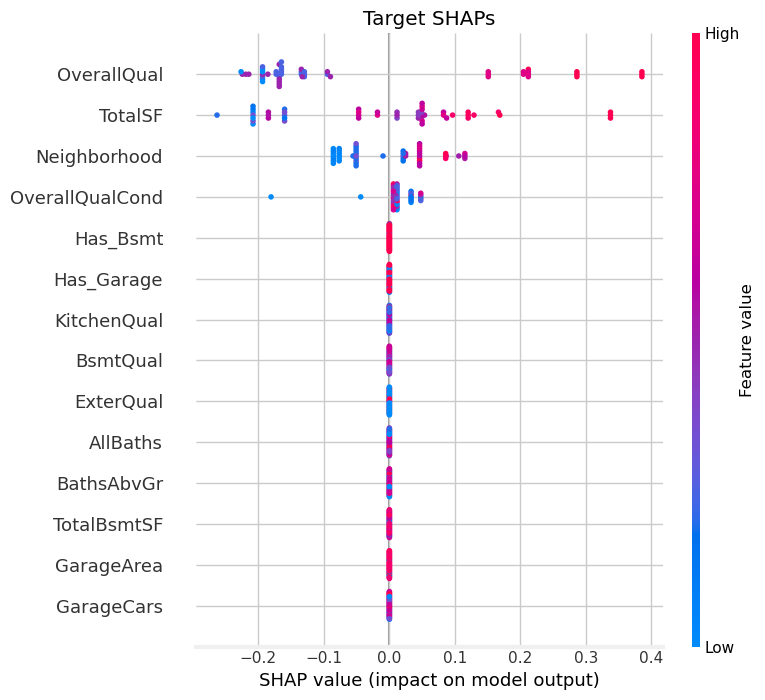

..................................................

Elapsed time: 2.12 minutes
..................................................



Time: 11:42:36
***************************************************************************
dtr_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=dtr_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.999963
R2,0.999963
MAE,0.000156
MSE,0.000006
RMSE,0.002394
MedAE,0.000000
MAPE,0.000013




Regression Report: Validation
..................................................


,Value
Explained Variance,0.774298
R2,0.773686
MAE,0.138765
MSE,0.037930
RMSE,0.194757
MedAE,0.098418
MAPE,0.011636



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


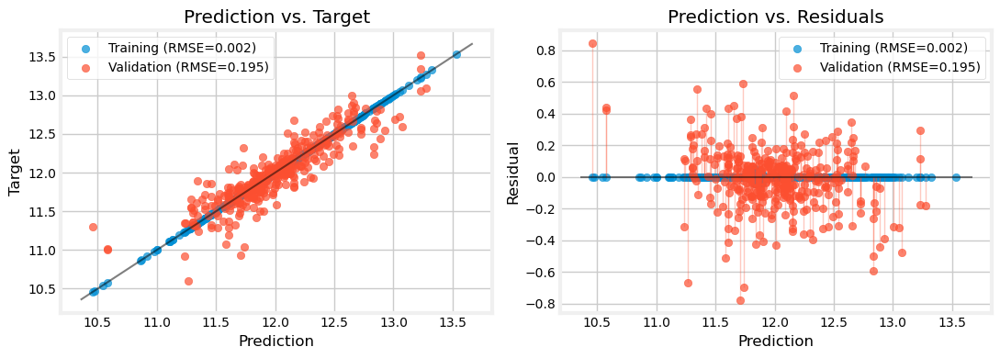



..................................................

Elapsed time: 0.05 minutes
..................................................



Time: 11:42:39
***************************************************************************
dtr_clus , 	CV: True 

***************************************************************************
We will evaluate dtr_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.19115992215437239
		best params: {'model__max_depth': 10, 'model__max_leaf_nodes': 9, 'preprocessor__cluster__n_clusters': 4, 'preprocessor__pca__fit_feat_subset': True, 'preprocessor__pca__keep_original_feats': False, 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.15224336572142416, 'preprocessor__target_encoder__smoothing': 30.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
....

,Value
Explained Variance,0.802847
R2,0.802847
MAE,0.129401
MSE,0.030827
RMSE,0.175577
MedAE,0.097501
MAPE,0.010807




Regression Report: Validation
..................................................


,Value
Explained Variance,0.784729
R2,0.784581
MAE,0.141289
MSE,0.036104
RMSE,0.190011
MedAE,0.115394
MAPE,0.011853



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


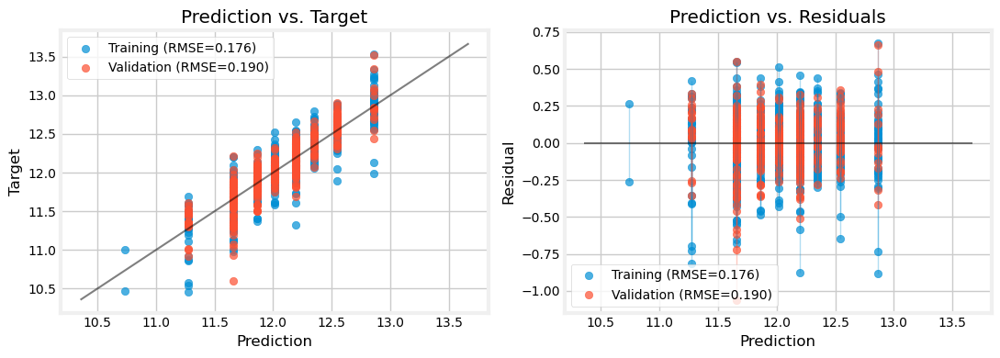



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['pca0', 'pca1', 'cluster_0', 'cluster_1', 'cluster_2', 'cluster_3', 'OverallQual', 'GarageCars', 'BathsAbvGr', 'AllBaths', 'KitchenQual', 'ExterQual', 'BsmtQual', 'Has_Garage', 'Has_Bsmt', 'pca2', 'pca3', 'pca4', 'pca5', 'pca6', 'pca7', 'pca8']
The most important features are:

	pca0: 1.5996193891768016 +- 0.06613192413299186
	pca1: 0.004392742339095035 +- 0.0058170656412797625
	cluster_0: 0.0 +- 0.0
	cluster_1: 0.0 +- 0.0
	cluster_2: 0.0 +- 0.0
	cluster_3: 0.0 +- 0.0
	OverallQual: 0.0 +- 0.0
	GarageCars: 0.0 +- 0.0
	BathsAbvGr: 0.0 +- 0.0
	AllBaths: 0.0 +- 0.0
	KitchenQual: 0.0 +- 0.0
	ExterQual: 0.0 +- 0.0
	BsmtQual: 0.0 +- 0.0
	Has_Garage: 0.0 +- 0.0
	Has_Bsmt: 0.0 +- 0.0
	pca2: 0.0 +- 0.0
	pca3: 0.0 +- 0.0
	pca4: 0.0 +- 0.0
	pca5: 0.0 +- 0.0
	pca6: 0.0 +- 0.0
	pca7: 0.

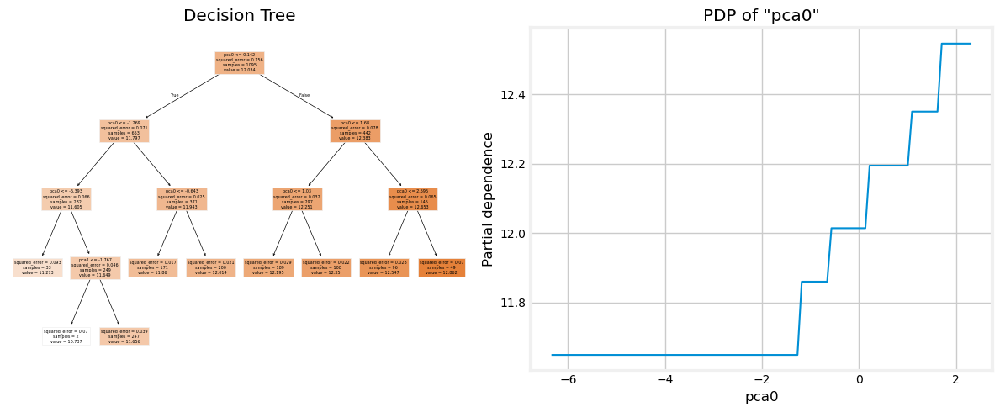

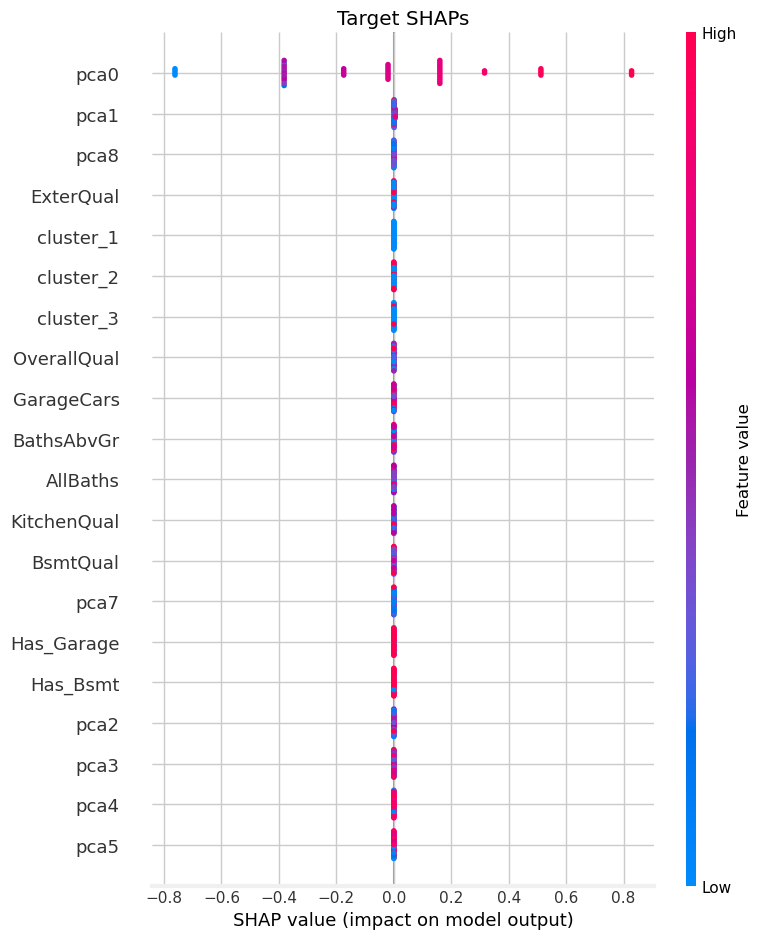

..................................................

Elapsed time: 2.22 minutes
..................................................





In [301]:
model = 'dtr'

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)

        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=100,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [302]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577
R2 Score Validation,0.891477,7.513521e-01,0.697498,0.772228,0.787640,0.773686,0.784581
RMSE Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577
RMSE Validation,0.134864,2.041404e-01,0.225165,0.195383,0.188657,0.194757,0.190011


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [303]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [304]:
best_cv[model+'_clus']['params']

{'model__max_depth': 10,
 'model__max_leaf_nodes': 9,
 'preprocessor__cluster__n_clusters': 4,
 'preprocessor__pca__fit_feat_subset': True,
 'preprocessor__pca__keep_original_feats': False,
 'preprocessor__selector__best_k': 20,
 'preprocessor__selector__t_thr': 0.15224336572142416,
 'preprocessor__target_encoder__smoothing': 30.0}

In [305]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [306]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,Neighborhood,AllRooms,OverallQualCond,GarageCars,GarageArea,YearBuilt,TotalBsmtSF,BathsAbvGr,1stFlrSF,AllBaths,KitchenQual,ExterQual,BsmtQual,GarageAge,Has_Garage,Has_Bsmt
6,0.742068,8,0.511543,0.500000,0.5,2,0.502730,0.659574,1.052674,2.0,0.919677,3.0,4,4,5,-1.066979,1,1
807,0.367177,5,-1.068155,0.333333,-0.5,2,0.170238,-1.063830,0.569246,1.5,-0.048785,3.5,4,3,3,0.537697,1,1
955,0.398207,6,0.294400,0.500000,0.1,2,0.044102,-0.574468,-0.034421,2.0,-0.240817,2.0,3,3,4,0.361174,1,1
1040,0.398207,5,-0.753181,0.833333,-1.5,2,0.014822,-0.340426,0.259462,2.0,1.051686,3.0,3,3,3,0.249087,1,1
701,-0.170534,7,0.127694,-0.333333,0.0,2,0.170238,-0.085106,0.311677,1.5,0.125459,1.5,3,3,3,0.106088,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,0.127694,0.166667,-0.5,2,-0.007457,0.021277,0.132054,2.0,0.439205,2.0,3,3,4,0.077916,1,1
905,-0.400741,5,-0.771817,-0.166667,-1.0,1,-0.961984,-0.404255,0.116963,1.0,-0.066626,2.0,3,3,3,0.317361,1,1
1096,-0.494922,6,-1.292879,0.000000,0.7,0,-11.052923,-1.255319,-0.751207,1.5,-0.740655,1.5,4,3,3,2.173310,0,1
235,-1.295571,6,-0.961599,-0.666667,-1.7,1,-1.066905,-0.042553,-1.446378,1.5,-1.735090,1.5,3,3,3,0.106088,1,1


In [307]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                 PCAFeature(fit_feat_subset=True, keep_original_feats=False)),
                ('cluster',
                 KMeansFeature(n_clusters=4, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x73cc40b57ec0>)],
                                                    verbose_feature_names_out=False))]))])

In [308]:
del best_preproc, best_feats

### Model 2: `RandomForestRegressor`

In [309]:
model = 'rfr'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] = Pipeline(steps=[('preprocessor', preproc_pipe),
                                       ('model', RandomForestRegressor(random_state=0))])

    pipe[model_name+'_no_cv'] = Pipeline(steps=[('preprocessor', preproc_pipe),
                                                ('model', RandomForestRegressor(random_state=0))])

    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
            [False, True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [True, False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__n_estimators'] =\
        [100*i for i in range(1, 11)]
    param_grid[model_name]['model__max_depth'] =\
        list(range(1,11))

Time: 11:44:52
***************************************************************************
rfr_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=rfr_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.979879
R2,0.979878
MAE,0.037077
MSE,0.003146
RMSE,0.056091
MedAE,0.025217
MAPE,0.003094




Regression Report: Validation
..................................................


,Value
Explained Variance,0.891662
R2,0.891477
MAE,0.094334
MSE,0.018188
RMSE,0.134864
MedAE,0.068203
MAPE,0.007934



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


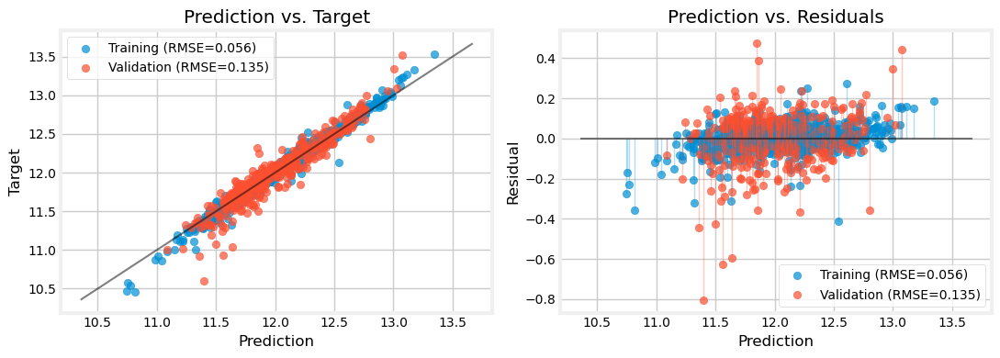



..................................................

Elapsed time: 0.06 minutes
..................................................



Time: 11:44:56
***************************************************************************
rfr_raw , 	CV: True 

***************************************************************************
We will evaluate rfr_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.14914514884216154
		best params: {'model__max_depth': 9, 'model__n_estimators': 500, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.42579293713104593, 'preprocessor__target_encoder__smoothing': 40.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.972066
R2,0.972064
MAE,0.048595
MSE,0.004368
RMSE,0.066092
MedAE,0.037689
MAPE,0.004062




Regression Report: Validation
..................................................


,Value
Explained Variance,0.880377
R2,0.879756
MAE,0.096634
MSE,0.020153
RMSE,0.141961
MedAE,0.069264
MAPE,0.008140



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


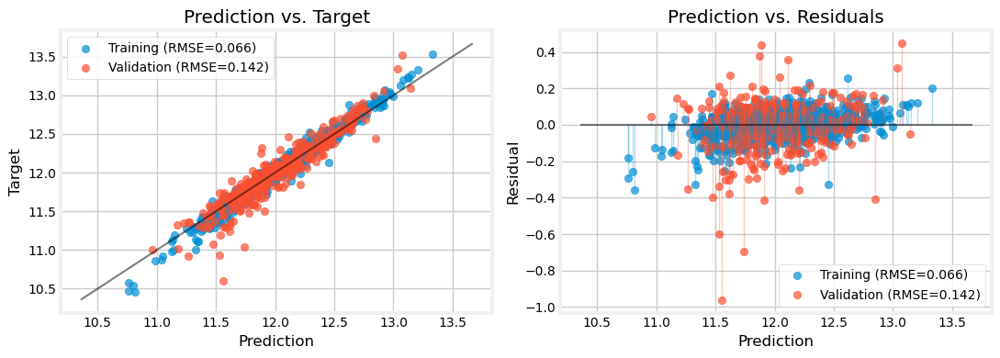



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['OverallQual', 'GrLivArea', 'Neighborhood', 'TotalBsmtSF', 'BsmtFinSF1', 'GarageCars', 'YearRemodAdd', 'LotArea', 'GarageArea', 'YearBuilt', 'BsmtFinType1', 'FireplaceQu', 'MSSubClass', 'HeatingQC', 'TotRmsAbvGrd', 'GarageYrBlt', 'BsmtUnfSF', 'KitchenQual', 'BsmtQual', 'FullBath', 'Fireplaces', 'GarageFinish', 'ExterQual', 'OpenPorchSF', 'Foundation_2', 'GarageType_4', 'MasVnrType_3', 'Foundation_3', 'GarageType_6', 'Foundation_0', 'GarageType_5', 'MasVnrType_1', 'GarageType_0', 'Foundation_4', 'Foundation_5', 'MasVnrType_0', 'MasVnrType_2', 'GarageType_3', 'Foundation_1', 'GarageType_1', 'GarageType_2', 'LotFrontage']
The most important features are:

	OverallQual: 0.3074080424376159 +- 0.025126851339584578
	GrLivArea: 0.14015238483435516 +- 0.0069626878826939305
	Neighbo

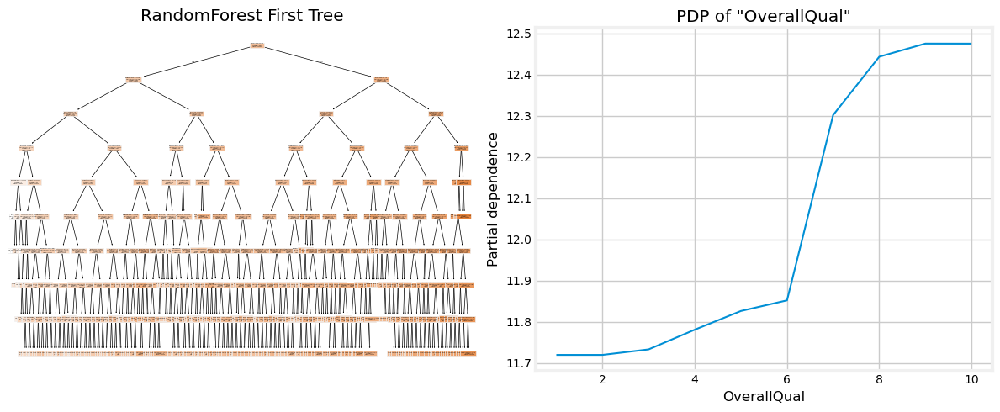

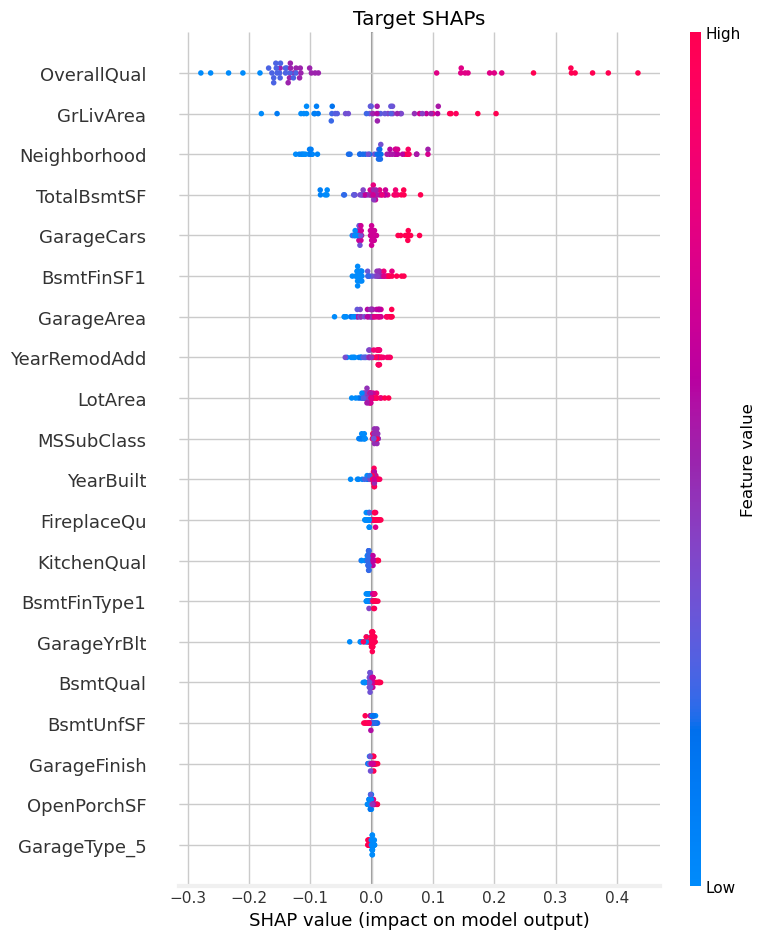

..................................................

Elapsed time: 5.22 minutes
..................................................



Time: 11:50:09
***************************************************************************
rfr_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=rfr_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.980923
R2,0.980895
MAE,0.037057
MSE,0.002987
RMSE,0.054656
MedAE,0.024925
MAPE,0.003090




Regression Report: Validation
..................................................


,Value
Explained Variance,0.887898
R2,0.887772
MAE,0.097428
MSE,0.018809
RMSE,0.137147
MedAE,0.073562
MAPE,0.008192



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


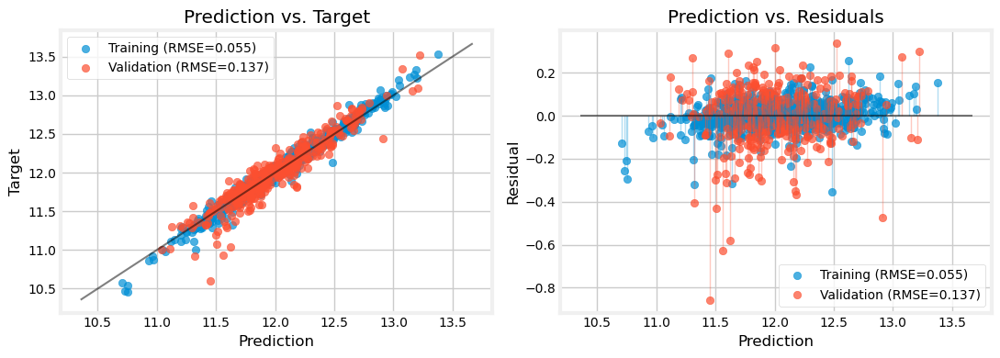



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 11:50:12
***************************************************************************
rfr_eng , 	CV: True 

***************************************************************************
We will evaluate rfr_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.14390576826553406
		best params: {'model__max_depth': 10, 'model__n_estimators': 700, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.10739205878923262, 'preprocessor__target_encoder__smoothing': 10.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.977318
R2,0.977316
MAE,0.043428
MSE,0.003547
RMSE,0.059556
MedAE,0.033647
MAPE,0.003625




Regression Report: Validation
..................................................


,Value
Explained Variance,0.887361
R2,0.886950
MAE,0.095102
MSE,0.018947
RMSE,0.137648
MedAE,0.066608
MAPE,0.007989



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


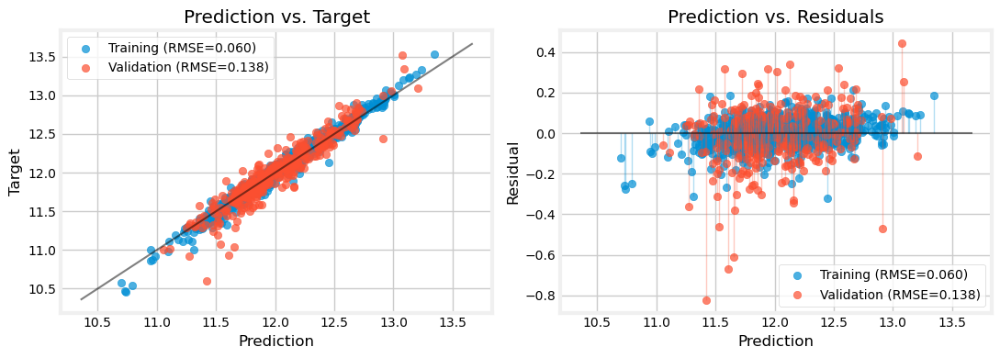



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['TotalSF', 'OverallQual', 'Neighborhood', 'OverallQualCond', 'AllBaths', 'YearRemodAdd', 'GarageAge', '1and2FlrSF', 'AllRooms', 'MSSubClass', 'HouseAge', 'GarageArea', 'YearBuilt', 'FireplaceQu', '1stFlrSF', 'GarageCars', 'KitchenQual', 'BsmtQual', '2ndFlrSF', 'BathsAbvGr', 'ExterQual', 'GarageFinish', 'TotalBsmtSF', 'GarageType_1', 'FullBath', 'GarageType_3', 'Has_2ndFlr', 'GarageType_6', 'Has_Bsmt', 'GarageType_0', 'GarageType_4', 'GarageType_2', 'Has_Garage', 'GarageType_5', 'LotFrontage']
The most important features are:

	TotalSF: 0.31223806502095425 +- 0.015801429572653566
	OverallQual: 0.15400404589269773 +- 0.013007496375094345
	Neighborhood: 0.05779362374734105 +- 0.006311451176216407
	OverallQualCond: 0.03437788889025695 +- 0.0021699923739685457
	AllBaths: 0.0108

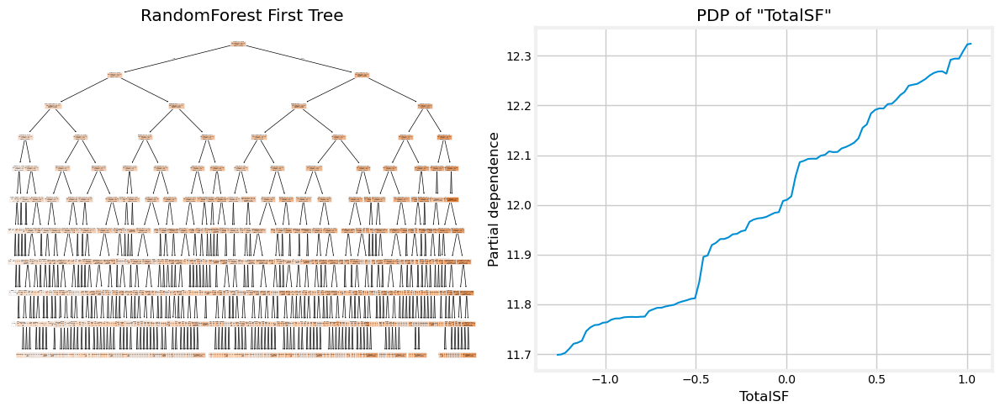

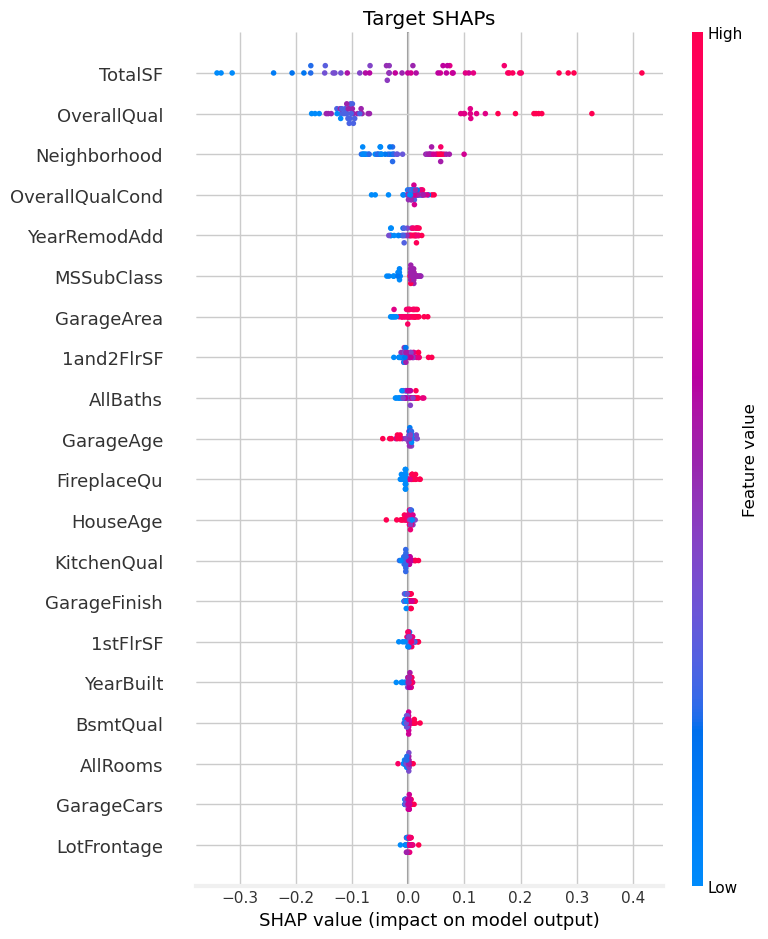

..................................................

Elapsed time: 5.10 minutes
..................................................



Time: 11:55:18
***************************************************************************
rfr_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=rfr_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.979784
R2,0.979769
MAE,0.038053
MSE,0.003163
RMSE,0.056244
MedAE,0.025785
MAPE,0.003173




Regression Report: Validation
..................................................


,Value
Explained Variance,0.880746
R2,0.880742
MAE,0.099385
MSE,0.019988
RMSE,0.141377
MedAE,0.066176
MAPE,0.008362



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


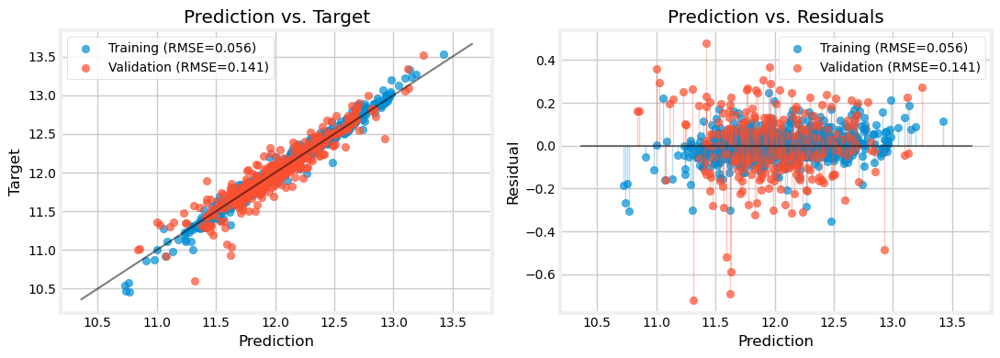



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 11:55:20
***************************************************************************
rfr_clus , 	CV: True 

***************************************************************************
We will evaluate rfr_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.1458024398643122
		best params: {'model__max_depth': 8, 'model__n_estimators': 600, 'preprocessor__cluster__n_clusters': 4, 'preprocessor__pca__fit_feat_subset': True, 'preprocessor__pca__keep_original_feats': True, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.32624557006112764, 'preprocessor__target_encoder__smoothing': 30.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......D

,Value
Explained Variance,0.965753
R2,0.965742
MAE,0.055427
MSE,0.005357
RMSE,0.073190
MedAE,0.042803
MAPE,0.004624




Regression Report: Validation
..................................................


,Value
Explained Variance,0.876942
R2,0.876900
MAE,0.097294
MSE,0.020632
RMSE,0.143637
MedAE,0.068709
MAPE,0.008177



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


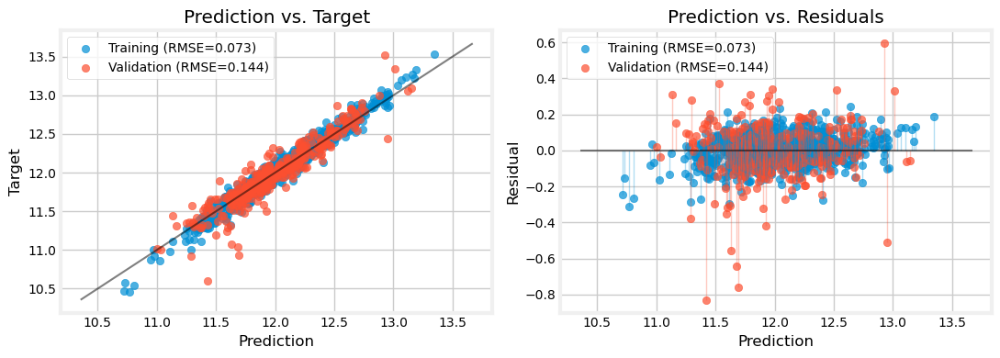



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['cluster_3', 'pca0', 'TotalSF', 'OverallQualCond', 'Neighborhood', 'BathsAbvGr', 'OverallQual', 'AllBaths', 'YearBuilt', 'pca2', 'pca7', 'pca1', 'pca9', '1stFlrSF', 'KitchenQual', 'YearRemodAdd', 'BsmtQual', 'pca6', 'GarageCars', 'GarageArea', 'pca3', 'MSSubClass', 'ExterQual', 'FireplaceQu', 'pca8', 'FullBath', 'Has_Bsmt', 'GarageFinish', 'GarageType_3', 'cluster_0', 'GarageType_5', 'GarageType_0', 'cluster_1', 'cluster_2', 'GarageType_4', 'GarageType_1', 'GarageType_2', 'GarageType_6', 'Has_Garage', 'pca5', 'TotalBsmtSF', 'pca4', 'LotFrontage']
The most important features are:

	cluster_3: 0.310573796629731 +- 0.03612507752127978
	pca0: 0.21117050962187953 +- 0.0176316624033815
	TotalSF: 0.09398266523822282 +- 0.004463323270377817
	OverallQualCond: 0.013755345487220415 +

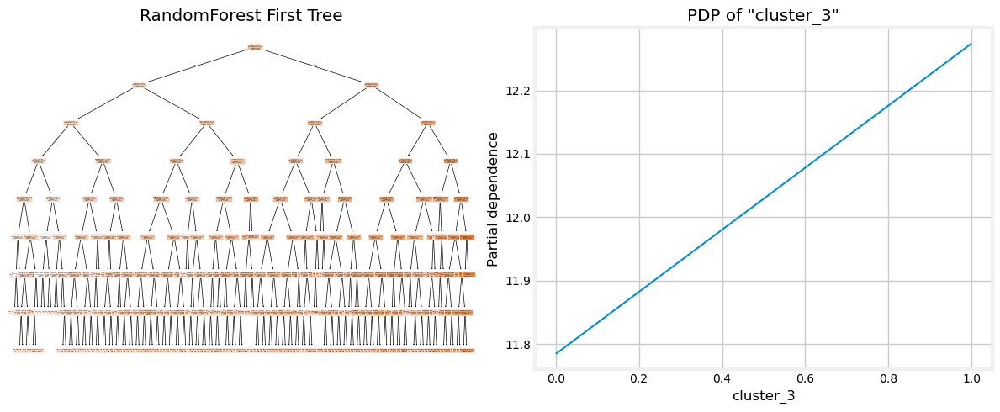

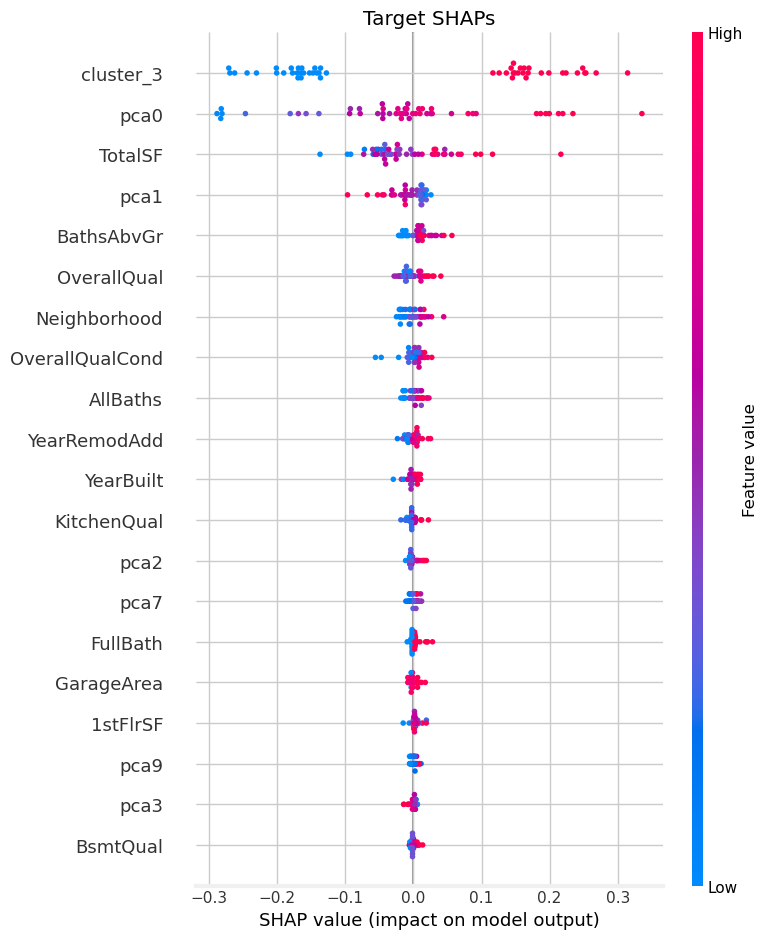

..................................................

Elapsed time: 6.18 minutes
..................................................





In [310]:
model = 'rfr'

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=100,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [311]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv,rfr_raw_no_cv,rfr_raw_cv,rfr_eng_no_cv,rfr_eng_cv,rfr_clus_no_cv,rfr_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577,0.056091,0.066092,0.054656,0.059556,0.056244,0.073190
R2 Score Validation,0.891477,7.513521e-01,0.697498,0.772228,0.787640,0.773686,0.784581,0.891477,0.879756,0.887772,0.886950,0.880742,0.876900
RMSE Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577,0.056091,0.066092,0.054656,0.059556,0.056244,0.073190
RMSE Validation,0.134864,2.041404e-01,0.225165,0.195383,0.188657,0.194757,0.190011,0.134864,0.141961,0.137147,0.137648,0.141377,0.143637


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [312]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [313]:
best_cv[model+'_clus']['params']

{'model__max_depth': 8,
 'model__n_estimators': 600,
 'preprocessor__cluster__n_clusters': 4,
 'preprocessor__pca__fit_feat_subset': True,
 'preprocessor__pca__keep_original_feats': True,
 'preprocessor__selector__best_k': 30,
 'preprocessor__selector__t_thr': 0.32624557006112764,
 'preprocessor__target_encoder__smoothing': 30.0}

In [314]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [315]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,Neighborhood,OverallQualCond,GarageCars,GarageArea,TotalBsmtSF,YearBuilt,1stFlrSF,BathsAbvGr,AllBaths,KitchenQual,ExterQual,BsmtQual,YearRemodAdd,FullBath,GarageFinish,MSSubClass,FireplaceQu,LotFrontage,GarageType,Has_Garage,Has_Bsmt
6,0.742068,8,0.511543,0.5,2,0.502730,1.052674,0.659574,0.919677,2.0,3.0,4,4,5,0.305556,2,2,0.000000,4,0.239984,1,1,1
807,0.367177,5,-1.068155,-0.5,2,0.170238,0.569246,-1.063830,-0.048785,1.5,3.5,4,3,3,0.277778,1,2,-0.339084,3,2.518040,1,1,1
955,0.398207,6,0.294400,0.1,2,0.044102,-0.034421,-0.574468,-0.240817,2.0,2.0,3,3,4,-1.222222,2,1,-0.731344,0,0.550685,1,1,1
1040,0.398207,5,-0.753181,-1.5,2,0.014822,0.259462,-0.340426,1.051686,2.0,3.0,3,3,3,0.166667,2,2,0.069787,3,0.796813,1,1,1
701,-0.170534,7,0.127694,0.0,2,0.170238,0.311677,-0.085106,0.125459,1.5,1.5,3,3,3,-0.694444,1,1,0.022106,0,0.464671,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,0.127694,-0.5,2,-0.007457,0.132054,0.021277,0.439205,2.0,2.0,3,3,4,-0.555556,2,2,0.022106,3,0.376507,1,1,1
905,-0.400741,5,-0.771817,-1.0,1,-0.961984,0.116963,-0.404255,-0.066626,1.0,2.0,3,3,3,-1.111111,1,2,0.069787,0,0.464671,1,1,1
1096,-0.494922,6,-1.292879,0.7,0,-11.052923,-0.751207,-1.255319,-0.740655,1.5,1.5,4,3,3,0.333333,1,0,-0.180492,0,-0.535329,6,0,1
235,-1.295571,6,-0.961599,-1.7,1,-1.066905,-1.446378,-0.042553,-1.735090,1.5,1.5,3,3,3,-0.638889,1,1,-0.786268,0,-4.131663,5,1,1


In [316]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                ('pca', PCAFeature(fit_feat_subset=True)),
                ('cluster',
                 KMeansFeature(n_clusters=4, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x73cc40b57ec0>)],
                                                    verbose_feature_names_out=False))]))])

In [317]:
del best_preproc, best_feats

### Model 3: `XGBRegressor`

In [318]:
model = 'xgbr'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', XGBRegressor(random_state=0))])

    pipe[model_name+'_no_cv'] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', XGBRegressor(random_state=0))])

    
    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
            [False, True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [True, False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__n_estimators'] =\
        [100*i for i in range(1, 11)]
    param_grid[model_name]['model__learning_rate'] =\
        uniform(loc=0.01, scale=0.49)
    param_grid[model_name]['model__max_depth'] =\
        list(range(2,11))

Time: 12:01:32
***************************************************************************
xgbr_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=xgbr_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.999854
R2,0.999854
MAE,0.003373
MSE,0.000023
RMSE,0.004774
MedAE,0.002313
MAPE,0.000281




Regression Report: Validation
..................................................


,Value
Explained Variance,0.894830
R2,0.894659
MAE,0.094849
MSE,0.017655
RMSE,0.132873
MedAE,0.068493
MAPE,0.007968



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


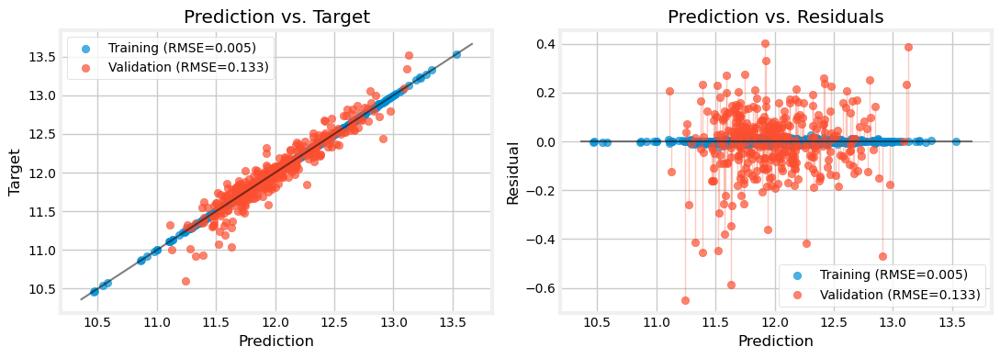



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 12:01:33
***************************************************************************
xgbr_raw , 	CV: True 

***************************************************************************
We will evaluate xgbr_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.14295159442627772
		best params: {'model__learning_rate': 0.09378343335473442, 'model__max_depth': 4, 'model__n_estimators': 600, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.37628134455752216, 'preprocessor__target_encoder__smoothing': 10.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.998315
R2,0.998315
MAE,0.011584
MSE,0.000264
RMSE,0.016233
MedAE,0.008108
MAPE,0.000965




Regression Report: Validation
..................................................


,Value
Explained Variance,0.865074
R2,0.864149
MAE,0.099672
MSE,0.022769
RMSE,0.150893
MedAE,0.064463
MAPE,0.008385



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


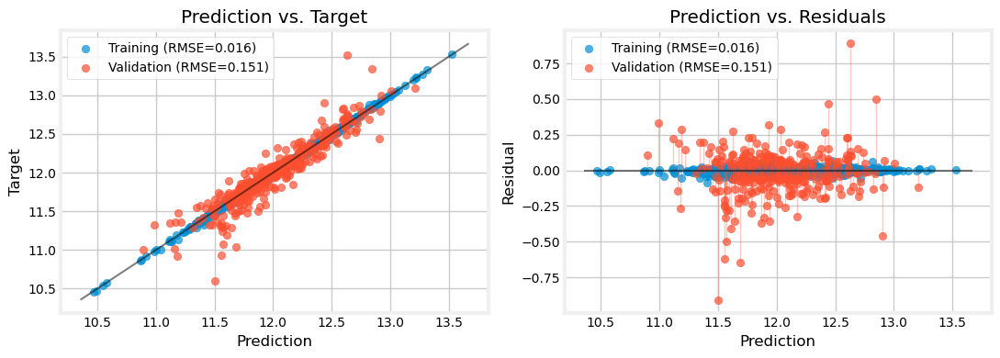



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['GrLivArea', 'OverallQual', 'Neighborhood', 'TotalBsmtSF', 'BsmtFinSF1', 'YearRemodAdd', 'LotArea', 'YearBuilt', 'FireplaceQu', 'BsmtUnfSF', 'BsmtQual', 'HeatingQC', 'GarageCars', 'BsmtFinType1', 'FullBath', 'OpenPorchSF', 'KitchenQual', 'Fireplaces', 'GarageFinish', 'GarageArea', 'MSSubClass', 'Foundation_2', 'GarageType_4', 'GarageYrBlt', 'ExterQual', 'GarageType_3', 'GarageType_0', 'Foundation_4', 'Foundation_5', 'Foundation_3', 'GarageType_5', 'GarageType_2', 'Foundation_1', 'Exterior2nd', 'Foundation_0', 'GarageType_6', 'TotRmsAbvGrd', 'GarageType_1', 'LotFrontage']
The most important features are:

	GrLivArea: 0.14383895295262414 +- 0.009417532907064484
	OverallQual: 0.14061817394668807 +- 0.008384667378200669
	Neighborhood: 0.048613871527432836 +- 0.0064503898164077

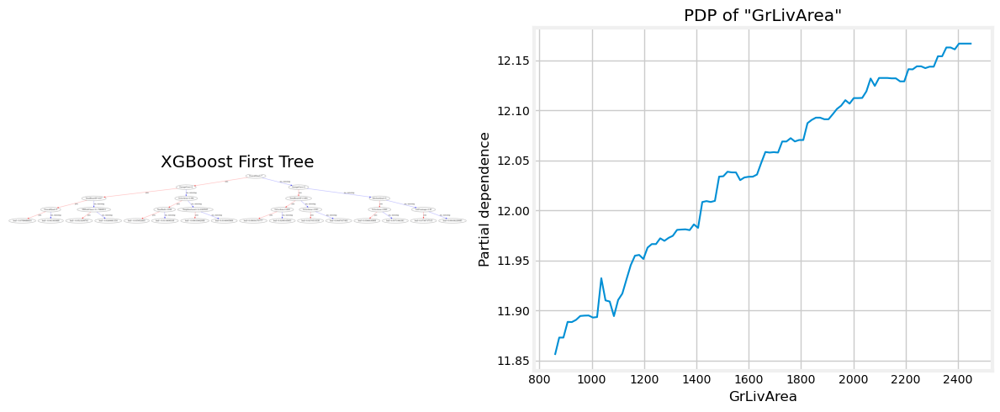

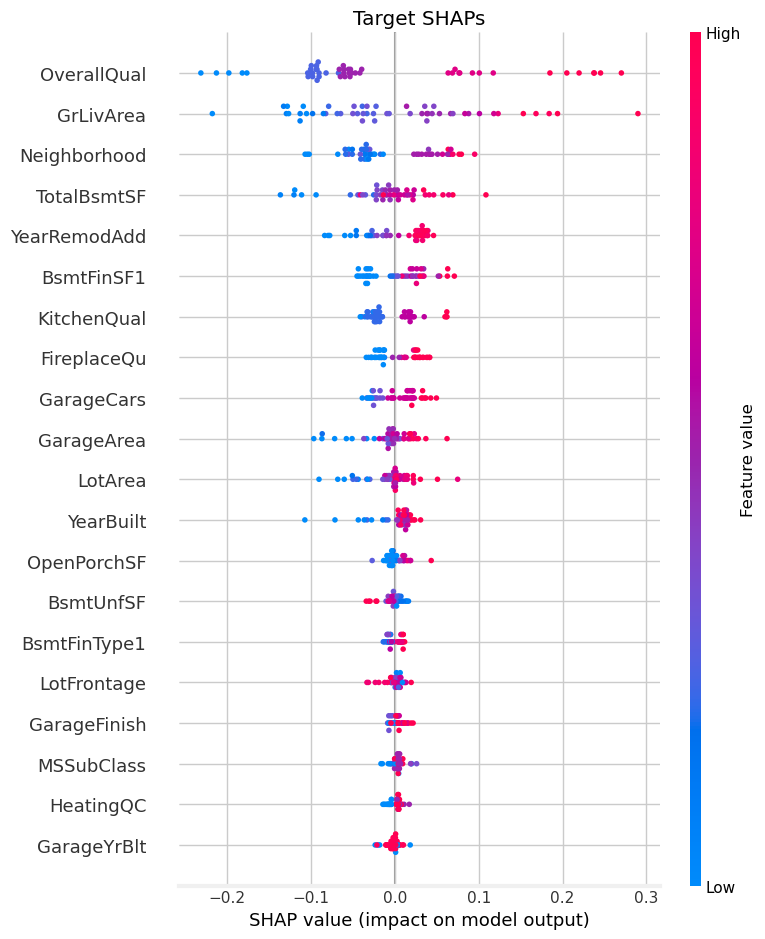

..................................................

Elapsed time: 2.49 minutes
..................................................



Time: 12:04:03
***************************************************************************
xgbr_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=xgbr_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.999380
R2,0.999380
MAE,0.007048
MSE,0.000097
RMSE,0.009846
MedAE,0.004898
MAPE,0.000588




Regression Report: Validation
..................................................


,Value
Explained Variance,0.878324
R2,0.878283
MAE,0.096307
MSE,0.020400
RMSE,0.142828
MedAE,0.066818
MAPE,0.008101



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


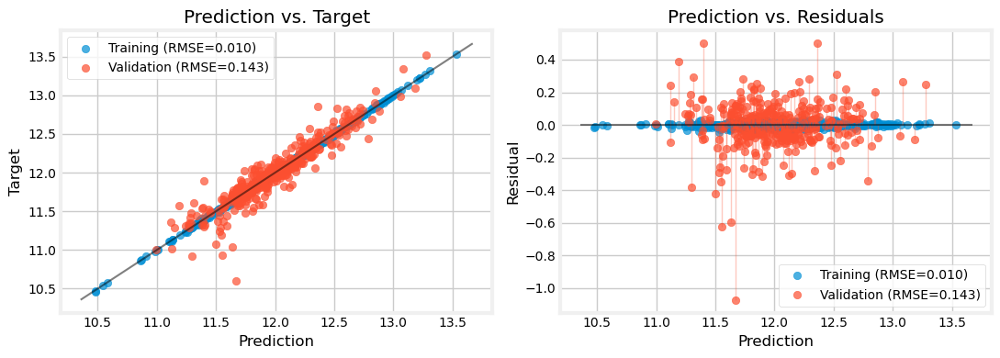



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 12:04:05
***************************************************************************
xgbr_eng , 	CV: True 

***************************************************************************
We will evaluate xgbr_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.13770218812836038
		best params: {'model__learning_rate': 0.11308745492618204, 'model__max_depth': 2, 'model__n_estimators': 400, 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.360037783206682, 'preprocessor__target_encoder__smoothing': 30.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.947006
R2,0.947006
MAE,0.066679
MSE,0.008286
RMSE,0.091029
MedAE,0.049629
MAPE,0.005556




Regression Report: Validation
..................................................


,Value
Explained Variance,0.882747
R2,0.882471
MAE,0.099581
MSE,0.019698
RMSE,0.140349
MedAE,0.068883
MAPE,0.008396



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


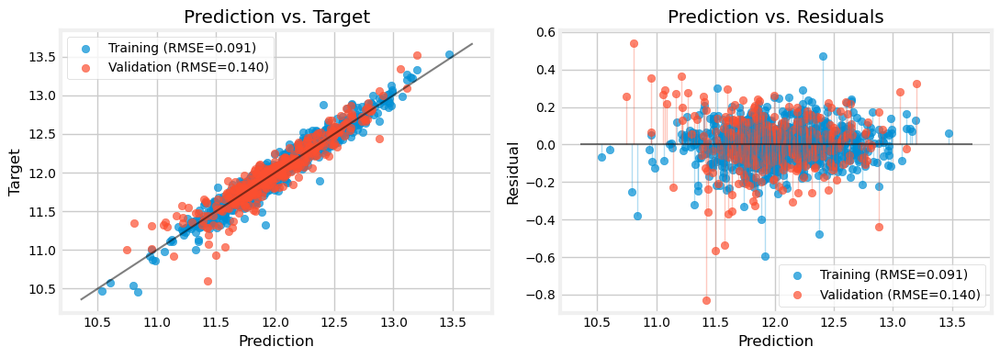



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['TotalSF', 'Neighborhood', 'OverallQualCond', 'OverallQual', 'AllBaths', 'TotalBsmtSF', 'KitchenQual', 'BsmtQual', 'GarageCars', '1stFlrSF', 'BathsAbvGr', 'GarageArea', 'ExterQual', 'Has_Garage', 'Has_Bsmt']
The most important features are:

	TotalSF: 0.24478721842239554 +- 0.010126862237621114
	Neighborhood: 0.0832067383168877 +- 0.007879464036029144
	OverallQualCond: 0.058260216946600975 +- 0.006210814552851933
	OverallQual: 0.05416805791719139 +- 0.005222245765686263
	AllBaths: 0.042035812938563136 +- 0.00353502056600335
	TotalBsmtSF: 0.014500131451857644 +- 0.003147591363255399
	KitchenQual: 0.012085770290888597 +- 0.0021803452034767578
	BsmtQual: 0.00787573906808452 +- 0.001554433097257326
	GarageCars: 0.005703842378296175 +- 0.0017039238892676786
	1stFlrSF: 0.0039806

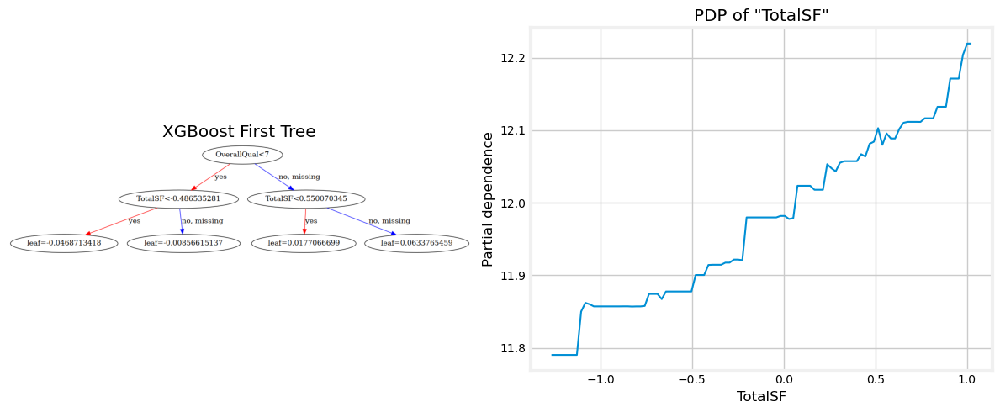

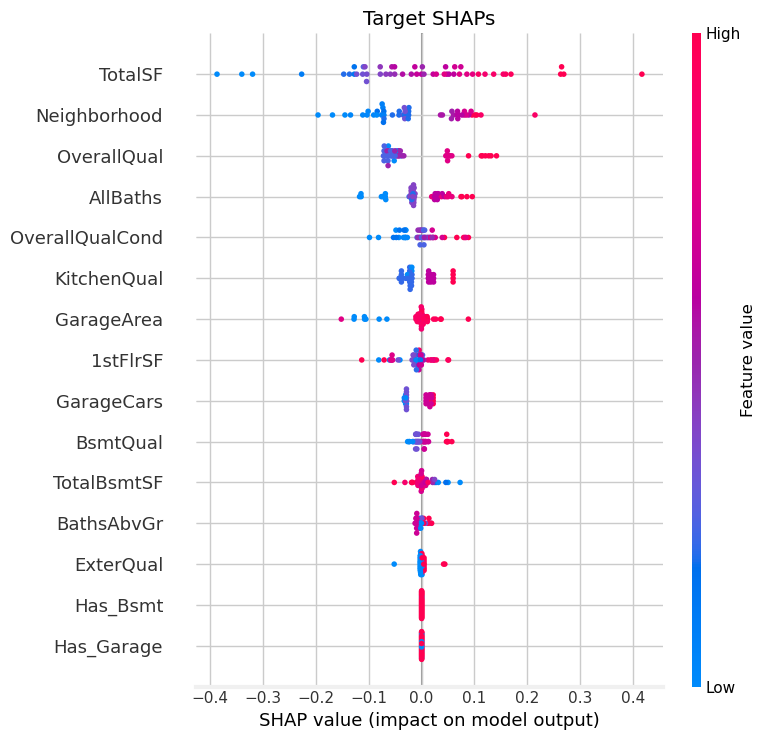

..................................................

Elapsed time: 2.53 minutes
..................................................



Time: 12:06:37
***************************************************************************
xgbr_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=xgbr_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.999583
R2,0.999583
MAE,0.005745
MSE,0.000065
RMSE,0.008072
MedAE,0.004133
MAPE,0.000478




Regression Report: Validation
..................................................


,Value
Explained Variance,0.862097
R2,0.861914
MAE,0.107987
MSE,0.023143
RMSE,0.152129
MedAE,0.074474
MAPE,0.009082



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


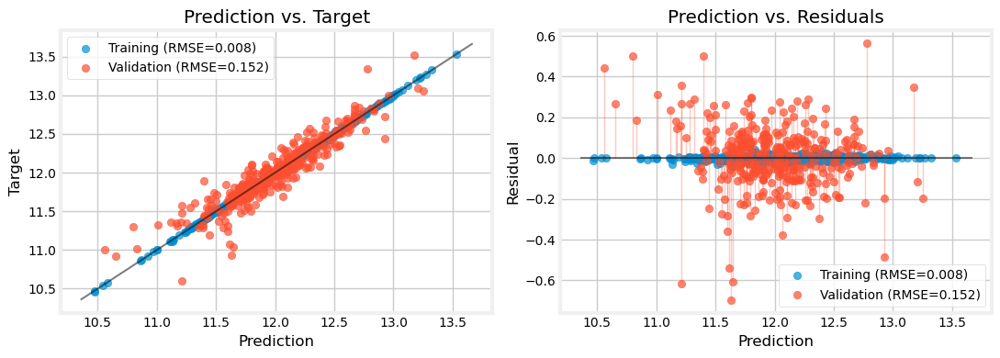



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 12:06:39
***************************************************************************
xgbr_clus , 	CV: True 

***************************************************************************
We will evaluate xgbr_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.13828228677824483
		best params: {'model__learning_rate': 0.05087699336658909, 'model__max_depth': 2, 'model__n_estimators': 400, 'preprocessor__cluster__n_clusters': 5, 'preprocessor__pca__fit_feat_subset': True, 'preprocessor__pca__keep_original_feats': True, 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.18023515381239827, 'preprocessor__target_encoder__smoothing': 20.0}
......Done!
 -> Making predictions
...

,Value
Explained Variance,0.939055
R2,0.939055
MAE,0.071764
MSE,0.009530
RMSE,0.097619
MedAE,0.053933
MAPE,0.005975




Regression Report: Validation
..................................................


,Value
Explained Variance,0.886048
R2,0.885697
MAE,0.096899
MSE,0.019157
RMSE,0.138409
MedAE,0.069246
MAPE,0.008161



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


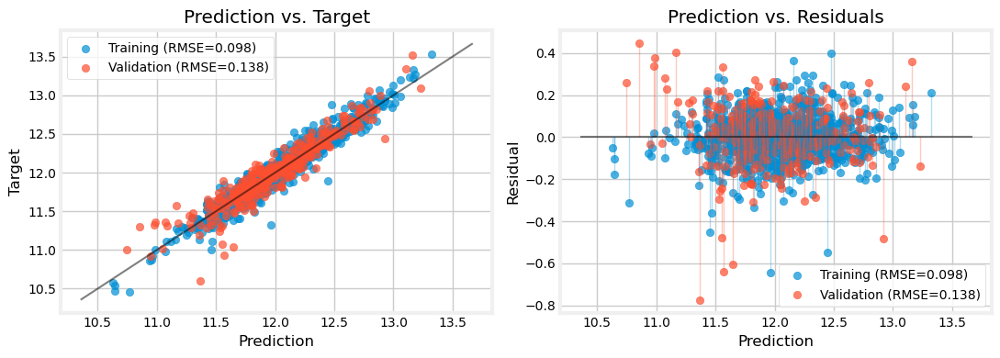



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['pca0', 'TotalSF', 'OverallQualCond', 'AllBaths', 'Neighborhood', 'cluster_3', 'OverallQual', 'pca2', 'pca7', 'pca5', 'KitchenQual', 'pca6', 'BsmtQual', 'GarageCars', 'TotalBsmtSF', 'ExterQual', 'cluster_2', 'BathsAbvGr', 'cluster_1', 'cluster_4', 'Has_Garage', 'Has_Bsmt', 'cluster_0', 'YearBuilt', 'pca4', 'GarageAge', 'GarageArea', 'pca3', 'pca1', '1stFlrSF']
The most important features are:

	pca0: 0.22156655625935578 +- 0.01368039609645589
	TotalSF: 0.12671413063951747 +- 0.008136821591054532
	OverallQualCond: 0.03033247264437009 +- 0.003675994030887128
	AllBaths: 0.02759429673777438 +- 0.0028557223896338462
	Neighborhood: 0.02021256846232189 +- 0.003955369189259904
	cluster_3: 0.01843629714403201 +- 0.0024745354814170923
	OverallQual: 0.010614881093470085 +- 0.00101740

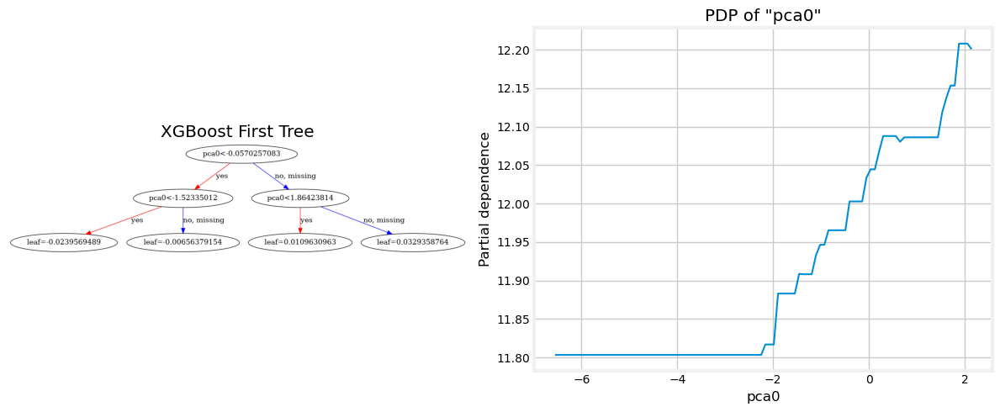

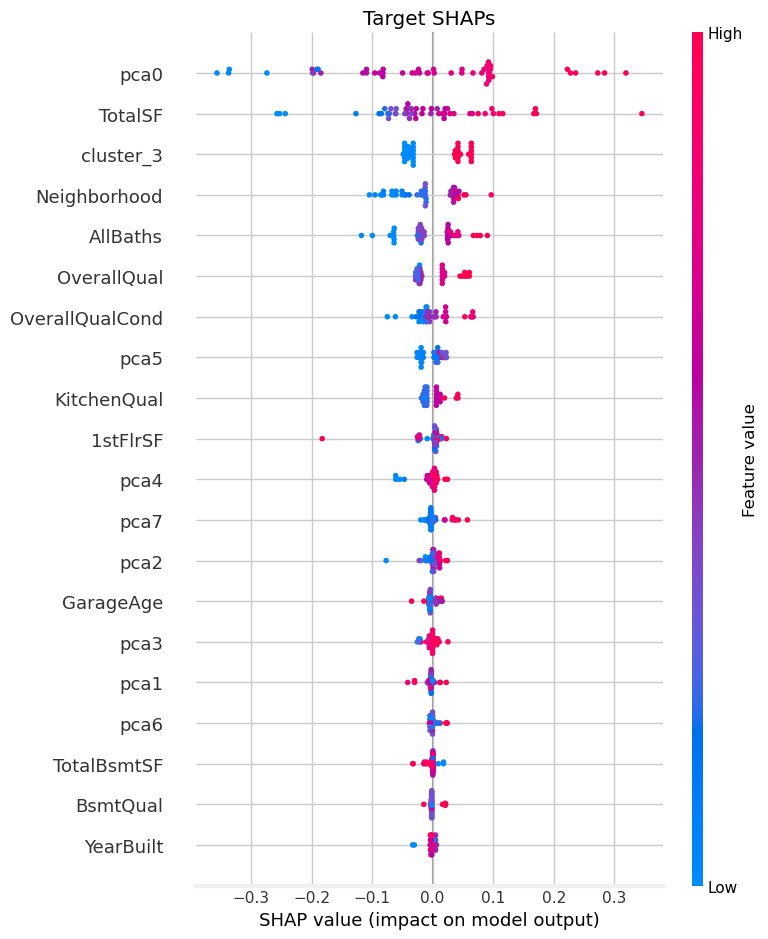

..................................................

Elapsed time: 3.19 minutes
..................................................





In [319]:
model = 'xgbr'

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # create a dummy buffer
        # f = io.StringIO()
        # with contextlib.redirect_stderr(f): # redirect stderr into it
        # with suppress_c_stderr():
        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=100,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [320]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv,rfr_raw_no_cv,rfr_raw_cv,rfr_eng_no_cv,rfr_eng_cv,rfr_clus_no_cv,rfr_clus_cv,xgbr_raw_no_cv,xgbr_raw_cv,xgbr_eng_no_cv,xgbr_eng_cv,xgbr_clus_no_cv,xgbr_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577,0.056091,0.066092,0.054656,0.059556,0.056244,0.073190,0.004774,0.016233,0.009846,0.091029,0.008072,0.097619
R2 Score Validation,0.891477,7.513521e-01,0.697498,0.772228,0.787640,0.773686,0.784581,0.891477,0.879756,0.887772,0.886950,0.880742,0.876900,0.894659,0.864149,0.878283,0.882471,0.861914,0.885697
RMSE Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577,0.056091,0.066092,0.054656,0.059556,0.056244,0.073190,0.004774,0.016233,0.009846,0.091029,0.008072,0.097619
RMSE Validation,0.134864,2.041404e-01,0.225165,0.195383,0.188657,0.194757,0.190011,0.134864,0.141961,0.137147,0.137648,0.141377,0.143637,0.132873,0.150893,0.142828,0.140349,0.152129,0.138409


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [321]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [322]:
best_cv[model+'_clus']['params']

{'model__learning_rate': 0.05087699336658909,
 'model__max_depth': 2,
 'model__n_estimators': 400,
 'preprocessor__cluster__n_clusters': 5,
 'preprocessor__pca__fit_feat_subset': True,
 'preprocessor__pca__keep_original_feats': True,
 'preprocessor__selector__best_k': 20,
 'preprocessor__selector__t_thr': 0.18023515381239827,
 'preprocessor__target_encoder__smoothing': 20.0}

In [323]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [324]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,Neighborhood,OverallQualCond,GarageCars,GarageArea,TotalBsmtSF,YearBuilt,BathsAbvGr,1stFlrSF,AllBaths,KitchenQual,BsmtQual,ExterQual,GarageAge,Has_Garage,Has_Bsmt
6,0.742068,8,0.549257,0.5,2,0.502730,1.052674,0.659574,2.0,0.919677,3.0,4,5,4,-1.066979,1,1
807,0.367177,5,-1.089538,-0.5,2,0.170238,0.569246,-1.063830,1.5,-0.048785,3.5,4,3,3,0.537697,1,1
955,0.398207,6,0.306449,0.1,2,0.044102,-0.034421,-0.574468,2.0,-0.240817,2.0,3,4,3,0.361174,1,1
1040,0.398207,5,-0.780748,-1.5,2,0.014822,0.259462,-0.340426,2.0,1.051686,3.0,3,3,3,0.249087,1,1
701,-0.170534,7,0.146509,0.0,2,0.170238,0.311677,-0.085106,1.5,0.125459,1.5,3,3,3,0.106088,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,0.146509,-0.5,2,-0.007457,0.132054,0.021277,2.0,0.439205,2.0,3,4,3,0.077916,1,1
905,-0.400741,5,-0.747586,-1.0,1,-0.961984,0.116963,-0.404255,1.0,-0.066626,2.0,3,3,3,0.317361,1,1
1096,-0.494922,6,-1.209839,0.7,0,-11.052923,-0.751207,-1.255319,1.5,-0.740655,1.5,4,3,3,2.173310,0,1
235,-1.295571,6,-0.819394,-1.7,1,-1.066905,-1.446378,-0.042553,1.5,-1.735090,1.5,3,3,3,0.106088,1,1


In [325]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                ('pca', PCAFeature(fit_feat_subset=True)),
                ('cluster',
                 KMeansFeature(n_clusters=5, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x73cc40b57ec0>)],
                                                    verbose_feature_names_out=False))]))])

In [326]:
del best_preproc, best_feats

### Model 4: `LinearRegression`

In [327]:
model = 'linreg'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] = Pipeline(steps=[('preprocessor', preproc_pipe),
                                       ('model', LinearRegression(fit_intercept=True))])

    pipe[model_name+'_no_cv'] = Pipeline(steps=[('preprocessor', preproc_pipe),
                                       ('model', LinearRegression(fit_intercept=True))])


    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),#+["all"]
                              # 'preprocessor__selector__t_thr':
                              #     list(np.arange(0.1, 0.7, 0.1))#+[None]
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
            [False, True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [True, False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

***************************************************************************
linreg_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=linreg_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.936632
R2,0.936632
MAE,0.070729
MSE,0.009908
RMSE,0.099541
MedAE,0.054578
MAPE,0.005904




Regression Report: Validation
..................................................


,Value
Explained Variance,0.895132
R2,0.895123
MAE,0.094215
MSE,0.017577
RMSE,0.132579
MedAE,0.069316
MAPE,0.007939



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


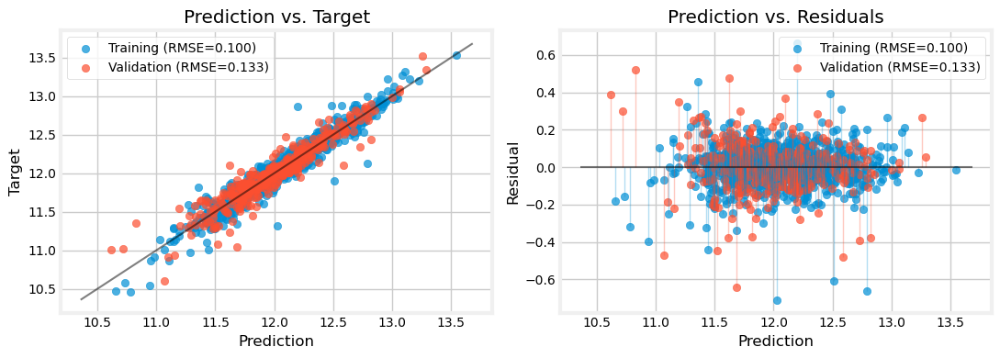



..................................................

Elapsed time: 0.04 minutes
..................................................



***************************************************************************
linreg_raw , 	CV: True 

***************************************************************************
We will evaluate linreg_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.1563256841010248
		best params: {'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.6776444795762784, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.855174
R2,0.855174
MAE,0.105741
MSE,0.022645
RMSE,0.150483
MedAE,0.079671
MAPE,0.008836




Regression Report: Validation
..................................................


,Value
Explained Variance,0.878694
R2,0.878597
MAE,0.103444
MSE,0.020347
RMSE,0.142643
MedAE,0.082032
MAPE,0.008700



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


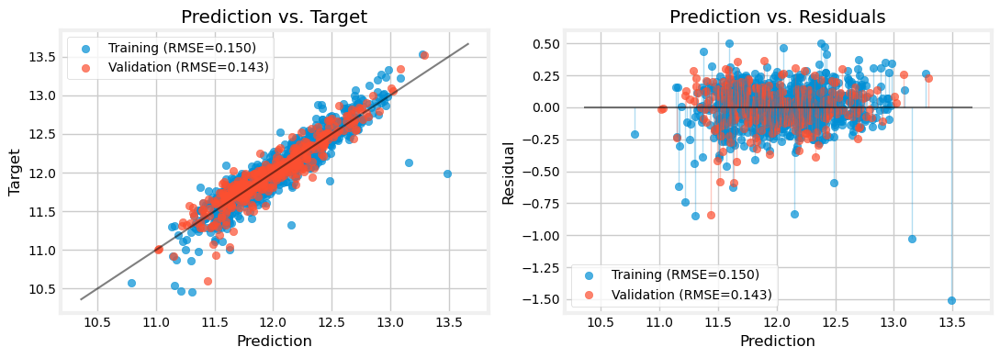



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['GarageYrBlt', 'GarageType_6', 'GarageType_1', 'GarageType_5', 'OverallQual', 'Neighborhood', 'GarageType_3', 'GrLivArea', 'GarageCars', 'BsmtFinType1', 'YearRemodAdd', 'TotalBsmtSF', 'TotRmsAbvGrd', 'Foundation_1', 'HeatingQC', 'KitchenQual', 'Fireplaces', 'GarageType_4', 'GarageType_2', 'YearBuilt', 'BsmtQual', 'Foundation_0', 'FireplaceQu', 'GarageType_0', 'GarageFinish', 'Foundation_3', 'ExterQual', 'Foundation_2', 'Foundation_4', 'Foundation_5', 'OpenPorchSF', 'FullBath', 'LotFrontage']
The most important features are:

	GarageYrBlt: 3.1423653581881354 +- 0.19025471568567376
	GarageType_6: 2.2496539367058834 +- 0.13235035992706476
	GarageType_1: 0.3302145410055744 +- 0.03049561266849925
	GarageType_5: 0.22220344535197184 +- 0.020891485048189846
	OverallQual: 0.0954875

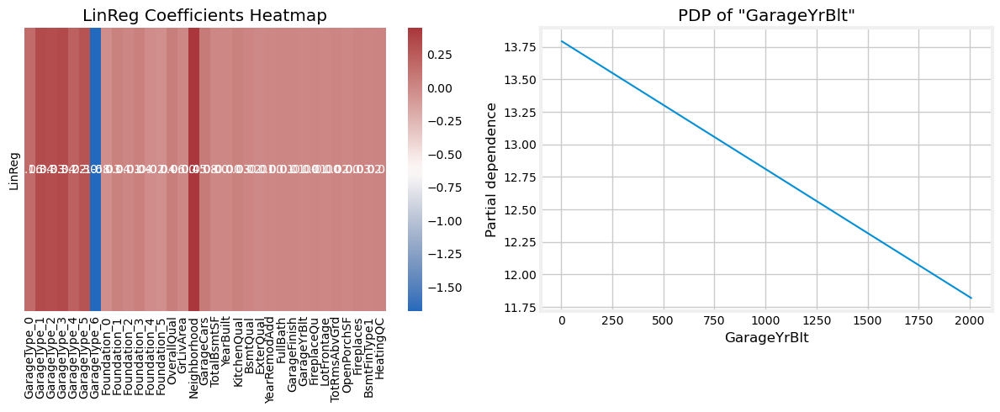

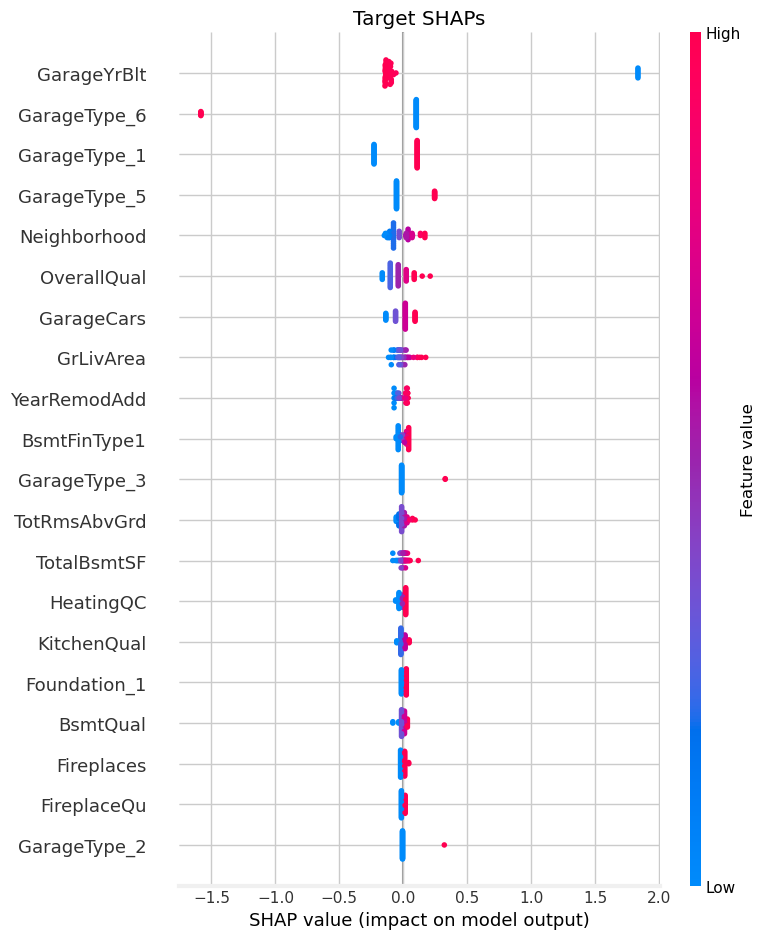

..................................................

Elapsed time: 1.82 minutes
..................................................



***************************************************************************
linreg_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=linreg_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.871949
R2,0.871949
MAE,0.100344
MSE,0.020022
RMSE,0.141500
MedAE,0.076520
MAPE,0.008376




Regression Report: Validation
..................................................


,Value
Explained Variance,0.893075
R2,0.892702
MAE,0.098512
MSE,0.017983
RMSE,0.134101
MedAE,0.075639
MAPE,0.008274



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


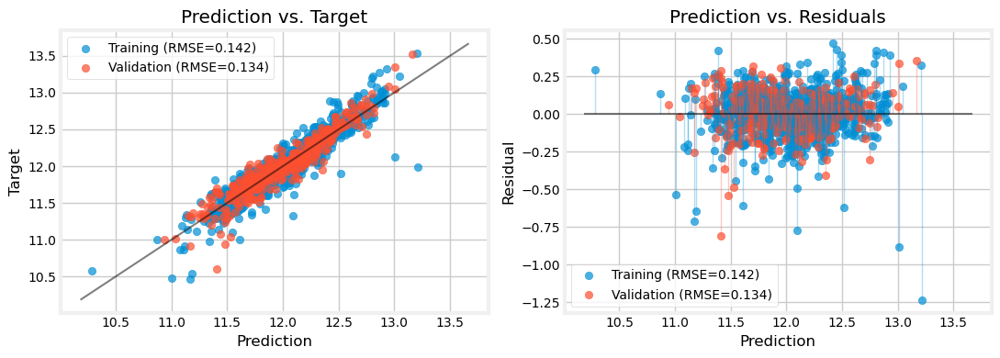



..................................................

Elapsed time: 0.03 minutes
..................................................



***************************************************************************
linreg_eng , 	CV: True 

***************************************************************************
We will evaluate linreg_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.1438031822837442
		best params: {'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.38755557117545725, 'preprocessor__target_encoder__smoothing': 40.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.881678
R2,0.881678
MAE,0.094521
MSE,0.018501
RMSE,0.136019
MedAE,0.070143
MAPE,0.007886




Regression Report: Validation
..................................................


,Value
Explained Variance,0.901289
R2,0.901113
MAE,0.094144
MSE,0.016573
RMSE,0.128738
MedAE,0.072416
MAPE,0.007906



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


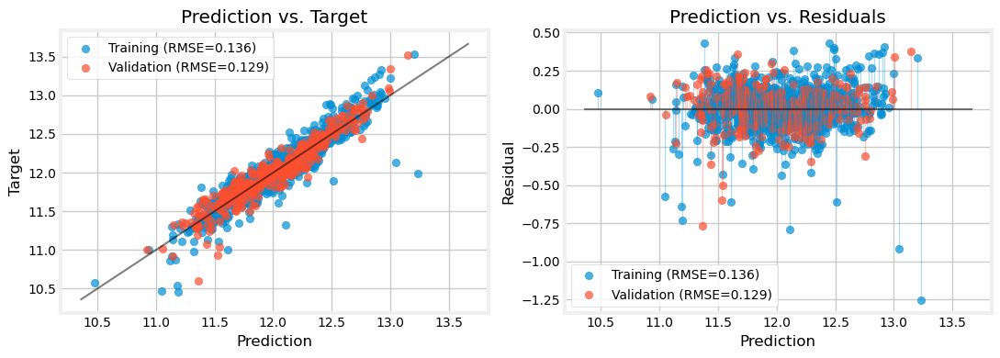



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['TotalSF', 'Neighborhood', 'OverallQualCond', 'AllBaths', 'TotalBsmtSF', 'GarageCars', 'FullBath', 'BsmtQual', 'FireplaceQu', '1stFlrSF', 'KitchenQual', 'MSSubClass', 'Foundation_2', 'GarageType_1', 'LotFrontage', 'GarageType_3', 'GarageType_5', 'RemodAge', 'GarageFinish', 'Foundation_0', 'Foundation_1', 'GarageArea', 'BathsAbvGr', 'GarageType_4', 'OverallQual', 'GarageType_6', 'Has_Garage', 'GarageType_0', 'Foundation_3', 'ExterQual', 'Foundation_5', 'Foundation_4', 'Has_Bsmt', 'GarageType_2']
The most important features are:

	TotalSF: 0.20166548697180434 +- 0.010365619967875979
	Neighborhood: 0.07436581647280575 +- 0.002672722734827818
	OverallQualCond: 0.07430319106365786 +- 0.004255321756956115
	AllBaths: 0.031377480425054685 +- 0.002849121274994182
	TotalBsmtSF: 0.02

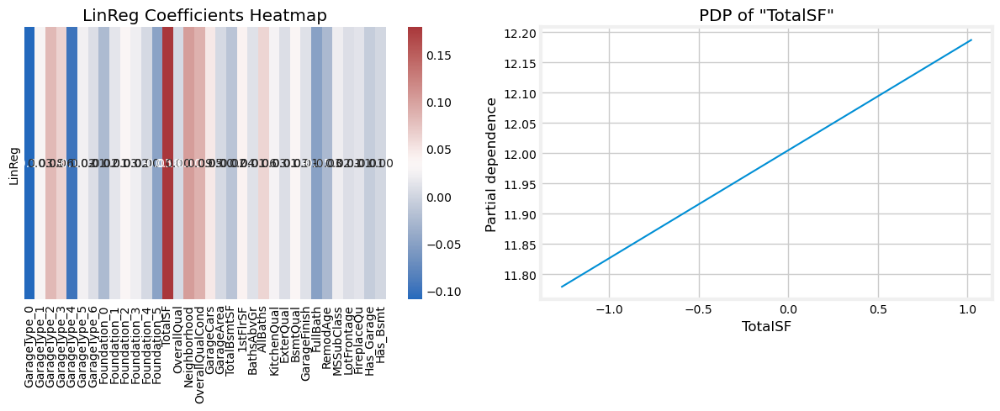

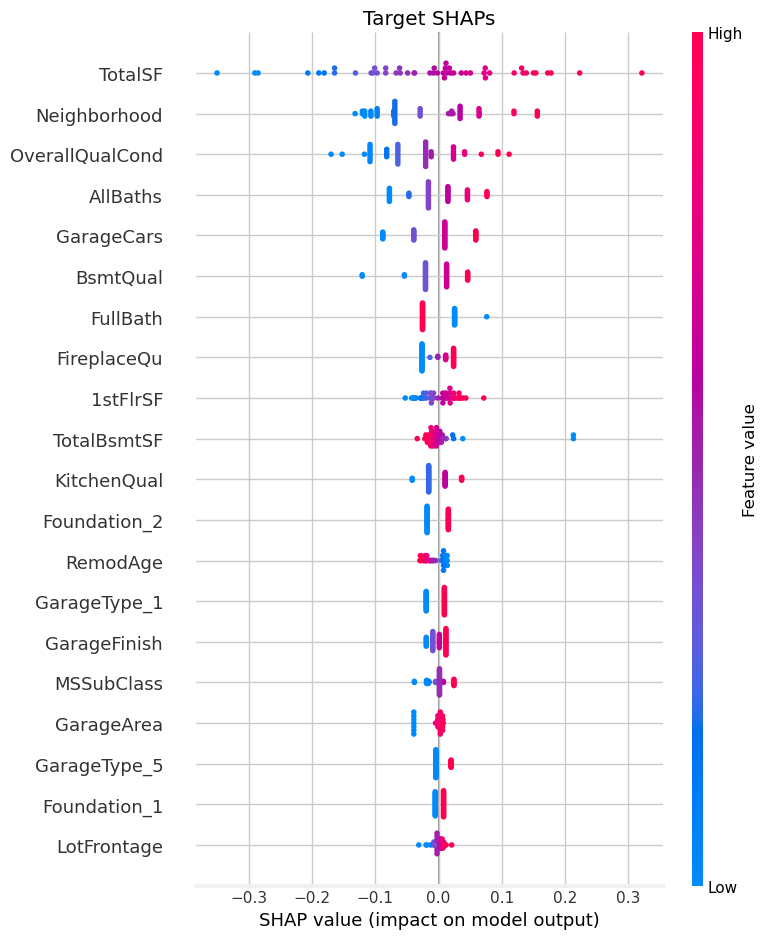

..................................................

Elapsed time: 2.02 minutes
..................................................



***************************************************************************
linreg_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=linreg_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.872249
R2,0.872249
MAE,0.100242
MSE,0.019975
RMSE,0.141334
MedAE,0.077024
MAPE,0.008368




Regression Report: Validation
..................................................


,Value
Explained Variance,0.893339
R2,0.892984
MAE,0.098478
MSE,0.017936
RMSE,0.133925
MedAE,0.076050
MAPE,0.008272



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


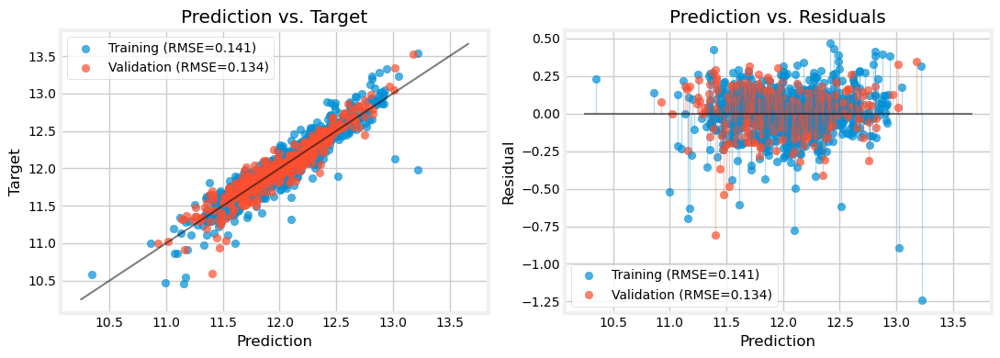



..................................................

Elapsed time: 0.04 minutes
..................................................



***************************************************************************
linreg_clus , 	CV: True 

***************************************************************************
We will evaluate linreg_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.1442255216392837
		best params: {'preprocessor__cluster__n_clusters': 3, 'preprocessor__pca__fit_feat_subset': False, 'preprocessor__pca__keep_original_feats': False, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.3082727420699237, 'preprocessor__target_encoder__smoothing': 40.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
........................

,Value
Explained Variance,0.882339
R2,0.882339
MAE,0.093974
MSE,0.018398
RMSE,0.135638
MedAE,0.068773
MAPE,0.007840




Regression Report: Validation
..................................................


,Value
Explained Variance,0.901402
R2,0.901111
MAE,0.093635
MSE,0.016574
RMSE,0.128739
MedAE,0.068865
MAPE,0.007866



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


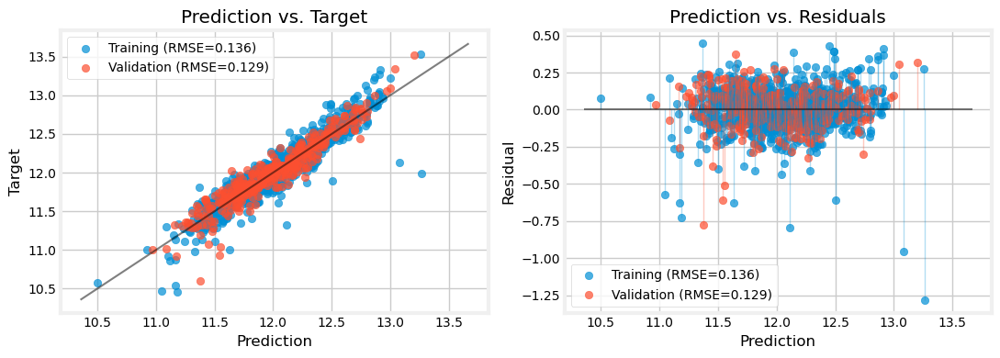



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['pca0', 'Has_2ndFlr', 'pca3', 'pca2', 'pca6', 'pca7', 'pca5', 'pca4', 'AllBaths', 'pca8', 'GarageCars', 'pca9', 'FullBath', 'FireplaceQu', 'pca10', 'cluster_1', 'BsmtQual', 'KitchenQual', 'GarageType_1', 'GarageFinish', 'cluster_2', 'Has_Bsmt', 'GarageType_3', 'GarageType_5', 'GarageType_4', 'OverallQual', 'BathsAbvGr', 'cluster_0', 'GarageType_6', 'Has_Garage', 'GarageType_0', 'ExterQual', 'pca1', 'GarageType_2']
The most important features are:

	pca0: 0.520764387000227 +- 0.02275820983155382
	Has_2ndFlr: 0.4946854639245585 +- 0.03601028450474529
	pca3: 0.40883788599807447 +- 0.016488432957997
	pca2: 0.3295443608931155 +- 0.011320132804537357
	pca6: 0.28817951647468076 +- 0.021835887840651234
	pca7: 0.14288058253010977 +- 0.011883281020234988
	pca5: 0.053815405409034824 

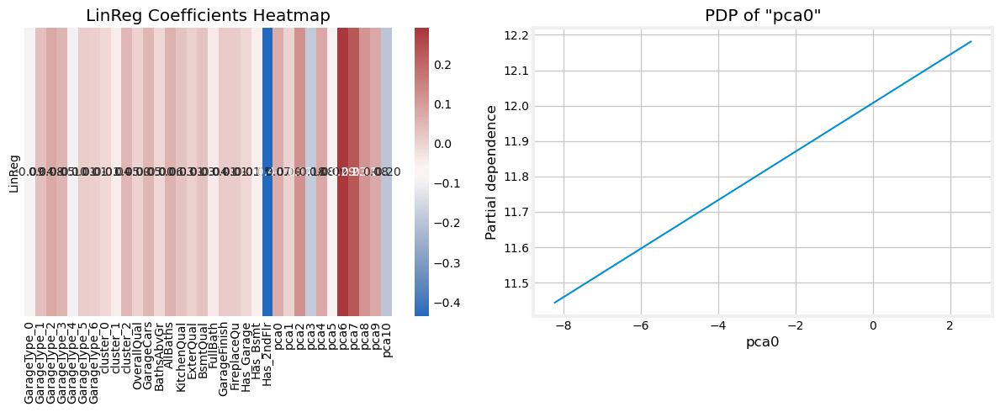

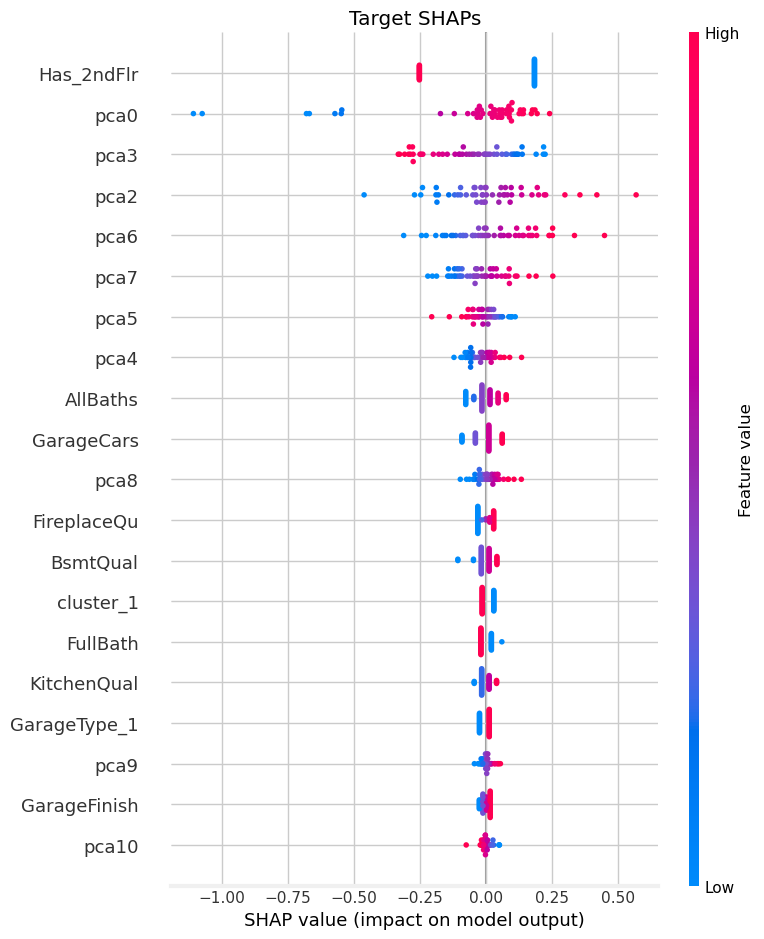

..................................................

Elapsed time: 2.03 minutes
..................................................





In [328]:
model = 'linreg'

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        start = time.time()

        model_name = model+'_'+pp # full model name

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=100,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [329]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv,rfr_raw_no_cv,rfr_raw_cv,rfr_eng_no_cv,rfr_eng_cv,rfr_clus_no_cv,rfr_clus_cv,xgbr_raw_no_cv,xgbr_raw_cv,xgbr_eng_no_cv,xgbr_eng_cv,xgbr_clus_no_cv,xgbr_clus_cv,linreg_raw_no_cv,linreg_raw_cv,linreg_eng_no_cv,linreg_eng_cv,linreg_clus_no_cv,linreg_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577,0.056091,0.066092,0.054656,0.059556,0.056244,0.073190,0.004774,0.016233,0.009846,0.091029,0.008072,0.097619,0.099541,0.150483,0.141500,0.136019,0.141334,0.135638
R2 Score Validation,0.891477,7.513521e-01,0.697498,0.772228,0.787640,0.773686,0.784581,0.891477,0.879756,0.887772,0.886950,0.880742,0.876900,0.894659,0.864149,0.878283,0.882471,0.861914,0.885697,0.895123,0.878597,0.892702,0.901113,0.892984,0.901111
RMSE Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577,0.056091,0.066092,0.054656,0.059556,0.056244,0.073190,0.004774,0.016233,0.009846,0.091029,0.008072,0.097619,0.099541,0.150483,0.141500,0.136019,0.141334,0.135638
RMSE Validation,0.134864,2.041404e-01,0.225165,0.195383,0.188657,0.194757,0.190011,0.134864,0.141961,0.137147,0.137648,0.141377,0.143637,0.132873,0.150893,0.142828,0.140349,0.152129,0.138409,0.132579,0.142643,0.134101,0.128738,0.133925,0.128739


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [330]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [331]:
best_cv[model+'_clus']['params']

{'preprocessor__cluster__n_clusters': 3,
 'preprocessor__pca__fit_feat_subset': False,
 'preprocessor__pca__keep_original_feats': False,
 'preprocessor__selector__best_k': 30,
 'preprocessor__selector__t_thr': 0.3082727420699237,
 'preprocessor__target_encoder__smoothing': 40.0}

In [332]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [333]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,Neighborhood,GarageCars,OverallQualCond,GarageArea,BathsAbvGr,TotalBsmtSF,YearBuilt,1stFlrSF,AllBaths,KitchenQual,ExterQual,BsmtQual,FullBath,YearRemodAdd,GarageFinish,MSSubClass,FireplaceQu,GarageType,LotFrontage,2ndFlrSF,Has_Garage,Has_Bsmt,Has_2ndFlr
6,0.742068,8,0.483664,2,0.5,0.502730,2.0,1.052674,0.659574,0.919677,3.0,4,4,5,2,0.305556,2,0.000000,4,1,0.239984,0.000000,1,1,0
807,0.367177,5,-1.057006,2,-0.5,0.170238,1.5,0.569246,-1.063830,-0.048785,3.5,4,3,3,1,0.277778,2,-0.336738,3,1,2.518040,0.944306,1,1,1
955,0.398207,6,0.287491,2,0.1,0.044102,2.0,-0.034421,-0.574468,-0.240817,2.0,3,3,4,2,-1.222222,1,-0.733724,0,1,0.550685,1.044887,1,1,1
1040,0.398207,5,-0.736242,2,-1.5,0.014822,2.0,0.259462,-0.340426,1.051686,3.0,3,3,3,2,0.166667,2,0.071203,3,1,0.796813,0.000000,1,1,0
701,-0.170534,7,0.115169,2,0.0,0.170238,1.5,0.311677,-0.085106,0.125459,1.5,3,3,3,1,-0.694444,1,0.022534,0,1,0.464671,0.000000,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,0.115169,2,-0.5,-0.007457,2.0,0.132054,0.021277,0.439205,2.0,3,3,4,2,-0.555556,2,0.022534,3,1,0.376507,0.000000,1,1,0
905,-0.400741,5,-0.772132,1,-1.0,-0.961984,1.0,0.116963,-0.404255,-0.066626,2.0,3,3,3,1,-1.111111,2,0.071203,0,1,0.464671,0.000000,1,1,0
1096,-0.494922,6,-1.341701,0,0.7,-11.052923,1.5,-0.751207,-1.255319,-0.740655,1.5,4,3,3,1,0.333333,0,-0.180167,0,6,-0.535329,0.966096,0,1,1
235,-1.295571,6,-1.044408,1,-1.7,-1.066905,1.5,-1.446378,-0.042553,-1.735090,1.5,3,3,3,1,-0.638889,1,-0.773353,0,5,-4.131663,0.944306,1,1,1


In [334]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                ('pca', PCAFeature(keep_original_feats=False)),
                ('cluster',
                 KMeansFeature(n_clusters=3, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x73cc40b57ec0>)],
                                                    verbose_feature_names_out=False))]))])

In [335]:
del best_preproc, best_feats

### Model 5: `Lasso`

In [338]:
model = 'lasso'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', Lasso(max_iter=10_000,
                                        random_state=0))])

    pipe[model_name+'_no_cv'] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', Lasso(max_iter=10_000,
                                        random_state=0))])

    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
            [False, True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [True, False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__alpha'] =\
        loguniform(1e-4, 10.)

Time: 12:19:30
***************************************************************************
lasso_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=lasso_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.755731
R2,0.755731
MAE,0.123339
MSE,0.038194
RMSE,0.195434
MedAE,0.080769
MAPE,0.010295




Regression Report: Validation
..................................................


,Value
Explained Variance,0.815155
R2,0.814858
MAE,0.124621
MSE,0.031030
RMSE,0.176152
MedAE,0.088828
MAPE,0.010464



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


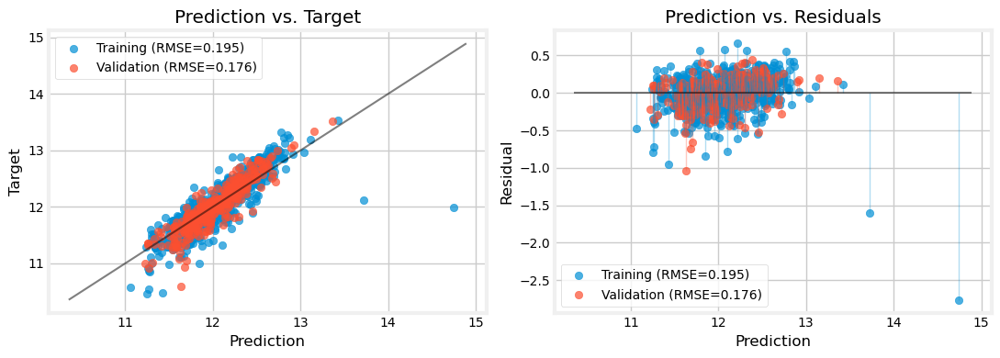



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 12:19:32
***************************************************************************
lasso_raw , 	CV: True 

***************************************************************************
We will evaluate lasso_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.1576249521298808
		best params: {'model__alpha': 0.0004411959206764393, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.5862645349723742, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.857062
R2,0.857062
MAE,0.103613
MSE,0.022350
RMSE,0.149500
MedAE,0.077431
MAPE,0.008661




Regression Report: Validation
..................................................


,Value
Explained Variance,0.883705
R2,0.883594
MAE,0.100925
MSE,0.019510
RMSE,0.139677
MedAE,0.075448
MAPE,0.008486



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


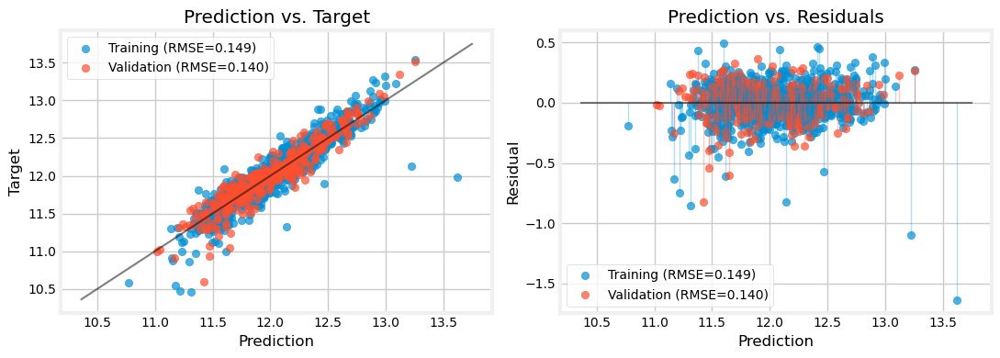



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['OverallQual', 'Neighborhood', 'GrLivArea', 'GarageCars', 'TotalBsmtSF', 'TotRmsAbvGrd', 'YearRemodAdd', 'BsmtFinType1', 'FireplaceQu', 'LotArea', 'HeatingQC', 'BsmtUnfSF', 'KitchenQual', 'GarageType_1', 'Foundation_0', 'BsmtQual', 'GarageYrBlt', 'Foundation_1', 'YearBuilt', 'Fireplaces', 'GarageType_3', 'GarageFinish', 'OpenPorchSF', 'GarageType_4', 'GarageType_0', 'GarageType_5', 'GarageType_6', 'Foundation_2', 'Foundation_3', 'Foundation_4', 'Foundation_5', 'Exterior1st', 'FullBath', 'GarageType_2', 'ExterQual', 'LotFrontage']
The most important features are:

	OverallQual: 0.11527492934738981 +- 0.004870535613637745
	Neighborhood: 0.0698724399614928 +- 0.0059792702693053515
	GrLivArea: 0.06334618856973215 +- 0.005099090734403937
	GarageCars: 0.026864267712332877 +- 0.0

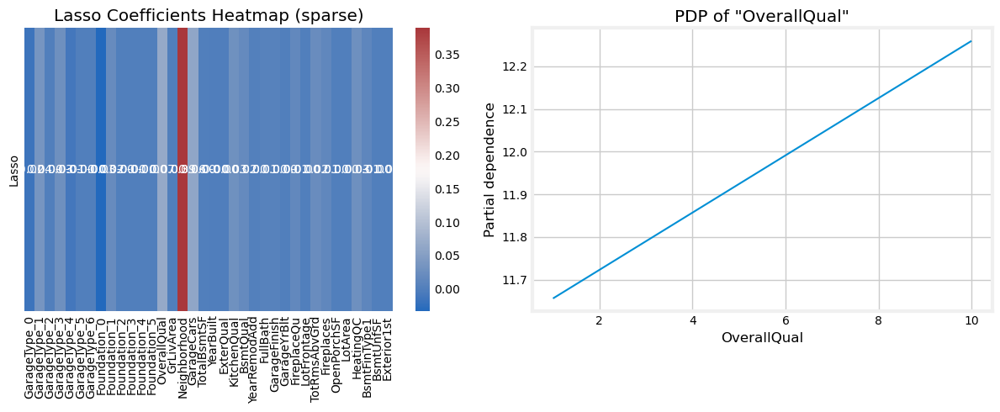

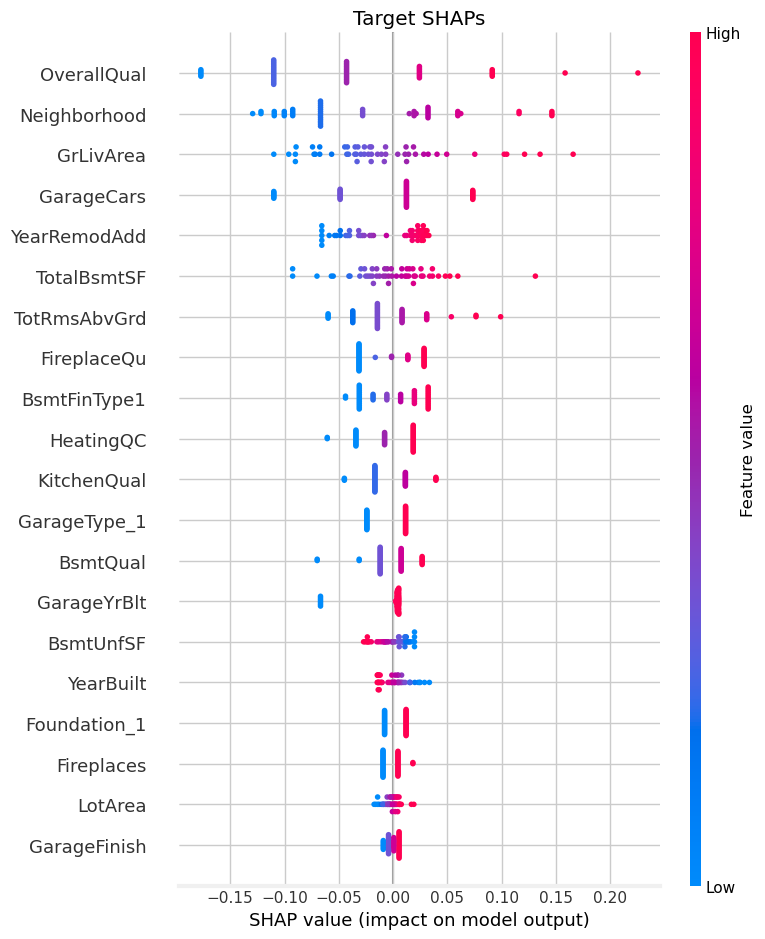

..................................................

Elapsed time: 1.56 minutes
..................................................



Time: 12:21:06
***************************************************************************
lasso_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=lasso_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.000000
R2,0.000000
MAE,0.307830
MSE,0.156362
RMSE,0.395426
MedAE,0.245592
MAPE,0.025594




Regression Report: Validation
..................................................


,Value
Explained Variance,0.000000
R2,-0.008946
MAE,0.317715
MSE,0.169099
RMSE,0.411216
MedAE,0.259211
MAPE,0.026554



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


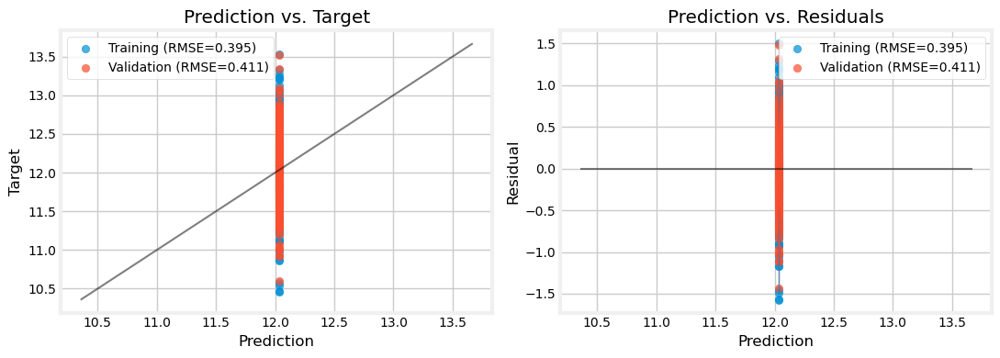



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 12:21:07
***************************************************************************
lasso_eng , 	CV: True 

***************************************************************************
We will evaluate lasso_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.14467287095524278
		best params: {'model__alpha': 0.002073060056065362, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.2833754584692636, 'preprocessor__target_encoder__smoothing': 40.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.878171
R2,0.878171
MAE,0.096158
MSE,0.019049
RMSE,0.138020
MedAE,0.072611
MAPE,0.008018




Regression Report: Validation
..................................................


,Value
Explained Variance,0.899469
R2,0.899279
MAE,0.093771
MSE,0.016881
RMSE,0.129926
MedAE,0.069399
MAPE,0.007873



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


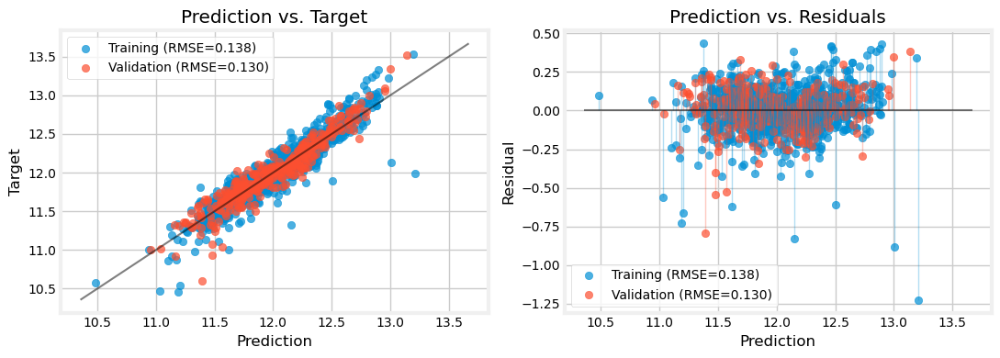



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['TotalSF', 'OverallQualCond', 'Neighborhood', 'AllBaths', 'GarageCars', 'TotalBsmtSF', 'FireplaceQu', 'KitchenQual', 'YearBuilt', 'MSSubClass', '1stFlrSF', 'BsmtQual', 'OverallQual', 'LotFrontage', 'GarageArea', 'GarageFinish', 'YearRemodAdd', 'FullBath', 'ExterQual', 'GarageType_0', 'GarageType_1', 'GarageType_2', 'GarageType_3', 'GarageType_4', 'GarageType_5', 'GarageType_6', 'BathsAbvGr', 'Has_Garage', 'Has_Bsmt']
The most important features are:

	TotalSF: 0.1857889590232834 +- 0.010111060716483922
	OverallQualCond: 0.07322205605294559 +- 0.003724408192815885
	Neighborhood: 0.0711511243719076 +- 0.0025438125909954794
	AllBaths: 0.025269243589527222 +- 0.002338338835457078
	GarageCars: 0.011024726492649206 +- 0.0011399200267980048
	TotalBsmtSF: 0.00993029059360857 +- 0.

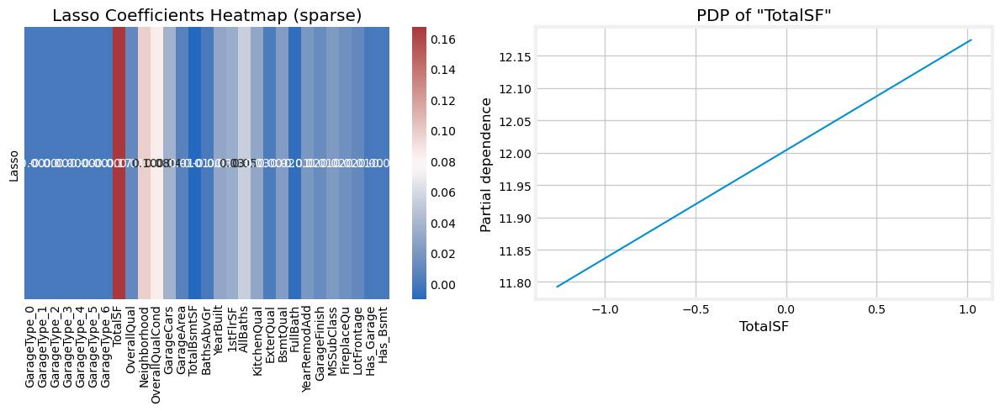

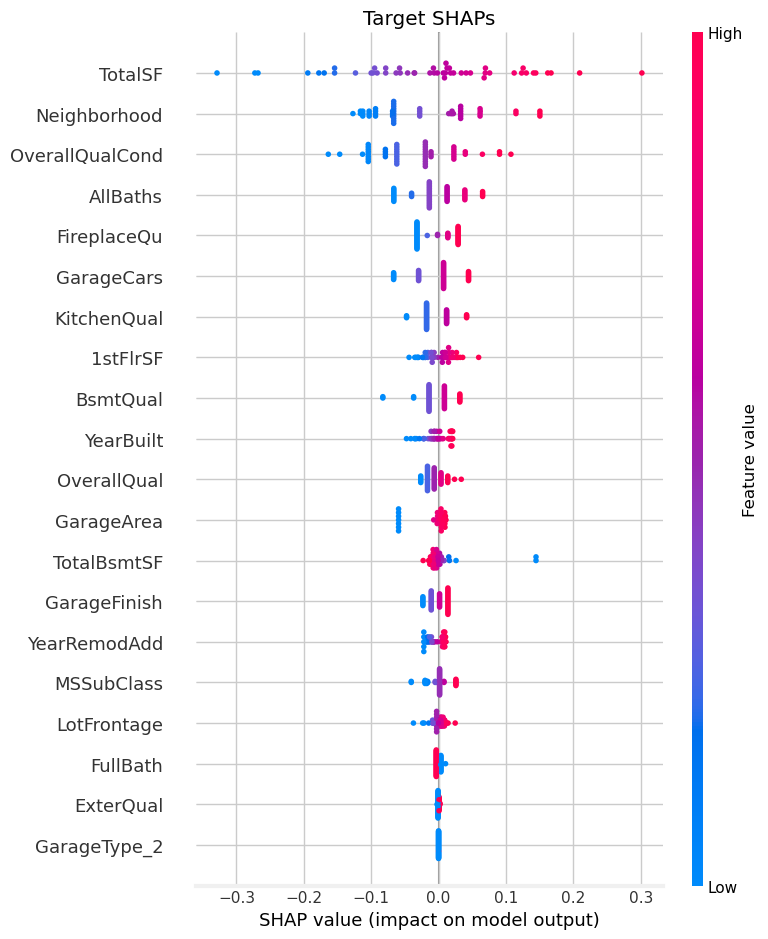

..................................................

Elapsed time: 1.91 minutes
..................................................



Time: 12:23:02
***************************************************************************
lasso_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=lasso_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.000000
R2,0.000000
MAE,0.307830
MSE,0.156362
RMSE,0.395426
MedAE,0.245592
MAPE,0.025594




Regression Report: Validation
..................................................


,Value
Explained Variance,0.000000
R2,-0.008946
MAE,0.317715
MSE,0.169099
RMSE,0.411216
MedAE,0.259211
MAPE,0.026554



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


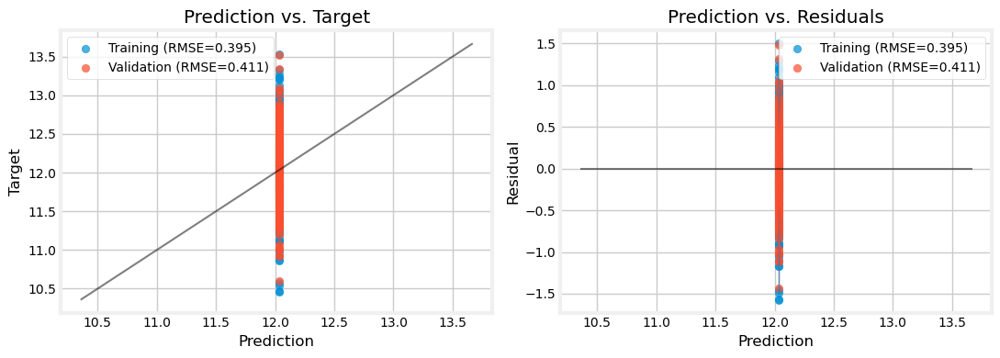



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 12:23:04
***************************************************************************
lasso_clus , 	CV: True 

***************************************************************************
We will evaluate lasso_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.1444581124252942
		best params: {'model__alpha': 0.001195760099973613, 'preprocessor__cluster__n_clusters': 5, 'preprocessor__pca__fit_feat_subset': True, 'preprocessor__pca__keep_original_feats': False, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.3184071210351237, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Re

,Value
Explained Variance,0.879325
R2,0.879325
MAE,0.095367
MSE,0.018869
RMSE,0.137365
MedAE,0.071983
MAPE,0.007952




Regression Report: Validation
..................................................


,Value
Explained Variance,0.900637
R2,0.900332
MAE,0.093611
MSE,0.016704
RMSE,0.129245
MedAE,0.070335
MAPE,0.007858



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


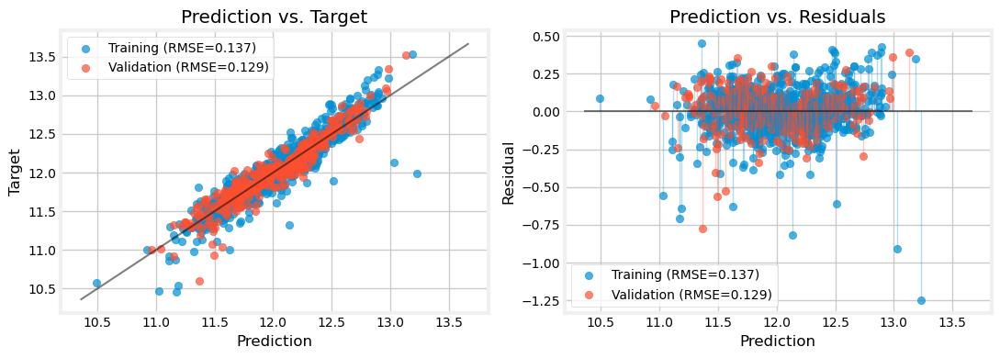



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['pca0', 'pca7', 'pca1', 'pca9', 'pca5', 'AllBaths', 'pca2', 'pca6', 'pca4', 'FireplaceQu', 'GarageCars', 'BsmtQual', 'KitchenQual', 'OverallQual', 'FullBath', 'pca3', 'GarageFinish', 'cluster_1', 'GarageType_1', 'GarageType_3', 'ExterQual', 'GarageType_0', 'GarageType_2', 'GarageType_4', 'GarageType_5', 'GarageType_6', 'cluster_0', 'cluster_2', 'cluster_3', 'cluster_4', 'BathsAbvGr', 'Has_Garage', 'Has_Bsmt', 'pca8']
The most important features are:

	pca0: 1.344114758254185 +- 0.04809642451089432
	pca7: 0.0843960264718272 +- 0.004002486270069744
	pca1: 0.06948420977800615 +- 0.0033686064703550875
	pca9: 0.05831301225771435 +- 0.004422747424108673
	pca5: 0.05701709362036807 +- 0.005488951319834515
	AllBaths: 0.029178457596302866 +- 0.0024624506882017618
	pca2: 0.0209041268

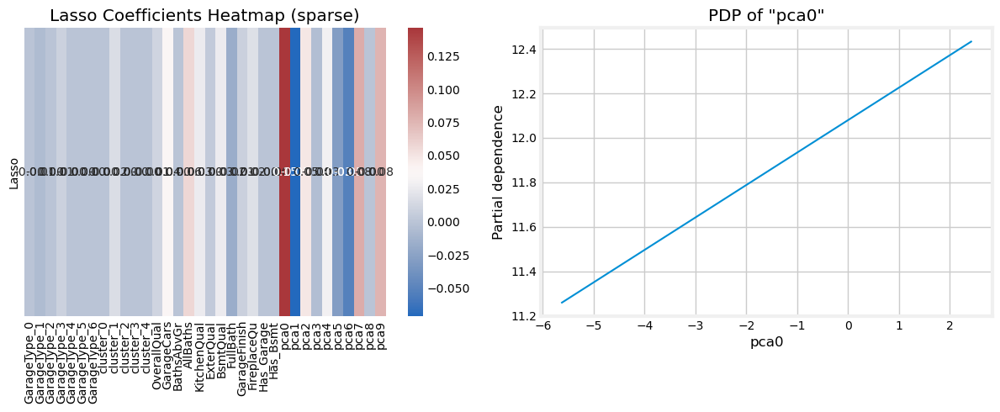

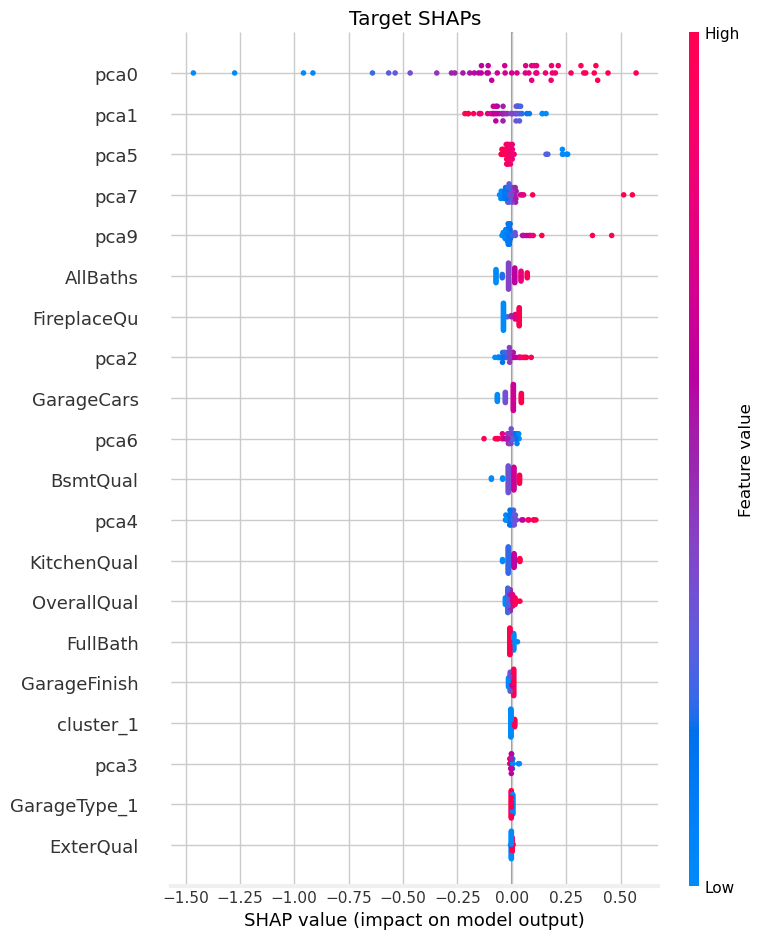

..................................................

Elapsed time: 2.05 minutes
..................................................





In [339]:
model = 'lasso'

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=100,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [340]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv,rfr_raw_no_cv,rfr_raw_cv,rfr_eng_no_cv,rfr_eng_cv,rfr_clus_no_cv,rfr_clus_cv,xgbr_raw_no_cv,xgbr_raw_cv,xgbr_eng_no_cv,xgbr_eng_cv,xgbr_clus_no_cv,xgbr_clus_cv,linreg_raw_no_cv,linreg_raw_cv,linreg_eng_no_cv,linreg_eng_cv,linreg_clus_no_cv,linreg_clus_cv,lasso_raw_no_cv,lasso_raw_cv,lasso_eng_no_cv,lasso_eng_cv,lasso_clus_no_cv,lasso_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577,0.056091,0.066092,0.054656,0.059556,0.056244,0.073190,0.004774,0.016233,0.009846,0.091029,0.008072,0.097619,0.099541,0.150483,0.141500,0.136019,0.141334,0.135638,0.195434,0.149500,0.395426,0.138020,0.395426,0.137365
R2 Score Validation,0.891477,7.513521e-01,0.697498,0.772228,0.787640,0.773686,0.784581,0.891477,0.879756,0.887772,0.886950,0.880742,0.876900,0.894659,0.864149,0.878283,0.882471,0.861914,0.885697,0.895123,0.878597,0.892702,0.901113,0.892984,0.901111,0.814858,0.883594,-0.008946,0.899279,-0.008946,0.900332
RMSE Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577,0.056091,0.066092,0.054656,0.059556,0.056244,0.073190,0.004774,0.016233,0.009846,0.091029,0.008072,0.097619,0.099541,0.150483,0.141500,0.136019,0.141334,0.135638,0.195434,0.149500,0.395426,0.138020,0.395426,0.137365
RMSE Validation,0.134864,2.041404e-01,0.225165,0.195383,0.188657,0.194757,0.190011,0.134864,0.141961,0.137147,0.137648,0.141377,0.143637,0.132873,0.150893,0.142828,0.140349,0.152129,0.138409,0.132579,0.142643,0.134101,0.128738,0.133925,0.128739,0.176152,0.139677,0.411216,0.129926,0.411216,0.129245


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [341]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [342]:
best_cv[model+'_clus']['params']

{'model__alpha': 0.001195760099973613,
 'preprocessor__cluster__n_clusters': 5,
 'preprocessor__pca__fit_feat_subset': True,
 'preprocessor__pca__keep_original_feats': False,
 'preprocessor__selector__best_k': 30,
 'preprocessor__selector__t_thr': 0.3184071210351237,
 'preprocessor__target_encoder__smoothing': 50.0}

In [343]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [344]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,Neighborhood,GarageCars,OverallQualCond,GarageArea,YearBuilt,TotalBsmtSF,BathsAbvGr,1stFlrSF,AllBaths,KitchenQual,ExterQual,BsmtQual,YearRemodAdd,FullBath,GarageFinish,MSSubClass,FireplaceQu,LotFrontage,GarageType,Has_Garage,Has_Bsmt
6,0.742068,8,0.472509,2,0.5,0.502730,0.659574,1.052674,2.0,0.919677,3.0,4,4,5,0.305556,2,2,0.000000,4,0.239984,1,1,1
807,0.367177,5,-1.069603,2,-0.5,0.170238,-1.063830,0.569246,1.5,-0.048785,3.5,4,3,3,0.277778,1,2,-0.340399,3,2.518040,1,1,1
955,0.398207,6,0.288295,2,0.1,0.044102,-0.574468,-0.034421,2.0,-0.240817,2.0,3,3,4,-1.222222,2,1,-0.746899,0,0.550685,1,1,1
1040,0.398207,5,-0.738474,2,-1.5,0.014822,-0.340426,0.259462,2.0,1.051686,3.0,3,3,3,0.166667,2,2,0.073230,3,0.796813,1,1,1
701,-0.170534,7,0.108607,2,0.0,0.170238,-0.085106,0.311677,1.5,0.125459,1.5,3,3,3,-0.694444,1,1,0.023096,0,0.464671,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,0.108607,2,-0.5,-0.007457,0.021277,0.132054,2.0,0.439205,2.0,3,3,4,-0.555556,2,2,0.023096,3,0.376507,1,1,1
905,-0.400741,5,-0.774909,1,-1.0,-0.961984,-0.404255,0.116963,1.0,-0.066626,2.0,3,3,3,-1.111111,1,2,0.073230,0,0.464671,1,1,1
1096,-0.494922,6,-1.399037,0,0.7,-11.052923,-1.255319,-0.751207,1.5,-0.740655,1.5,4,3,3,0.333333,1,0,-0.182551,0,-0.535329,6,0,1
235,-1.295571,6,-1.118567,1,-1.7,-1.066905,-0.042553,-1.446378,1.5,-1.735090,1.5,3,3,3,-0.638889,1,1,-0.777253,0,-4.131663,5,1,1


In [345]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                 PCAFeature(fit_feat_subset=True, keep_original_feats=False)),
                ('cluster',
                 KMeansFeature(n_clusters=5, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x73cc40b57ec0>)],
                                                    verbose_feature_names_out=False))]))])

In [346]:
del best_preproc, best_feats

### Model 6: `Ridge`

In [347]:
model = 'ridge'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', Ridge(max_iter=10_000,
                                        random_state=0))])

    pipe[model_name+'_no_cv'] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', Ridge(max_iter=10_000,
                                        random_state=0))])

    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
            [False, True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [True, False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__alpha'] =\
        loguniform(1.e-2, 100.)

Time: 12:49:36
***************************************************************************
ridge_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=ridge_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.928087
R2,0.928087
MAE,0.075729
MSE,0.011245
RMSE,0.106040
MedAE,0.058273
MAPE,0.006317




Regression Report: Validation
..................................................


,Value
Explained Variance,0.892801
R2,0.892717
MAE,0.096955
MSE,0.017981
RMSE,0.134092
MedAE,0.068468
MAPE,0.008150



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


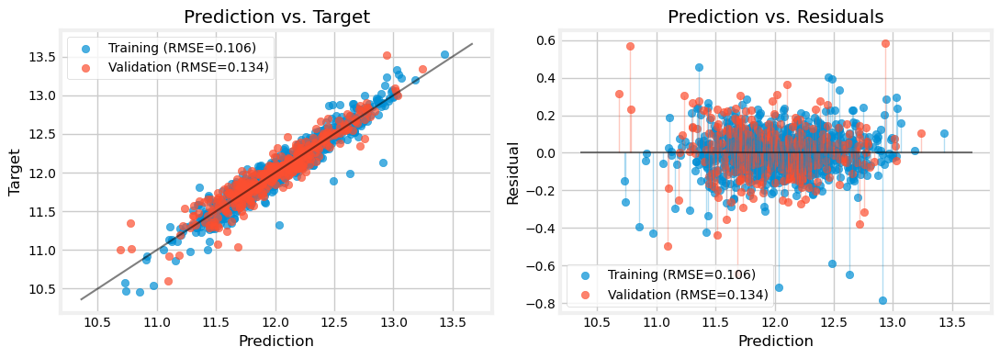



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 12:49:38
***************************************************************************
ridge_raw , 	CV: True 

***************************************************************************
We will evaluate ridge_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.15735860271550245
		best params: {'model__alpha': 0.021562034757051752, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.6853550051717524, 'preprocessor__target_encoder__smoothing': 30.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.857625
R2,0.857625
MAE,0.107199
MSE,0.022262
RMSE,0.149205
MedAE,0.086519
MAPE,0.008940




Regression Report: Validation
..................................................


,Value
Explained Variance,0.872190
R2,0.871649
MAE,0.109595
MSE,0.021512
RMSE,0.146668
MedAE,0.082151
MAPE,0.009193



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


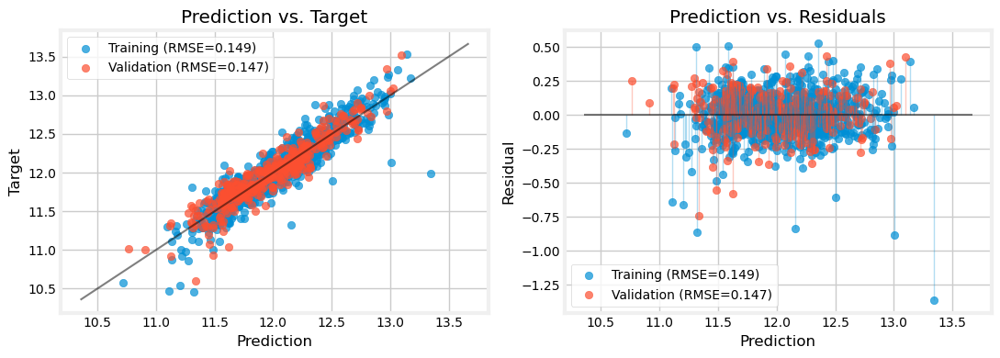



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['GarageYrBlt', 'GarageType_6', 'GarageType_1', 'OverallQual', 'Neighborhood', 'GarageType_5', 'TotRmsAbvGrd', 'GarageCars', 'GarageType_3', 'TotalBsmtSF', 'OverallCond', 'BsmtFinType1', 'Fireplaces', 'HeatingQC', 'KitchenQual', 'Foundation_0', 'FullBath', 'Foundation_3', 'BsmtQual', 'Foundation_1', 'GarageType_4', 'GarageFinish', 'YearRemodAdd', 'YearBuilt', 'GarageType_0', 'FireplaceQu', 'Foundation_4', 'ExterQual', 'Foundation_5', 'LotFrontage', 'Foundation_2', 'OpenPorchSF', 'GarageType_2']
The most important features are:

	GarageYrBlt: 1.070629371500152 +- 0.06373535444784903
	GarageType_6: 0.7293669349801635 +- 0.046416843590748505
	GarageType_1: 0.11228275144355322 +- 0.017107195786163338
	OverallQual: 0.09545414000764592 +- 0.005388639579704189
	Neighborhood: 0.081

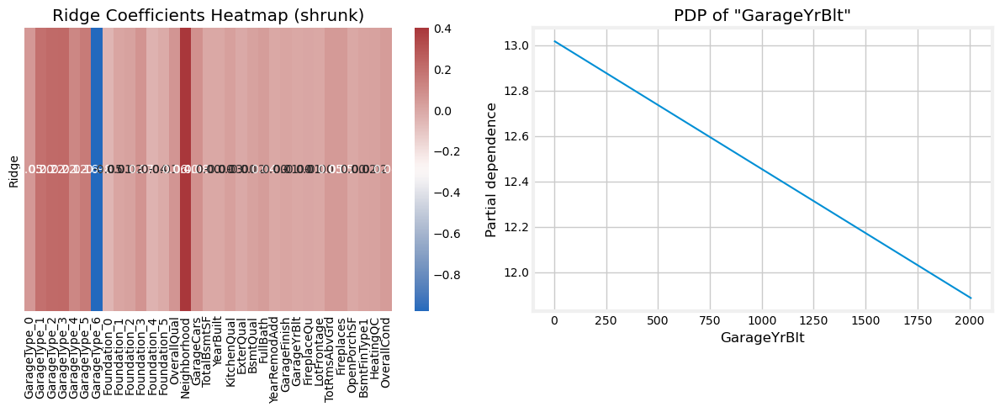

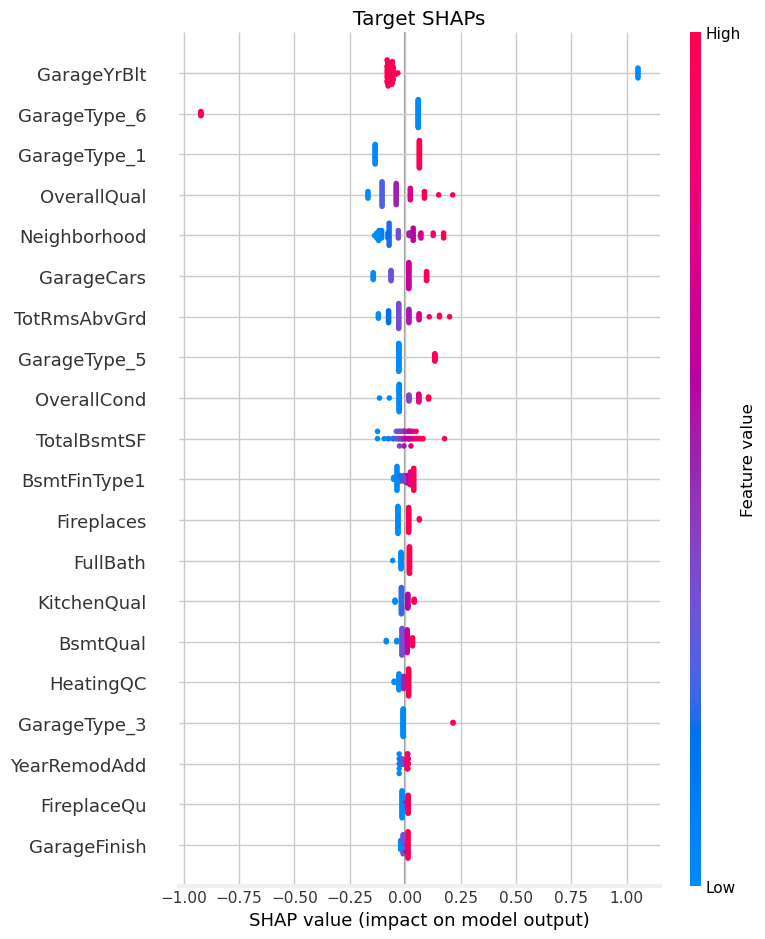

..................................................

Elapsed time: 1.55 minutes
..................................................



Time: 12:51:11
***************************************************************************
ridge_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=ridge_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.871734
R2,0.871734
MAE,0.100317
MSE,0.020056
RMSE,0.141619
MedAE,0.076660
MAPE,0.008373




Regression Report: Validation
..................................................


,Value
Explained Variance,0.893483
R2,0.893122
MAE,0.098435
MSE,0.017913
RMSE,0.133839
MedAE,0.075866
MAPE,0.008267



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


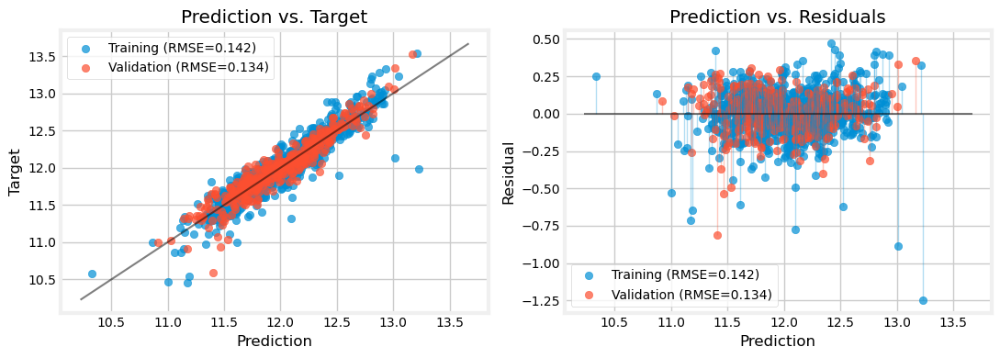



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 12:51:13
***************************************************************************
ridge_eng , 	CV: True 

***************************************************************************
We will evaluate ridge_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.14434445713522834
		best params: {'model__alpha': 10.198541887075143, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.4032270176830546, 'preprocessor__target_encoder__smoothing': 50.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.879994
R2,0.879994
MAE,0.095204
MSE,0.018764
RMSE,0.136983
MedAE,0.072356
MAPE,0.007942




Regression Report: Validation
..................................................


,Value
Explained Variance,0.899747
R2,0.899484
MAE,0.094271
MSE,0.016846
RMSE,0.129794
MedAE,0.073153
MAPE,0.007919



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


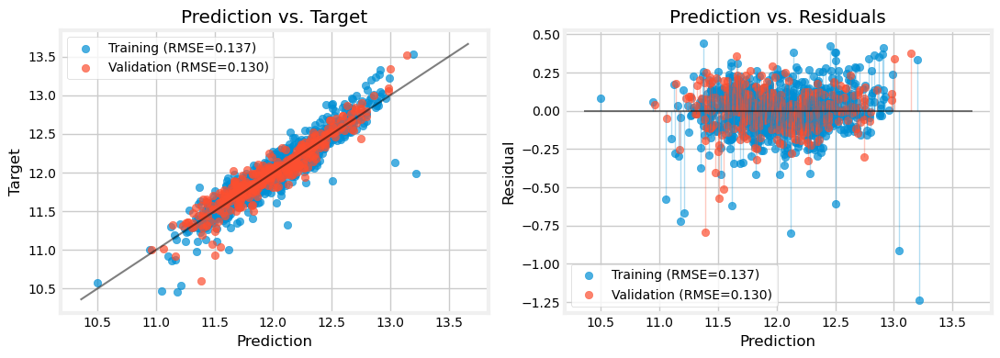



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['TotalSF', 'Neighborhood', 'OverallQualCond', 'AllBaths', 'GarageCars', 'TotalBsmtSF', '1stFlrSF', 'BsmtQual', 'FullBath', 'MSSubClass', 'FireplaceQu', 'KitchenQual', 'OverallQual', '2ndFlrSF', 'RemodAge', 'GarageArea', 'LotFrontage', 'GarageFinish', 'GarageType_3', 'BathsAbvGr', 'Has_Bsmt', 'ExterQual', 'GarageType_4', 'GarageType_6', 'Has_Garage', 'GarageType_1', 'GarageType_0', 'GarageType_5', 'Has_2ndFlr', 'GarageType_2']
The most important features are:

	TotalSF: 0.15470732209142107 +- 0.008207532328770138
	Neighborhood: 0.07214277893344416 +- 0.0027475312521912636
	OverallQualCond: 0.06194323735408398 +- 0.00400670855501816
	AllBaths: 0.031519783525231285 +- 0.0027422630350019124
	GarageCars: 0.013919950872643683 +- 0.0011548433064665002
	TotalBsmtSF: 0.013413423979

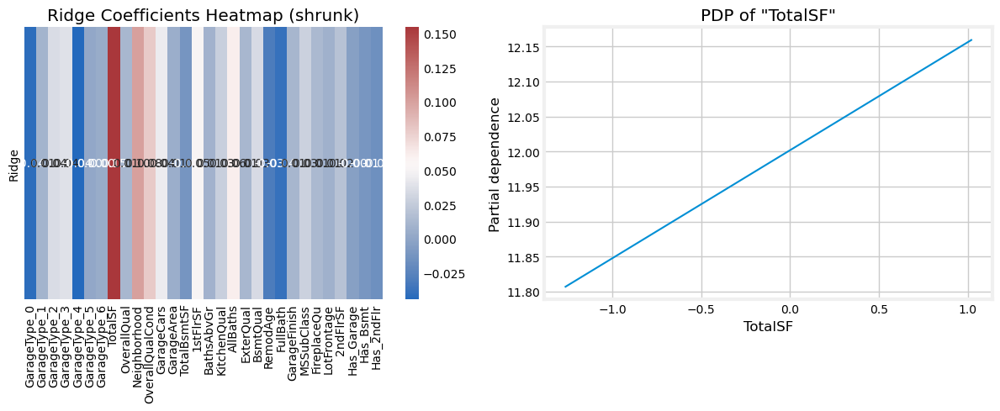

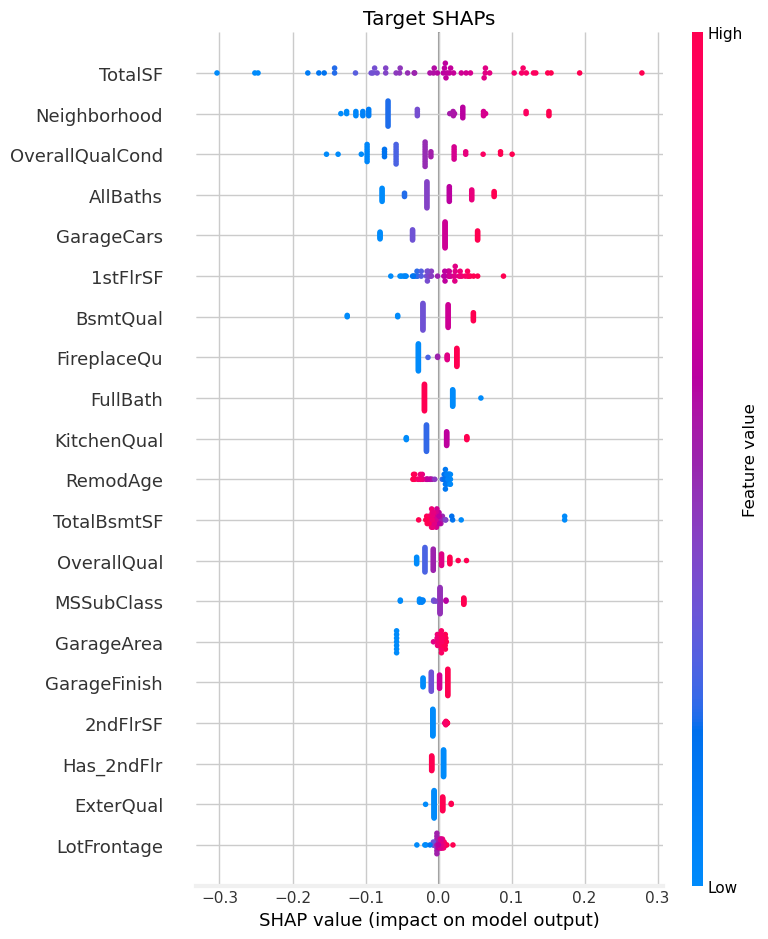

..................................................

Elapsed time: 1.83 minutes
..................................................



Time: 12:53:03
***************************************************************************
ridge_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=ridge_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.872145
R2,0.872145
MAE,0.100234
MSE,0.019992
RMSE,0.141392
MedAE,0.077445
MAPE,0.008367




Regression Report: Validation
..................................................


,Value
Explained Variance,0.893609
R2,0.893256
MAE,0.098514
MSE,0.017890
RMSE,0.133755
MedAE,0.075381
MAPE,0.008275



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


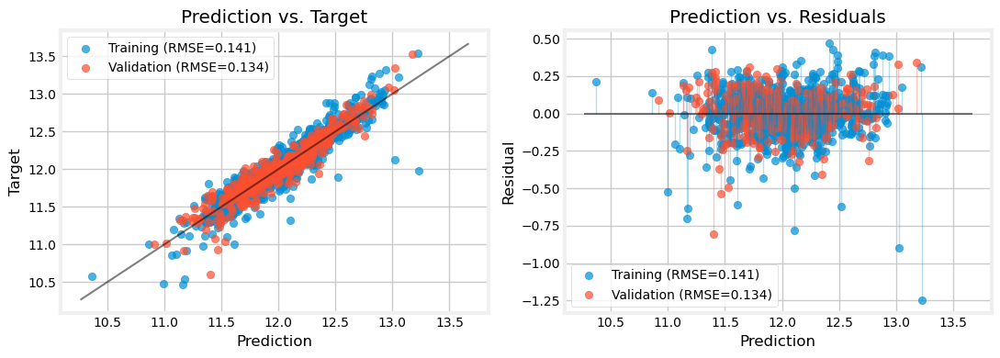



..................................................

Elapsed time: 0.03 minutes
..................................................



Time: 12:53:05
***************************************************************************
ridge_clus , 	CV: True 

***************************************************************************
We will evaluate ridge_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.1437482813900335
		best params: {'model__alpha': 20.689982192171303, 'preprocessor__cluster__n_clusters': 5, 'preprocessor__pca__fit_feat_subset': False, 'preprocessor__pca__keep_original_feats': False, 'preprocessor__selector__best_k': 30, 'preprocessor__selector__t_thr': 0.3160063785537319, 'preprocessor__target_encoder__smoothing': 30.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Reg

,Value
Explained Variance,0.880283
R2,0.880283
MAE,0.094823
MSE,0.018719
RMSE,0.136818
MedAE,0.070776
MAPE,0.007908




Regression Report: Validation
..................................................


,Value
Explained Variance,0.900578
R2,0.900282
MAE,0.093575
MSE,0.016713
RMSE,0.129278
MedAE,0.071892
MAPE,0.007855



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


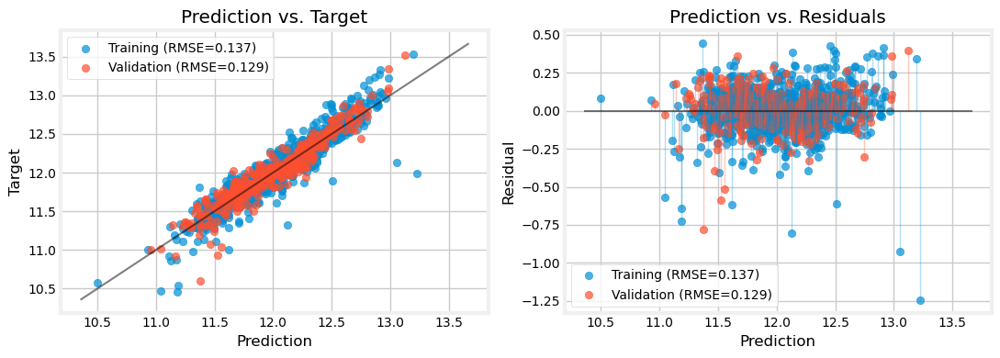



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['pca0', 'pca2', 'pca3', 'AllBaths', 'pca5', 'FireplaceQu', 'GarageCars', 'pca4', 'FullBath', 'BsmtQual', 'pca9', 'OverallQual', 'pca7', 'KitchenQual', 'pca8', 'pca6', 'pca1', 'GarageType_5', 'GarageFinish', 'cluster_2', 'cluster_1', 'BathsAbvGr', 'cluster_0', 'GarageType_1', 'GarageType_3', 'ExterQual', 'GarageType_4', 'cluster_4', 'Has_Bsmt', 'GarageType_6', 'Has_Garage', 'GarageType_0', 'cluster_3', 'GarageType_2']
The most important features are:

	pca0: 0.4419862142566921 +- 0.01977787106047145
	pca2: 0.28083912099646974 +- 0.01048839635188251
	pca3: 0.13515048230946408 +- 0.005078016494635901
	AllBaths: 0.030815861295744495 +- 0.0024247122985662927
	pca5: 0.02692879093052176 +- 0.0035985414606832114
	FireplaceQu: 0.014894688148909685 +- 0.003049115330285096
	GarageCar

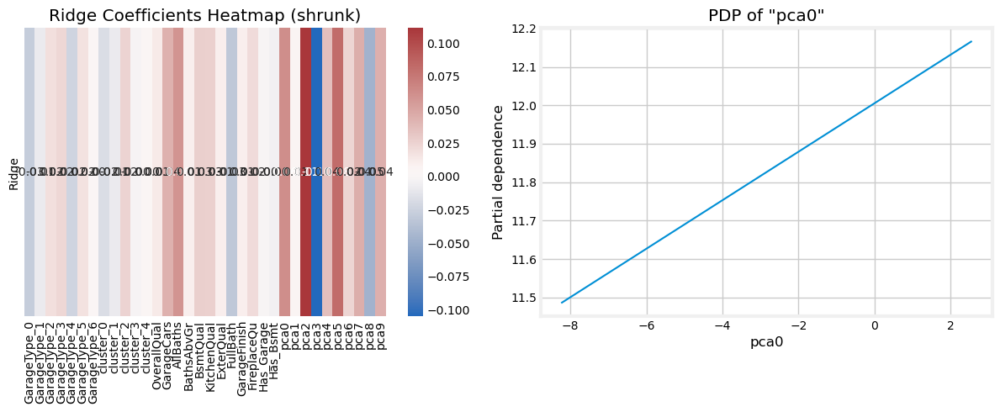

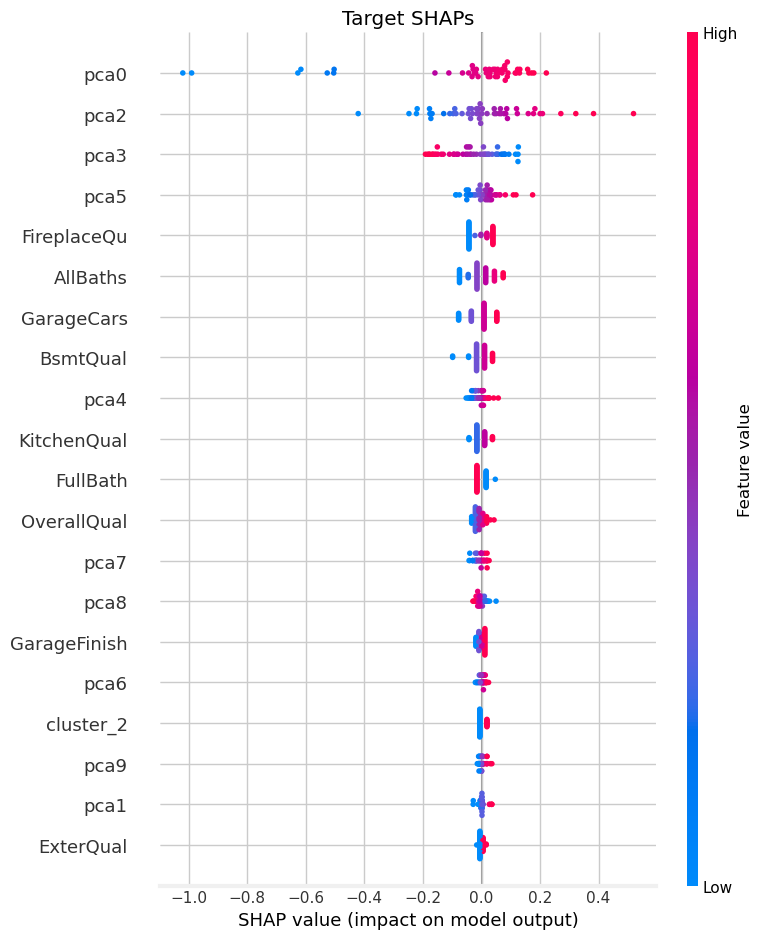

..................................................

Elapsed time: 2.01 minutes
..................................................





In [348]:
model = 'ridge'

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=100,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [349]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv,rfr_raw_no_cv,rfr_raw_cv,rfr_eng_no_cv,rfr_eng_cv,rfr_clus_no_cv,rfr_clus_cv,xgbr_raw_no_cv,xgbr_raw_cv,xgbr_eng_no_cv,xgbr_eng_cv,xgbr_clus_no_cv,xgbr_clus_cv,linreg_raw_no_cv,linreg_raw_cv,linreg_eng_no_cv,linreg_eng_cv,linreg_clus_no_cv,linreg_clus_cv,lasso_raw_no_cv,lasso_raw_cv,lasso_eng_no_cv,lasso_eng_cv,lasso_clus_no_cv,lasso_clus_cv,ridge_raw_no_cv,ridge_raw_cv,ridge_eng_no_cv,ridge_eng_cv,ridge_clus_no_cv,ridge_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577,0.056091,0.066092,0.054656,0.059556,0.056244,0.073190,0.004774,0.016233,0.009846,0.091029,0.008072,0.097619,0.099541,0.150483,0.141500,0.136019,0.141334,0.135638,0.195434,0.149500,0.395426,0.138020,0.395426,0.137365,0.106040,0.149205,0.141619,0.136983,0.141392,0.136818
R2 Score Validation,0.891477,7.513521e-01,0.697498,0.772228,0.787640,0.773686,0.784581,0.891477,0.879756,0.887772,0.886950,0.880742,0.876900,0.894659,0.864149,0.878283,0.882471,0.861914,0.885697,0.895123,0.878597,0.892702,0.901113,0.892984,0.901111,0.814858,0.883594,-0.008946,0.899279,-0.008946,0.900332,0.892717,0.871649,0.893122,0.899484,0.893256,0.900282
RMSE Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577,0.056091,0.066092,0.054656,0.059556,0.056244,0.073190,0.004774,0.016233,0.009846,0.091029,0.008072,0.097619,0.099541,0.150483,0.141500,0.136019,0.141334,0.135638,0.195434,0.149500,0.395426,0.138020,0.395426,0.137365,0.106040,0.149205,0.141619,0.136983,0.141392,0.136818
RMSE Validation,0.134864,2.041404e-01,0.225165,0.195383,0.188657,0.194757,0.190011,0.134864,0.141961,0.137147,0.137648,0.141377,0.143637,0.132873,0.150893,0.142828,0.140349,0.152129,0.138409,0.132579,0.142643,0.134101,0.128738,0.133925,0.128739,0.176152,0.139677,0.411216,0.129926,0.411216,0.129245,0.134092,0.146668,0.133839,0.129794,0.133755,0.129278


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [350]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [351]:
best_cv[model+'_clus']['params']

{'model__alpha': 20.689982192171303,
 'preprocessor__cluster__n_clusters': 5,
 'preprocessor__pca__fit_feat_subset': False,
 'preprocessor__pca__keep_original_feats': False,
 'preprocessor__selector__best_k': 30,
 'preprocessor__selector__t_thr': 0.3160063785537319,
 'preprocessor__target_encoder__smoothing': 30.0}

In [352]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [353]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,Neighborhood,GarageCars,OverallQualCond,GarageArea,YearBuilt,TotalBsmtSF,AllBaths,BathsAbvGr,1stFlrSF,BsmtQual,KitchenQual,ExterQual,FullBath,RemodAge,GarageFinish,MSSubClass,FireplaceQu,LotFrontage,GarageType,Has_Garage,Has_Bsmt
6,0.742068,8,0.511543,2,0.5,0.502730,0.659574,1.052674,3.0,2.0,0.919677,5,4,4,2,-0.333333,2,0.000000,4,0.239984,1,1,1
807,0.367177,5,-1.068155,2,-0.5,0.170238,-1.063830,0.569246,3.5,1.5,-0.048785,3,4,3,1,-0.250000,2,-0.339084,3,2.518040,1,1,1
955,0.398207,6,0.294400,2,0.1,0.044102,-0.574468,-0.034421,2.0,2.0,-0.240817,4,3,3,2,1.194444,1,-0.731344,0,0.550685,1,1,1
1040,0.398207,5,-0.753181,2,-1.5,0.014822,-0.340426,0.259462,3.0,2.0,1.051686,3,3,3,2,-0.222222,2,0.069787,3,0.796813,1,1,1
701,-0.170534,7,0.127694,2,0.0,0.170238,-0.085106,0.311677,1.5,1.5,0.125459,3,3,3,1,0.638889,1,0.022106,0,0.464671,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,0.127694,2,-0.5,-0.007457,0.021277,0.132054,2.0,2.0,0.439205,4,3,3,2,0.583333,2,0.022106,3,0.376507,1,1,1
905,-0.400741,5,-0.771817,1,-1.0,-0.961984,-0.404255,0.116963,2.0,1.0,-0.066626,3,3,3,1,1.166667,2,0.069787,0,0.464671,1,1,1
1096,-0.494922,6,-1.292879,0,0.7,-11.052923,-1.255319,-0.751207,1.5,1.5,-0.740655,3,4,3,1,-0.361111,0,-0.180492,0,-0.535329,6,0,1
235,-1.295571,6,-0.961599,1,-1.7,-1.066905,-0.042553,-1.446378,1.5,1.5,-1.735090,3,3,3,1,0.638889,1,-0.786268,0,-4.131663,5,1,1


In [354]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                ('pca', PCAFeature(keep_original_feats=False)),
                ('cluster',
                 KMeansFeature(n_clusters=5, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x73cc40b57ec0>)],
                                                    verbose_feature_names_out=False))]))])

In [355]:
del best_preproc, best_feats

### Model 7: `KNeighborsRegressor`

In [356]:
model = 'knn'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] = Pipeline(steps=[('preprocessor', preproc_pipe),
                                       ('model', KNeighborsRegressor())])

    pipe[model_name+'_no_cv'] = Pipeline(steps=[('preprocessor', preproc_pipe),
                                       ('model', KNeighborsRegressor())])

    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
            [False, True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [True, False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__n_neighbors'] = list(range(3, 11))
    param_grid[model_name]['model__weights'] = ['uniform', 'distance']
    param_grid[model_name]['model__algorithm'] =\
        ['auto', 'ball_tree', 'kd_tree', 'brute']
    param_grid[model_name]['model__leaf_size'] =\
        [5*i for i in range(1, 4)]
    param_grid[model_name]['model__p'] = [1, 2]

Time: 12:55:05
***************************************************************************
knn_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=knn_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.778874
R2,0.778377
MAE,0.137909
MSE,0.034653
RMSE,0.186154
MedAE,0.102666
MAPE,0.011490




Regression Report: Validation
..................................................


,Value
Explained Variance,0.632904
R2,0.632831
MAE,0.176621
MSE,0.061537
RMSE,0.248067
MedAE,0.134285
MAPE,0.014799



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


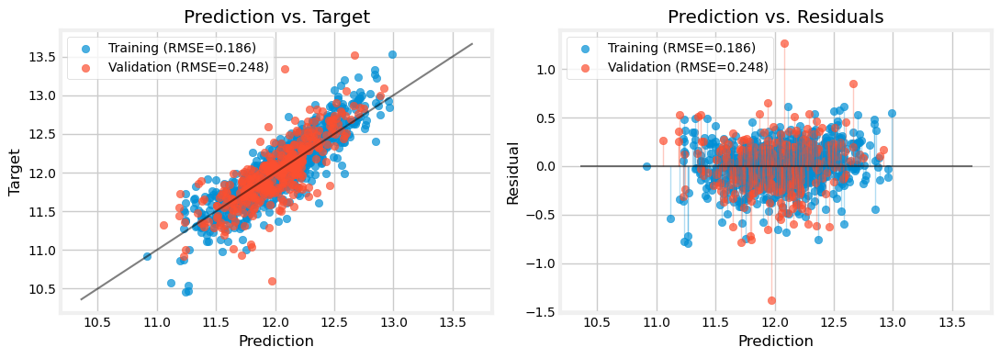



..................................................

Elapsed time: 0.02 minutes
..................................................



Time: 12:55:07
***************************************************************************
knn_raw , 	CV: True 

***************************************************************************
We will evaluate knn_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.1890108875119224
		best params: {'model__algorithm': 'auto', 'model__leaf_size': 10, 'model__n_neighbors': 8, 'model__p': 1, 'model__weights': 'distance', 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.30348518541631436, 'preprocessor__target_encoder__smoothing': 40.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
............................

,Value
Explained Variance,0.999976
R2,0.999976
MAE,0.000116
MSE,0.000004
RMSE,0.001937
MedAE,0.000000
MAPE,0.000010




Regression Report: Validation
..................................................


,Value
Explained Variance,0.776897
R2,0.774270
MAE,0.137969
MSE,0.037832
RMSE,0.194505
MedAE,0.097356
MAPE,0.011612



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


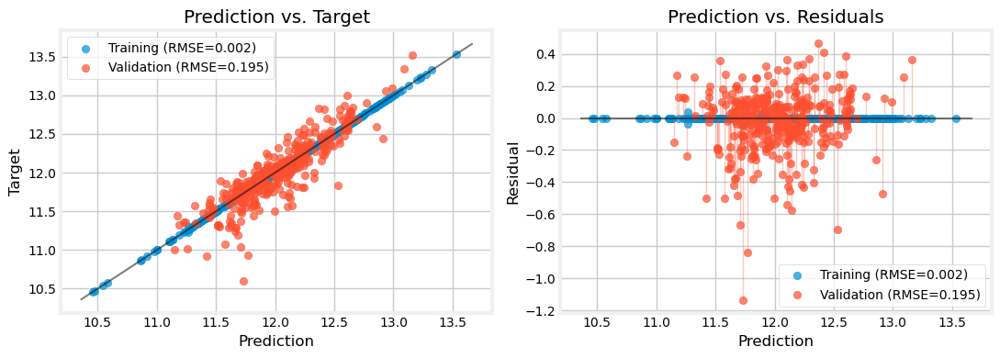



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['GrLivArea', 'TotalBsmtSF', 'GarageYrBlt', 'GarageArea', 'YearBuilt', 'YearRemodAdd', 'LotFrontage', 'OverallQual', 'BsmtQual', 'Neighborhood', 'FireplaceQu', 'KitchenQual', 'MSSubClass', 'GarageCars', 'GarageType_4', 'Foundation_5', 'GarageType_0', 'Foundation_4', 'GarageType_2', 'GarageType_3', 'Foundation_0', 'Foundation_3', 'ExterQual', 'GarageType_6', 'GarageType_1', 'Foundation_2', 'FullBath', 'GarageFinish', 'GarageType_5', 'Foundation_1']
The most important features are:

	GrLivArea: 0.3797333104021901 +- 0.014643276152563264
	TotalBsmtSF: 0.16566448167211395 +- 0.00838642447234353
	GarageYrBlt: 0.10337991861490865 +- 0.017087926208484473
	GarageArea: 0.04131036544186188 +- 0.011329307304692773
	YearBuilt: 0.021020566414256446 +- 0.002840338616828596
	YearRemodAdd:

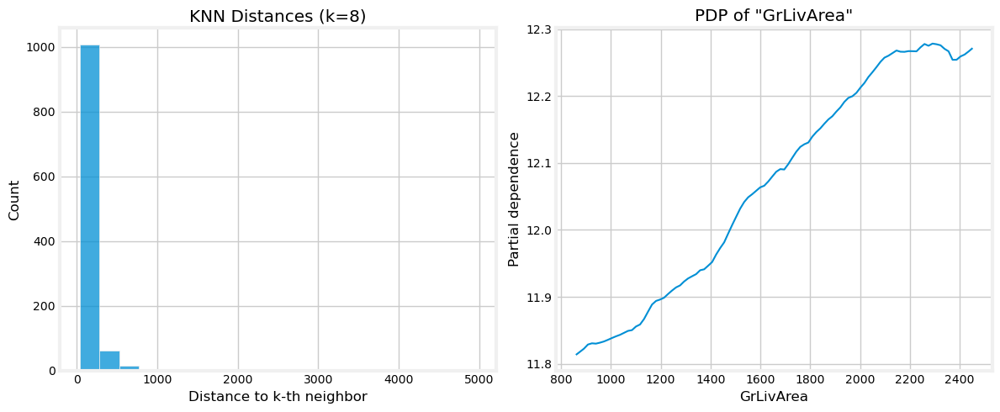

  0%|          | 0/50 [00:00<?, ?it/s]

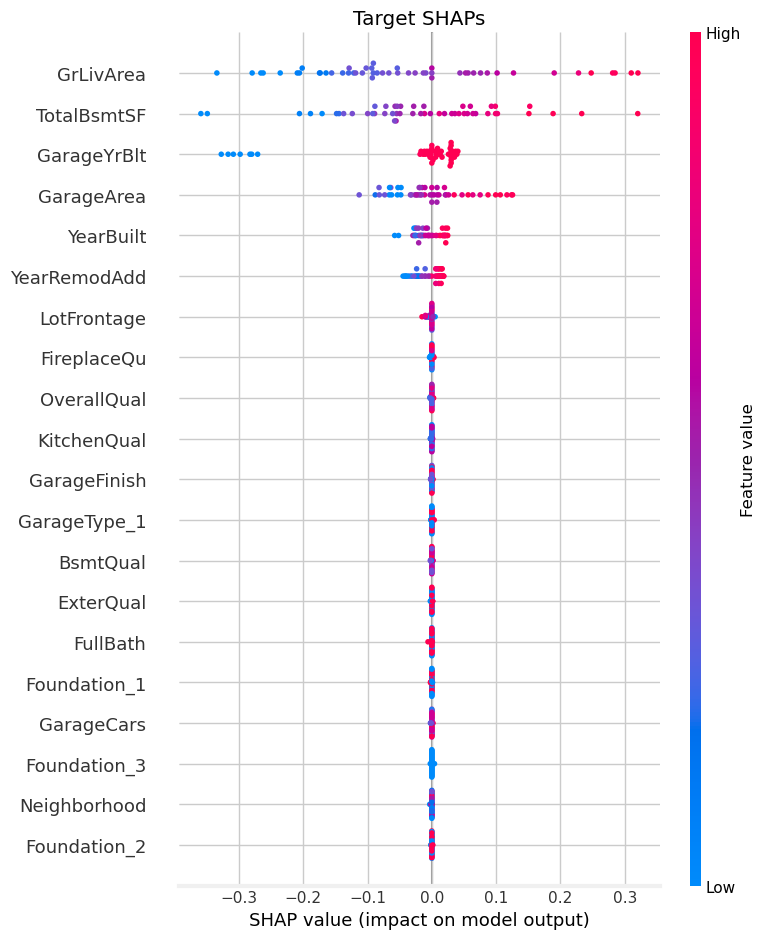

..................................................

Elapsed time: 1.85 minutes
..................................................



Time: 12:56:58
***************************************************************************
knn_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=knn_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.891635
R2,0.891385
MAE,0.091408
MSE,0.016983
RMSE,0.130320
MedAE,0.061615
MAPE,0.007622




Regression Report: Validation
..................................................


,Value
Explained Variance,0.855089
R2,0.855047
MAE,0.108727
MSE,0.024294
RMSE,0.155866
MedAE,0.073597
MAPE,0.009164



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


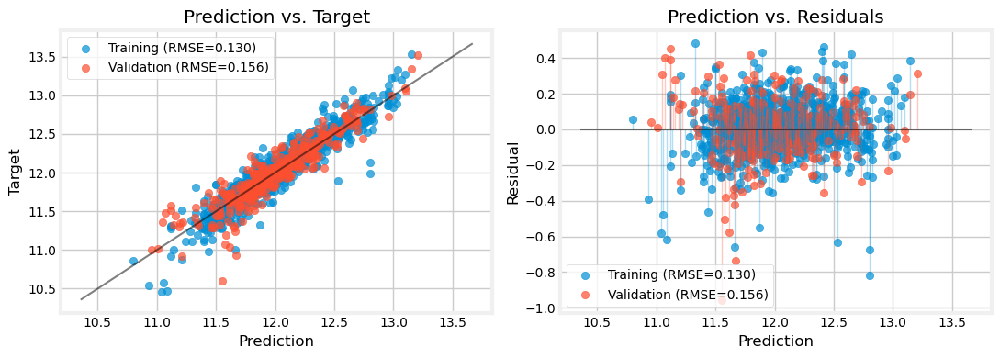



..................................................

Elapsed time: 0.06 minutes
..................................................



Time: 12:57:01
***************************************************************************
knn_eng , 	CV: True 

***************************************************************************
We will evaluate knn_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.16007084622012896
		best params: {'model__algorithm': 'auto', 'model__leaf_size': 10, 'model__n_neighbors': 8, 'model__p': 1, 'model__weights': 'distance', 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.30348518541631436, 'preprocessor__target_encoder__smoothing': 40.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
...........................

,Value
Explained Variance,0.999963
R2,0.999963
MAE,0.000156
MSE,0.000006
RMSE,0.002394
MedAE,0.000000
MAPE,0.000013




Regression Report: Validation
..................................................


,Value
Explained Variance,0.856396
R2,0.856035
MAE,0.107194
MSE,0.024128
RMSE,0.155333
MedAE,0.072166
MAPE,0.009022



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


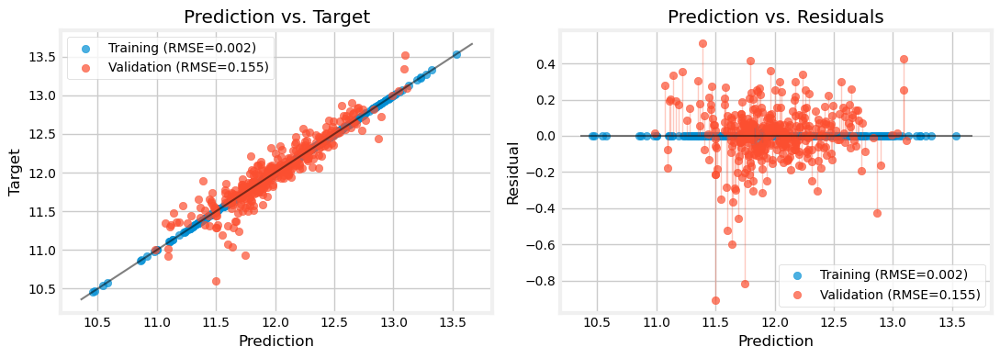



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['AllBaths', 'TotalSF', 'GarageArea', 'OverallQual', 'Neighborhood', 'OverallQualCond', 'TotalBsmtSF', 'YearBuilt', 'BathsAbvGr', '1stFlrSF', 'BsmtQual', 'KitchenQual', 'ExterQual', 'Has_Bsmt', 'GarageCars', 'Has_Garage']
The most important features are:

	AllBaths: 0.024042881202997513 +- 0.0023688270692896257
	TotalSF: 0.02377718294371902 +- 0.0036773908130468707
	GarageArea: 0.019674485497037587 +- 0.005642676161101253
	OverallQual: 0.019346543264880854 +- 0.004191909243582292
	Neighborhood: 0.01538755049828786 +- 0.002227886339398386
	OverallQualCond: 0.014231506126347892 +- 0.0024590590178097437
	TotalBsmtSF: 0.007560068411471587 +- 0.0023437966931158603
	YearBuilt: 0.005456170979817853 +- 0.002053838575984764
	BathsAbvGr: 0.0034597378534297674 +- 0.0026973017836671546

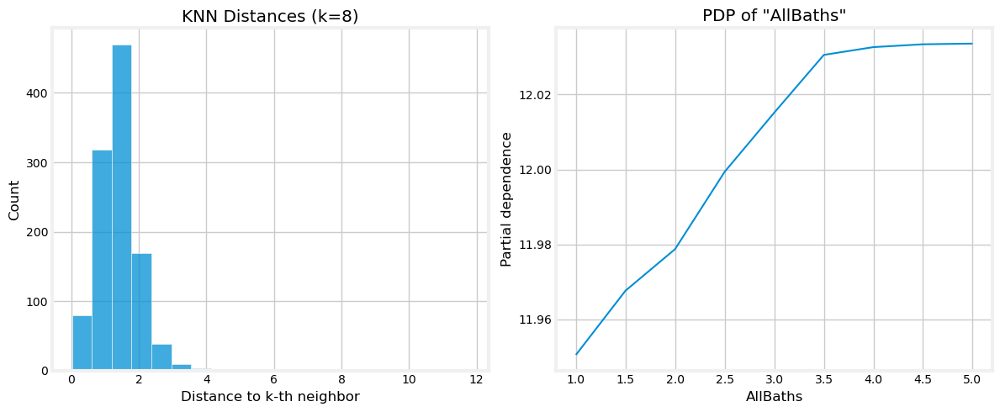

  0%|          | 0/50 [00:00<?, ?it/s]

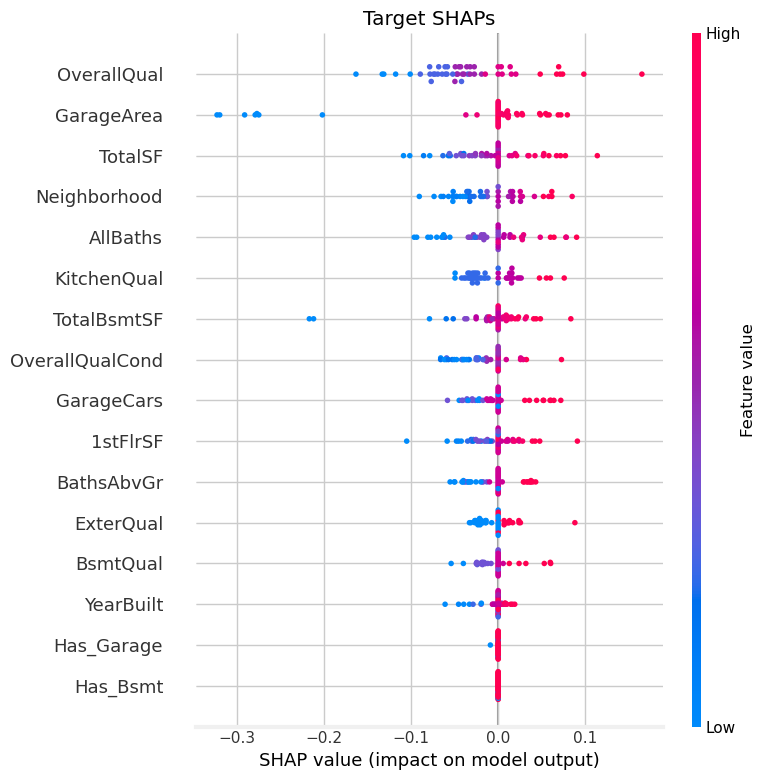

..................................................

Elapsed time: 2.04 minutes
..................................................



Time: 12:59:04
***************************************************************************
knn_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=knn_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.891018
R2,0.890773
MAE,0.091809
MSE,0.017079
RMSE,0.130686
MedAE,0.061749
MAPE,0.007655




Regression Report: Validation
..................................................


,Value
Explained Variance,0.853556
R2,0.853504
MAE,0.108468
MSE,0.024553
RMSE,0.156693
MedAE,0.073251
MAPE,0.009144



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


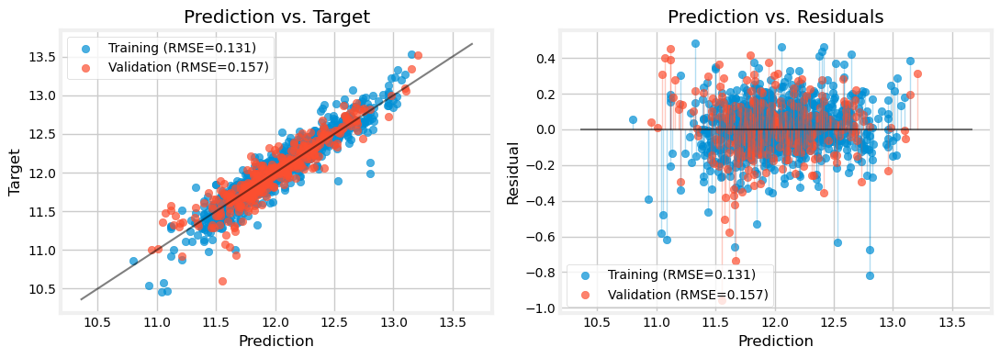



..................................................

Elapsed time: 0.05 minutes
..................................................



Time: 12:59:07
***************************************************************************
knn_clus , 	CV: True 

***************************************************************************
We will evaluate knn_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.1536238358928257
		best params: {'model__algorithm': 'ball_tree', 'model__leaf_size': 10, 'model__n_neighbors': 6, 'model__p': 2, 'model__weights': 'distance', 'preprocessor__cluster__n_clusters': 6, 'preprocessor__pca__fit_feat_subset': False, 'preprocessor__pca__keep_original_feats': True, 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.10323848509474108, 'preprocessor__target_encoder__smoothing': 10.0}
......Don

,Value
Explained Variance,0.999988
R2,0.999988
MAE,0.000068
MSE,0.000002
RMSE,0.001387
MedAE,0.000000
MAPE,0.000006




Regression Report: Validation
..................................................


,Value
Explained Variance,0.865952
R2,0.865946
MAE,0.105125
MSE,0.022467
RMSE,0.149891
MedAE,0.070454
MAPE,0.008858



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


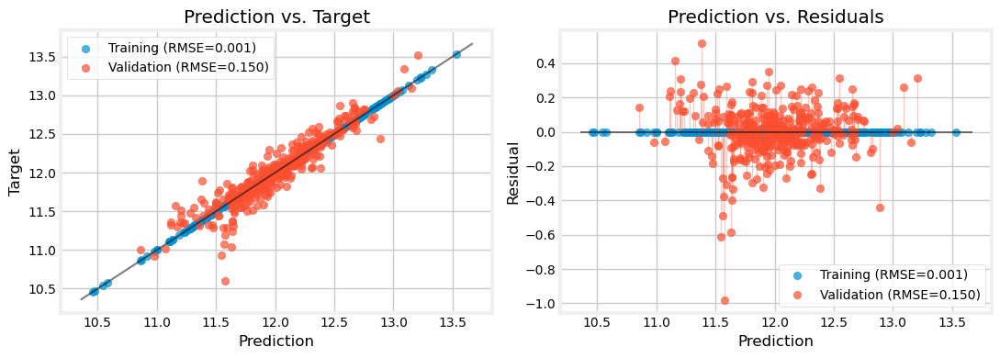



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['pca0', 'pca2', 'OverallQual', 'AllBaths', 'TotalBsmtSF', 'pca1', 'GarageArea', 'Neighborhood', 'OverallQualCond', 'YearBuilt', 'pca3', 'AllRooms', 'BsmtQual', 'TotalSF', '1and2FlrSF', 'pca4', 'ExterQual', 'pca6', 'cluster_1', 'KitchenQual', 'GarageAge', 'GarageCars', '1stFlrSF', 'HouseAge', 'cluster_0', 'cluster_3', 'Has_Bsmt', 'pca10', 'Has_Garage', 'cluster_2', 'cluster_4', 'pca8', 'pca9', 'pca5', 'cluster_5', 'pca7', 'BathsAbvGr']
The most important features are:

	pca0: 0.17388683571505192 +- 0.014790187996281528
	pca2: 0.06355138051157974 +- 0.0018601229948138934
	OverallQual: 0.044302612397384734 +- 0.005575889827702993
	AllBaths: 0.018260237914087353 +- 0.002377604659481246
	TotalBsmtSF: 0.01654627637865347 +- 0.007800031815979485
	pca1: 0.01492324200852766 +- 0.00

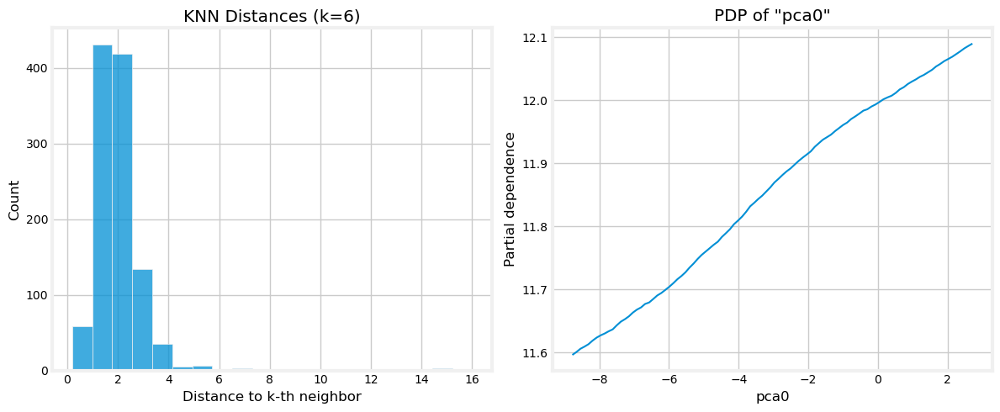

  0%|          | 0/50 [00:00<?, ?it/s]

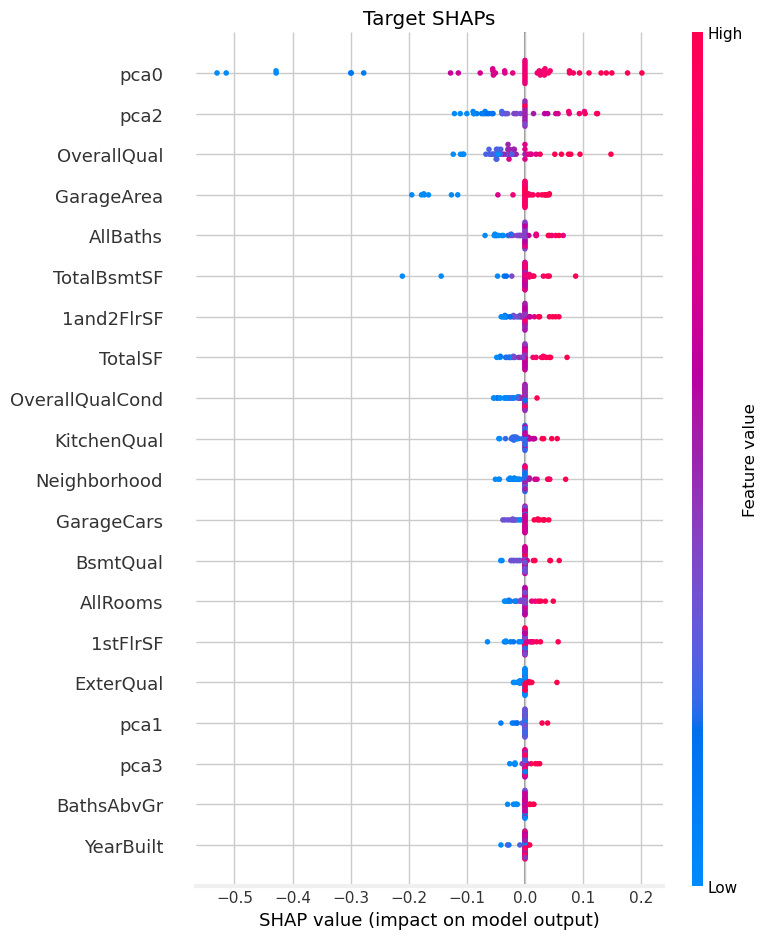

..................................................

Elapsed time: 3.52 minutes
..................................................





In [357]:
model = 'knn'

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=100,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [358]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv,rfr_raw_no_cv,rfr_raw_cv,rfr_eng_no_cv,rfr_eng_cv,rfr_clus_no_cv,rfr_clus_cv,xgbr_raw_no_cv,xgbr_raw_cv,xgbr_eng_no_cv,xgbr_eng_cv,xgbr_clus_no_cv,xgbr_clus_cv,linreg_raw_no_cv,linreg_raw_cv,linreg_eng_no_cv,linreg_eng_cv,linreg_clus_no_cv,linreg_clus_cv,lasso_raw_no_cv,lasso_raw_cv,lasso_eng_no_cv,lasso_eng_cv,lasso_clus_no_cv,lasso_clus_cv,ridge_raw_no_cv,ridge_raw_cv,ridge_eng_no_cv,ridge_eng_cv,ridge_clus_no_cv,ridge_clus_cv,knn_raw_no_cv,knn_raw_cv,knn_eng_no_cv,knn_eng_cv,knn_clus_no_cv,knn_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577,0.056091,0.066092,0.054656,0.059556,0.056244,0.073190,0.004774,0.016233,0.009846,0.091029,0.008072,0.097619,0.099541,0.150483,0.141500,0.136019,0.141334,0.135638,0.195434,0.149500,0.395426,0.138020,0.395426,0.137365,0.106040,0.149205,0.141619,0.136983,0.141392,0.136818,0.186154,0.001937,0.130320,0.002394,0.130686,0.001387
R2 Score Validation,0.891477,7.513521e-01,0.697498,0.772228,0.787640,0.773686,0.784581,0.891477,0.879756,0.887772,0.886950,0.880742,0.876900,0.894659,0.864149,0.878283,0.882471,0.861914,0.885697,0.895123,0.878597,0.892702,0.901113,0.892984,0.901111,0.814858,0.883594,-0.008946,0.899279,-0.008946,0.900332,0.892717,0.871649,0.893122,0.899484,0.893256,0.900282,0.632831,0.774270,0.855047,0.856035,0.853504,0.865946
RMSE Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577,0.056091,0.066092,0.054656,0.059556,0.056244,0.073190,0.004774,0.016233,0.009846,0.091029,0.008072,0.097619,0.099541,0.150483,0.141500,0.136019,0.141334,0.135638,0.195434,0.149500,0.395426,0.138020,0.395426,0.137365,0.106040,0.149205,0.141619,0.136983,0.141392,0.136818,0.186154,0.001937,0.130320,0.002394,0.130686,0.001387
RMSE Validation,0.134864,2.041404e-01,0.225165,0.195383,0.188657,0.194757,0.190011,0.134864,0.141961,0.137147,0.137648,0.141377,0.143637,0.132873,0.150893,0.142828,0.140349,0.152129,0.138409,0.132579,0.142643,0.134101,0.128738,0.133925,0.128739,0.176152,0.139677,0.411216,0.129926,0.411216,0.129245,0.134092,0.146668,0.133839,0.129794,0.133755,0.129278,0.248067,0.194505,0.155866,0.155333,0.156693,0.149891


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [359]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [360]:
best_cv[model+'_clus']['params']

{'model__algorithm': 'ball_tree',
 'model__leaf_size': 10,
 'model__n_neighbors': 6,
 'model__p': 2,
 'model__weights': 'distance',
 'preprocessor__cluster__n_clusters': 6,
 'preprocessor__pca__fit_feat_subset': False,
 'preprocessor__pca__keep_original_feats': True,
 'preprocessor__selector__best_k': 20,
 'preprocessor__selector__t_thr': 0.10323848509474108,
 'preprocessor__target_encoder__smoothing': 10.0}

In [361]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [362]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,1and2FlrSF,Neighborhood,AllRooms,OverallQualCond,GarageCars,GarageArea,YearBuilt,TotalBsmtSF,BathsAbvGr,1stFlrSF,AllBaths,HouseAge,ExterQual,KitchenQual,BsmtQual,GarageAge,Has_Garage,Has_Bsmt
6,0.742068,8,0.312092,0.630005,0.500000,0.5,2,0.502730,0.659574,1.052674,2.0,0.919677,3.0,-1.125091,4,4,5,-1.066979,1,1
807,0.367177,5,0.156204,-1.087169,0.333333,-0.5,2,0.170238,-1.063830,0.569246,1.5,-0.048785,3.5,0.472309,3,4,3,0.537697,1,1
955,0.398207,6,0.624807,0.392791,0.500000,0.1,2,0.044102,-0.574468,-0.034421,2.0,-0.240817,2.0,0.296586,3,3,4,0.361174,1,1
1040,0.398207,5,0.446734,-0.763976,0.833333,-1.5,2,0.014822,-0.340426,0.259462,2.0,1.051686,3.0,0.185008,3,3,3,0.249087,1,1
701,-0.170534,7,-0.497959,0.226941,-0.333333,0.0,2,0.170238,-0.085106,0.311677,1.5,0.125459,1.5,0.042657,3,3,3,0.106088,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,-0.081754,6,-0.177958,0.226941,0.166667,-0.5,2,-0.007457,0.021277,0.132054,2.0,0.439205,2.0,0.014612,3,3,4,0.077916,1,1
905,-0.400741,5,-0.693872,-0.627442,-0.166667,-1.0,1,-0.961984,-0.404255,0.116963,1.0,-0.066626,2.0,0.252972,3,3,3,0.317361,1,1
1096,-0.494922,6,-0.169978,-0.987682,0.000000,0.7,0,-11.052923,-1.255319,-0.751207,1.5,-0.740655,1.5,0.512449,3,4,3,2.173310,0,1
235,-1.295571,6,-0.853972,-0.475951,-0.666667,-1.7,1,-1.066905,-0.042553,-1.446378,1.5,-1.735090,1.5,0.042657,3,3,3,0.106088,1,1


In [363]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                ('pca', PCAFeature()),
                ('cluster',
                 KMeansFeature(n_clusters=6, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x73cc40b57ec0>)],
                                                    verbose_feature_names_out=False))]))])

In [364]:
del best_preproc, best_feats

### Model 8: `MLPRegressor`

In [365]:
model = 'mlp'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', MLPRegressor(max_iter=10_000,
                                               random_state=0))])

    pipe[model_name+'_no_cv'] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        ('model', MLPRegressor(max_iter=10_000,
                                               random_state=0))])

    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
            [False, True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [True, False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__hidden_layer_sizes'] =\
        np.arange(10, 100, 10)
    param_grid[model_name]['model__alpha'] =\
        loguniform(1.e-6, 0.1)
    param_grid[model_name]['model__learning_rate_init'] =\
        loguniform(1.e-4, 0.1)

Time: 13:02:38
***************************************************************************
mlp_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=mlp_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,-733.525561
R2,-1089.394514
MAE,8.319315
MSE,170.496212
RMSE,13.057420
MedAE,7.139932
MAPE,0.687289




Regression Report: Validation
..................................................


,Value
Explained Variance,-851.980651
R2,-1183.886659
MAE,9.407019
MSE,198.586654
RMSE,14.092078
MedAE,7.614053
MAPE,0.781830



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


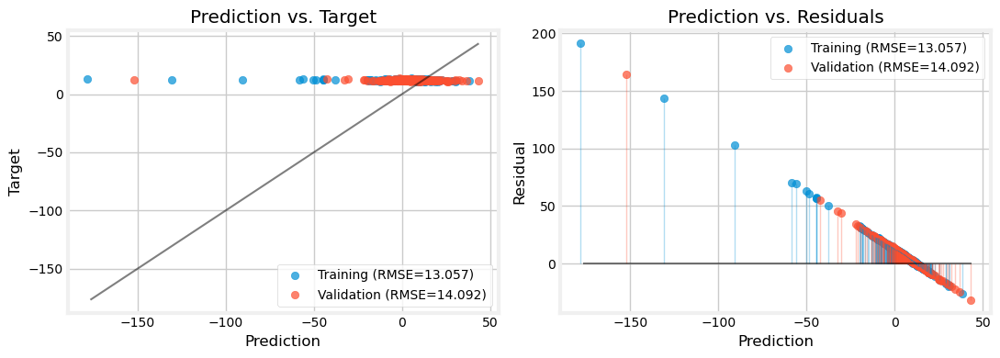



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 13:02:40
***************************************************************************
mlp_raw , 	CV: True 

***************************************************************************
We will evaluate mlp_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.3449608498035708
		best params: {'model__alpha': 0.024128272362688146, 'model__hidden_layer_sizes': 30, 'model__learning_rate_init': 0.07668500736551162, 'preprocessor__selector__best_k': 10, 'preprocessor__selector__t_thr': 0.8030957934219767, 'preprocessor__target_encoder__smoothing': 10.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..............................

,Value
Explained Variance,0.525978
R2,0.514824
MAE,0.156407
MSE,0.075863
RMSE,0.275433
MedAE,0.105211
MAPE,0.013106




Regression Report: Validation
..................................................


,Value
Explained Variance,0.775464
R2,0.773839
MAE,0.144310
MSE,0.037904
RMSE,0.194691
MedAE,0.110490
MAPE,0.012089



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


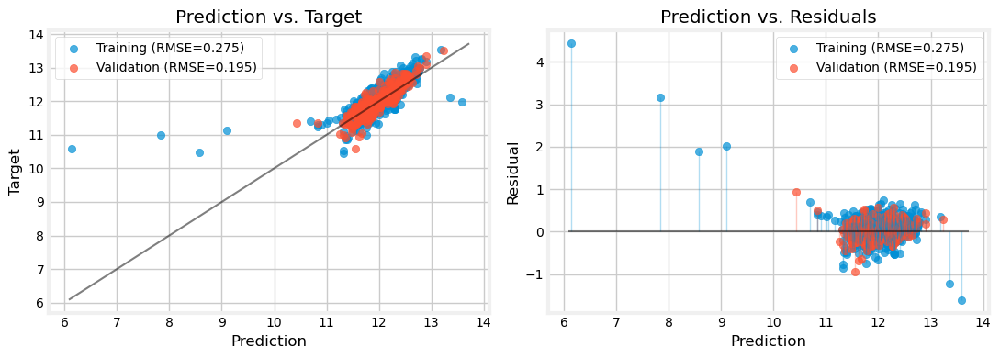



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['GrLivArea', 'YearBuilt', 'KitchenQual', 'GarageCars', 'OverallQual', 'ExterQual']
The most important features are:

	GrLivArea: 0.37364057519081906 +- 0.012500496719952547
	YearBuilt: 0.3104072584007999 +- 0.031124083595464876
	KitchenQual: 0.061025379309078656 +- 0.0072444684364867925
	GarageCars: 0.03593900075614247 +- 0.0056282985927764905
	OverallQual: 0.022569219319839528 +- 0.0017524620708092176
	ExterQual: 0.00019148028179045707 +- 0.00036788234353963764

****************************************************************************************************



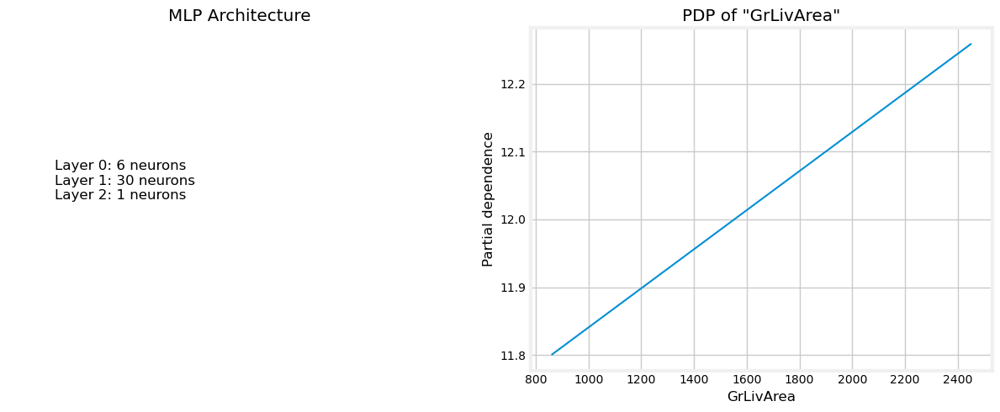

  0%|          | 0/50 [00:00<?, ?it/s]

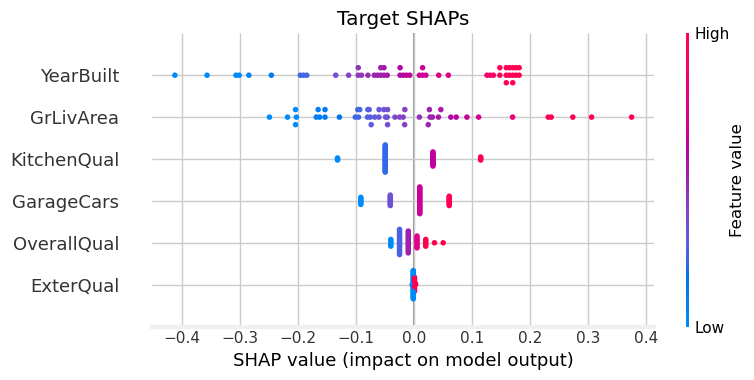

..................................................

Elapsed time: 3.18 minutes
..................................................



Time: 13:05:51
***************************************************************************
mlp_eng , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=mlp_eng with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.892828
R2,0.878648
MAE,0.104647
MSE,0.018975
RMSE,0.137749
MedAE,0.081757
MAPE,0.008712




Regression Report: Validation
..................................................


,Value
Explained Variance,0.829813
R2,0.812323
MAE,0.125109
MSE,0.031455
RMSE,0.177355
MedAE,0.095793
MAPE,0.010536



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


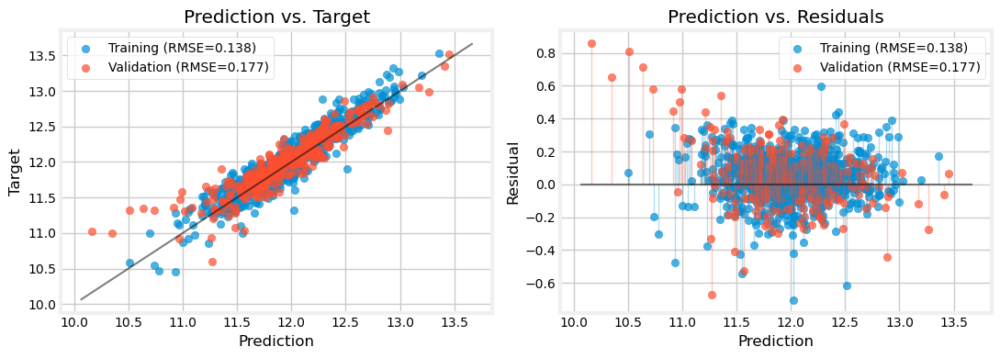



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 13:05:54
***************************************************************************
mlp_eng , 	CV: True 

***************************************************************************
We will evaluate mlp_eng with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.1657274888051166
		best params: {'model__alpha': 0.0026085951214779935, 'model__hidden_layer_sizes': 90, 'model__learning_rate_init': 0.0007088535843752512, 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.5074736522945494, 'preprocessor__target_encoder__smoothing': 40.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
...........................

,Value
Explained Variance,0.861680
R2,0.861085
MAE,0.108599
MSE,0.021721
RMSE,0.147381
MedAE,0.082387
MAPE,0.009070




Regression Report: Validation
..................................................


,Value
Explained Variance,0.852883
R2,0.852873
MAE,0.117570
MSE,0.024658
RMSE,0.157030
MedAE,0.087208
MAPE,0.009901



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


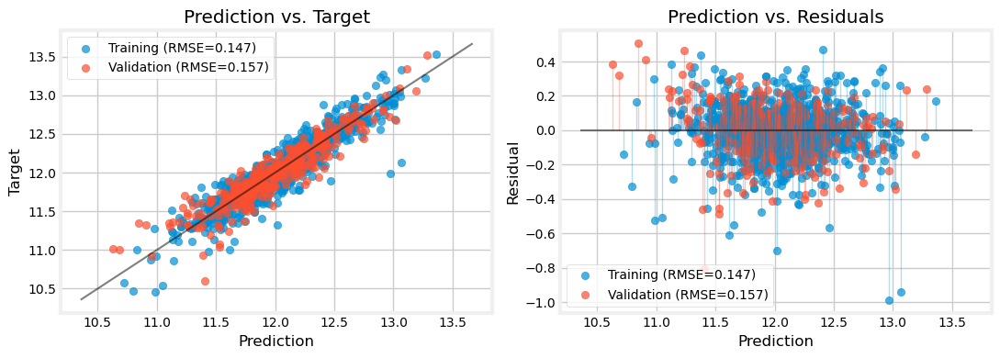



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['GarageArea', 'Has_Garage', 'TotalBsmtSF', 'Has_Bsmt', 'GarageCars', 'TotalSF', 'BsmtQual', 'Neighborhood', 'AllBaths', 'OverallQualCond', 'OverallQual', 'BathsAbvGr', 'KitchenQual', 'ExterQual']
The most important features are:

	GarageArea: 10.469546500733443 +- 0.5424262679380171
	Has_Garage: 8.408143852100103 +- 0.4889385720430911
	TotalBsmtSF: 3.422006350271405 +- 0.09866215579602676
	Has_Bsmt: 2.4799515540283776 +- 0.05222522005154609
	GarageCars: 0.24182044680173015 +- 0.013389324632818491
	TotalSF: 0.23877634037696507 +- 0.008122565004456838
	BsmtQual: 0.07180030469389367 +- 0.011520864814482201
	Neighborhood: 0.07156403596971814 +- 0.006774001965158253
	AllBaths: 0.05113167277958952 +- 0.009337233580861191
	OverallQualCond: 0.04720300526629999 +- 0.007878848498600

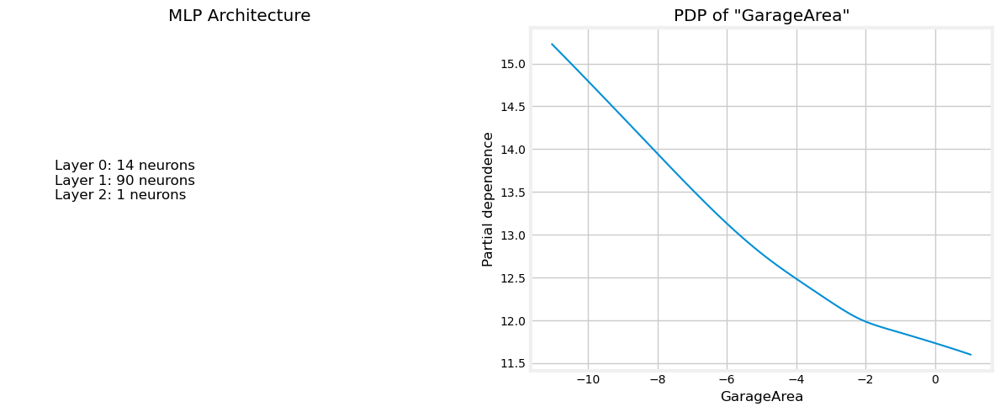

  0%|          | 0/50 [00:00<?, ?it/s]

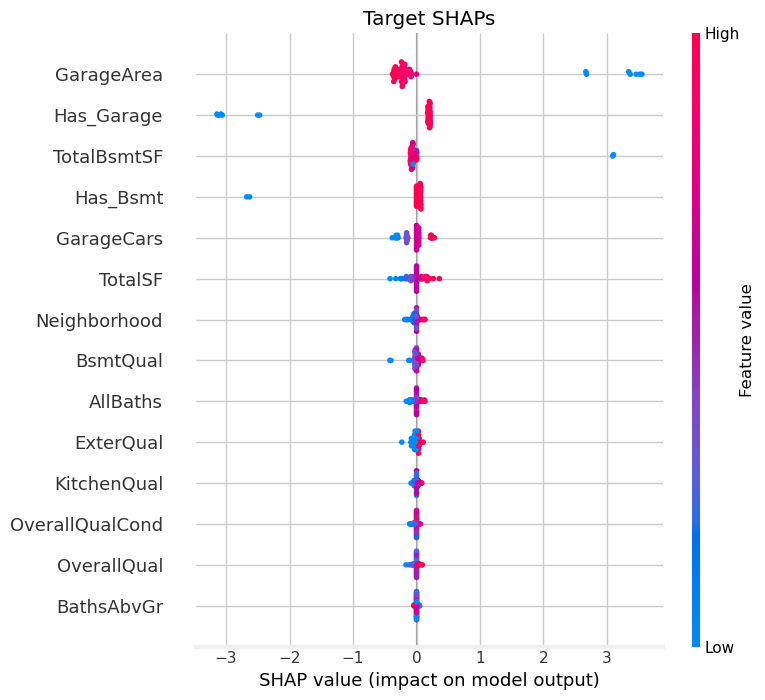

..................................................

Elapsed time: 3.60 minutes
..................................................



Time: 13:09:30
***************************************************************************
mlp_clus , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=mlp_clus with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.876943
R2,0.876941
MAE,0.105980
MSE,0.019242
RMSE,0.138715
MedAE,0.080574
MAPE,0.008840




Regression Report: Validation
..................................................


,Value
Explained Variance,0.849529
R2,0.848764
MAE,0.116376
MSE,0.025347
RMSE,0.159208
MedAE,0.087335
MAPE,0.009820



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


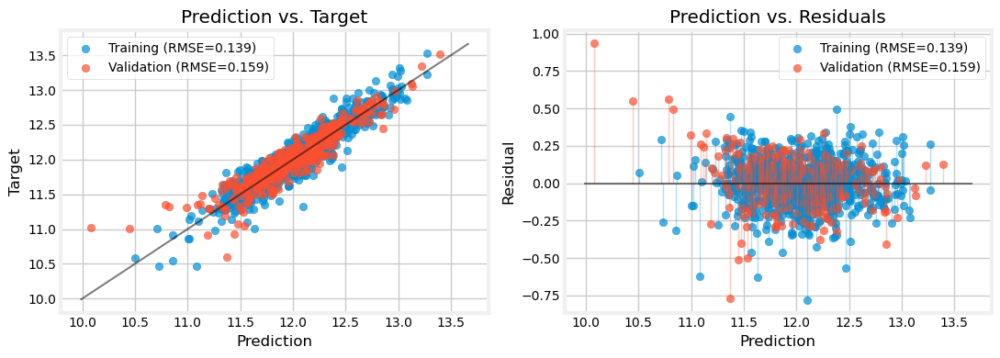



..................................................

Elapsed time: 0.04 minutes
..................................................



Time: 13:09:32
***************************************************************************
mlp_clus , 	CV: True 

***************************************************************************
We will evaluate mlp_clus with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.16461255840653202
		best params: {'model__alpha': 0.06995339977530098, 'model__hidden_layer_sizes': 90, 'model__learning_rate_init': 0.001969043480269282, 'preprocessor__cluster__n_clusters': 6, 'preprocessor__pca__fit_feat_subset': True, 'preprocessor__pca__keep_original_feats': True, 'preprocessor__selector__best_k': 10, 'preprocessor__selector__t_thr': 0.44869194021250147, 'preprocessor__target_encoder__smoothing': 40.0}
......Done!
 ->

,Value
Explained Variance,0.876169
R2,0.876147
MAE,0.103201
MSE,0.019366
RMSE,0.139161
MedAE,0.080198
MAPE,0.008601




Regression Report: Validation
..................................................


,Value
Explained Variance,0.859371
R2,0.859371
MAE,0.109708
MSE,0.023569
RMSE,0.153523
MedAE,0.085158
MAPE,0.009239



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


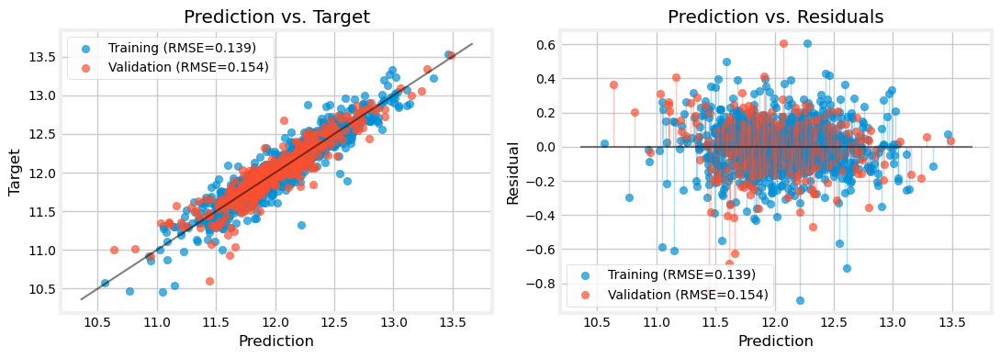



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['GarageArea', 'cluster_3', 'cluster_5', 'cluster_0', 'pca0', 'Has_Garage', 'cluster_2', 'Neighborhood', 'pca2', 'cluster_4', 'TotalSF', 'OverallQual', 'OverallQualCond', 'pca3', 'pca1', 'GarageCars', 'cluster_1']
The most important features are:

	GarageArea: 29.693858896344427 +- 1.6616013299093344
	cluster_3: 13.280329351767145 +- 0.759614788206977
	cluster_5: 12.60073363270192 +- 0.3590637979479475
	cluster_0: 12.572261895405912 +- 0.6190351408087782
	pca0: 10.502091204907169 +- 0.4420520504538435
	Has_Garage: 8.314340800698895 +- 0.6654301767343243
	cluster_2: 6.975598686894074 +- 0.3367313847364496
	Neighborhood: 4.605247264888122 +- 0.2555899404254745
	pca2: 4.513604161894806 +- 0.2504126392007355
	cluster_4: 4.10478704883346 +- 0.14760513673291648
	TotalSF: 1.091029

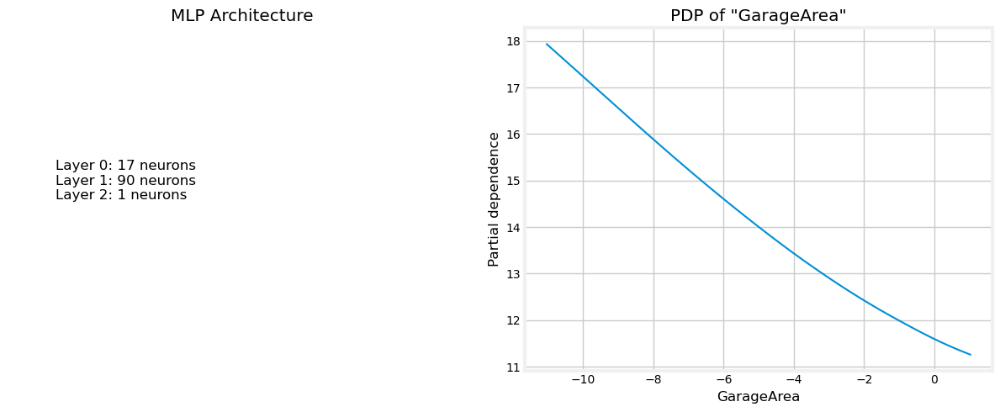

  0%|          | 0/50 [00:00<?, ?it/s]

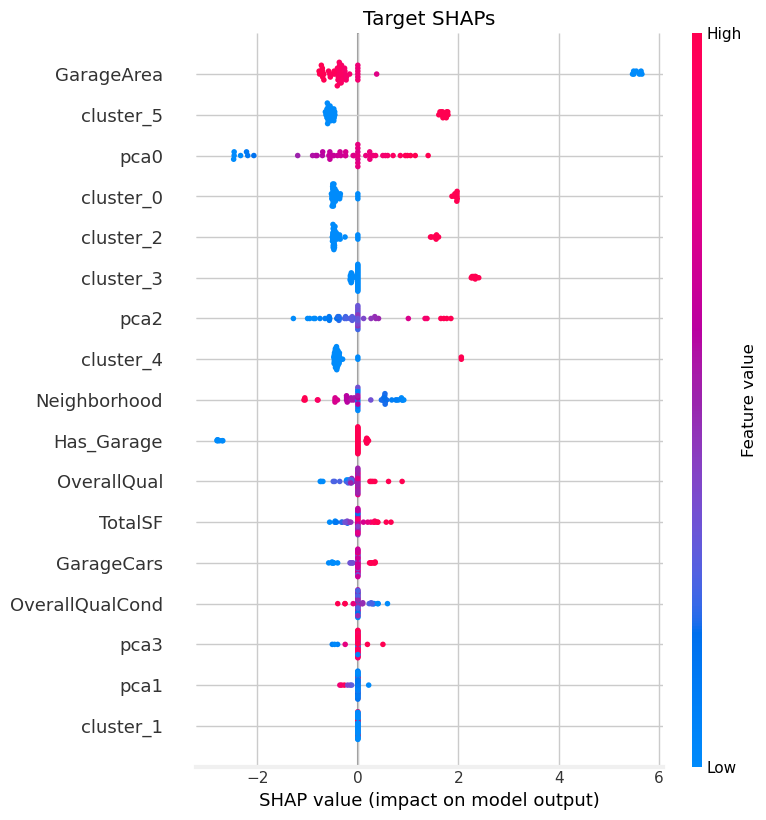

..................................................

Elapsed time: 3.52 minutes
..................................................





In [366]:
for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=100,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [367]:
scorecard

,rfr_base_no_cv,dtr_raw_no_cv,dtr_raw_cv,dtr_eng_no_cv,dtr_eng_cv,dtr_clus_no_cv,dtr_clus_cv,rfr_raw_no_cv,rfr_raw_cv,rfr_eng_no_cv,rfr_eng_cv,rfr_clus_no_cv,rfr_clus_cv,xgbr_raw_no_cv,xgbr_raw_cv,xgbr_eng_no_cv,xgbr_eng_cv,xgbr_clus_no_cv,xgbr_clus_cv,linreg_raw_no_cv,linreg_raw_cv,linreg_eng_no_cv,linreg_eng_cv,linreg_clus_no_cv,linreg_clus_cv,lasso_raw_no_cv,lasso_raw_cv,lasso_eng_no_cv,lasso_eng_cv,lasso_clus_no_cv,lasso_clus_cv,ridge_raw_no_cv,ridge_raw_cv,ridge_eng_no_cv,ridge_eng_cv,ridge_clus_no_cv,ridge_clus_cv,knn_raw_no_cv,knn_raw_cv,knn_eng_no_cv,knn_eng_cv,knn_clus_no_cv,knn_clus_cv,mlp_raw_no_cv,mlp_raw_cv,mlp_eng_no_cv,mlp_eng_cv,mlp_clus_no_cv,mlp_clus_cv
R2 Score Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577,0.056091,0.066092,0.054656,0.059556,0.056244,0.073190,0.004774,0.016233,0.009846,0.091029,0.008072,0.097619,0.099541,0.150483,0.141500,0.136019,0.141334,0.135638,0.195434,0.149500,0.395426,0.138020,0.395426,0.137365,0.106040,0.149205,0.141619,0.136983,0.141392,0.136818,0.186154,0.001937,0.130320,0.002394,0.130686,0.001387,13.057420,0.275433,0.137749,0.147381,0.138715,0.139161
R2 Score Validation,0.891477,7.513521e-01,0.697498,0.772228,0.787640,0.773686,0.784581,0.891477,0.879756,0.887772,0.886950,0.880742,0.876900,0.894659,0.864149,0.878283,0.882471,0.861914,0.885697,0.895123,0.878597,0.892702,0.901113,0.892984,0.901111,0.814858,0.883594,-0.008946,0.899279,-0.008946,0.900332,0.892717,0.871649,0.893122,0.899484,0.893256,0.900282,0.632831,0.774270,0.855047,0.856035,0.853504,0.865946,-1183.886659,0.773839,0.812323,0.852873,0.848764,0.859371
RMSE Train,0.056091,9.297877e-17,0.207807,0.002394,0.186062,0.002394,0.175577,0.056091,0.066092,0.054656,0.059556,0.056244,0.073190,0.004774,0.016233,0.009846,0.091029,0.008072,0.097619,0.099541,0.150483,0.141500,0.136019,0.141334,0.135638,0.195434,0.149500,0.395426,0.138020,0.395426,0.137365,0.106040,0.149205,0.141619,0.136983,0.141392,0.136818,0.186154,0.001937,0.130320,0.002394,0.130686,0.001387,13.057420,0.275433,0.137749,0.147381,0.138715,0.139161
RMSE Validation,0.134864,2.041404e-01,0.225165,0.195383,0.188657,0.194757,0.190011,0.134864,0.141961,0.137147,0.137648,0.141377,0.143637,0.132873,0.150893,0.142828,0.140349,0.152129,0.138409,0.132579,0.142643,0.134101,0.128738,0.133925,0.128739,0.176152,0.139677,0.411216,0.129926,0.411216,0.129245,0.134092,0.146668,0.133839,0.129794,0.133755,0.129278,0.248067,0.194505,0.155866,0.155333,0.156693,0.149891,14.092078,0.194691,0.177355,0.157030,0.159208,0.153523


#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [368]:
best_cv[model+'_clus']

{'pipe': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('cleaning',
                                   Pipeline(steps=[('custom_imputer',
                                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                                             'BsmtQual'],
                                                                                'BsmtExposure': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtFinType2': ['BsmtQual',
                                                                                                 'BsmtCond'],
                                                                                'BsmtQual': ['BsmtCond',
                                                                                   

In [369]:
best_cv[model+'_clus']['params']

{'model__alpha': 0.06995339977530098,
 'model__hidden_layer_sizes': 90,
 'model__learning_rate_init': 0.001969043480269282,
 'preprocessor__cluster__n_clusters': 6,
 'preprocessor__pca__fit_feat_subset': True,
 'preprocessor__pca__keep_original_feats': True,
 'preprocessor__selector__best_k': 10,
 'preprocessor__selector__t_thr': 0.44869194021250147,
 'preprocessor__target_encoder__smoothing': 40.0}

In [370]:
best_cv[model+'_clus']['pipe'].steps

[('preprocessor',
  Pipeline(steps=[('cleaning',
                   Pipeline(steps=[('custom_imputer',
                                    CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                             'BsmtQual'],
                                                                'BsmtExposure': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtFinType2': ['BsmtQual',
                                                                                 'BsmtCond'],
                                                                'BsmtQual': ['BsmtCond',
                                                                             'BsmtExposure'],
                                                                'Exterior1st': 'Foundation',
                                                                

In [371]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

,TotalSF,OverallQual,Neighborhood,GarageCars,OverallQualCond,GarageArea,Has_Garage
6,0.742068,8,0.483664,2,0.5,0.502730,1
807,0.367177,5,-1.057006,2,-0.5,0.170238,1
955,0.398207,6,0.287491,2,0.1,0.044102,1
1040,0.398207,5,-0.736242,2,-1.5,0.014822,1
701,-0.170534,7,0.115169,2,0.0,0.170238,1
...,...,...,...,...,...,...,...
715,-0.081754,6,0.115169,2,-0.5,-0.007457,1
905,-0.400741,5,-0.772132,1,-1.0,-0.961984,1
1096,-0.494922,6,-1.341701,0,0.7,-11.052923,0
235,-1.295571,6,-1.044408,1,-1.7,-1.066905,1


In [372]:
best_preproc

Pipeline(steps=[('cleaning',
                 Pipeline(steps=[('custom_imputer',
                                  CustomImputer(groupby_cols={'BsmtCond': ['BsmtExposure',
                                                                           'BsmtQual'],
                                                              'BsmtExposure': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtFinType2': ['BsmtQual',
                                                                               'BsmtCond'],
                                                              'BsmtQual': ['BsmtCond',
                                                                           'BsmtExposure'],
                                                              'Exterior1st': 'Foundation',
                                                              'Exterior2nd': 'Foundation',
                                                              'GarageArea': ['GarageCars',
                                                                             'GarageQual'],
                                                              'GarageCa...
                ('pca', PCAFeature(fit_feat_subset=True)),
                ('cluster',
                 KMeansFeature(n_clusters=6, scaling_method='robust')),
                ('ohe',
                 Pipeline(steps=[('ohe',
                                  ColumnTransformer(remainder='passthrough',
                                                    transformers=[('ohe',
                                                                   OneHotEncoder(dtype=<class 'int'>,
                                                                                 handle_unknown='ignore',
                                                                                 sparse_output=False),
                                                                   <function ohe_from_subset.<locals>.selector at 0x73cc40b57ec0>)],
                                                    verbose_feature_names_out=False))]))])

In [373]:
del best_preproc, best_feats

### Model 9: `SVR`/`LinearSVR`

In [385]:
model = 'svr'

for pp in ['raw', 'eng', 'clus']:

    model_name = model+'_'+pp # full model name

    preproc_pipe = final_preproc[pp] # preprocessing  pipeline

    pipe[model_name] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        # ('model', LinearSVR(max_iter=100_000,
                                            # tol=1.e-2,
                                            # random_state=0))])
                        ('model', SVR(tol=0.01))])

    pipe[model_name+'_no_cv'] =\
        Pipeline(steps=[('preprocessor', preproc_pipe),
                        # ('model', LinearSVR(max_iter=100_000,
                        #                     tol=1.e-2,
                        #                     random_state=0))])
                        ('model', SVR(tol=0.01))])

    # defining the hyperparameter grid
    # basic:
    param_grid[model_name] = {'preprocessor__target_encoder__smoothing':
                                  list(np.arange(10., 60., 10.)),
                              'preprocessor__selector__best_k':
                                  list(range(10, 40, 10)),
                              'preprocessor__selector__t_thr':
                                  uniform(loc=0.1, scale=0.8)
                             }
    # if clustering:
    if pp == 'clus':
        param_grid[model_name]['preprocessor__pca__fit_feat_subset'] =\
            [False, True]
        param_grid[model_name]['preprocessor__pca__keep_original_feats'] =\
            [True, False]
        param_grid[model_name]['preprocessor__cluster__n_clusters'] =\
            list(range(3,7))

    # proper to the model:
    param_grid[model_name]['model__C'] =\
        loguniform(1e-3, 1e2)
    param_grid[model_name]['model__epsilon'] =\
        loguniform(1e-3, 1e2)

    if isinstance(pipe[model_name].steps[-1][1], SVR):
        # param_grid[model_name]['model__gamma'] = ['scale', 'auto']
        param_grid[model_name]['model__gamma'] = loguniform(1e-3, 1e2)

Time: 13:48:49
***************************************************************************
svr_raw , 	CV: False 

***************************************************************************
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
We will evaluate model=svr_raw with standard validation.
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::

 -> Fitting the model
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
..................................................


,Value
Explained Variance,0.755013
R2,0.753761
MAE,0.143045
MSE,0.038502
RMSE,0.196220
MedAE,0.105680
MAPE,0.011962




Regression Report: Validation
..................................................


,Value
Explained Variance,0.737788
R2,0.734289
MAE,0.150514
MSE,0.044533
RMSE,0.211028
MedAE,0.117234
MAPE,0.012649



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


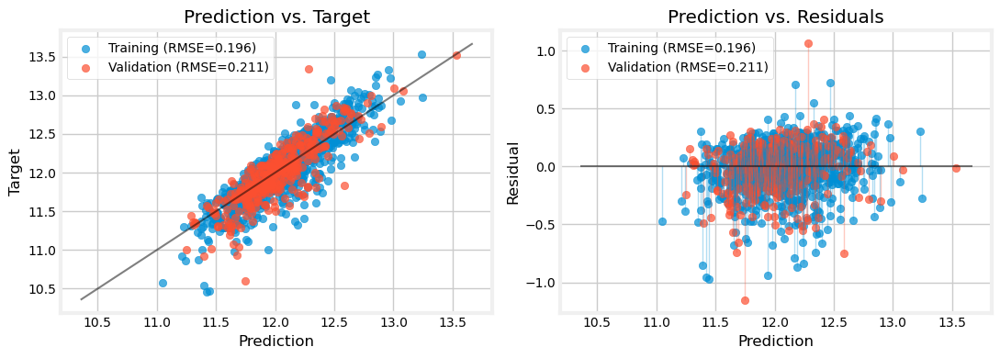



..................................................

Elapsed time: 0.02 minutes
..................................................



Time: 13:48:50
***************************************************************************
svr_raw , 	CV: True 

***************************************************************************
We will evaluate svr_raw with cross-validation.

 -> Creating instance of `RepeatedKFold`
......Done!
 -> Creating the CV search
......Done!

 -> Fitting the model
......Done!
 -> CV Results:
		best neg_root_mean_squared_error: -0.31537564497965653
		best params: {'model__C': 0.041754668393896896, 'model__epsilon': 0.005602402871263747, 'model__gamma': 0.012930250578399357, 'preprocessor__selector__best_k': 20, 'preprocessor__selector__t_thr': 0.8549984628116993, 'preprocessor__target_encoder__smoothing': 20.0}
......Done!
 -> Making predictions
......Done!
 -> Creating Regression Reports
......Done!


Regression Report: Training
......................................

,Value
Explained Variance,0.241305
R2,0.237047
MAE,0.242485
MSE,0.119297
RMSE,0.345394
MedAE,0.166123
MAPE,0.020102




Regression Report: Validation
..................................................


,Value
Explained Variance,0.115387
R2,0.114729
MAE,0.287452
MSE,0.148371
RMSE,0.385190
MedAE,0.212360
MAPE,0.023966



 -> Computing Scores
......Done!
**************************************************
Prediction and Residual Plots:


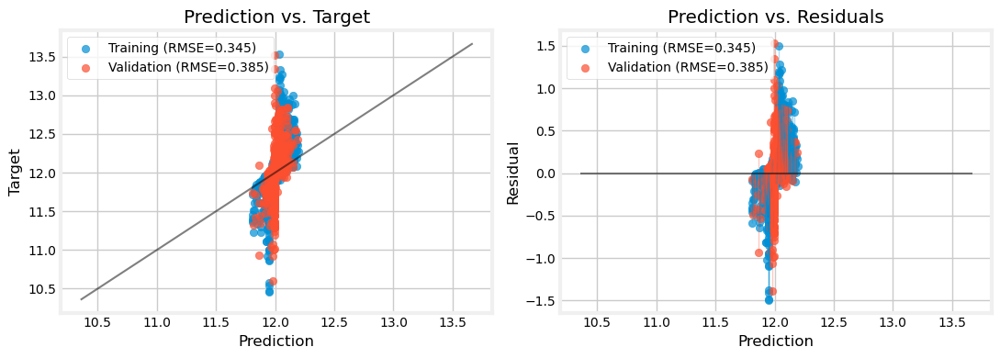



****************************************************************************************************
Performing Permutation Importance:
..................................................
The model's features are:

['YearBuilt', 'GarageYrBlt', 'YearRemodAdd', 'GrLivArea', 'OverallQual', 'FireplaceQu', 'BsmtQual', 'GarageFinish', 'GarageCars', 'KitchenQual', 'ExterQual', 'FullBath', 'Foundation_2', 'Foundation_1', 'GarageType_1', 'GarageType_5', 'GarageType_6', 'Foundation_0', 'GarageType_3', 'GarageType_4', 'Foundation_3', 'Foundation_4', 'GarageType_0', 'Foundation_5', 'GarageType_2']
The most important features are:

	YearBuilt: 0.08659131899416314 +- 0.005163489789885555
	GarageYrBlt: 0.08286583784033352 +- 0.0051136546287196
	YearRemodAdd: 0.07283839772377365 +- 0.003615058366643534
	GrLivArea: 0.0545712544008224 +- 0.008558643167967214
	OverallQual: 0.004786587955383448 +- 0.00044259145657794564
	FireplaceQu: 0.0045693736126662275 +- 0.00040523315148544313
	BsmtQual: 0.0020731741

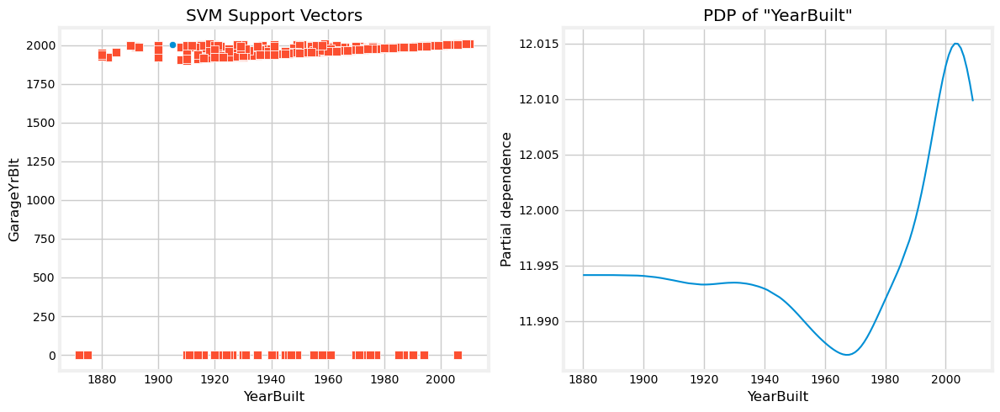

  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
model = 'svr'

for pp in ['raw', 'eng', 'clus']:
    for cvQ in [False, True]:

        print(time.strftime("Time: %H:%M:%S"))
        start = time.time()

        model_name = model+'_'+pp # full model name

        print("*"*75)
        print(model_name, ", \tCV:", cvQ, "\n")
        print("*"*75)
        
        # # GridSearchCV
        # model_evaluation(model_name, (X_train, X_val, y_train, y_val),
        #                  perform_cv_randomized=(cvQ, False),
        #                  n_splits=5, n_repeats=3,
        #                  verbose=True, plots=True)

        # RandomizedSearchCV
        model_evaluation(model_name, (X_train, X_val, y_train, y_val),
                         perform_cv_randomized=(cvQ, True),
                         n_splits=5, n_repeats=3,
                         n_iter=100,
                         verbose=True, plots=True)

        print("\n")

        if cvQ:
            explain_model(model_name, best_cv[model_name]['pipe'], (X_train, X_val, y_train, y_val), tree_idx=0, random_state=0)

        end = time.time()

        print("."*50)
        print(f"\nElapsed time: {(end-start)/60:.2f} minutes")
        print("."*50)

        print("\n\n")

In [ ]:
scorecard

#### Engineered Cluster Model: exploration

In the cluster model, checking selected engineering features (from which PCA and clusters are built)

In [ ]:
best_cv[model+'_clus']

In [ ]:
best_cv[model+'_clus']['params']

In [ ]:
best_cv[model+'_clus']['pipe'].steps

In [ ]:
best_preproc = best_cv[model+'_clus']['pipe'].steps[0][1] # the best preprocessor
best_feats = best_preproc[:-3] # all the preprocessor steps, except for PCA, KMeans clustering, and OHE
best_feats.transform(X_train)

In [ ]:
best_preproc

In [ ]:
del best_preproc, best_feats

### Cleanup

In [ ]:
Out.clear()

for name in dir():
    if name.startswith('_') and name[1:].isdigit():
        del globals()[name]

## 8. Exporting Best Model

In [ ]:
import pickle

We begin by selecting only those models with CV, and focusing only on the validation scores:

In [ ]:
best_scores = scorecard.loc[[idx for idx in scorecard.index if 'Val' in idx], [col for col in scorecard.columns if '_no_cv' not in col]]
best_scores.head()

In [ ]:
best_scores_T = best_scores.transpose()
best_scores_T

Let us select the models that performed the best in F1 validation:

In [ ]:
best_models = list(best_scores_T[best_scores_T['RMSE Validation'].abs() < 0.2].index)

print(best_models)

Which one to pick? Well, let's look at their mean CV test scores, and their standard deviations:

In [ ]:
stds = {}
for model_name in best_models:
    model_name = model_name.removesuffix('_cv')
    print(model_name)
    idx_largest_score = search[model_name].cv_results_['mean_test_score'].argmax()
    print("found best score?", search[model_name].cv_results_['mean_test_score'][idx_largest_score] == best_cv[model_name]['score'])
    print("best score:", best_cv[model_name]['score'], "+-", search[model_name].cv_results_['std_test_score'][idx_largest_score], "\n")

    stds[model_name] = search[model_name].cv_results_['std_test_score'][idx_largest_score]

Since their best mean CV scores are all within each others standard deviations, they are all functionally equivalent in the CV. Thus, what matters is precisely the standard deviation, which is evidence of their stability. Selecting the models with the smallest standard deviations:

In [688]:
list_overall_best_models = [k+'_cv' for k,v in stds.items() if v == stds[min(stds, key=stds.get)]]

print("models:", list_overall_best_models)
print("scores:", [best_cv[k.removesuffix('_cv')]['score'] for k in list_overall_best_models])
print("stds:", [stds[k.removesuffix('_cv')] for k in list_overall_best_models])

best_scores_T.loc[list_overall_best_models]

models: ['mlp_eng_cv']
scores: [-0.17408272638458802]
stds: [0.007699429670654252]


,R2 Score Validation,RMSE Validation
mlp_eng_cv,0.793485,0.186043


To save them, we pickle them:

In [687]:
for overall_best_model in list_overall_best_models:
    
    overall_best_model = overall_best_model.removesuffix('_cv')

    model_path = "./models/"+overall_best_model+".pkl"

    with open(model_path, "wb") as f:
        pickle.dump(best_cv[overall_best_model]['pipe'], f)

NameError: name 'pickle' is not defined

To load the models, run the cell below:

In [254]:
models_directory = "./models/"

my_best_models = {}

for filename in os.listdir(models_directory):
    model_path = os.path.join(models_directory, filename)

    model = model_path.removesuffix('.pkl').removeprefix('./models/')

    with open(model_path, "rb") as f:
        my_best_models[model] = pickle.load(f)

In [256]:
my_best_models

{'mlp_eng': Pipeline(steps=[('preprocessor',
                  Pipeline(steps=[('feature_engineer',
                                   FeatureEngineer(func=<function new_features at 0x72b9f85f8c20>)),
                                  ('selector',
                                   FeatureSelector(n_features=2,
                                                   random_state=0)),
                                  ('col_preproc',
                                   ColumnTransformer(transformers=[('num',
                                                                    Pipeline(steps=[('scaler',
                                                                                     StandardScaler())]),
                                                                    <sklearn.compose._column_transformer.make_column_selector object at 0x72b9a4469590>),
                                                                   ('cat',
                                                               